## Germany Dispatch Cut Scenario with 130 €/t CO2 price

In [1]:
import pypsa 
import matplotlib.pyplot as plt
plt.style.use("bmh")
import pandas as pd
from pypsa.plot import add_legend_patches
import gurobipy
import cartopy.crs as ccrs
from pypsa.optimization import optimize
import matplotlib.cm as cm
import numpy as np
import os

pd.set_option("display.max_rows", None)  # Display all rows
pd.set_option("display.max_columns", None)  # Display all columns


## Import Network

In [2]:
n = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\elec_s_20_ec_lv1.5_3h.nc")
n.name = 'base_dispatchcut'

INFO:pypsa.io:Imported network elec_s_20_ec_lv1.5_3h.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


In [3]:
# add co2price
co2_price = 130 #€/t

for index in n.generators.index:
    emission = n.carriers.co2_emissions.filter(like= n.generators.carrier[index]) #t/MWh_th
    n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3184507867.py:6: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel


In [4]:
for c in n.iterate_components(list(n.components.keys())[2:]):
    print("Component '{}' has {} entries".format(c.name,len(c.df)))

Component 'Bus' has 20 entries
Component 'Carrier' has 21 entries
Component 'GlobalConstraint' has 1 entries
Component 'Line' has 27 entries
Component 'LineType' has 34 entries
Component 'TransformerType' has 14 entries
Component 'Link' has 28 entries
Component 'Load' has 20 entries
Component 'Generator' has 261 entries
Component 'StorageUnit' has 65 entries


In [5]:
#remove nuclear fleet from germany
n.generators.loc[n.generators.index.str.startswith('DE') & n.generators.index.str.endswith('nuclear'), 'p_nom'] = 0


In [6]:
# set marginal cost of load shedding to 3000€/MWh
for bus in n.generators.bus:
    for index in n.generators.index:
        if not bus.endswith('H2') and index.endswith('load'):
            n.generators.loc[index, 'marginal_cost'] = 3000

#edit load shedding's unit from kW to MW
for index in n.generators.index:
    if index.endswith('load') and not index.endswith('H2 load'):
        n.generators.loc[index, 'sign'] = 1

In [7]:
#solve network
n.optimize(solver_name='gurobi')
#n = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\Dispatchcut\\20240512\\base_dispatchcut.nc")

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:05<00:00,  2.24it/s]
INFO:linopy.io: Writing time: 37.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cxsfas44.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cxsfas44.lp


Reading time = 11.10 seconds


INFO:gurobipy:Reading time = 11.10 seconds


obj: 3264863 rows, 1521502 columns, 6235954 nonzeros


INFO:gurobipy:obj: 3264863 rows, 1521502 columns, 6235954 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3264863 rows, 1521502 columns and 6235954 nonzeros


INFO:gurobipy:Optimize a model with 3264863 rows, 1521502 columns and 6235954 nonzeros


Model fingerprint: 0x61697209


INFO:gurobipy:Model fingerprint: 0x61697209


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 1e+03]


INFO:gurobipy:  Matrix range     [1e-02, 1e+03]


  Objective range  [3e-02, 3e+05]


INFO:gurobipy:  Objective range  [3e-02, 3e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 2121745 rows and 372364 columns (presolve time = 5s) ...


INFO:gurobipy:Presolve removed 2121745 rows and 372364 columns (presolve time = 5s) ...


Presolve removed 2121745 rows and 372364 columns


INFO:gurobipy:Presolve removed 2121745 rows and 372364 columns


Presolve time: 6.50s


INFO:gurobipy:Presolve time: 6.50s


Presolved: 1143118 rows, 1149138 columns, 3794406 nonzeros


INFO:gurobipy:Presolved: 1143118 rows, 1149138 columns, 3794406 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Elapsed ordering time = 8s


INFO:gurobipy:Elapsed ordering time = 8s


Ordering time: 14.36s


INFO:gurobipy:Ordering time: 14.36s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 181


INFO:gurobipy: Dense cols : 181


 AA' NZ     : 4.035e+06


INFO:gurobipy: AA' NZ     : 4.035e+06


 Factor NZ  : 2.941e+07 (roughly 1.2 GB of memory)


INFO:gurobipy: Factor NZ  : 2.941e+07 (roughly 1.2 GB of memory)


 Factor Ops : 6.354e+09 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 6.354e+09 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.31157124e+17 -8.63354864e+18  2.85e+10 9.06e+04  8.83e+13    26s


INFO:gurobipy:   0   6.31157124e+17 -8.63354864e+18  2.85e+10 9.06e+04  8.83e+13    26s


   1   5.51458664e+17 -3.71126918e+18  1.77e+10 3.08e+04  5.63e+13    28s


INFO:gurobipy:   1   5.51458664e+17 -3.71126918e+18  1.77e+10 3.08e+04  5.63e+13    28s


   2   4.54011429e+17 -1.88917555e+18  1.41e+10 1.23e+04  3.89e+13    30s


INFO:gurobipy:   2   4.54011429e+17 -1.88917555e+18  1.41e+10 1.23e+04  3.89e+13    30s


   3   3.43180565e+17 -1.41946105e+18  9.28e+09 7.90e+03  2.50e+13    33s


INFO:gurobipy:   3   3.43180565e+17 -1.41946105e+18  9.28e+09 7.90e+03  2.50e+13    33s


   4   2.83738437e+17 -7.56568029e+17  4.86e+09 2.98e+03  1.25e+13    35s


INFO:gurobipy:   4   2.83738437e+17 -7.56568029e+17  4.86e+09 2.98e+03  1.25e+13    35s


   5   2.26118710e+17 -2.64872401e+17  1.84e+09 7.83e+02  4.50e+12    37s


INFO:gurobipy:   5   2.26118710e+17 -2.64872401e+17  1.84e+09 7.83e+02  4.50e+12    37s


   6   1.35222323e+17 -5.53237846e+16  4.83e+08 1.16e+02  1.15e+12    39s


INFO:gurobipy:   6   1.35222323e+17 -5.53237846e+16  4.83e+08 1.16e+02  1.15e+12    39s


   7   2.28256107e+16 -8.54538102e+15  6.64e+06 2.19e+00  2.73e+10    42s


INFO:gurobipy:   7   2.28256107e+16 -8.54538102e+15  6.64e+06 2.19e+00  2.73e+10    42s


   8   2.91979562e+15 -1.32124122e+15  7.02e+05 1.29e-01  3.12e+09    44s


INFO:gurobipy:   8   2.91979562e+15 -1.32124122e+15  7.02e+05 1.29e-01  3.12e+09    44s


   9   1.61348842e+15 -8.30010086e+14  3.60e+05 6.04e-02  1.66e+09    45s


INFO:gurobipy:   9   1.61348842e+15 -8.30010086e+14  3.60e+05 6.04e-02  1.66e+09    45s


  10   1.35911604e+15 -5.59390786e+14  2.97e+05 3.24e-02  1.29e+09    47s


INFO:gurobipy:  10   1.35911604e+15 -5.59390786e+14  2.97e+05 3.24e-02  1.29e+09    47s


  11   7.75630251e+14 -3.53498737e+14  1.61e+05 1.54e-02  7.18e+08    49s


INFO:gurobipy:  11   7.75630251e+14 -3.53498737e+14  1.61e+05 1.54e-02  7.18e+08    49s


  12   6.10073702e+14 -1.38289402e+14  1.22e+05 1.48e-03  4.67e+08    51s


INFO:gurobipy:  12   6.10073702e+14 -1.38289402e+14  1.22e+05 1.48e-03  4.67e+08    51s


  13   3.97725550e+14 -6.93846975e+13  7.53e+04 6.60e-05  2.74e+08    53s


INFO:gurobipy:  13   3.97725550e+14 -6.93846975e+13  7.53e+04 6.60e-05  2.74e+08    53s


  14   1.81848850e+14 -2.93036011e+13  2.78e+04 1.28e-04  1.14e+08    56s


INFO:gurobipy:  14   1.81848850e+14 -2.93036011e+13  2.78e+04 1.28e-04  1.14e+08    56s


  15   4.63160681e+13 -1.13997956e+13  2.09e+03 2.81e-05  2.84e+07    58s


INFO:gurobipy:  15   4.63160681e+13 -1.13997956e+13  2.09e+03 2.81e-05  2.84e+07    58s


  16   1.82917956e+13 -8.31382949e+12  8.01e+02 1.94e-05  1.24e+07    60s


INFO:gurobipy:  16   1.82917956e+13 -8.31382949e+12  8.01e+02 1.94e-05  1.24e+07    60s


  17   1.10627860e+13 -6.91851544e+12  4.81e+02 1.47e-05  8.16e+06    62s


INFO:gurobipy:  17   1.10627860e+13 -6.91851544e+12  4.81e+02 1.47e-05  8.16e+06    62s


  18   7.96947901e+12 -6.30291485e+12  3.50e+02 1.20e-05  6.37e+06    64s


INFO:gurobipy:  18   7.96947901e+12 -6.30291485e+12  3.50e+02 1.20e-05  6.37e+06    64s


  19   4.58792449e+12 -4.72300730e+12  1.95e+02 8.55e-06  4.03e+06    67s


INFO:gurobipy:  19   4.58792449e+12 -4.72300730e+12  1.95e+02 8.55e-06  4.03e+06    67s


  20   2.74552537e+12 -4.49619093e+12  1.16e+02 8.15e-06  3.07e+06    69s


INFO:gurobipy:  20   2.74552537e+12 -4.49619093e+12  1.16e+02 8.15e-06  3.07e+06    69s


  21   1.62406758e+12 -3.03273530e+12  5.93e+01 5.46e-06  1.93e+06    72s


INFO:gurobipy:  21   1.62406758e+12 -3.03273530e+12  5.93e+01 5.46e-06  1.93e+06    72s


  22   1.04086591e+12 -2.06170517e+12  3.52e+01 3.76e-06  1.27e+06    75s


INFO:gurobipy:  22   1.04086591e+12 -2.06170517e+12  3.52e+01 3.76e-06  1.27e+06    75s


  23   6.41931981e+11 -1.52095841e+12  1.90e+01 2.84e-06  8.77e+05    78s


INFO:gurobipy:  23   6.41931981e+11 -1.52095841e+12  1.90e+01 2.84e-06  8.77e+05    78s


  24   4.38837530e+11 -1.01386303e+12  1.10e+01 2.00e-06  5.86e+05    80s


INFO:gurobipy:  24   4.38837530e+11 -1.01386303e+12  1.10e+01 2.00e-06  5.86e+05    80s


  25   4.29500145e+11 -9.40410895e+11  1.07e+01 1.87e-06  5.52e+05    81s


INFO:gurobipy:  25   4.29500145e+11 -9.40410895e+11  1.07e+01 1.87e-06  5.52e+05    81s


  26   3.15933489e+11 -5.91600951e+11  6.96e+00 1.20e-06  3.65e+05    83s


INFO:gurobipy:  26   3.15933489e+11 -5.91600951e+11  6.96e+00 1.20e-06  3.65e+05    83s


  27   2.43461664e+11 -3.06974439e+11  4.73e+00 6.56e-07  2.21e+05    85s


INFO:gurobipy:  27   2.43461664e+11 -3.06974439e+11  4.73e+00 6.56e-07  2.21e+05    85s


  28   1.81568049e+11 -2.01432424e+11  2.97e+00 4.63e-07  1.53e+05    88s


INFO:gurobipy:  28   1.81568049e+11 -2.01432424e+11  2.97e+00 4.63e-07  1.53e+05    88s


  29   1.47688052e+11 -3.25756298e+10  2.07e+00 1.49e-07  7.22e+04    91s


INFO:gurobipy:  29   1.47688052e+11 -3.25756298e+10  2.07e+00 1.49e-07  7.22e+04    91s


  30   1.16305615e+11  3.78568294e+09  1.33e+00 8.45e-08  4.50e+04    94s


INFO:gurobipy:  30   1.16305615e+11  3.78568294e+09  1.33e+00 8.45e-08  4.50e+04    94s


  31   1.06934615e+11  1.53041595e+10  1.12e+00 6.31e-08  3.67e+04    96s


INFO:gurobipy:  31   1.06934615e+11  1.53041595e+10  1.12e+00 6.31e-08  3.67e+04    96s


  32   1.04032349e+11  2.16699393e+10  1.06e+00 5.23e-08  3.29e+04    98s


INFO:gurobipy:  32   1.04032349e+11  2.16699393e+10  1.06e+00 5.23e-08  3.29e+04    98s


  33   9.69853961e+10  2.64807408e+10  9.03e-01 4.35e-08  2.82e+04   100s


INFO:gurobipy:  33   9.69853961e+10  2.64807408e+10  9.03e-01 4.35e-08  2.82e+04   100s


  34   8.79203368e+10  2.99054913e+10  7.18e-01 3.95e-08  2.32e+04   102s


INFO:gurobipy:  34   8.79203368e+10  2.99054913e+10  7.18e-01 3.95e-08  2.32e+04   102s


  35   8.20614197e+10  3.44994763e+10  5.99e-01 3.01e-08  1.90e+04   105s


INFO:gurobipy:  35   8.20614197e+10  3.44994763e+10  5.99e-01 3.01e-08  1.90e+04   105s


  36   7.75405160e+10  3.89908811e+10  5.05e-01 2.22e-08  1.54e+04   109s


INFO:gurobipy:  36   7.75405160e+10  3.89908811e+10  5.05e-01 2.22e-08  1.54e+04   109s


  37   7.23921699e+10  4.17940448e+10  3.99e-01 1.96e-08  1.22e+04   112s


INFO:gurobipy:  37   7.23921699e+10  4.17940448e+10  3.99e-01 1.96e-08  1.22e+04   112s


  38   6.77117200e+10  4.44347006e+10  2.98e-01 1.52e-08  9.31e+03   115s


INFO:gurobipy:  38   6.77117200e+10  4.44347006e+10  2.98e-01 1.52e-08  9.31e+03   115s


  39   6.49658757e+10  4.63008898e+10  2.39e-01 1.03e-08  7.46e+03   118s


INFO:gurobipy:  39   6.49658757e+10  4.63008898e+10  2.39e-01 1.03e-08  7.46e+03   118s


  40   6.24770146e+10  4.83234493e+10  1.85e-01 9.42e-09  5.66e+03   122s


INFO:gurobipy:  40   6.24770146e+10  4.83234493e+10  1.85e-01 9.42e-09  5.66e+03   122s


  41   6.15383370e+10  4.94934328e+10  1.66e-01 6.34e-09  4.82e+03   125s


INFO:gurobipy:  41   6.15383370e+10  4.94934328e+10  1.66e-01 6.34e-09  4.82e+03   125s


  42   5.98720565e+10  5.04034990e+10  1.32e-01 4.55e-09  3.79e+03   128s


INFO:gurobipy:  42   5.98720565e+10  5.04034990e+10  1.32e-01 4.55e-09  3.79e+03   128s


  43   5.88434754e+10  5.10195734e+10  1.10e-01 3.97e-09  3.13e+03   131s


INFO:gurobipy:  43   5.88434754e+10  5.10195734e+10  1.10e-01 3.97e-09  3.13e+03   131s


  44   5.77190189e+10  5.15753594e+10  8.67e-02 3.23e-09  2.46e+03   134s


INFO:gurobipy:  44   5.77190189e+10  5.15753594e+10  8.67e-02 3.23e-09  2.46e+03   134s


  45   5.67929840e+10  5.19043347e+10  6.71e-02 3.19e-09  1.95e+03   137s


INFO:gurobipy:  45   5.67929840e+10  5.19043347e+10  6.71e-02 3.19e-09  1.95e+03   137s


  46   5.63532644e+10  5.20774182e+10  5.81e-02 8.54e-09  1.71e+03   139s


INFO:gurobipy:  46   5.63532644e+10  5.20774182e+10  5.81e-02 8.54e-09  1.71e+03   139s


  47   5.58355045e+10  5.23522070e+10  4.72e-02 3.12e-08  1.39e+03   142s


INFO:gurobipy:  47   5.58355045e+10  5.23522070e+10  4.72e-02 3.12e-08  1.39e+03   142s


  48   5.56260213e+10  5.25602548e+10  4.31e-02 5.61e-08  1.23e+03   145s


INFO:gurobipy:  48   5.56260213e+10  5.25602548e+10  4.31e-02 5.61e-08  1.23e+03   145s


  49   5.54710674e+10  5.26135160e+10  4.00e-02 6.41e-08  1.14e+03   148s


INFO:gurobipy:  49   5.54710674e+10  5.26135160e+10  4.00e-02 6.41e-08  1.14e+03   148s


  50   5.53559062e+10  5.27013815e+10  3.76e-02 7.14e-08  1.06e+03   150s


INFO:gurobipy:  50   5.53559062e+10  5.27013815e+10  3.76e-02 7.14e-08  1.06e+03   150s


  51   5.51806220e+10  5.27552818e+10  3.37e-02 7.59e-08  9.70e+02   153s


INFO:gurobipy:  51   5.51806220e+10  5.27552818e+10  3.37e-02 7.59e-08  9.70e+02   153s


  52   5.49807490e+10  5.28632526e+10  2.97e-02 9.08e-08  8.47e+02   156s


INFO:gurobipy:  52   5.49807490e+10  5.28632526e+10  2.97e-02 9.08e-08  8.47e+02   156s


  53   5.48689410e+10  5.29293571e+10  2.73e-02 9.87e-08  7.76e+02   159s


INFO:gurobipy:  53   5.48689410e+10  5.29293571e+10  2.73e-02 9.87e-08  7.76e+02   159s


  54   5.47269476e+10  5.30280365e+10  2.43e-02 1.12e-07  6.79e+02   163s


INFO:gurobipy:  54   5.47269476e+10  5.30280365e+10  2.43e-02 1.12e-07  6.79e+02   163s


  55   5.45884440e+10  5.31069918e+10  2.15e-02 1.20e-07  5.92e+02   166s


INFO:gurobipy:  55   5.45884440e+10  5.31069918e+10  2.15e-02 1.20e-07  5.92e+02   166s


  56   5.44171176e+10  5.31676257e+10  1.79e-02 1.30e-07  5.00e+02   169s


INFO:gurobipy:  56   5.44171176e+10  5.31676257e+10  1.79e-02 1.30e-07  5.00e+02   169s


  57   5.42802549e+10  5.32359772e+10  1.50e-02 1.35e-07  4.18e+02   173s


INFO:gurobipy:  57   5.42802549e+10  5.32359772e+10  1.50e-02 1.35e-07  4.18e+02   173s


  58   5.41063097e+10  5.32603856e+10  1.15e-02 1.34e-07  3.38e+02   176s


INFO:gurobipy:  58   5.41063097e+10  5.32603856e+10  1.15e-02 1.34e-07  3.38e+02   176s


  59   5.39932143e+10  5.33052204e+10  9.18e-03 1.34e-07  2.75e+02   180s


INFO:gurobipy:  59   5.39932143e+10  5.33052204e+10  9.18e-03 1.34e-07  2.75e+02   180s


  60   5.39091711e+10  5.33312836e+10  7.47e-03 1.33e-07  2.31e+02   183s


INFO:gurobipy:  60   5.39091711e+10  5.33312836e+10  7.47e-03 1.33e-07  2.31e+02   183s


  61   5.38574914e+10  5.33410201e+10  6.42e-03 1.31e-07  2.07e+02   186s


INFO:gurobipy:  61   5.38574914e+10  5.33410201e+10  6.42e-03 1.31e-07  2.07e+02   186s


  62   5.38264688e+10  5.33653237e+10  5.78e-03 1.25e-07  1.84e+02   189s


INFO:gurobipy:  62   5.38264688e+10  5.33653237e+10  5.78e-03 1.25e-07  1.84e+02   189s


  63   5.37630379e+10  5.34016462e+10  4.49e-03 1.23e-07  1.45e+02   193s


INFO:gurobipy:  63   5.37630379e+10  5.34016462e+10  4.49e-03 1.23e-07  1.45e+02   193s


  64   5.37322524e+10  5.34193020e+10  3.87e-03 1.18e-07  1.25e+02   196s


INFO:gurobipy:  64   5.37322524e+10  5.34193020e+10  3.87e-03 1.18e-07  1.25e+02   196s


  65   5.37186713e+10  5.34322797e+10  3.59e-03 1.14e-07  1.15e+02   198s


INFO:gurobipy:  65   5.37186713e+10  5.34322797e+10  3.59e-03 1.14e-07  1.15e+02   198s


  66   5.37104631e+10  5.34393334e+10  3.43e-03 1.12e-07  1.08e+02   201s


INFO:gurobipy:  66   5.37104631e+10  5.34393334e+10  3.43e-03 1.12e-07  1.08e+02   201s


  67   5.36751064e+10  5.34568664e+10  2.73e-03 1.07e-07  8.73e+01   204s


INFO:gurobipy:  67   5.36751064e+10  5.34568664e+10  2.73e-03 1.07e-07  8.73e+01   204s


  68   5.36626366e+10  5.34678003e+10  2.48e-03 1.01e-07  7.79e+01   207s


INFO:gurobipy:  68   5.36626366e+10  5.34678003e+10  2.48e-03 1.01e-07  7.79e+01   207s


  69   5.36439509e+10  5.34785249e+10  2.11e-03 9.61e-08  6.61e+01   209s


INFO:gurobipy:  69   5.36439509e+10  5.34785249e+10  2.11e-03 9.61e-08  6.61e+01   209s


  70   5.36278603e+10  5.34831749e+10  1.80e-03 9.29e-08  5.79e+01   212s


INFO:gurobipy:  70   5.36278603e+10  5.34831749e+10  1.80e-03 9.29e-08  5.79e+01   212s


  71   5.36104318e+10  5.34926503e+10  1.46e-03 8.39e-08  4.71e+01   215s


INFO:gurobipy:  71   5.36104318e+10  5.34926503e+10  1.46e-03 8.39e-08  4.71e+01   215s


  72   5.36049844e+10  5.35038623e+10  1.35e-03 6.88e-08  4.04e+01   219s


INFO:gurobipy:  72   5.36049844e+10  5.35038623e+10  1.35e-03 6.88e-08  4.04e+01   219s


  73   5.35961792e+10  5.35067579e+10  1.18e-03 6.61e-08  3.58e+01   221s


INFO:gurobipy:  73   5.35961792e+10  5.35067579e+10  1.18e-03 6.61e-08  3.58e+01   221s


  74   5.35824492e+10  5.35108135e+10  9.19e-04 5.97e-08  2.86e+01   224s


INFO:gurobipy:  74   5.35824492e+10  5.35108135e+10  9.19e-04 5.97e-08  2.86e+01   224s


  75   5.35747358e+10  5.35144237e+10  7.71e-04 5.24e-08  2.41e+01   228s


INFO:gurobipy:  75   5.35747358e+10  5.35144237e+10  7.71e-04 5.24e-08  2.41e+01   228s


  76   5.35691941e+10  5.35177526e+10  6.65e-04 4.47e-08  2.06e+01   231s


INFO:gurobipy:  76   5.35691941e+10  5.35177526e+10  6.65e-04 4.47e-08  2.06e+01   231s


  77   5.35626827e+10  5.35209379e+10  5.40e-04 3.87e-08  1.67e+01   234s


INFO:gurobipy:  77   5.35626827e+10  5.35209379e+10  5.40e-04 3.87e-08  1.67e+01   234s


  78   5.35570911e+10  5.35231066e+10  4.34e-04 3.61e-08  1.36e+01   237s


INFO:gurobipy:  78   5.35570911e+10  5.35231066e+10  4.34e-04 3.61e-08  1.36e+01   237s


  79   5.35542979e+10  5.35241419e+10  3.89e-04 3.44e-08  1.21e+01   240s


INFO:gurobipy:  79   5.35542979e+10  5.35241419e+10  3.89e-04 3.44e-08  1.21e+01   240s


  80   5.35509802e+10  5.35257093e+10  3.85e-04 3.15e-08  1.01e+01   243s


INFO:gurobipy:  80   5.35509802e+10  5.35257093e+10  3.85e-04 3.15e-08  1.01e+01   243s


  81   5.35471903e+10  5.35271543e+10  2.50e-04 2.78e-08  8.01e+00   247s


INFO:gurobipy:  81   5.35471903e+10  5.35271543e+10  2.50e-04 2.78e-08  8.01e+00   247s


  82   5.35455600e+10  5.35287158e+10  2.19e-04 2.43e-08  6.74e+00   250s


INFO:gurobipy:  82   5.35455600e+10  5.35287158e+10  2.19e-04 2.43e-08  6.74e+00   250s


  83   5.35430624e+10  5.35299004e+10  1.74e-04 2.15e-08  5.26e+00   253s


INFO:gurobipy:  83   5.35430624e+10  5.35299004e+10  1.74e-04 2.15e-08  5.26e+00   253s


  84   5.35408063e+10  5.35306991e+10  1.34e-04 1.92e-08  4.04e+00   256s


INFO:gurobipy:  84   5.35408063e+10  5.35306991e+10  1.34e-04 1.92e-08  4.04e+00   256s


  85   5.35388751e+10  5.35314543e+10  1.43e-04 1.68e-08  2.97e+00   259s


INFO:gurobipy:  85   5.35388751e+10  5.35314543e+10  1.43e-04 1.68e-08  2.97e+00   259s


  86   5.35376069e+10  5.35321339e+10  1.89e-04 1.52e-08  2.19e+00   263s


INFO:gurobipy:  86   5.35376069e+10  5.35321339e+10  1.89e-04 1.52e-08  2.19e+00   263s


  87   5.35363642e+10  5.35324977e+10  1.34e-04 1.43e-08  1.55e+00   265s


INFO:gurobipy:  87   5.35363642e+10  5.35324977e+10  1.34e-04 1.43e-08  1.55e+00   265s


  88   5.35355949e+10  5.35328659e+10  1.77e-04 1.29e-08  1.09e+00   268s


INFO:gurobipy:  88   5.35355949e+10  5.35328659e+10  1.77e-04 1.29e-08  1.09e+00   268s


  89   5.35350122e+10  5.35330886e+10  1.11e-04 1.03e-08  7.69e-01   272s


INFO:gurobipy:  89   5.35350122e+10  5.35330886e+10  1.11e-04 1.03e-08  7.69e-01   272s


  90   5.35344997e+10  5.35331733e+10  1.51e-04 1.08e-08  5.30e-01   275s


INFO:gurobipy:  90   5.35344997e+10  5.35331733e+10  1.51e-04 1.08e-08  5.30e-01   275s


  91   5.35343985e+10  5.35333935e+10  1.35e-04 1.16e-08  4.02e-01   278s


INFO:gurobipy:  91   5.35343985e+10  5.35333935e+10  1.35e-04 1.16e-08  4.02e-01   278s


  92   5.35342500e+10  5.35334851e+10  9.55e-05 1.31e-08  3.06e-01   282s


INFO:gurobipy:  92   5.35342500e+10  5.35334851e+10  9.55e-05 1.31e-08  3.06e-01   282s


  93   5.35339605e+10  5.35335730e+10  3.64e-05 7.63e-09  1.55e-01   285s


INFO:gurobipy:  93   5.35339605e+10  5.35335730e+10  3.64e-05 7.63e-09  1.55e-01   285s


  94   5.35338792e+10  5.35336410e+10  2.26e-05 5.16e-09  9.52e-02   289s


INFO:gurobipy:  94   5.35338792e+10  5.35336410e+10  2.26e-05 5.16e-09  9.52e-02   289s


  95   5.35338569e+10  5.35336962e+10  1.89e-05 3.19e-09  6.42e-02   293s


INFO:gurobipy:  95   5.35338569e+10  5.35336962e+10  1.89e-05 3.19e-09  6.42e-02   293s


  96   5.35338125e+10  5.35337044e+10  1.15e-05 2.86e-09  4.32e-02   296s


INFO:gurobipy:  96   5.35338125e+10  5.35337044e+10  1.15e-05 2.86e-09  4.32e-02   296s


  97   5.35338104e+10  5.35337065e+10  1.12e-05 2.76e-09  4.16e-02   298s


INFO:gurobipy:  97   5.35338104e+10  5.35337065e+10  1.12e-05 2.76e-09  4.16e-02   298s


  98   5.35338011e+10  5.35337099e+10  9.63e-06 2.59e-09  3.65e-02   300s


INFO:gurobipy:  98   5.35338011e+10  5.35337099e+10  9.63e-06 2.59e-09  3.65e-02   300s


  99   5.35337951e+10  5.35337139e+10  8.68e-06 2.36e-09  3.25e-02   303s


INFO:gurobipy:  99   5.35337951e+10  5.35337139e+10  8.68e-06 2.36e-09  3.25e-02   303s


 100   5.35337853e+10  5.35337193e+10  7.06e-06 2.04e-09  2.64e-02   305s


INFO:gurobipy: 100   5.35337853e+10  5.35337193e+10  7.06e-06 2.04e-09  2.64e-02   305s


 101   5.35337804e+10  5.35337306e+10  6.30e-06 1.58e-09  1.99e-02   307s


INFO:gurobipy: 101   5.35337804e+10  5.35337306e+10  6.30e-06 1.58e-09  1.99e-02   307s


 102   5.35337627e+10  5.35337336e+10  3.48e-06 1.72e-09  1.17e-02   310s


INFO:gurobipy: 102   5.35337627e+10  5.35337336e+10  3.48e-06 1.72e-09  1.17e-02   310s


 103   5.35337597e+10  5.35337343e+10  3.00e-06 1.22e-09  1.02e-02   313s


INFO:gurobipy: 103   5.35337597e+10  5.35337343e+10  3.00e-06 1.22e-09  1.02e-02   313s


 104   5.35337572e+10  5.35337369e+10  2.59e-06 2.33e-09  8.12e-03   316s


INFO:gurobipy: 104   5.35337572e+10  5.35337369e+10  2.59e-06 2.33e-09  8.12e-03   316s


 105   5.35337495e+10  5.35337379e+10  1.42e-06 1.24e-09  4.66e-03   319s


INFO:gurobipy: 105   5.35337495e+10  5.35337379e+10  1.42e-06 1.24e-09  4.66e-03   319s


 106   5.35337475e+10  5.35337388e+10  1.10e-06 2.71e-09  3.48e-03   322s


INFO:gurobipy: 106   5.35337475e+10  5.35337388e+10  1.10e-06 2.71e-09  3.48e-03   322s


 107   5.35337437e+10  5.35337395e+10  1.86e-04 1.70e-09  1.68e-03   324s


INFO:gurobipy: 107   5.35337437e+10  5.35337395e+10  1.86e-04 1.70e-09  1.68e-03   324s


 108   5.35337422e+10  5.35337398e+10  1.08e-04 1.85e-09  9.59e-04   326s


INFO:gurobipy: 108   5.35337422e+10  5.35337398e+10  1.08e-04 1.85e-09  9.59e-04   326s


 109   5.35337417e+10  5.35337400e+10  7.86e-05 7.15e-09  6.65e-04   328s


INFO:gurobipy: 109   5.35337417e+10  5.35337400e+10  7.86e-05 7.15e-09  6.65e-04   328s


 110   5.35337405e+10  5.35337401e+10  1.80e-05 3.02e-09  1.64e-04   331s


INFO:gurobipy: 110   5.35337405e+10  5.35337401e+10  1.80e-05 3.02e-09  1.64e-04   331s


 111   5.35337402e+10  5.35337401e+10  1.35e-05 1.88e-09  5.15e-05   333s


INFO:gurobipy: 111   5.35337402e+10  5.35337401e+10  1.35e-05 1.88e-09  5.15e-05   333s


 112   5.35337402e+10  5.35337401e+10  6.87e-06 3.46e-09  1.07e-05   335s


INFO:gurobipy: 112   5.35337402e+10  5.35337401e+10  6.87e-06 3.46e-09  1.07e-05   335s


 113   5.35337401e+10  5.35337401e+10  2.17e-06 2.66e-09  1.68e-06   337s


INFO:gurobipy: 113   5.35337401e+10  5.35337401e+10  2.17e-06 2.66e-09  1.68e-06   337s


 114   5.35337401e+10  5.35337401e+10  8.82e-07 3.18e-09  5.97e-07   339s


INFO:gurobipy: 114   5.35337401e+10  5.35337401e+10  8.82e-07 3.18e-09  5.97e-07   339s


 115   5.35337401e+10  5.35337401e+10  5.19e-07 2.19e-08  3.95e-08   341s


INFO:gurobipy: 115   5.35337401e+10  5.35337401e+10  5.19e-07 2.19e-08  3.95e-08   341s


 116   5.35337401e+10  5.35337401e+10  5.49e-09 2.19e-08  6.53e-11   343s


INFO:gurobipy: 116   5.35337401e+10  5.35337401e+10  5.49e-09 2.19e-08  6.53e-11   343s


INFO:gurobipy:


Barrier solved model in 116 iterations and 342.96 seconds (111.79 work units)


INFO:gurobipy:Barrier solved model in 116 iterations and 342.96 seconds (111.79 work units)


Optimal objective 5.35337401e+10


INFO:gurobipy:Optimal objective 5.35337401e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


  458079 variables added to crossover basis                      347s


INFO:gurobipy:  458079 variables added to crossover basis                      347s


  562065 variables added to crossover basis                      350s


INFO:gurobipy:  562065 variables added to crossover basis                      350s


  566042 variables added to crossover basis                      355s


INFO:gurobipy:  566042 variables added to crossover basis                      355s


  568195 variables added to crossover basis                      360s


INFO:gurobipy:  568195 variables added to crossover basis                      360s


  569873 variables added to crossover basis                      365s


INFO:gurobipy:  569873 variables added to crossover basis                      365s


  571462 variables added to crossover basis                      370s


INFO:gurobipy:  571462 variables added to crossover basis                      370s


  572717 variables added to crossover basis                      375s


INFO:gurobipy:  572717 variables added to crossover basis                      375s


  573931 variables added to crossover basis                      380s


INFO:gurobipy:  573931 variables added to crossover basis                      380s


  575094 variables added to crossover basis                      385s


INFO:gurobipy:  575094 variables added to crossover basis                      385s


  576172 variables added to crossover basis                      390s


INFO:gurobipy:  576172 variables added to crossover basis                      390s


  577250 variables added to crossover basis                      395s


INFO:gurobipy:  577250 variables added to crossover basis                      395s


  578204 variables added to crossover basis                      400s


INFO:gurobipy:  578204 variables added to crossover basis                      400s


  579068 variables added to crossover basis                      405s


INFO:gurobipy:  579068 variables added to crossover basis                      405s


  579936 variables added to crossover basis                      410s


INFO:gurobipy:  579936 variables added to crossover basis                      410s


  580681 variables added to crossover basis                      415s


INFO:gurobipy:  580681 variables added to crossover basis                      415s


  581458 variables added to crossover basis                      420s


INFO:gurobipy:  581458 variables added to crossover basis                      420s


  582229 variables added to crossover basis                      425s


INFO:gurobipy:  582229 variables added to crossover basis                      425s


INFO:gurobipy:


  560354 DPushes remaining with DInf 0.0000000e+00               429s


INFO:gurobipy:  560354 DPushes remaining with DInf 0.0000000e+00               429s


   93302 DPushes remaining with DInf 0.0000000e+00               536s


INFO:gurobipy:   93302 DPushes remaining with DInf 0.0000000e+00               536s


   12132 DPushes remaining with DInf 0.0000000e+00               560s


INFO:gurobipy:   12132 DPushes remaining with DInf 0.0000000e+00               560s


    1486 DPushes remaining with DInf 0.0000000e+00               572s


INFO:gurobipy:    1486 DPushes remaining with DInf 0.0000000e+00               572s


     130 DPushes remaining with DInf 0.0000000e+00               583s


INFO:gurobipy:     130 DPushes remaining with DInf 0.0000000e+00               583s


       0 DPushes remaining with DInf 0.0000000e+00               586s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00               586s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.5


INFO:gurobipy:


    5624 PPushes remaining with PInf 0.0000000e+00               587s


INFO:gurobipy:    5624 PPushes remaining with PInf 0.0000000e+00               587s


    3969 PPushes remaining with PInf 0.0000000e+00               598s


INFO:gurobipy:    3969 PPushes remaining with PInf 0.0000000e+00               598s


    3567 PPushes remaining with PInf 0.0000000e+00               604s


INFO:gurobipy:    3567 PPushes remaining with PInf 0.0000000e+00               604s


       0 PPushes remaining with PInf 0.0000000e+00               606s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00               606s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 2.5288307e-06    606s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 2.5288307e-06    606s


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


  313088    5.3533740e+10   0.000000e+00   2.514331e-06    608s


INFO:gurobipy:  313088    5.3533740e+10   0.000000e+00   2.514331e-06    608s


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


  313090    5.3533740e+10   0.000000e+00   6.362884e-06    612s


INFO:gurobipy:  313090    5.3533740e+10   0.000000e+00   6.362884e-06    612s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


  313095    5.3533740e+10   0.000000e+00   0.000000e+00    616s


INFO:gurobipy:  313095    5.3533740e+10   0.000000e+00   0.000000e+00    616s


INFO:gurobipy:


Solved in 313095 iterations and 616.38 seconds (314.18 work units)


INFO:gurobipy:Solved in 313095 iterations and 616.38 seconds (314.18 work units)


Optimal objective  5.353374014e+10


INFO:gurobipy:Optimal objective  5.353374014e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1521502 primals, 3264863 duals
Objective: 5.35e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-uppe

('ok', 'optimal')

### Export model for later use

In [8]:
#dir = os.getcwd()
#file = "base_dispatchcut.nc"
#output_path = os.path.join(dir, file)

#n.export_to_netcdf(output_path)

In [9]:
def system_cost(n): #n.statistics.capex()
    stat = n.statistics()
    tsc = stat['Capital Expenditure'] + stat['Operational Expenditure']
    return tsc.droplevel(0).div(1e6) # million €/a

In [10]:
tot_cos_base=n.objective/1e9
system_cost_base = system_cost(n)
marg_price_region_base = n.buses_t.marginal_price.mean()
stat_base = n.statistics()

## Plot Network

<function matplotlib.pyplot.show(close=None, block=None)>

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


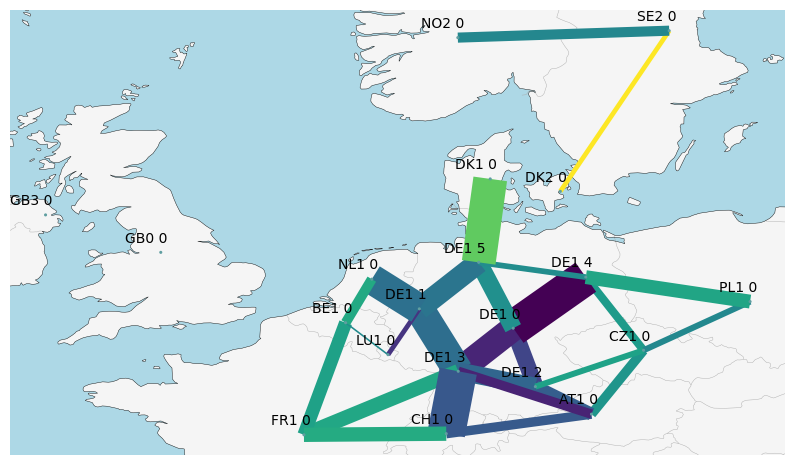

In [11]:
loading = (n.lines_t.p0.abs().mean().sort_index()/(n.lines.s_nom_opt*n.lines.s_max_pu).sort_index()).fillna(0.)

fig, ax = plt.subplots(
    figsize=(10,10),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

n.plot(
    ax=ax,
    branch_components=["Line"],
    line_widths=n.lines.s_nom_opt/1e3, #GW
    line_colors=loading,
    line_cmap=plt.cm.viridis,
    color_geomap=True,
    bus_sizes=0.003
)

bus = n.buses
region = []
for index, row in bus.iterrows():
    x = row['x']
    y = row['y']
    if "H2" in index:
        pass
    else:
        region.append(index)
        ax.annotate(
        index,
        xy=(x, y),
        xytext=(5, 5),  # Adjust the position of the annotation
        textcoords="offset points",
        ha='right', va='bottom'
    )

plt.show


## Installed Capacity Map Plot

In [12]:
#color list for installed cap
tech_list = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
tech_list.remove('load')
color_cap = []

for i in range(len(tech_list)):
    for j in range(len(n.carriers.index)):
        if tech_list[i] == n.carriers.index[j]:
            color_cap.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

cap = n.generators[n.generators['carrier']!='load'].groupby(['bus', 'carrier']).p_nom_opt.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3847545614.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_cap.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


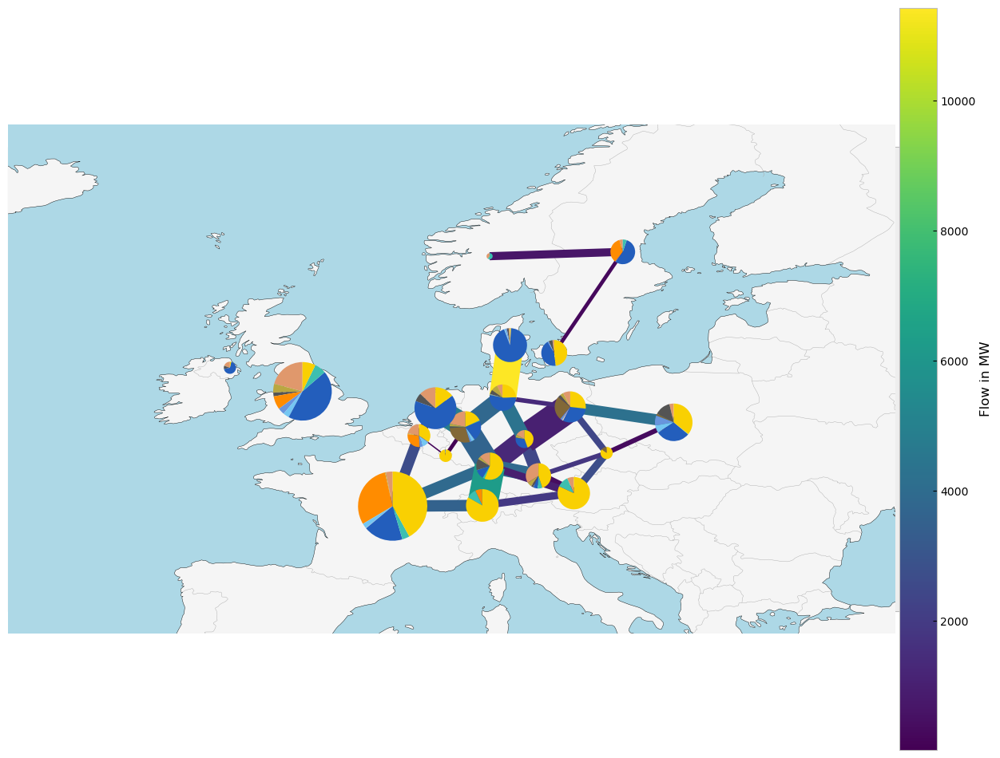

In [13]:
fig, ax = plt.subplots(
    figsize=(15,15),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

collection = n.plot(
    bus_sizes=cap / 5e4,
    bus_colors = color_cap,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
        
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Generation Map Plot

In [14]:
#color list for energy generated 
tech_list_gen_table = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
colors_gen_table = []

for i in range(len(tech_list_gen_table)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen_table[i] == n.carriers.index[j]:
            colors_gen_table.append(n.carriers.color[j])
            break  # break the inner loop once a match is found 

#Adjust Load shedding's unit to MW from kW
#for column in n.generators_t.p.columns:
#    if column.endswith('load') and not column.endswith('H2 load'):
#        n.generators_t.p[column]/=1e3
        

gen = n.generators.assign(g=n.generators_t.p.mean()).groupby(["bus", "carrier"]).g.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\971004373.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen_table.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


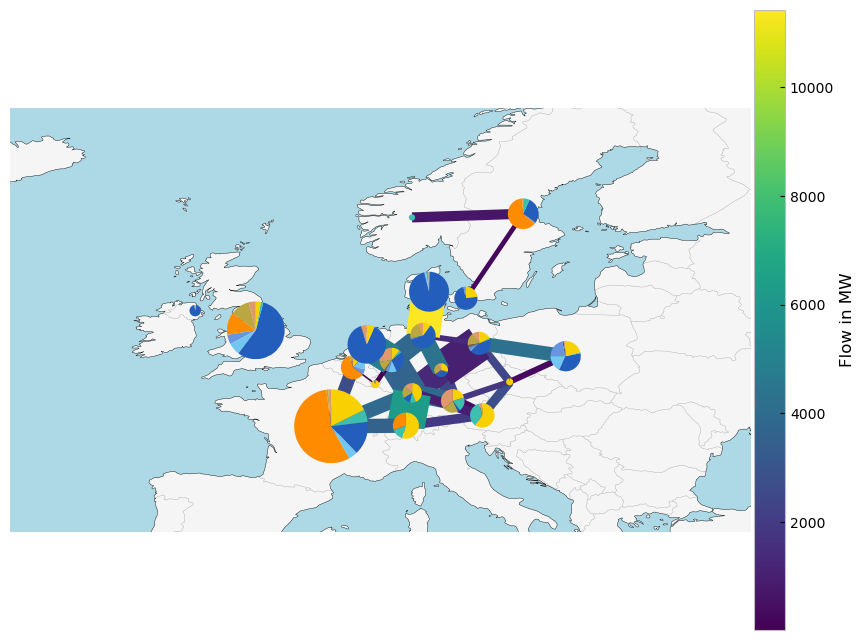

In [15]:
carriers = n.generators.carrier.unique()

plt.figure(figsize =(10,10))

collection = n.plot(
    bus_sizes=gen / 1e4,
    bus_colors = colors_gen_table,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Installed Capacity

<Figure size 640x480 with 0 Axes>

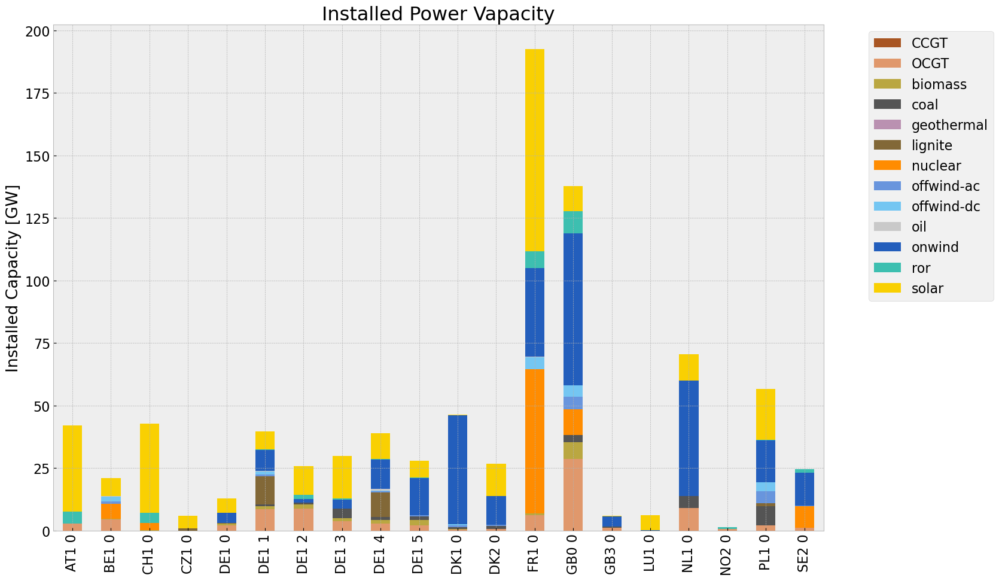

In [16]:
def inst_cap_table(n,colors):

    capacities = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Vapacity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_installed_cap.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    plt.show()

    

    return capacities

# consolidated istalled cap without load_shedding

#capacities_base = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_base.fillna(0, inplace=True)
#gen = (capacities_base.unstack()/1000).drop(columns=['load'],inplace=False)

capacities_base = inst_cap_table(n, color_cap)

<Figure size 640x480 with 0 Axes>

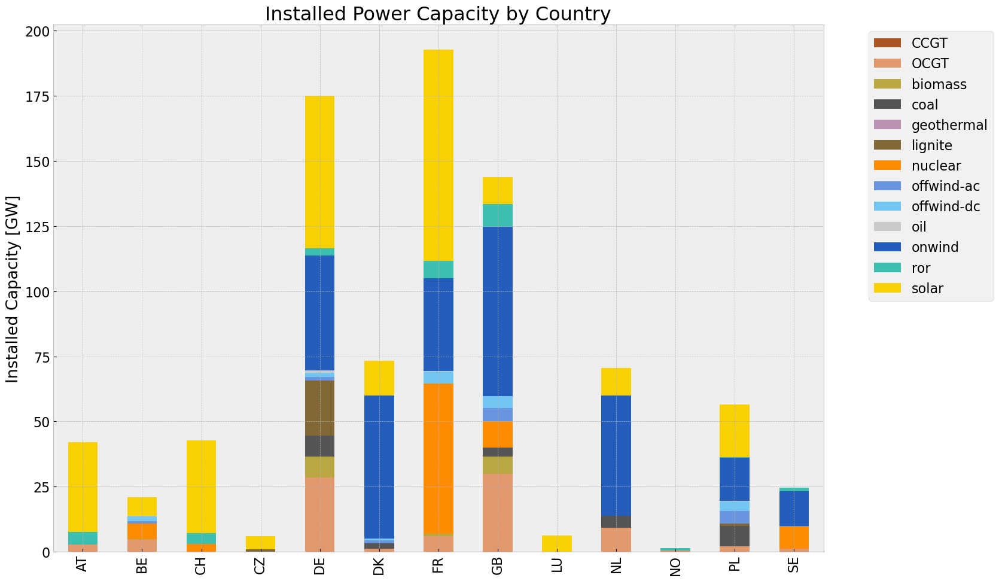

In [17]:
#aggregate installed capacities by country
def inst_cap_table_country(n,colors):
    
    model = n
    capacities = model.generators
    capacities['country'] = capacities['bus'].str[:2]
    capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Capacity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_installed_cap_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()
    
     

    return gen

cap_base_country= inst_cap_table_country(n, color_cap)

## Generation

<Figure size 640x480 with 0 Axes>

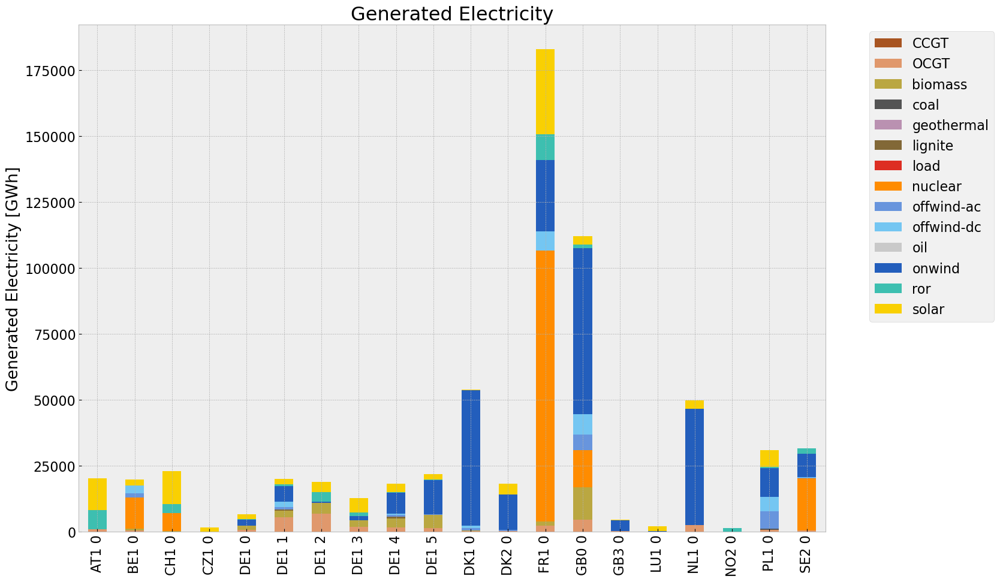

In [18]:
def gen_power_table(n, color):

    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack()/1000)#GWh
    #generations['load']/=1e3


    plt.figure()
    plt.rcParams.update({'font.size': 16})

    generations.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=color,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_gen_elec.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()

    

    return generations

gen_base = gen_power_table(n,colors_gen_table)

<Figure size 640x480 with 0 Axes>

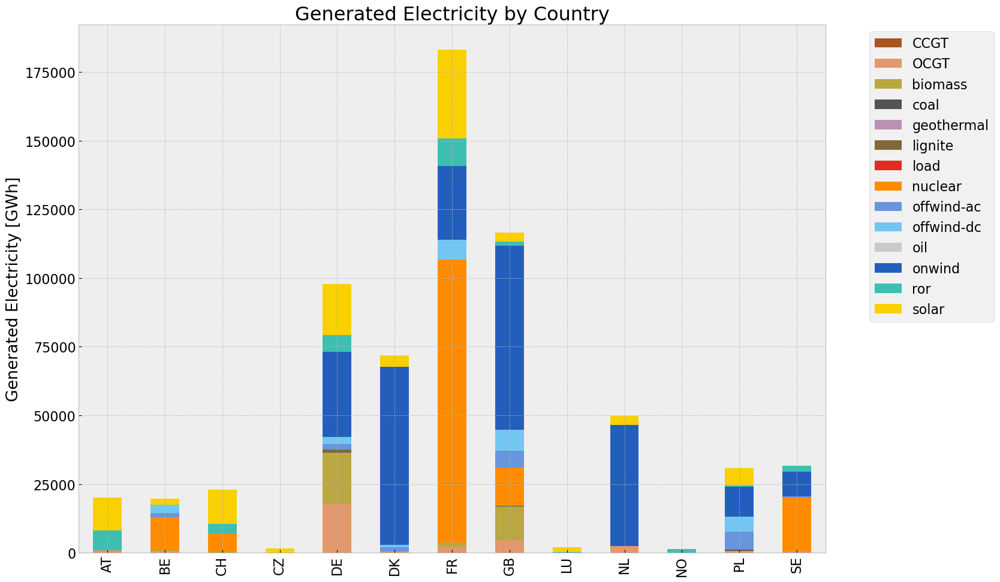

In [19]:
def gen_power_table_country(n, color):

    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    #generations = n.generators
    #generations['country'] = generations['bus'].str[:2]
    #generations = pd.Series(index = n.generators.groupby(['country', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack()/1000)#GWh
    generations['country'] = generations.index.str[:2]
    generations = generations.groupby(['country']).sum()   
    #generations['load']/=1e3


    plt.figure()
    plt.rcParams.update({'font.size': 16})

    generations.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=color,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_gen_elec_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    plt.show()
    return generations

gen_base_country = gen_power_table_country(n,colors_gen_table)

## Snapshot

In [20]:
sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()

#links = n.links_t.p0.groupby(n.links.carrier, axis =1).sum().drop(['DC','H2 electrolysis'], axis=1, inplace =False).head()
tech_list_gen = pd.concat([tech_list_gen, sto], axis=1).columns.tolist()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\318663498.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\318663498.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()


In [21]:
colors_gen = []

for i in range(len(tech_list_gen)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen[i] == n.carriers.index[j]:
            colors_gen.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\4040974225.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen.append(n.carriers.color[j])


In [22]:
def gen_curve(n, start, end, colors,ctr):

    plt.rcParams.update({'font.size': 16})

    #import export 
    lines_ctr_bus0 = n.lines[n.lines['bus0'].str.startswith(ctr) & ~n.lines['bus1'].str.startswith(ctr)].index
    lines_ctr_bus1 = n.lines[n.lines['bus1'].str.startswith(ctr) & ~n.lines['bus0'].str.startswith(ctr)].index
    links_ctr_bus0 = n.links[n.links['bus0'].str.startswith(ctr) & ~n.links['bus1'].str.startswith(ctr)].index
    links_ctr_bus1 = n.links[n.links['bus1'].str.startswith(ctr) & ~n.links['bus0'].str.startswith(ctr)].index


    df_lines_ctr_bus0 = n.lines_t.p0[lines_ctr_bus0]
    df_lines_ctr_bus1 = n.lines_t.p1[lines_ctr_bus1]
    df_links_ctr_bus0 = n.links_t.p0[links_ctr_bus0]
    df_links_ctr_bus1 = n.links_t.p1[links_ctr_bus1]


    import_export = pd.concat([df_lines_ctr_bus0, df_lines_ctr_bus1, df_links_ctr_bus0, df_links_ctr_bus1], axis=1).sum(axis=1)*-1 #MW

    columns_gen = [col for col in  n.generators_t.p.columns if col.startswith(ctr)]
    p_country = n.generators_t.p[columns_gen]

    p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
    

    #add import color
    colors.append('#133337') #for Import

    #p_by_carrier['load'] /= 1e3

    #links fuel cell
    #links = n.links_t.p1.groupby(n.links.carrier, axis=1).sum().div(1e3)
    #links = links.drop(columns='DC', inplace=False)
    #links['H2 fuel cell']*=-1
       
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        col_sto = [col for col in  n.storage_units_t.p.columns if col.startswith(ctr)]
        sto_ctr = n.storage_units_t.p[col_sto]
        sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier['Import/Export'] = import_export 
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='3H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    col_load = [col for col in  n.loads_t.p_set.columns if col.startswith(ctr)]
    loads_ctr = n.loads_t.p_set[col_load]
    loads = loads_ctr.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")
    ax.set_ylim(-50,150)
    # Save plot to the current working directory
    fig.tight_layout()
    filename = f"{n.name}_gen_{start}_to_{end}.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    
    

In [23]:
#e_balance = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC",:].droplevel(2)
#e_balance.to_excel('energybalance.xlsx', index=True) 


In [24]:
#tes = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :].droplevel(2)
#tes.to_csv('energybalance.csv', index=True)

In [25]:
#n.loads_t.p_set.sum(axis=1).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].div(1e3).plot(ax=ax, c='k',grid=True)


In [26]:
#p_by_carrier.where(p_by_carrier>0).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].sum(axis=1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jere

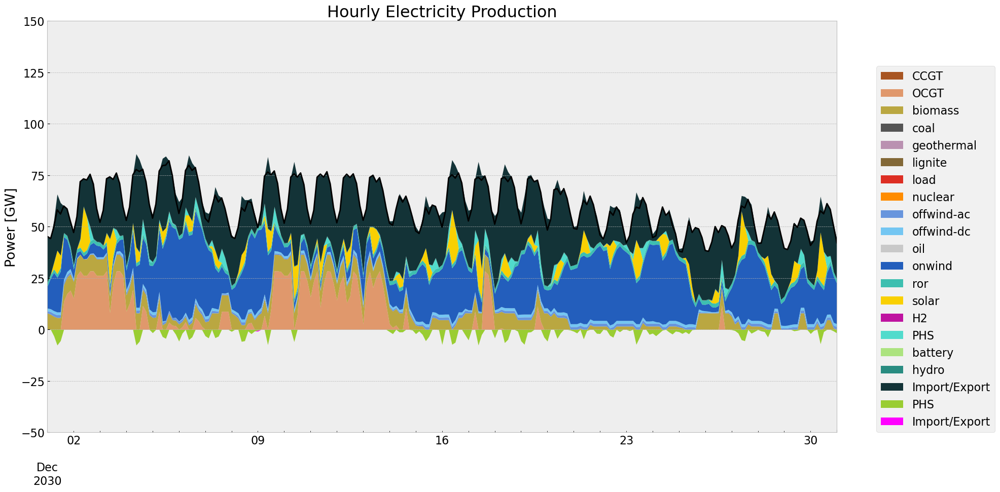

In [27]:
# winter
gen_curve(n, '2030-12-01', '2030-12-31', colors_gen,'DE')

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jere

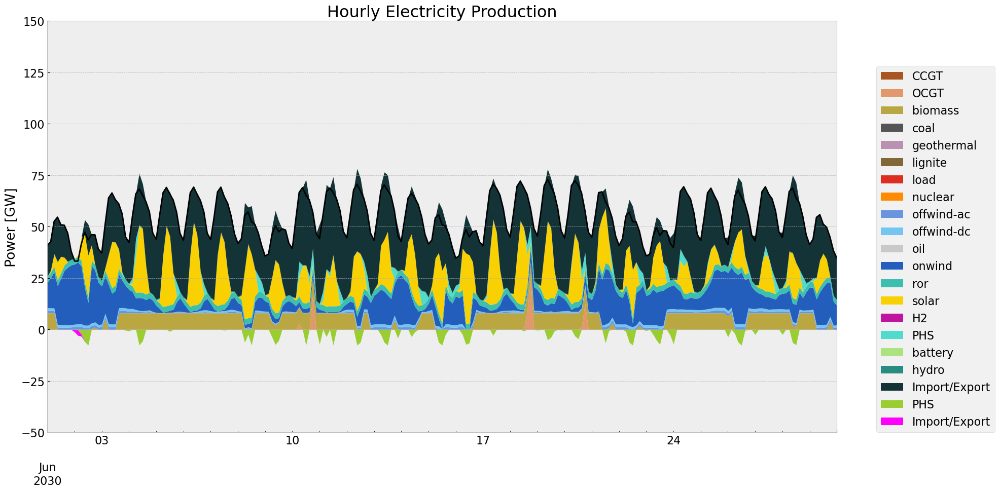

In [28]:
#summer
gen_curve(n, '2030-06-01', '2030-06-30', colors_gen,'DE')

In [29]:
def gen_curve_tot(n, start, end, colors):

    plt.rcParams.update({'font.size': 16})

    p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
    
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='3H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    loads = n.loads_t.p_set.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    ax.set_ylim(-50,370)
    fig.tight_layout()

    # Adjust the spacing around the plot (add extra space at the top)
    fig.subplots_adjust(top=0.95, right=0.85, left = 0.05)
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")

    filename = f"{n.name}_gen_{start}_to_{end}_total.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    
    plt.savefig(output_path)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='

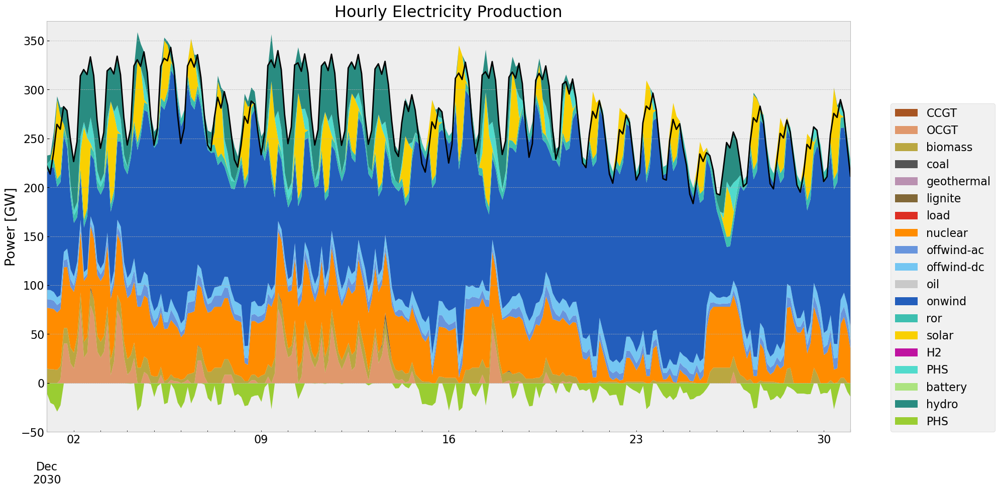

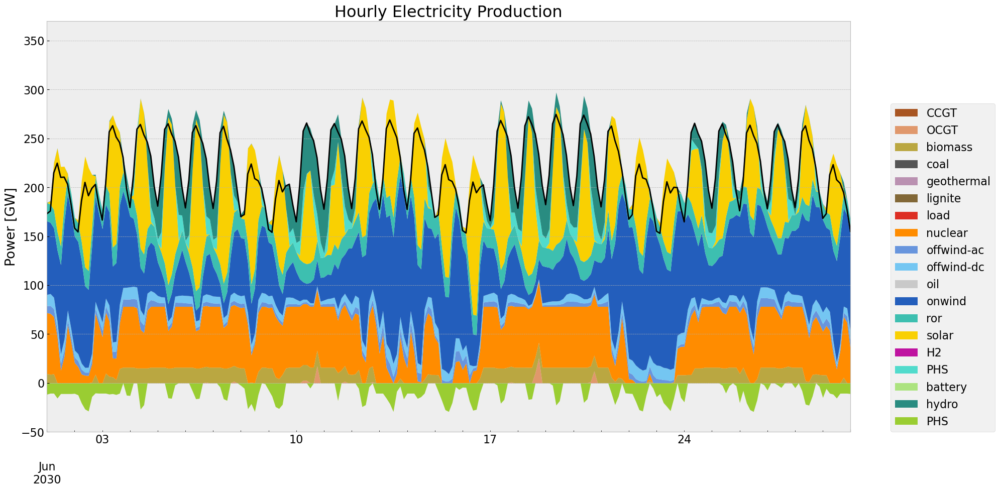

In [30]:
#generation curve all countries
#winter
gen_curve_tot(n, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n, '2030-06-01', '2030-06-30', colors_gen)

## Storage

In [31]:
def inst_store_table(n):
    
    plt.rcParams.update({'font.size': 16})
    storage = n.storage_units
    storage['country'] = storage['bus'].str[:2]

    (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000).plot.bar(figsize=(17,10),
                                stacked=True,
                                color=["yellowgreen","magenta","red","blue"],
                                grid=True,
                                xlabel="",
                                ylabel="Installed capacity [GW]",
                                title=f"Installed Power Capacity of Storage Systems By Country",
                                #ylim=[0,20]
    )
    store = storage.groupby(['country','carrier']).p_nom_opt.sum()/1000 #GW
    store.fillna(0, inplace=True)

    plt.tight_layout()

    filename = f"{n.name}_installed_storage.png" if hasattr(n, 'name') else "installed_storage.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    return store

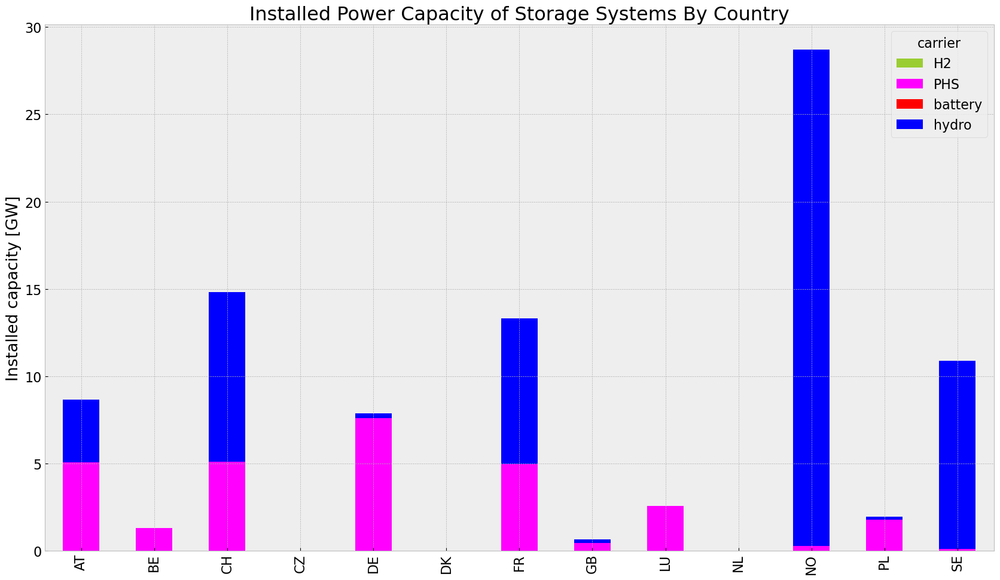

In [32]:
store_base = inst_store_table(n)

In [33]:
def state_of_charge_plot(n):
    
    soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)

    soc.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    soc.plot(ax=ax,
        grid=True,
        ylabel="State of charge [GWh]",
        xlabel="Time",
        title=f"State of charge of Storage Systems",
        linewidth=1.5,
    )
    plt.tight_layout()
    filename = f"{n.name}_soc.png" if hasattr(n, 'name') else "soc.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)



plt.show(n)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3576090030.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3576090030.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')


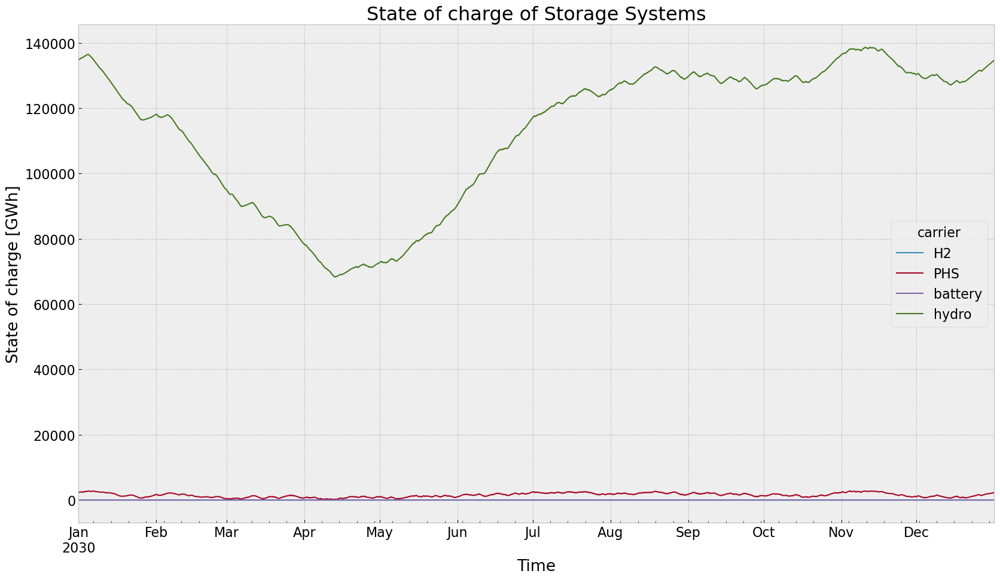

In [34]:
state_of_charge_plot(n)

## Electricity Price

In [35]:
def price_dur_curve_plot(n):

    #buses without store
    columns_to_keep =[]

    for i in n.buses_t.marginal_price.columns.tolist():
        if not i.endswith('H2'):
            columns_to_keep.append(i)
    
    price_dur_curve = pd.DataFrame()
    for region in columns_to_keep:
        price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    price_dur_curve.plot(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Time steps",
                    title=f"Duration curves of the marginal price",
                    linewidth=3,
)
    plt.tight_layout()
    filename = f"{n.name}_pd_curve.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
plt.show()

In [36]:
#columns_to_keep =[]

#for i in n.buses_t.marginal_price.columns.tolist():
    #if not i.endswith('H2'):
        #columns_to_keep.append(i)

#buses without store
#columns_to_keep =[]

#price_dur_curve = pd.DataFrame()
#for region in columns_to_keep:
    #price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)


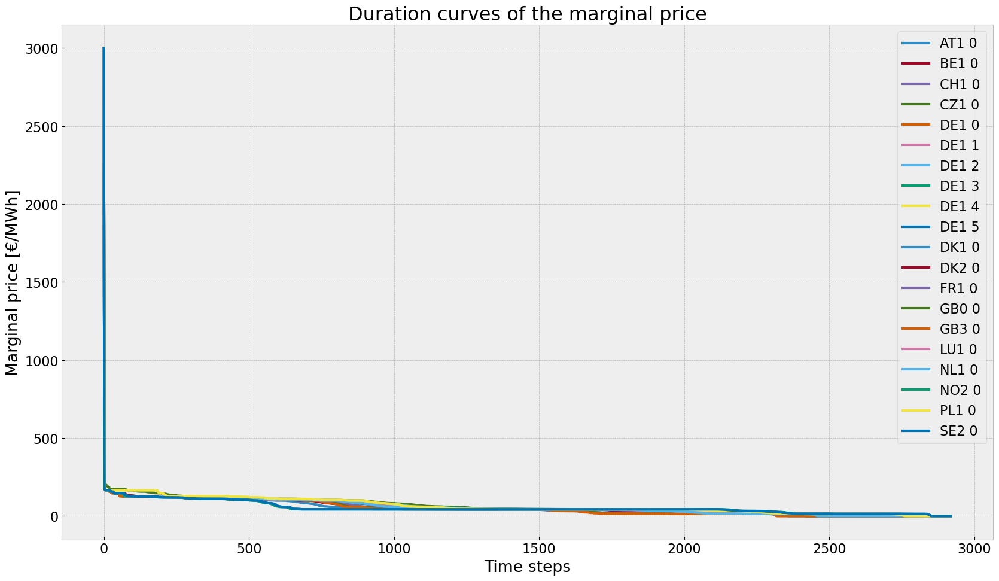

In [37]:
price_dur_curve_plot(n)

In [38]:
#demand weighted average electricity price
def price_regions_table(n):

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))
    
    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    
    price_df.plot.bar(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Region",
                    title=f"Demand-Weighted Average Marginal Price",
                    linewidth=3,
    )
    fig.tight_layout()                
    filename = f"{n.name}_average_eprice.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)                                    
    


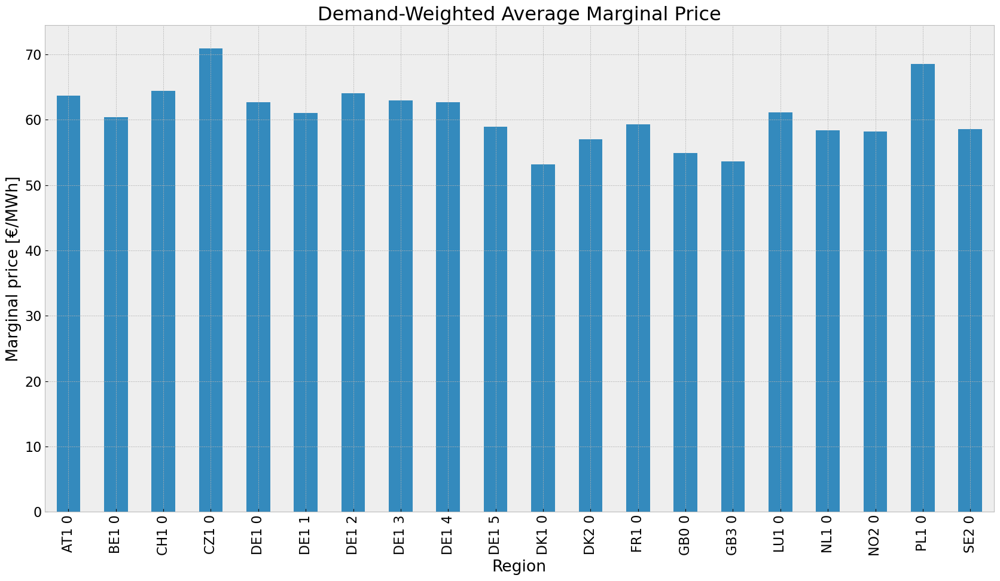

In [39]:
price_regions_table(n)

In [40]:
def price_regions(n):
    # Assuming 'n.buses_t.marginal_price' returns a DataFrame or similar structure with 'mean()' method

    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    #hprice = mean_p.filter(like='H2')
    #eprice = mean_p.drop(hprice.index)

    # Setup figure and subplots with 1 row and 2 columns
    fig, ax = plt.subplots(subplot_kw={"projection": ccrs.PlateCarree()}, figsize=(8, 8))

    # Plot for eprice
    hb= plt.hexbin(
        n.buses.x,
        n.buses.y,
        gridsize=20,
        C=price_df,
        cmap=plt.cm.jet,
        zorder=3,
    )

    n.plot(ax=ax, line_widths=pd.Series(0.5, n.lines.index), bus_sizes=0)  # Plot network on the second subplot

    ax.set_title("Demand-Weighted Average Marginal Price")
    
    cb = fig.colorbar(hb, ax=ax, location='bottom')
    cb.set_label("Mean Electricity Marginal Price (EUR/MWh)")

    fig.tight_layout()
    filename = f"{n.name}_price_map.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


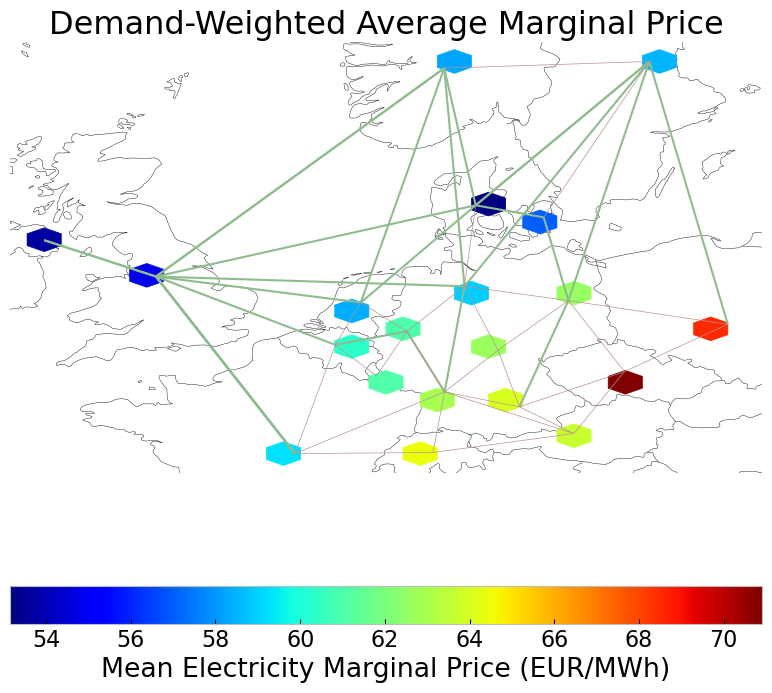

In [41]:
price_regions(n)

## Emission

In [42]:
def em_table(n):
    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack())#MWh

    #mean efficiency of each carrier
    eff = n.generators.groupby('carrier').efficiency.mean()

    e = generations.sum()
    emission = []

    for index in e.index:
        for index_c in n.carriers.index:
            for index_eff in eff.index:
                if index == index_c == index_eff:
                    em = n.carriers.loc[index_c,"co2_emissions"]
                    emission.append(em)

    df = e.to_frame()
    df.rename(columns={0: 'Generation in MWh'}, inplace=True)
    df['efficiency'] = eff
    df['emissions in Tonnes CO2/MWh'] = emission
    df['emissions in Tonnes CO2']= df['Generation in MWh']/df['efficiency']*df['emissions in Tonnes CO2/MWh']
    df['emissions in Tonnes CO2'].sum() 
    return df

em_base =em_table(n)
em_base

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,2.950103e+07,0.451621,0.1980,1.293387e+07
biomass,3.377481e+07,0.468000,0.0000,0.000000e+00
coal,7.117319e+05,0.329908,0.3361,7.250902e+05
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,9.211707e+05,0.337285,0.4069,1.111300e+06
load,3.775349e+03,1.000000,0.0000,0.000000e+00
nuclear,1.554148e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.794435e+07,1.000000,0.0000,0.000000e+00


# Biggest Dispatch Cut Scenario



In [315]:
#p_max_pu of biggest dispatchable generator
cut_start=pd.to_datetime('2013-02-01 00:00:00')
duration = 180 #days
#cut_end = pd.to_datetime('2013-12-31 21:00:00')
reductionto = 0.0
country = 'DE'

def dispatchscenario(n, cut_start, duration, reductionto):
    #copy network
    n_new=n.copy()
    cut_end = cut_start + pd.Timedelta(days= duration)

    gen = n_new.generators
    gen_disp = gen[~gen['carrier'].isin(['load','solar','onwind','offwind-dc','offwind-ac'])] #filter out intermitent geenerators, laod and AC, DC

    gen_disp_ctr = gen_disp[gen_disp.index.str.startswith(country)] #choose country
    gen_disp_ctr = gen_disp_ctr.sort_values(by=['p_nom'], ascending = False)
    cut = gen_disp_ctr.index[0]

    if cut not in n_new.generators_t.p_max_pu.columns:
        n_new.generators_t.p_max_pu[cut] = 1

    for index,row in n_new.generators_t.p_max_pu[cut].items():
        if index >= cut_start and index <= cut_end:
                n_new.generators_t.p_max_pu.at[index, cut] = reductionto



    return n_new


n1 = dispatchscenario(n, cut_start, duration, reductionto)
n1.name = 'inv_dispatchcut'          

## 1. Scenario: allow additional investment of extendable generators and storage

### Allow investment

In [316]:
def allow_inv(n1,n):
    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n1.generators.p_nom_extendable.items():
        if value:  
            n1.generators.at[index, 'p_nom_min'] = n.generators.at[index, 'p_nom_opt']


    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n1.storage_units.p_nom_extendable.items():
        if value:  
            n1.storage_units.at[index, 'p_nom_min'] = n.storage_units.at[index, 'p_nom_opt']

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n1.lines.s_nom_extendable.items():
        if value:  
            n1.lines.at[index, 's_nom_min'] = n.lines.at[index, 's_nom_opt']

    #set the optimal capacity of links from the base scenario as the new minimum capacity 
    for index, value in n1.links.p_nom_extendable.items():
        if value:  
            n1.links.at[index, 'p_nom_min'] = n.links.at[index, 'p_nom_opt'] 

allow_inv(n1,n)

In [317]:
n1.optimize(solver_name= "gurobi")
#n1 = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\Dispatchcut\\20240512\\inv_dispatchcut.nc")

Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:05<00:00,  2.10it/s]
INFO:linopy.io: Writing time: 39.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ah8a86x8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ah8a86x8.lp


Reading time = 11.51 seconds


INFO:gurobipy:Reading time = 11.51 seconds


obj: 3264863 rows, 1521502 columns, 6235954 nonzeros


INFO:gurobipy:obj: 3264863 rows, 1521502 columns, 6235954 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3264863 rows, 1521502 columns and 6235954 nonzeros


INFO:gurobipy:Optimize a model with 3264863 rows, 1521502 columns and 6235954 nonzeros


Model fingerprint: 0x16c0fc50


INFO:gurobipy:Model fingerprint: 0x16c0fc50


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 1e+03]


INFO:gurobipy:  Matrix range     [1e-02, 1e+03]


  Objective range  [3e-02, 3e+05]


INFO:gurobipy:  Objective range  [3e-02, 3e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 2150043 rows and 375285 columns (presolve time = 5s) ...


INFO:gurobipy:Presolve removed 2150043 rows and 375285 columns (presolve time = 5s) ...


Presolve removed 2150043 rows and 375285 columns


INFO:gurobipy:Presolve removed 2150043 rows and 375285 columns


Presolve time: 6.60s


INFO:gurobipy:Presolve time: 6.60s


Presolved: 1114820 rows, 1146217 columns, 3734897 nonzeros


INFO:gurobipy:Presolved: 1114820 rows, 1146217 columns, 3734897 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Elapsed ordering time = 8s


INFO:gurobipy:Elapsed ordering time = 8s


Ordering time: 14.13s


INFO:gurobipy:Ordering time: 14.13s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 172


INFO:gurobipy: Dense cols : 172


 AA' NZ     : 3.970e+06


INFO:gurobipy: AA' NZ     : 3.970e+06


 Factor NZ  : 2.876e+07 (roughly 1.1 GB of memory)


INFO:gurobipy: Factor NZ  : 2.876e+07 (roughly 1.1 GB of memory)


 Factor Ops : 5.991e+09 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.991e+09 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.28241881e+17 -8.22830599e+18  2.82e+10 8.68e+04  8.55e+13    25s


INFO:gurobipy:   0   6.28241881e+17 -8.22830599e+18  2.82e+10 8.68e+04  8.55e+13    25s


   1   5.49857689e+17 -3.53980973e+18  1.80e+10 2.86e+04  5.44e+13    27s


INFO:gurobipy:   1   5.49857689e+17 -3.53980973e+18  1.80e+10 2.86e+04  5.44e+13    27s


   2   4.53317130e+17 -1.79105848e+18  1.43e+10 1.11e+04  3.76e+13    29s


INFO:gurobipy:   2   4.53317130e+17 -1.79105848e+18  1.43e+10 1.11e+04  3.76e+13    29s


   3   3.23472553e+17 -1.07273620e+18  7.43e+09 4.40e+03  1.89e+13    31s


INFO:gurobipy:   3   3.23472553e+17 -1.07273620e+18  7.43e+09 4.40e+03  1.89e+13    31s


   4   2.72983948e+17 -4.85504654e+17  2.88e+09 1.20e+03  7.15e+12    33s


INFO:gurobipy:   4   2.72983948e+17 -4.85504654e+17  2.88e+09 1.20e+03  7.15e+12    33s


   5   2.03714837e+17 -1.12873578e+17  1.07e+09 2.53e+02  2.52e+12    35s


INFO:gurobipy:   5   2.03714837e+17 -1.12873578e+17  1.07e+09 2.53e+02  2.52e+12    35s


   6   5.07578866e+16 -2.08659117e+16  7.27e+07 2.24e+01  1.93e+11    37s


INFO:gurobipy:   6   5.07578866e+16 -2.08659117e+16  7.27e+07 2.24e+01  1.93e+11    37s


   7   9.68983919e+15 -3.70854304e+15  4.63e+06 1.43e+00  1.53e+10    39s


INFO:gurobipy:   7   9.68983919e+15 -3.70854304e+15  4.63e+06 1.43e+00  1.53e+10    39s


   8   2.44248218e+15 -7.43046715e+14  9.09e+05 1.81e-03  3.09e+09    41s


INFO:gurobipy:   8   2.44248218e+15 -7.43046715e+14  9.09e+05 1.81e-03  3.09e+09    41s


   9   1.61009933e+15 -4.32116974e+14  5.85e+05 2.99e-04  1.92e+09    43s


INFO:gurobipy:   9   1.61009933e+15 -4.32116974e+14  5.85e+05 2.99e-04  1.92e+09    43s


  10   1.16080854e+15 -2.92115366e+14  4.07e+05 7.04e-05  1.29e+09    45s


INFO:gurobipy:  10   1.16080854e+15 -2.92115366e+14  4.07e+05 7.04e-05  1.29e+09    45s


  11   8.48458983e+14 -1.64808426e+14  2.89e+05 3.96e-06  8.49e+08    47s


INFO:gurobipy:  11   8.48458983e+14 -1.64808426e+14  2.89e+05 3.96e-06  8.49e+08    47s


  12   6.21910811e+14 -1.09782298e+14  2.05e+05 1.50e-05  5.78e+08    49s


INFO:gurobipy:  12   6.21910811e+14 -1.09782298e+14  2.05e+05 1.50e-05  5.78e+08    49s


  13   4.00132816e+14 -7.66265163e+13  1.27e+05 7.74e-05  3.48e+08    51s


INFO:gurobipy:  13   4.00132816e+14 -7.66265163e+13  1.27e+05 7.74e-05  3.48e+08    51s


  14   2.57999658e+14 -4.43248697e+13  7.93e+04 1.08e-04  2.08e+08    53s


INFO:gurobipy:  14   2.57999658e+14 -4.43248697e+13  7.93e+04 1.08e-04  2.08e+08    53s


  15   2.03421995e+14 -2.69187024e+13  6.25e+04 3.18e-05  1.52e+08    55s


INFO:gurobipy:  15   2.03421995e+14 -2.69187024e+13  6.25e+04 3.18e-05  1.52e+08    55s


  16   1.06009396e+14 -1.78933893e+13  3.14e+04 7.00e-06  7.58e+07    57s


INFO:gurobipy:  16   1.06009396e+14 -1.78933893e+13  3.14e+04 7.00e-06  7.58e+07    57s


  17   8.78572051e+13 -1.12562691e+13  2.59e+04 2.38e-06  5.87e+07    58s


INFO:gurobipy:  17   8.78572051e+13 -1.12562691e+13  2.59e+04 2.38e-06  5.87e+07    58s


  18   4.84479371e+13 -7.80674949e+12  1.38e+04 2.59e-05  3.12e+07    61s


INFO:gurobipy:  18   4.84479371e+13 -7.80674949e+12  1.38e+04 2.59e-05  3.12e+07    61s


  19   3.04742497e+13 -6.43068670e+12  8.57e+03 1.82e-05  1.99e+07    63s


INFO:gurobipy:  19   3.04742497e+13 -6.43068670e+12  8.57e+03 1.82e-05  1.99e+07    63s


  20   2.45155484e+13 -5.31784687e+12  6.95e+03 1.37e-05  1.57e+07    65s


INFO:gurobipy:  20   2.45155484e+13 -5.31784687e+12  6.95e+03 1.37e-05  1.57e+07    65s


  21   2.14816175e+13 -5.09754107e+12  6.08e+03 1.26e-05  1.39e+07    67s


INFO:gurobipy:  21   2.14816175e+13 -5.09754107e+12  6.08e+03 1.26e-05  1.39e+07    67s


  22   1.55840530e+13 -4.75204762e+12  4.38e+03 9.96e-06  1.04e+07    69s


INFO:gurobipy:  22   1.55840530e+13 -4.75204762e+12  4.38e+03 9.96e-06  1.04e+07    69s


  23   1.00461882e+13 -3.99389619e+12  2.78e+03 6.30e-06  6.99e+06    71s


INFO:gurobipy:  23   1.00461882e+13 -3.99389619e+12  2.78e+03 6.30e-06  6.99e+06    71s


  24   6.07392506e+12 -2.89291224e+12  1.77e+03 1.65e-06  4.34e+06    73s


INFO:gurobipy:  24   6.07392506e+12 -2.89291224e+12  1.77e+03 1.65e-06  4.34e+06    73s


  25   2.57201315e+12 -2.10911773e+12  6.67e+02 1.31e-06  2.13e+06    76s


INFO:gurobipy:  25   2.57201315e+12 -2.10911773e+12  6.67e+02 1.31e-06  2.13e+06    76s


  26   2.18871183e+12 -1.79560800e+12  5.60e+02 1.62e-06  1.80e+06    79s


INFO:gurobipy:  26   2.18871183e+12 -1.79560800e+12  5.60e+02 1.62e-06  1.80e+06    79s


  27   1.94593011e+12 -1.60289697e+12  4.91e+02 1.25e-06  1.59e+06    82s


INFO:gurobipy:  27   1.94593011e+12 -1.60289697e+12  4.91e+02 1.25e-06  1.59e+06    82s


  28   1.19782275e+12 -1.39508837e+12  2.79e+02 9.39e-07  1.13e+06    84s


INFO:gurobipy:  28   1.19782275e+12 -1.39508837e+12  2.79e+02 9.39e-07  1.13e+06    84s


  29   9.53163271e+11 -1.09676609e+12  2.12e+02 1.22e-06  8.85e+05    86s


INFO:gurobipy:  29   9.53163271e+11 -1.09676609e+12  2.12e+02 1.22e-06  8.85e+05    86s


  30   6.86125092e+11 -9.82876244e+11  1.43e+02 9.69e-07  7.11e+05    89s


INFO:gurobipy:  30   6.86125092e+11 -9.82876244e+11  1.43e+02 9.69e-07  7.11e+05    89s


  31   5.98748632e+11 -8.14671480e+11  1.22e+02 6.26e-07  6.00e+05    92s


INFO:gurobipy:  31   5.98748632e+11 -8.14671480e+11  1.22e+02 6.26e-07  6.00e+05    92s


  32   5.30817802e+11 -6.31244281e+11  1.05e+02 3.73e-07  4.92e+05    95s


INFO:gurobipy:  32   5.30817802e+11 -6.31244281e+11  1.05e+02 3.73e-07  4.92e+05    95s


  33   3.72634176e+11 -4.33417618e+11  6.85e+01 5.66e-07  3.39e+05    98s


INFO:gurobipy:  33   3.72634176e+11 -4.33417618e+11  6.85e+01 5.66e-07  3.39e+05    98s


  34   2.27984573e+11 -2.13714854e+11  3.44e+01 8.94e-07  1.84e+05   101s


INFO:gurobipy:  34   2.27984573e+11 -2.13714854e+11  3.44e+01 8.94e-07  1.84e+05   101s


  35   1.85727275e+11 -6.35976509e+10  2.53e+01 8.87e-07  1.04e+05   104s


INFO:gurobipy:  35   1.85727275e+11 -6.35976509e+10  2.53e+01 8.87e-07  1.04e+05   104s


  36   1.48382274e+11 -4.33483912e+09  1.80e+01 4.14e-06  6.41e+04   106s


INFO:gurobipy:  36   1.48382274e+11 -4.33483912e+09  1.80e+01 4.14e-06  6.41e+04   106s


  37   1.36426756e+11  1.09795574e+10  1.57e+01 2.03e-06  5.28e+04   108s


INFO:gurobipy:  37   1.36426756e+11  1.09795574e+10  1.57e+01 2.03e-06  5.28e+04   108s


  38   1.26425365e+11  1.52859308e+10  1.37e+01 1.25e-06  4.67e+04   109s


INFO:gurobipy:  38   1.26425365e+11  1.52859308e+10  1.37e+01 1.25e-06  4.67e+04   109s


  39   1.13859126e+11  2.34645258e+10  1.13e+01 4.72e-07  3.80e+04   111s


INFO:gurobipy:  39   1.13859126e+11  2.34645258e+10  1.13e+01 4.72e-07  3.80e+04   111s


  40   1.02733454e+11  2.66446243e+10  9.33e+00 3.36e-07  3.20e+04   113s


INFO:gurobipy:  40   1.02733454e+11  2.66446243e+10  9.33e+00 3.36e-07  3.20e+04   113s


  41   9.41727849e+10  3.48674807e+10  7.73e+00 9.83e-07  2.50e+04   115s


INFO:gurobipy:  41   9.41727849e+10  3.48674807e+10  7.73e+00 9.83e-07  2.50e+04   115s


  42   8.26496921e+10  3.86727673e+10  5.60e+00 1.34e-06  1.85e+04   118s


INFO:gurobipy:  42   8.26496921e+10  3.86727673e+10  5.60e+00 1.34e-06  1.85e+04   118s


  43   7.83630436e+10  4.22652498e+10  4.81e+00 4.62e-07  1.52e+04   121s


INFO:gurobipy:  43   7.83630436e+10  4.22652498e+10  4.81e+00 4.62e-07  1.52e+04   121s


  44   7.24543540e+10  4.43010107e+10  3.69e+00 4.56e-07  1.19e+04   124s


INFO:gurobipy:  44   7.24543540e+10  4.43010107e+10  3.69e+00 4.56e-07  1.19e+04   124s


  45   6.95771505e+10  4.65581467e+10  3.13e+00 4.13e-07  9.72e+03   127s


INFO:gurobipy:  45   6.95771505e+10  4.65581467e+10  3.13e+00 4.13e-07  9.72e+03   127s


  46   6.49746027e+10  4.81894925e+10  2.27e+00 6.96e-07  7.08e+03   130s


INFO:gurobipy:  46   6.49746027e+10  4.81894925e+10  2.27e+00 6.96e-07  7.08e+03   130s


  47   6.26131839e+10  4.87074601e+10  1.81e+00 7.17e-07  5.86e+03   133s


INFO:gurobipy:  47   6.26131839e+10  4.87074601e+10  1.81e+00 7.17e-07  5.86e+03   133s


  48   6.09480277e+10  4.95908252e+10  1.48e+00 3.59e-07  4.79e+03   136s


INFO:gurobipy:  48   6.09480277e+10  4.95908252e+10  1.48e+00 3.59e-07  4.79e+03   136s


  49   5.96970358e+10  5.04803995e+10  1.22e+00 4.77e-07  3.89e+03   139s


INFO:gurobipy:  49   5.96970358e+10  5.04803995e+10  1.22e+00 4.77e-07  3.89e+03   139s


  50   5.80900858e+10  5.07475834e+10  9.04e-01 3.95e-07  3.09e+03   142s


INFO:gurobipy:  50   5.80900858e+10  5.07475834e+10  9.04e-01 3.95e-07  3.09e+03   142s


  51   5.74541867e+10  5.14573746e+10  7.74e-01 4.01e-07  2.53e+03   145s


INFO:gurobipy:  51   5.74541867e+10  5.14573746e+10  7.74e-01 4.01e-07  2.53e+03   145s


  52   5.67674181e+10  5.16897113e+10  6.36e-01 4.47e-07  2.14e+03   148s


INFO:gurobipy:  52   5.67674181e+10  5.16897113e+10  6.36e-01 4.47e-07  2.14e+03   148s


  53   5.63562365e+10  5.18844014e+10  5.51e-01 2.83e-07  1.88e+03   150s


INFO:gurobipy:  53   5.63562365e+10  5.18844014e+10  5.51e-01 2.83e-07  1.88e+03   150s


  54   5.62170640e+10  5.20345761e+10  5.23e-01 9.83e-07  1.76e+03   153s


INFO:gurobipy:  54   5.62170640e+10  5.20345761e+10  5.23e-01 9.83e-07  1.76e+03   153s


  55   5.61465842e+10  5.21096178e+10  5.08e-01 9.39e-07  1.70e+03   155s


INFO:gurobipy:  55   5.61465842e+10  5.21096178e+10  5.08e-01 9.39e-07  1.70e+03   155s


  56   5.59433833e+10  5.23654329e+10  4.66e-01 2.40e-07  1.51e+03   158s


INFO:gurobipy:  56   5.59433833e+10  5.23654329e+10  4.66e-01 2.40e-07  1.51e+03   158s


  57   5.56292730e+10  5.25043384e+10  3.80e-01 4.02e-07  1.31e+03   160s


INFO:gurobipy:  57   5.56292730e+10  5.25043384e+10  3.80e-01 4.02e-07  1.31e+03   160s


  58   5.53625804e+10  5.25628815e+10  3.31e-01 8.34e-07  1.17e+03   163s


INFO:gurobipy:  58   5.53625804e+10  5.25628815e+10  3.31e-01 8.34e-07  1.17e+03   163s


  59   5.52292790e+10  5.27648846e+10  3.04e-01 1.64e-06  1.03e+03   166s


INFO:gurobipy:  59   5.52292790e+10  5.27648846e+10  3.04e-01 1.64e-06  1.03e+03   166s


  60   5.51268528e+10  5.28515946e+10  2.84e-01 1.33e-06  9.56e+02   169s


INFO:gurobipy:  60   5.51268528e+10  5.28515946e+10  2.84e-01 1.33e-06  9.56e+02   169s


  61   5.50285859e+10  5.29937240e+10  2.64e-01 1.10e-06  8.56e+02   172s


INFO:gurobipy:  61   5.50285859e+10  5.29937240e+10  2.64e-01 1.10e-06  8.56e+02   172s


  62   5.49190130e+10  5.30408301e+10  2.39e-01 1.04e-06  7.89e+02   174s


INFO:gurobipy:  62   5.49190130e+10  5.30408301e+10  2.39e-01 1.04e-06  7.89e+02   174s


  63   5.47957852e+10  5.30992219e+10  2.12e-01 4.77e-07  7.12e+02   177s


INFO:gurobipy:  63   5.47957852e+10  5.30992219e+10  2.12e-01 4.77e-07  7.12e+02   177s


  64   5.47078965e+10  5.31571647e+10  1.94e-01 5.05e-07  6.51e+02   180s


INFO:gurobipy:  64   5.47078965e+10  5.31571647e+10  1.94e-01 5.05e-07  6.51e+02   180s


  65   5.46426681e+10  5.32165186e+10  1.80e-01 3.87e-07  5.99e+02   182s


INFO:gurobipy:  65   5.46426681e+10  5.32165186e+10  1.80e-01 3.87e-07  5.99e+02   182s


  66   5.45949429e+10  5.32897360e+10  1.70e-01 4.92e-07  5.48e+02   185s


INFO:gurobipy:  66   5.45949429e+10  5.32897360e+10  1.70e-01 4.92e-07  5.48e+02   185s


  67   5.44934694e+10  5.33214668e+10  1.48e-01 3.37e-07  4.92e+02   188s


INFO:gurobipy:  67   5.44934694e+10  5.33214668e+10  1.48e-01 3.37e-07  4.92e+02   188s


  68   5.44125710e+10  5.34022583e+10  1.32e-01 7.60e-07  4.24e+02   191s


INFO:gurobipy:  68   5.44125710e+10  5.34022583e+10  1.32e-01 7.60e-07  4.24e+02   191s


  69   5.43487382e+10  5.34239837e+10  1.20e-01 9.24e-07  3.88e+02   194s


INFO:gurobipy:  69   5.43487382e+10  5.34239837e+10  1.20e-01 9.24e-07  3.88e+02   194s


  70   5.42899755e+10  5.34654173e+10  1.08e-01 1.09e-06  3.46e+02   197s


INFO:gurobipy:  70   5.42899755e+10  5.34654173e+10  1.08e-01 1.09e-06  3.46e+02   197s


  71   5.42420548e+10  5.34905754e+10  9.93e-02 5.96e-07  3.15e+02   200s


INFO:gurobipy:  71   5.42420548e+10  5.34905754e+10  9.93e-02 5.96e-07  3.15e+02   200s


  72   5.41689821e+10  5.35028804e+10  8.52e-02 3.65e-07  2.79e+02   202s


INFO:gurobipy:  72   5.41689821e+10  5.35028804e+10  8.52e-02 3.65e-07  2.79e+02   202s


  73   5.41309419e+10  5.35108196e+10  7.77e-02 2.86e-07  2.60e+02   205s


INFO:gurobipy:  73   5.41309419e+10  5.35108196e+10  7.77e-02 2.86e-07  2.60e+02   205s


  74   5.41227747e+10  5.35223747e+10  7.61e-02 3.97e-07  2.51e+02   207s


INFO:gurobipy:  74   5.41227747e+10  5.35223747e+10  7.61e-02 3.97e-07  2.51e+02   207s


  75   5.41013462e+10  5.35335609e+10  7.18e-02 2.14e-07  2.38e+02   210s


INFO:gurobipy:  75   5.41013462e+10  5.35335609e+10  7.18e-02 2.14e-07  2.38e+02   210s


  76   5.40672467e+10  5.35550601e+10  6.49e-02 2.42e-07  2.14e+02   213s


INFO:gurobipy:  76   5.40672467e+10  5.35550601e+10  6.49e-02 2.42e-07  2.14e+02   213s


  77   5.40339737e+10  5.35743906e+10  5.82e-02 1.99e-07  1.92e+02   216s


INFO:gurobipy:  77   5.40339737e+10  5.35743906e+10  5.82e-02 1.99e-07  1.92e+02   216s


  78   5.40023987e+10  5.35878340e+10  5.19e-02 2.45e-07  1.73e+02   220s


INFO:gurobipy:  78   5.40023987e+10  5.35878340e+10  5.19e-02 2.45e-07  1.73e+02   220s


  79   5.39702377e+10  5.35978006e+10  4.55e-02 4.82e-07  1.56e+02   223s


INFO:gurobipy:  79   5.39702377e+10  5.35978006e+10  4.55e-02 4.82e-07  1.56e+02   223s


  80   5.39531704e+10  5.36125371e+10  4.22e-02 3.83e-07  1.42e+02   226s


INFO:gurobipy:  80   5.39531704e+10  5.36125371e+10  4.22e-02 3.83e-07  1.42e+02   226s


  81   5.39290714e+10  5.36232569e+10  3.75e-02 3.62e-07  1.28e+02   229s


INFO:gurobipy:  81   5.39290714e+10  5.36232569e+10  3.75e-02 3.62e-07  1.28e+02   229s


  82   5.39230941e+10  5.36258580e+10  3.63e-02 2.89e-07  1.24e+02   231s


INFO:gurobipy:  82   5.39230941e+10  5.36258580e+10  3.63e-02 2.89e-07  1.24e+02   231s


  83   5.39137730e+10  5.36326936e+10  3.45e-02 1.94e-07  1.17e+02   234s


INFO:gurobipy:  83   5.39137730e+10  5.36326936e+10  3.45e-02 1.94e-07  1.17e+02   234s


  84   5.38850041e+10  5.36418453e+10  2.89e-02 2.70e-07  1.01e+02   237s


INFO:gurobipy:  84   5.38850041e+10  5.36418453e+10  2.89e-02 2.70e-07  1.01e+02   237s


  85   5.38737627e+10  5.36544975e+10  2.67e-02 2.20e-07  9.16e+01   240s


INFO:gurobipy:  85   5.38737627e+10  5.36544975e+10  2.67e-02 2.20e-07  9.16e+01   240s


  86   5.38694584e+10  5.36656424e+10  2.59e-02 2.51e-07  8.52e+01   243s


INFO:gurobipy:  86   5.38694584e+10  5.36656424e+10  2.59e-02 2.51e-07  8.52e+01   243s


  87   5.38535161e+10  5.36690308e+10  2.29e-02 2.53e-07  7.71e+01   246s


INFO:gurobipy:  87   5.38535161e+10  5.36690308e+10  2.29e-02 2.53e-07  7.71e+01   246s


  88   5.38405136e+10  5.36746970e+10  2.04e-02 3.13e-07  6.92e+01   248s


INFO:gurobipy:  88   5.38405136e+10  5.36746970e+10  2.04e-02 3.13e-07  6.92e+01   248s


  89   5.38342221e+10  5.36792794e+10  1.92e-02 3.65e-07  6.47e+01   251s


INFO:gurobipy:  89   5.38342221e+10  5.36792794e+10  1.92e-02 3.65e-07  6.47e+01   251s


  90   5.38291764e+10  5.36804898e+10  1.83e-02 4.25e-07  6.21e+01   254s


INFO:gurobipy:  90   5.38291764e+10  5.36804898e+10  1.83e-02 4.25e-07  6.21e+01   254s


  91   5.38213274e+10  5.36839650e+10  1.68e-02 3.65e-07  5.73e+01   257s


INFO:gurobipy:  91   5.38213274e+10  5.36839650e+10  1.68e-02 3.65e-07  5.73e+01   257s


  92   5.38148659e+10  5.36879168e+10  1.55e-02 3.05e-07  5.30e+01   260s


INFO:gurobipy:  92   5.38148659e+10  5.36879168e+10  1.55e-02 3.05e-07  5.30e+01   260s


  93   5.38073569e+10  5.36905733e+10  1.41e-02 3.20e-07  4.87e+01   263s


INFO:gurobipy:  93   5.38073569e+10  5.36905733e+10  1.41e-02 3.20e-07  4.87e+01   263s


  94   5.38035213e+10  5.36917991e+10  1.34e-02 3.35e-07  4.66e+01   266s


INFO:gurobipy:  94   5.38035213e+10  5.36917991e+10  1.34e-02 3.35e-07  4.66e+01   266s


  95   5.37978349e+10  5.36955822e+10  1.23e-02 3.50e-07  4.27e+01   268s


INFO:gurobipy:  95   5.37978349e+10  5.36955822e+10  1.23e-02 3.50e-07  4.27e+01   268s


  96   5.37919772e+10  5.36981241e+10  1.12e-02 4.94e-07  3.91e+01   271s


INFO:gurobipy:  96   5.37919772e+10  5.36981241e+10  1.12e-02 4.94e-07  3.91e+01   271s


  97   5.37894580e+10  5.36985204e+10  1.08e-02 4.25e-07  3.79e+01   274s


INFO:gurobipy:  97   5.37894580e+10  5.36985204e+10  1.08e-02 4.25e-07  3.79e+01   274s


  98   5.37855191e+10  5.37043509e+10  1.00e-02 6.56e-07  3.39e+01   277s


INFO:gurobipy:  98   5.37855191e+10  5.37043509e+10  1.00e-02 6.56e-07  3.39e+01   277s


  99   5.37828467e+10  5.37081162e+10  9.53e-03 8.34e-07  3.12e+01   280s


INFO:gurobipy:  99   5.37828467e+10  5.37081162e+10  9.53e-03 8.34e-07  3.12e+01   280s


 100   5.37757595e+10  5.37094357e+10  8.23e-03 7.60e-07  2.77e+01   282s


INFO:gurobipy: 100   5.37757595e+10  5.37094357e+10  8.23e-03 7.60e-07  2.77e+01   282s


 101   5.37706701e+10  5.37106015e+10  7.29e-03 2.53e-07  2.51e+01   285s


INFO:gurobipy: 101   5.37706701e+10  5.37106015e+10  7.29e-03 2.53e-07  2.51e+01   285s


 102   5.37680300e+10  5.37137152e+10  6.79e-03 1.09e-07  2.27e+01   288s


INFO:gurobipy: 102   5.37680300e+10  5.37137152e+10  6.79e-03 1.09e-07  2.27e+01   288s


 103   5.37650281e+10  5.37146381e+10  6.24e-03 8.94e-08  2.10e+01   290s


INFO:gurobipy: 103   5.37650281e+10  5.37146381e+10  6.24e-03 8.94e-08  2.10e+01   290s


 104   5.37622568e+10  5.37168756e+10  5.72e-03 3.17e-07  1.90e+01   293s


INFO:gurobipy: 104   5.37622568e+10  5.37168756e+10  5.72e-03 3.17e-07  1.90e+01   293s


 105   5.37583159e+10  5.37185846e+10  5.01e-03 1.64e-07  1.66e+01   296s


INFO:gurobipy: 105   5.37583159e+10  5.37185846e+10  5.01e-03 1.64e-07  1.66e+01   296s


 106   5.37558030e+10  5.37194429e+10  4.55e-03 1.64e-07  1.52e+01   299s


INFO:gurobipy: 106   5.37558030e+10  5.37194429e+10  4.55e-03 1.64e-07  1.52e+01   299s


 107   5.37536629e+10  5.37201939e+10  4.15e-03 1.61e-07  1.40e+01   302s


INFO:gurobipy: 107   5.37536629e+10  5.37201939e+10  4.15e-03 1.61e-07  1.40e+01   302s


 108   5.37520370e+10  5.37213921e+10  3.85e-03 3.89e-07  1.28e+01   305s


INFO:gurobipy: 108   5.37520370e+10  5.37213921e+10  3.85e-03 3.89e-07  1.28e+01   305s


 109   5.37493412e+10  5.37226635e+10  3.37e-03 2.38e-07  1.11e+01   308s


INFO:gurobipy: 109   5.37493412e+10  5.37226635e+10  3.37e-03 2.38e-07  1.11e+01   308s


 110   5.37486312e+10  5.37229820e+10  3.24e-03 4.73e-07  1.07e+01   311s


INFO:gurobipy: 110   5.37486312e+10  5.37229820e+10  3.24e-03 4.73e-07  1.07e+01   311s


 111   5.37478743e+10  5.37235401e+10  3.10e-03 4.83e-07  1.02e+01   313s


INFO:gurobipy: 111   5.37478743e+10  5.37235401e+10  3.10e-03 4.83e-07  1.02e+01   313s


 112   5.37457974e+10  5.37245399e+10  2.72e-03 2.16e-07  8.88e+00   317s


INFO:gurobipy: 112   5.37457974e+10  5.37245399e+10  2.72e-03 2.16e-07  8.88e+00   317s


 113   5.37440693e+10  5.37252491e+10  2.41e-03 1.33e-07  7.87e+00   320s


INFO:gurobipy: 113   5.37440693e+10  5.37252491e+10  2.41e-03 1.33e-07  7.87e+00   320s


 114   5.37420611e+10  5.37257892e+10  2.04e-03 2.08e-07  6.80e+00   323s


INFO:gurobipy: 114   5.37420611e+10  5.37257892e+10  2.04e-03 2.08e-07  6.80e+00   323s


 115   5.37406689e+10  5.37264428e+10  1.79e-03 2.80e-07  5.94e+00   327s


INFO:gurobipy: 115   5.37406689e+10  5.37264428e+10  1.79e-03 2.80e-07  5.94e+00   327s


 116   5.37403520e+10  5.37266495e+10  1.73e-03 4.17e-07  5.73e+00   329s


INFO:gurobipy: 116   5.37403520e+10  5.37266495e+10  1.73e-03 4.17e-07  5.73e+00   329s


 117   5.37395797e+10  5.37273587e+10  1.59e-03 5.16e-07  5.11e+00   333s


INFO:gurobipy: 117   5.37395797e+10  5.37273587e+10  1.59e-03 5.16e-07  5.11e+00   333s


 118   5.37376142e+10  5.37275952e+10  1.24e-03 4.30e-07  4.18e+00   336s


INFO:gurobipy: 118   5.37376142e+10  5.37275952e+10  1.24e-03 4.30e-07  4.18e+00   336s


 119   5.37369869e+10  5.37279998e+10  1.13e-03 2.23e-07  3.75e+00   339s


INFO:gurobipy: 119   5.37369869e+10  5.37279998e+10  1.13e-03 2.23e-07  3.75e+00   339s


 120   5.37358654e+10  5.37284023e+10  9.21e-04 3.48e-07  3.12e+00   343s


INFO:gurobipy: 120   5.37358654e+10  5.37284023e+10  9.21e-04 3.48e-07  3.12e+00   343s


 121   5.37350421e+10  5.37285652e+10  7.74e-04 2.46e-07  2.70e+00   346s


INFO:gurobipy: 121   5.37350421e+10  5.37285652e+10  7.74e-04 2.46e-07  2.70e+00   346s


 122   5.37346232e+10  5.37289711e+10  6.98e-04 3.83e-07  2.36e+00   350s


INFO:gurobipy: 122   5.37346232e+10  5.37289711e+10  6.98e-04 3.83e-07  2.36e+00   350s


 123   5.37340002e+10  5.37290522e+10  5.87e-04 4.91e-07  2.06e+00   353s


INFO:gurobipy: 123   5.37340002e+10  5.37290522e+10  5.87e-04 4.91e-07  2.06e+00   353s


 124   5.37337520e+10  5.37292705e+10  5.42e-04 1.25e-07  1.87e+00   356s


INFO:gurobipy: 124   5.37337520e+10  5.37292705e+10  5.42e-04 1.25e-07  1.87e+00   356s


 125   5.37336630e+10  5.37293523e+10  5.26e-04 2.91e-07  1.80e+00   359s


INFO:gurobipy: 125   5.37336630e+10  5.37293523e+10  5.26e-04 2.91e-07  1.80e+00   359s


 126   5.37332355e+10  5.37295097e+10  4.50e-04 1.82e-07  1.55e+00   363s


INFO:gurobipy: 126   5.37332355e+10  5.37295097e+10  4.50e-04 1.82e-07  1.55e+00   363s


 127   5.37330333e+10  5.37296429e+10  4.14e-04 3.66e-07  1.42e+00   367s


INFO:gurobipy: 127   5.37330333e+10  5.37296429e+10  4.14e-04 3.66e-07  1.42e+00   367s


 128   5.37329794e+10  5.37296860e+10  4.04e-04 2.92e-07  1.37e+00   369s


INFO:gurobipy: 128   5.37329794e+10  5.37296860e+10  4.04e-04 2.92e-07  1.37e+00   369s


 129   5.37326095e+10  5.37297940e+10  3.38e-04 3.49e-07  1.17e+00   373s


INFO:gurobipy: 129   5.37326095e+10  5.37297940e+10  3.38e-04 3.49e-07  1.17e+00   373s


 130   5.37322966e+10  5.37300144e+10  2.82e-04 2.99e-07  9.53e-01   377s


INFO:gurobipy: 130   5.37322966e+10  5.37300144e+10  2.82e-04 2.99e-07  9.53e-01   377s


 131   5.37321352e+10  5.37301111e+10  2.53e-04 1.09e-07  8.46e-01   381s


INFO:gurobipy: 131   5.37321352e+10  5.37301111e+10  2.53e-04 1.09e-07  8.46e-01   381s


 132   5.37319368e+10  5.37301625e+10  2.19e-04 4.26e-07  7.41e-01   384s


INFO:gurobipy: 132   5.37319368e+10  5.37301625e+10  2.19e-04 4.26e-07  7.41e-01   384s


 133   5.37318196e+10  5.37302017e+10  1.98e-04 3.30e-07  6.76e-01   387s


INFO:gurobipy: 133   5.37318196e+10  5.37302017e+10  1.98e-04 3.30e-07  6.76e-01   387s


 134   5.37316538e+10  5.37303092e+10  1.69e-04 1.09e-07  5.62e-01   393s


INFO:gurobipy: 134   5.37316538e+10  5.37303092e+10  1.69e-04 1.09e-07  5.62e-01   393s


 135   5.37315373e+10  5.37303429e+10  1.48e-04 2.48e-07  4.99e-01   398s


INFO:gurobipy: 135   5.37315373e+10  5.37303429e+10  1.48e-04 2.48e-07  4.99e-01   398s


 136   5.37314210e+10  5.37304185e+10  1.28e-04 3.89e-07  4.19e-01   402s


INFO:gurobipy: 136   5.37314210e+10  5.37304185e+10  1.28e-04 3.89e-07  4.19e-01   402s


 137   5.37313630e+10  5.37304366e+10  1.17e-04 4.43e-07  3.87e-01   405s


INFO:gurobipy: 137   5.37313630e+10  5.37304366e+10  1.17e-04 4.43e-07  3.87e-01   405s


 138   5.37313429e+10  5.37304516e+10  1.14e-04 3.66e-07  3.73e-01   408s


INFO:gurobipy: 138   5.37313429e+10  5.37304516e+10  1.14e-04 3.66e-07  3.73e-01   408s


 139   5.37312788e+10  5.37304917e+10  1.03e-04 4.25e-07  3.29e-01   411s


INFO:gurobipy: 139   5.37312788e+10  5.37304917e+10  1.03e-04 4.25e-07  3.29e-01   411s


 140   5.37312137e+10  5.37305246e+10  9.11e-05 3.47e-07  2.89e-01   414s


INFO:gurobipy: 140   5.37312137e+10  5.37305246e+10  9.11e-05 3.47e-07  2.89e-01   414s


 141   5.37311588e+10  5.37305439e+10  8.16e-05 1.17e-07  2.58e-01   418s


INFO:gurobipy: 141   5.37311588e+10  5.37305439e+10  8.16e-05 1.17e-07  2.58e-01   418s


 142   5.37310751e+10  5.37305724e+10  6.71e-05 2.60e-07  2.11e-01   422s


INFO:gurobipy: 142   5.37310751e+10  5.37305724e+10  6.71e-05 2.60e-07  2.11e-01   422s


 143   5.37310044e+10  5.37305888e+10  5.47e-05 3.07e-07  1.74e-01   425s


INFO:gurobipy: 143   5.37310044e+10  5.37305888e+10  5.47e-05 3.07e-07  1.74e-01   425s


 144   5.37309660e+10  5.37306035e+10  4.82e-05 2.89e-07  1.52e-01   429s


INFO:gurobipy: 144   5.37309660e+10  5.37306035e+10  4.82e-05 2.89e-07  1.52e-01   429s


 145   5.37309078e+10  5.37306158e+10  3.82e-05 4.11e-07  1.22e-01   433s


INFO:gurobipy: 145   5.37309078e+10  5.37306158e+10  3.82e-05 4.11e-07  1.22e-01   433s


 146   5.37308885e+10  5.37306209e+10  3.49e-05 2.90e-07  1.12e-01   438s


INFO:gurobipy: 146   5.37308885e+10  5.37306209e+10  3.49e-05 2.90e-07  1.12e-01   438s


 147   5.37308294e+10  5.37306318e+10  2.46e-05 3.32e-07  8.26e-02   441s


INFO:gurobipy: 147   5.37308294e+10  5.37306318e+10  2.46e-05 3.32e-07  8.26e-02   441s


 148   5.37308008e+10  5.37306441e+10  1.96e-05 2.27e-07  6.55e-02   446s


INFO:gurobipy: 148   5.37308008e+10  5.37306441e+10  1.96e-05 2.27e-07  6.55e-02   446s


 149   5.37307891e+10  5.37306452e+10  1.75e-05 3.13e-07  6.01e-02   450s


INFO:gurobipy: 149   5.37307891e+10  5.37306452e+10  1.75e-05 3.13e-07  6.01e-02   450s


 150   5.37307826e+10  5.37306507e+10  1.64e-05 1.64e-07  5.51e-02   454s


INFO:gurobipy: 150   5.37307826e+10  5.37306507e+10  1.64e-05 1.64e-07  5.51e-02   454s


 151   5.37307740e+10  5.37306612e+10  1.49e-05 4.19e-07  4.72e-02   458s


INFO:gurobipy: 151   5.37307740e+10  5.37306612e+10  1.49e-05 4.19e-07  4.72e-02   458s


 152   5.37307633e+10  5.37306642e+10  1.30e-05 1.06e-07  4.15e-02   462s


INFO:gurobipy: 152   5.37307633e+10  5.37306642e+10  1.30e-05 1.06e-07  4.15e-02   462s


 153   5.37307469e+10  5.37306678e+10  1.02e-05 3.30e-07  3.31e-02   466s


INFO:gurobipy: 153   5.37307469e+10  5.37306678e+10  1.02e-05 3.30e-07  3.31e-02   466s


 154   5.37307315e+10  5.37306737e+10  7.47e-06 1.49e-07  2.42e-02   470s


INFO:gurobipy: 154   5.37307315e+10  5.37306737e+10  7.47e-06 1.49e-07  2.42e-02   470s


 155   5.37307299e+10  5.37306745e+10  7.21e-06 2.30e-07  2.32e-02   474s


INFO:gurobipy: 155   5.37307299e+10  5.37306745e+10  7.21e-06 2.30e-07  2.32e-02   474s


 156   5.37307247e+10  5.37306753e+10  6.32e-06 4.12e-07  2.07e-02   479s


INFO:gurobipy: 156   5.37307247e+10  5.37306753e+10  6.32e-06 4.12e-07  2.07e-02   479s


 157   5.37307155e+10  5.37306768e+10  4.72e-06 2.27e-07  1.62e-02   482s


INFO:gurobipy: 157   5.37307155e+10  5.37306768e+10  4.72e-06 2.27e-07  1.62e-02   482s


 158   5.37307123e+10  5.37306790e+10  4.14e-06 6.74e-07  1.39e-02   486s


INFO:gurobipy: 158   5.37307123e+10  5.37306790e+10  4.14e-06 6.74e-07  1.39e-02   486s


 159   5.37307096e+10  5.37306791e+10  3.65e-06 2.34e-07  1.27e-02   490s


INFO:gurobipy: 159   5.37307096e+10  5.37306791e+10  3.65e-06 2.34e-07  1.27e-02   490s


 160   5.37307060e+10  5.37306829e+10  3.01e-06 1.72e-07  9.64e-03   494s


INFO:gurobipy: 160   5.37307060e+10  5.37306829e+10  3.01e-06 1.72e-07  9.64e-03   494s


 161   5.37306958e+10  5.37306858e+10  2.62e-06 4.16e-07  4.19e-03   498s


INFO:gurobipy: 161   5.37306958e+10  5.37306858e+10  2.62e-06 4.16e-07  4.19e-03   498s


 162   5.37306930e+10  5.37306874e+10  1.85e-06 7.55e-07  2.34e-03   504s


INFO:gurobipy: 162   5.37306930e+10  5.37306874e+10  1.85e-06 7.55e-07  2.34e-03   504s


 163   5.37306907e+10  5.37306878e+10  1.25e-05 3.07e-07  1.21e-03   508s


INFO:gurobipy: 163   5.37306907e+10  5.37306878e+10  1.25e-05 3.07e-07  1.21e-03   508s


 164   5.37306905e+10  5.37306879e+10  1.92e-05 2.74e-07  1.07e-03   511s


INFO:gurobipy: 164   5.37306905e+10  5.37306879e+10  1.92e-05 2.74e-07  1.07e-03   511s


 165   5.37306903e+10  5.37306880e+10  1.50e-05 5.70e-07  9.61e-04   514s


INFO:gurobipy: 165   5.37306903e+10  5.37306880e+10  1.50e-05 5.70e-07  9.61e-04   514s


 166   5.37306903e+10  5.37306886e+10  1.44e-05 5.52e-07  6.89e-04   517s


INFO:gurobipy: 166   5.37306903e+10  5.37306886e+10  1.44e-05 5.52e-07  6.89e-04   517s


 167   5.37306901e+10  5.37306887e+10  1.20e-05 2.19e-07  5.86e-04   520s


INFO:gurobipy: 167   5.37306901e+10  5.37306887e+10  1.20e-05 2.19e-07  5.86e-04   520s


 168   5.37306900e+10  5.37306887e+10  1.05e-05 4.14e-07  5.36e-04   523s


INFO:gurobipy: 168   5.37306900e+10  5.37306887e+10  1.05e-05 4.14e-07  5.36e-04   523s


 169   5.37306900e+10  5.37306887e+10  1.02e-05 3.70e-07  5.22e-04   527s


INFO:gurobipy: 169   5.37306900e+10  5.37306887e+10  1.02e-05 3.70e-07  5.22e-04   527s


 170   5.37306899e+10  5.37306887e+10  9.77e-06 3.10e-07  5.03e-04   529s


INFO:gurobipy: 170   5.37306899e+10  5.37306887e+10  9.77e-06 3.10e-07  5.03e-04   529s


INFO:gurobipy:


Barrier solved model in 170 iterations and 529.52 seconds (185.94 work units)


INFO:gurobipy:Barrier solved model in 170 iterations and 529.52 seconds (185.94 work units)


Optimal objective 5.37306899e+10


INFO:gurobipy:Optimal objective 5.37306899e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


  597622 DPushes remaining with DInf 0.0000000e+00               532s


INFO:gurobipy:  597622 DPushes remaining with DInf 0.0000000e+00               532s


  134989 DPushes remaining with DInf 0.0000000e+00               540s


INFO:gurobipy:  134989 DPushes remaining with DInf 0.0000000e+00               540s


   29086 DPushes remaining with DInf 0.0000000e+00               545s


INFO:gurobipy:   29086 DPushes remaining with DInf 0.0000000e+00               545s


   24563 DPushes remaining with DInf 0.0000000e+00               554s


INFO:gurobipy:   24563 DPushes remaining with DInf 0.0000000e+00               554s


   24034 DPushes remaining with DInf 0.0000000e+00               562s


INFO:gurobipy:   24034 DPushes remaining with DInf 0.0000000e+00               562s


   23501 DPushes remaining with DInf 0.0000000e+00               569s


INFO:gurobipy:   23501 DPushes remaining with DInf 0.0000000e+00               569s


   20027 DPushes remaining with DInf 0.0000000e+00               576s


INFO:gurobipy:   20027 DPushes remaining with DInf 0.0000000e+00               576s


   18959 DPushes remaining with DInf 0.0000000e+00               582s


INFO:gurobipy:   18959 DPushes remaining with DInf 0.0000000e+00               582s


   17904 DPushes remaining with DInf 0.0000000e+00               586s


INFO:gurobipy:   17904 DPushes remaining with DInf 0.0000000e+00               586s


   16323 DPushes remaining with DInf 0.0000000e+00               591s


INFO:gurobipy:   16323 DPushes remaining with DInf 0.0000000e+00               591s


   15269 DPushes remaining with DInf 0.0000000e+00               596s


INFO:gurobipy:   15269 DPushes remaining with DInf 0.0000000e+00               596s


   14215 DPushes remaining with DInf 0.0000000e+00               600s


INFO:gurobipy:   14215 DPushes remaining with DInf 0.0000000e+00               600s


   12634 DPushes remaining with DInf 0.0000000e+00               607s


INFO:gurobipy:   12634 DPushes remaining with DInf 0.0000000e+00               607s


   11580 DPushes remaining with DInf 0.0000000e+00               612s


INFO:gurobipy:   11580 DPushes remaining with DInf 0.0000000e+00               612s


   10526 DPushes remaining with DInf 0.0000000e+00               616s


INFO:gurobipy:   10526 DPushes remaining with DInf 0.0000000e+00               616s


    9472 DPushes remaining with DInf 0.0000000e+00               622s


INFO:gurobipy:    9472 DPushes remaining with DInf 0.0000000e+00               622s


    8418 DPushes remaining with DInf 0.0000000e+00               627s


INFO:gurobipy:    8418 DPushes remaining with DInf 0.0000000e+00               627s


    7364 DPushes remaining with DInf 0.0000000e+00               633s


INFO:gurobipy:    7364 DPushes remaining with DInf 0.0000000e+00               633s


    6837 DPushes remaining with DInf 0.0000000e+00               636s


INFO:gurobipy:    6837 DPushes remaining with DInf 0.0000000e+00               636s


    6310 DPushes remaining with DInf 0.0000000e+00               642s


INFO:gurobipy:    6310 DPushes remaining with DInf 0.0000000e+00               642s


    5783 DPushes remaining with DInf 0.0000000e+00               649s


INFO:gurobipy:    5783 DPushes remaining with DInf 0.0000000e+00               649s


    5293 DPushes remaining with DInf 0.0000000e+00               654s


INFO:gurobipy:    5293 DPushes remaining with DInf 0.0000000e+00               654s


    4803 DPushes remaining with DInf 0.0000000e+00               658s


INFO:gurobipy:    4803 DPushes remaining with DInf 0.0000000e+00               658s


    4313 DPushes remaining with DInf 0.0000000e+00               662s


INFO:gurobipy:    4313 DPushes remaining with DInf 0.0000000e+00               662s


    3823 DPushes remaining with DInf 0.0000000e+00               667s


INFO:gurobipy:    3823 DPushes remaining with DInf 0.0000000e+00               667s


    3333 DPushes remaining with DInf 0.0000000e+00               671s


INFO:gurobipy:    3333 DPushes remaining with DInf 0.0000000e+00               671s


    2804 DPushes remaining with DInf 0.0000000e+00               675s


INFO:gurobipy:    2804 DPushes remaining with DInf 0.0000000e+00               675s


    1194 DPushes remaining with DInf 0.0000000e+00               681s


INFO:gurobipy:    1194 DPushes remaining with DInf 0.0000000e+00               681s


     129 DPushes remaining with DInf 0.0000000e+00               686s


INFO:gurobipy:     129 DPushes remaining with DInf 0.0000000e+00               686s


       0 DPushes remaining with DInf 0.0000000e+00               687s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00               687s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.5


INFO:gurobipy:


  750494 PPushes remaining with PInf 3.0518383e-02               687s


INFO:gurobipy:  750494 PPushes remaining with PInf 3.0518383e-02               687s


  292254 PPushes remaining with PInf 3.7065353e+00              2361s


INFO:gurobipy:  292254 PPushes remaining with PInf 3.7065353e+00              2361s


  275942 PPushes remaining with PInf 3.0682245e+00              2374s


INFO:gurobipy:  275942 PPushes remaining with PInf 3.0682245e+00              2374s


  264540 PPushes remaining with PInf 3.0110767e+00              2375s


INFO:gurobipy:  264540 PPushes remaining with PInf 3.0110767e+00              2375s


  250515 PPushes remaining with PInf 2.6752279e+00              2380s


INFO:gurobipy:  250515 PPushes remaining with PInf 2.6752279e+00              2380s


  140194 PPushes remaining with PInf 2.5202580e+00              2406s


INFO:gurobipy:  140194 PPushes remaining with PInf 2.5202580e+00              2406s


   65936 PPushes remaining with PInf 3.8251276e+00              2434s


INFO:gurobipy:   65936 PPushes remaining with PInf 3.8251276e+00              2434s


   43027 PPushes remaining with PInf 3.4923642e+00              2443s


INFO:gurobipy:   43027 PPushes remaining with PInf 3.4923642e+00              2443s


   38820 PPushes remaining with PInf 3.4728657e+00              2446s


INFO:gurobipy:   38820 PPushes remaining with PInf 3.4728657e+00              2446s


   28131 PPushes remaining with PInf 3.4564980e+00              2451s


INFO:gurobipy:   28131 PPushes remaining with PInf 3.4564980e+00              2451s


   19439 PPushes remaining with PInf 3.4177866e+00              2456s


INFO:gurobipy:   19439 PPushes remaining with PInf 3.4177866e+00              2456s


   15632 PPushes remaining with PInf 3.1730476e+00              2460s


INFO:gurobipy:   15632 PPushes remaining with PInf 3.1730476e+00              2460s


   12828 PPushes remaining with PInf 2.0182254e+00              2466s


INFO:gurobipy:   12828 PPushes remaining with PInf 2.0182254e+00              2466s


    9305 PPushes remaining with PInf 1.6532629e+00              2470s


INFO:gurobipy:    9305 PPushes remaining with PInf 1.6532629e+00              2470s


    6460 PPushes remaining with PInf 1.6511389e+00              2476s


INFO:gurobipy:    6460 PPushes remaining with PInf 1.6511389e+00              2476s


    4852 PPushes remaining with PInf 1.6428955e+00              2483s


INFO:gurobipy:    4852 PPushes remaining with PInf 1.6428955e+00              2483s


    4325 PPushes remaining with PInf 1.6373378e+00              2487s


INFO:gurobipy:    4325 PPushes remaining with PInf 1.6373378e+00              2487s


    3798 PPushes remaining with PInf 1.6372089e+00              2492s


INFO:gurobipy:    3798 PPushes remaining with PInf 1.6372089e+00              2492s


    1688 PPushes remaining with PInf 1.6346915e+00              2495s


INFO:gurobipy:    1688 PPushes remaining with PInf 1.6346915e+00              2495s


       0 PPushes remaining with PInf 0.0000000e+00              2500s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00              2500s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.4039448e+07   2500s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.4039448e+07   2500s


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


 1091975    5.3730689e+10   0.000000e+00   1.403945e+07   2501s


INFO:gurobipy: 1091975    5.3730689e+10   0.000000e+00   1.403945e+07   2501s


 1092385    5.3730689e+10   0.000000e+00   4.503523e+05   2508s


INFO:gurobipy: 1092385    5.3730689e+10   0.000000e+00   4.503523e+05   2508s


 1092725    5.3730689e+10   0.000000e+00   3.065304e+05   2512s


INFO:gurobipy: 1092725    5.3730689e+10   0.000000e+00   3.065304e+05   2512s


 1093005    5.3730689e+10   0.000000e+00   2.278658e+05   2517s


INFO:gurobipy: 1093005    5.3730689e+10   0.000000e+00   2.278658e+05   2517s


 1093305    5.3730689e+10   0.000000e+00   1.825641e+05   2522s


INFO:gurobipy: 1093305    5.3730689e+10   0.000000e+00   1.825641e+05   2522s


 1093625    5.3730689e+10   0.000000e+00   1.259293e+05   2528s


INFO:gurobipy: 1093625    5.3730689e+10   0.000000e+00   1.259293e+05   2528s


 1093995    5.3730689e+10   0.000000e+00   1.733058e+05   2533s


INFO:gurobipy: 1093995    5.3730689e+10   0.000000e+00   1.733058e+05   2533s


 1094365    5.3730689e+10   0.000000e+00   1.226040e+05   2539s


INFO:gurobipy: 1094365    5.3730689e+10   0.000000e+00   1.226040e+05   2539s


 1094755    5.3730689e+10   0.000000e+00   1.113494e+05   2544s


INFO:gurobipy: 1094755    5.3730689e+10   0.000000e+00   1.113494e+05   2544s


 1095155    5.3730689e+10   0.000000e+00   8.856487e+04   2549s


INFO:gurobipy: 1095155    5.3730689e+10   0.000000e+00   8.856487e+04   2549s


 1095525    5.3730689e+10   0.000000e+00   6.856840e+04   2555s


INFO:gurobipy: 1095525    5.3730689e+10   0.000000e+00   6.856840e+04   2555s


 1095895    5.3730689e+10   0.000000e+00   4.573344e+04   2560s


INFO:gurobipy: 1095895    5.3730689e+10   0.000000e+00   4.573344e+04   2560s


 1096255    5.3730689e+10   0.000000e+00   3.927775e+04   2565s


INFO:gurobipy: 1096255    5.3730689e+10   0.000000e+00   3.927775e+04   2565s


 1096615    5.3730689e+10   0.000000e+00   3.155029e+04   2570s


INFO:gurobipy: 1096615    5.3730689e+10   0.000000e+00   3.155029e+04   2570s


 1097265    5.3730689e+10   0.000000e+00   2.542073e+04   2580s


INFO:gurobipy: 1097265    5.3730689e+10   0.000000e+00   2.542073e+04   2580s


 1097575    5.3730689e+10   0.000000e+00   2.044508e+04   2585s


INFO:gurobipy: 1097575    5.3730689e+10   0.000000e+00   2.044508e+04   2585s


 1097855    5.3730689e+10   0.000000e+00   1.900050e+04   2590s


INFO:gurobipy: 1097855    5.3730689e+10   0.000000e+00   1.900050e+04   2590s


 1098175    5.3730689e+10   0.000000e+00   1.720761e+04   2596s


INFO:gurobipy: 1098175    5.3730689e+10   0.000000e+00   1.720761e+04   2596s


 1098535    5.3730689e+10   0.000000e+00   1.488033e+04   2601s


INFO:gurobipy: 1098535    5.3730689e+10   0.000000e+00   1.488033e+04   2601s


 1098885    5.3730689e+10   0.000000e+00   1.265762e+04   2606s


INFO:gurobipy: 1098885    5.3730689e+10   0.000000e+00   1.265762e+04   2606s


 1099615    5.3730689e+10   0.000000e+00   9.180360e+03   2614s


INFO:gurobipy: 1099615    5.3730689e+10   0.000000e+00   9.180360e+03   2614s


 1100105    5.3730689e+10   0.000000e+00   7.270120e+03   2619s


INFO:gurobipy: 1100105    5.3730689e+10   0.000000e+00   7.270120e+03   2619s


 1100495    5.3730689e+10   0.000000e+00   5.846149e+03   2624s


INFO:gurobipy: 1100495    5.3730689e+10   0.000000e+00   5.846149e+03   2624s


 1101022    5.3730689e+10   0.000000e+00   4.284663e+03   2628s


INFO:gurobipy: 1101022    5.3730689e+10   0.000000e+00   4.284663e+03   2628s


 1101502    5.3730689e+10   0.000000e+00   3.025328e+03   2632s


INFO:gurobipy: 1101502    5.3730689e+10   0.000000e+00   3.025328e+03   2632s


 1102012    5.3730689e+10   0.000000e+00   1.735417e+03   2638s


INFO:gurobipy: 1102012    5.3730689e+10   0.000000e+00   1.735417e+03   2638s


 1102452    5.3730689e+10   0.000000e+00   1.098888e+03   2642s


INFO:gurobipy: 1102452    5.3730689e+10   0.000000e+00   1.098888e+03   2642s


 1102852    5.3730689e+10   0.000000e+00   5.023308e+02   2646s


INFO:gurobipy: 1102852    5.3730689e+10   0.000000e+00   5.023308e+02   2646s


 1103282    5.3730689e+10   0.000000e+00   2.329674e+02   2652s


INFO:gurobipy: 1103282    5.3730689e+10   0.000000e+00   2.329674e+02   2652s


 1103672    5.3730689e+10   0.000000e+00   1.057913e+02   2656s


INFO:gurobipy: 1103672    5.3730689e+10   0.000000e+00   1.057913e+02   2656s


 1104726    5.3730689e+10   0.000000e+00   1.414325e+01   2661s


INFO:gurobipy: 1104726    5.3730689e+10   0.000000e+00   1.414325e+01   2661s


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


 1106370    5.3730689e+10   0.000000e+00   0.000000e+00   2669s


INFO:gurobipy: 1106370    5.3730689e+10   0.000000e+00   0.000000e+00   2669s


INFO:gurobipy:


Solved in 1106370 iterations and 2668.80 seconds (1250.74 work units)


INFO:gurobipy:Solved in 1106370 iterations and 2668.80 seconds (1250.74 work units)


Optimal objective  5.373068924e+10


INFO:gurobipy:Optimal objective  5.373068924e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1521502 primals, 3264863 duals
Objective: 5.37e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-uppe

('ok', 'optimal')

### Export model for later use

In [318]:
#file = "inv_drought.nc"
#output_path = os.path.join(os.getcwd(), file)
#n1.export_to_netcdf(output_path)

In [319]:
tot_cos_inv=n1.objective/1e9 # billion €
system_cost_inv = system_cost(n1) #million€/a
marg_price_region_inv = n1.buses_t.marginal_price.mean()
stat_inv = n1.statistics()

<Figure size 640x480 with 0 Axes>

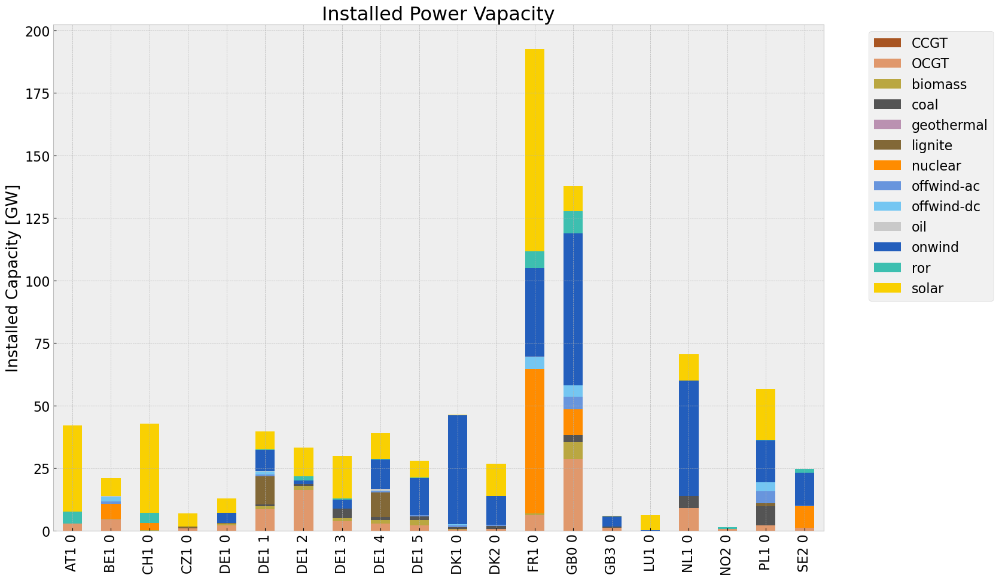

<Figure size 640x480 with 0 Axes>

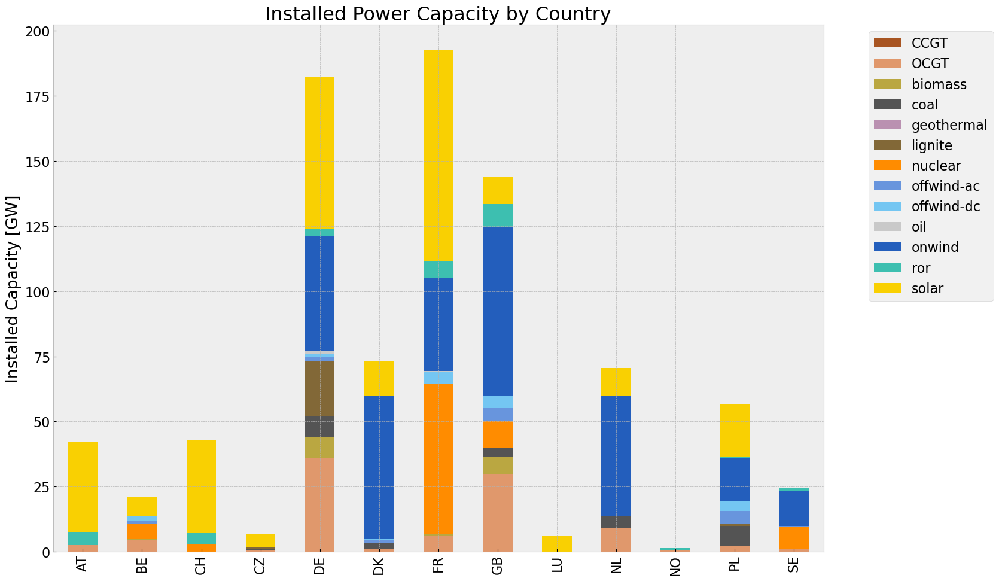

In [320]:
# consolidated istalled cap without load_shedding

#capacities_inv = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_inv.fillna(0, inplace=True)
#gen_1 = (capacities_inv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv = inst_cap_table(n1, color_cap)
cap_inv_country= inst_cap_table_country(n1, color_cap)


## Generation

<Figure size 640x480 with 0 Axes>

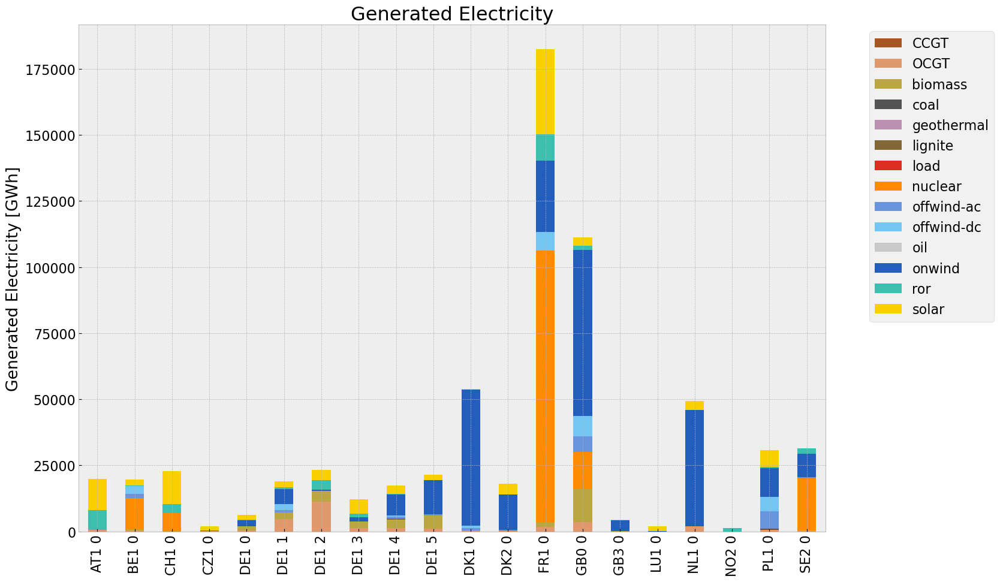

<Figure size 640x480 with 0 Axes>

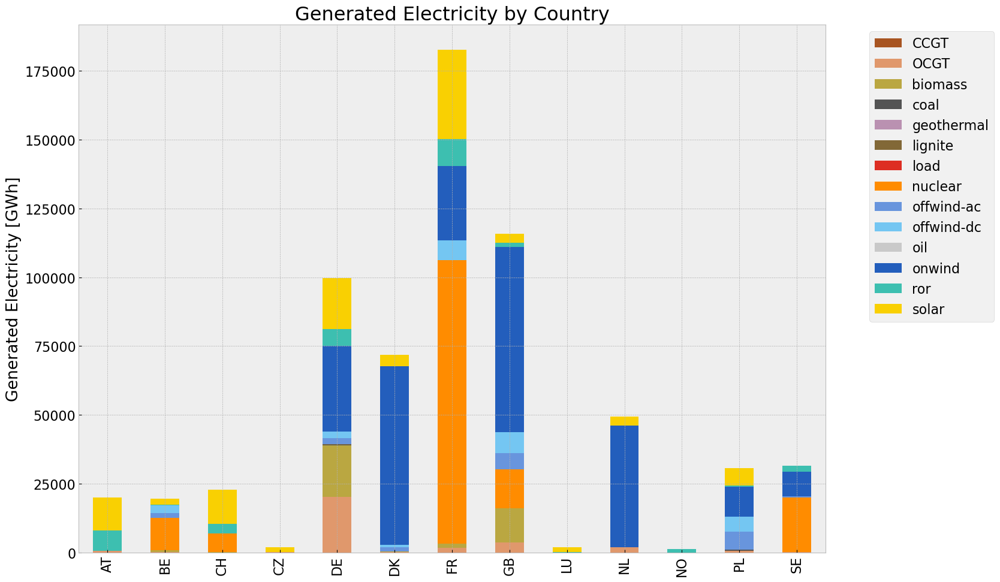

In [321]:
# consolidated generation table
#carrier = n1.generators.carrier.unique()
#df_tot_generation = n1.generators_t.p.sum()

#generations = pd.Series(index = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
           # except KeyError:
               # print('error')
                
#generations.fillna(0, inplace=True)
#gen_inv = generations.unstack()/1000#Gwh


gen_inv = gen_power_table(n1,colors_gen_table)
gen_inv_country = gen_power_table_country(n1,colors_gen_table)

## Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jere

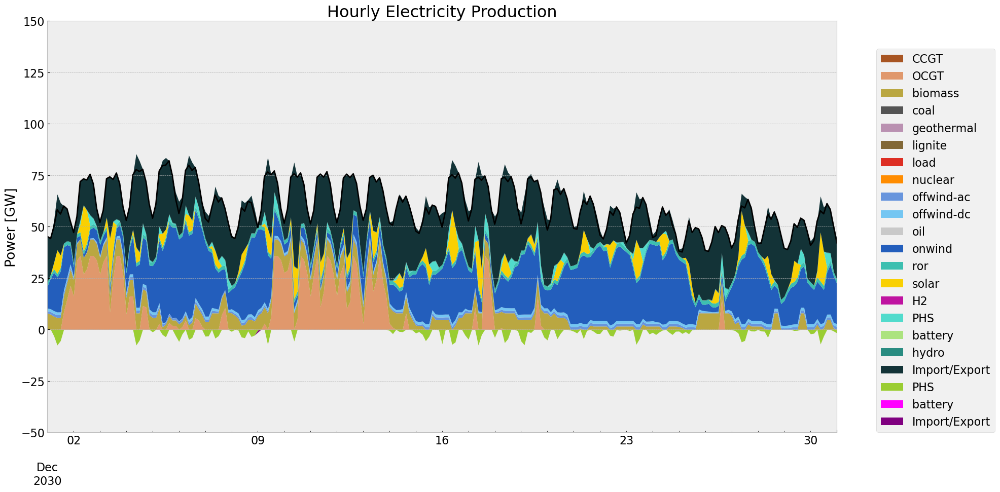

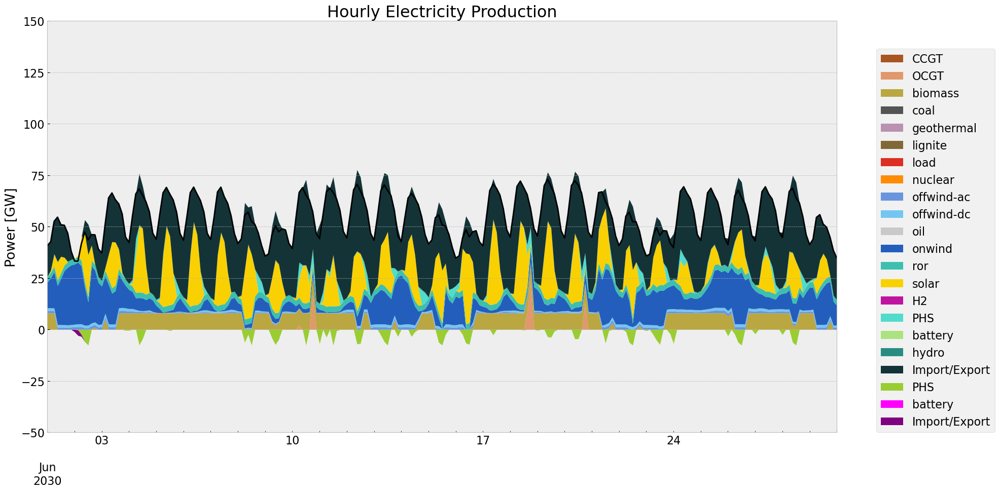

In [322]:
gen_curve(n1, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n1, '2030-06-1', '2030-06-30', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='

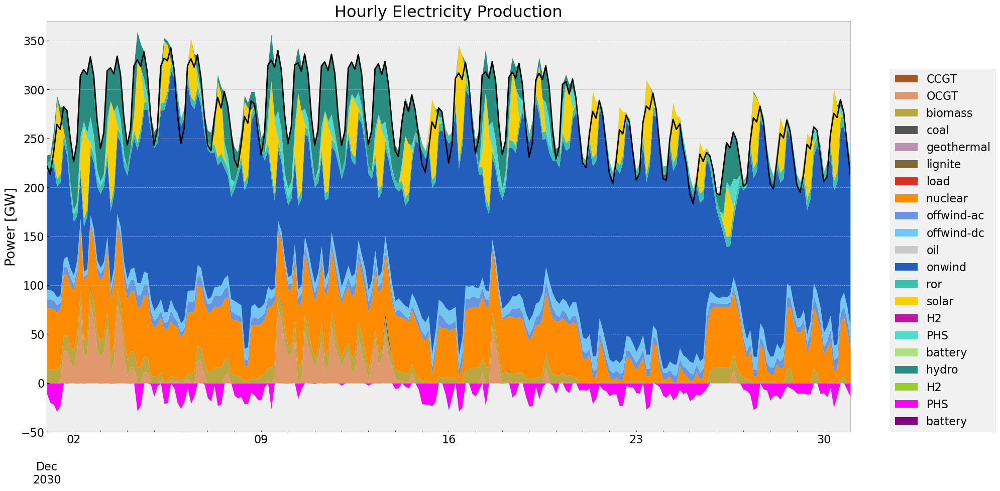

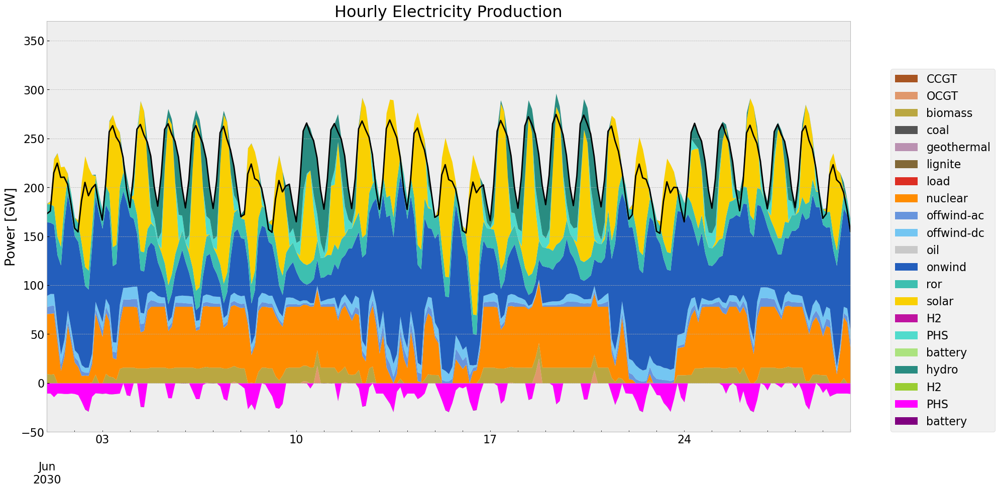

In [323]:
#generation curve all countries
#winter
gen_curve_tot(n1, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n1, '2030-06-01', '2030-06-30', colors_gen)

## Storage

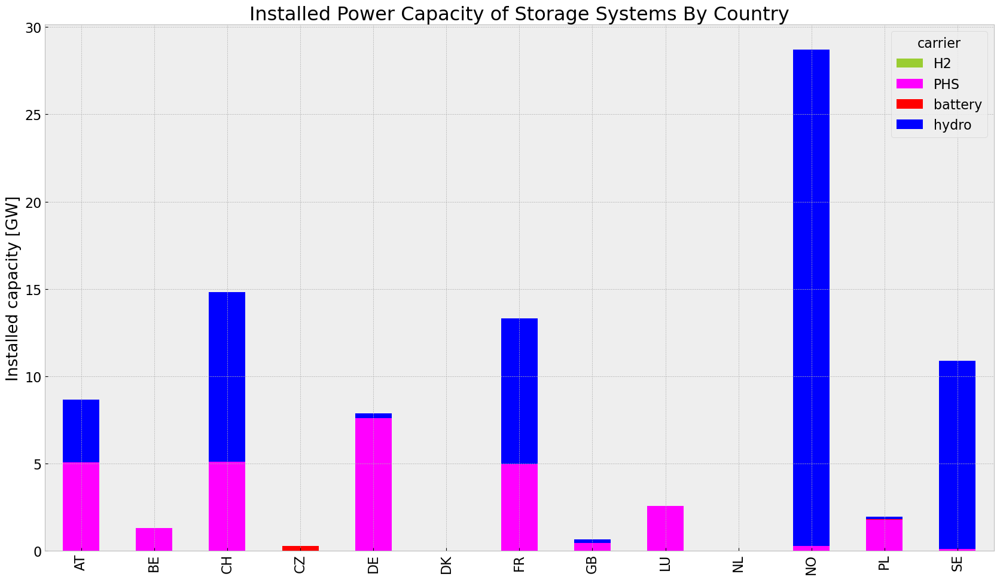

In [324]:
store_inv = inst_store_table(n1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3576090030.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3576090030.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')


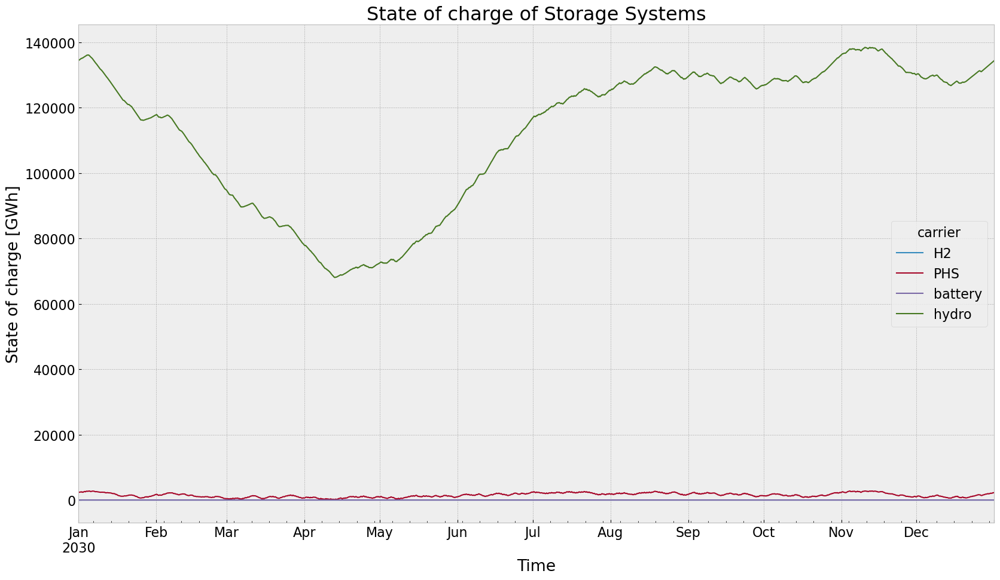

In [325]:
state_of_charge_plot(n1)


## Electricity Price


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


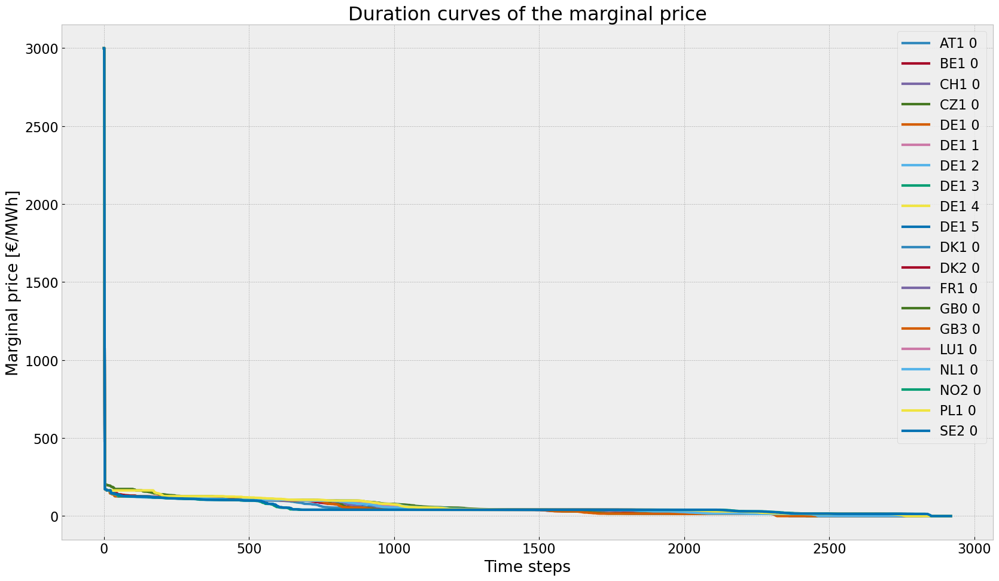

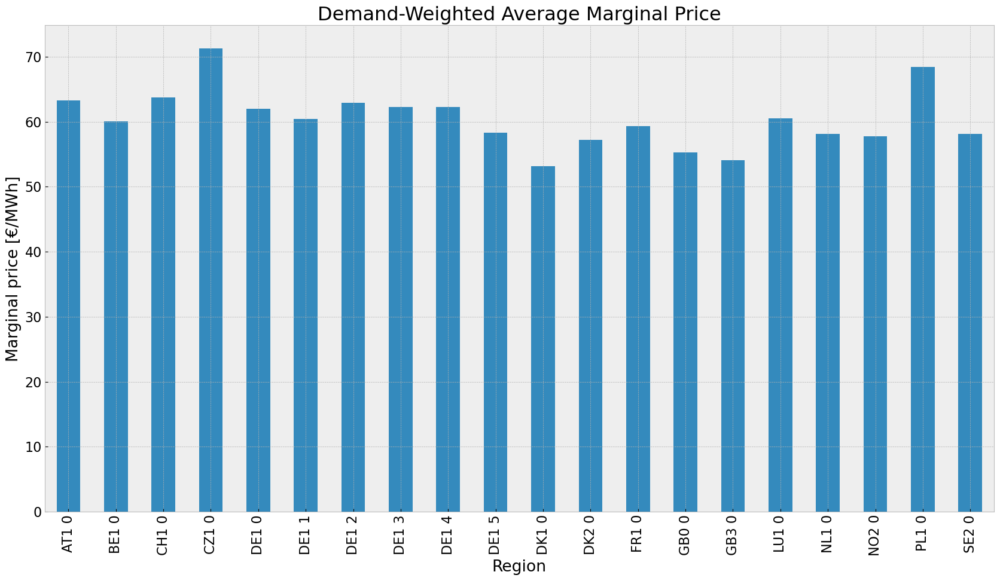

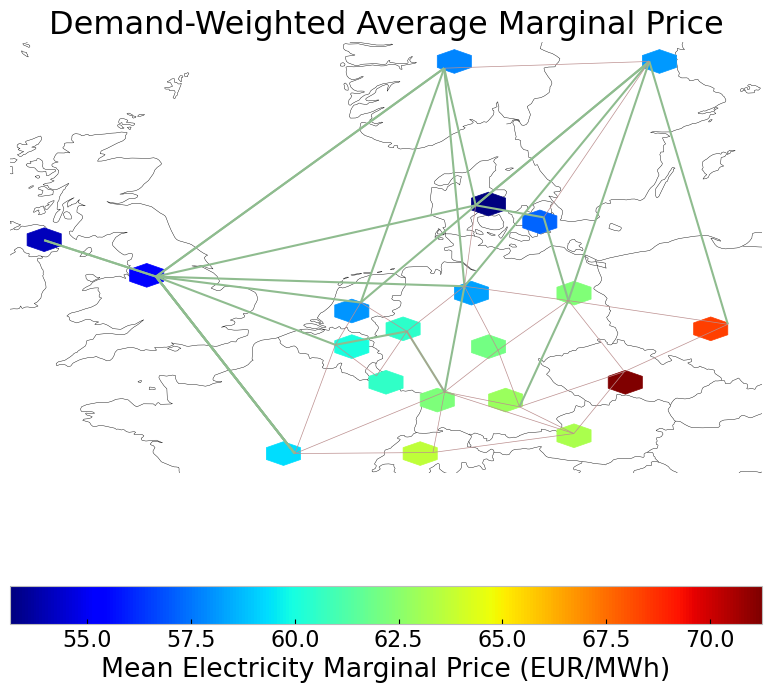

In [326]:
price_dur_curve_plot(n1)
price_regions_table(n1)
price_regions(n1)


## Emission

In [327]:
em_inv =em_table(n1)
em_inv

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,3.001379e+07,0.451621,0.1980,1.315867e+07
biomass,3.376398e+07,0.468000,0.0000,0.000000e+00
coal,7.018385e+05,0.329908,0.3361,7.150111e+05
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,3.616952e+05,0.337285,0.4069,4.363487e+05
load,9.196300e+03,1.000000,0.0000,0.000000e+00
nuclear,1.554000e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.795028e+07,1.000000,0.0000,0.000000e+00


## 2. Scenario: perfect foresight with no additional investment

In [328]:
n2 = dispatchscenario(n, cut_start, duration, reductionto)
n2.name = 'noinv_dispatchcut'     

### No Investment

In [329]:
def no_inv(n2,n):
    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n2.generators.p_nom_extendable.items():
        if value:  
            n2.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            #n2.generators.at[index, 'p_nom_max'] = n.generators.at[index, 'p_nom_opt']
            n2.generators.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n2.storage_units.p_nom_extendable.items():
        if value:  
            n2.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            #n2.storage_units.at[index, 'p_nom_max'] = n.storage_units.at[index, 'p_nom_opt']
            n2.storage_units.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of stores from the base scenario as the new minimum capacity 
    for index, value in n2.stores.e_nom_extendable.items():
        if value:  
            n2.stores.at[index, 'e_nom'] = n.stores.at[index, 'e_nom_opt']
            #n2.stores.at[index, 'e_nom_max'] = n.stores.at[index, 'e_nom_opt']
            n2.stores.at[index, 'e_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.lines.s_nom_extendable.items():
        if value:  
            n2.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.lines.at[index, 's_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.links.p_nom_extendable.items():
        if value:  
            n2.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.links.at[index, 'p_nom_extendable'] =False

no_inv(n2,n)                 

In [330]:
n2.optimize(solver_name ='gurobi')
#n2 = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\Dispatchcut\\20240512\\noinv_dispatchcut.nc")

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:05<00:00,  1.23it/s]
INFO:linopy.io: Writing time: 35.32s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vboz5ay3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vboz5ay3.lp


Reading time = 10.73 seconds


INFO:gurobipy:Reading time = 10.73 seconds


obj: 3264560 rows, 1521320 columns, 5349440 nonzeros


INFO:gurobipy:obj: 3264560 rows, 1521320 columns, 5349440 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3264560 rows, 1521320 columns and 5349440 nonzeros


INFO:gurobipy:Optimize a model with 3264560 rows, 1521320 columns and 5349440 nonzeros


Model fingerprint: 0x05495411


INFO:gurobipy:Model fingerprint: 0x05495411


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3102436 rows and 821573 columns


INFO:gurobipy:Presolve removed 3102436 rows and 821573 columns


Presolve time: 3.43s


INFO:gurobipy:Presolve time: 3.43s


Presolved: 162124 rows, 699747 columns, 1153535 nonzeros


INFO:gurobipy:Presolved: 162124 rows, 699747 columns, 1153535 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.31s


INFO:gurobipy:Ordering time: 0.31s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.772e+05


INFO:gurobipy: AA' NZ     : 4.772e+05


 Factor NZ  : 5.898e+06 (roughly 400 MB of memory)


INFO:gurobipy: Factor NZ  : 5.898e+06 (roughly 400 MB of memory)


 Factor Ops : 4.426e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.426e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.50531224e+13 -1.32758156e+15  7.63e+05 1.36e+03  1.56e+09     5s


INFO:gurobipy:   0   3.50531224e+13 -1.32758156e+15  7.63e+05 1.36e+03  1.56e+09     5s


   1   8.93598759e+12 -4.32774443e+13  7.05e+04 7.28e-12  8.45e+07     6s


INFO:gurobipy:   1   8.93598759e+12 -4.32774443e+13  7.05e+04 7.28e-12  8.45e+07     6s


   2   1.38533440e+12 -9.47223239e+12  4.03e+03 6.37e-12  9.60e+06     6s


INFO:gurobipy:   2   1.38533440e+12 -9.47223239e+12  4.03e+03 6.37e-12  9.60e+06     6s


   3   4.11519927e+11 -3.55632884e+12  8.26e+02 5.00e-11  3.07e+06     6s


INFO:gurobipy:   3   4.11519927e+11 -3.55632884e+12  8.26e+02 5.00e-11  3.07e+06     6s


   4   1.71261551e+11 -1.98800701e+12  3.05e+02 2.91e-11  1.61e+06     7s


INFO:gurobipy:   4   1.71261551e+11 -1.98800701e+12  3.05e+02 2.91e-11  1.61e+06     7s


   5   1.24598661e+11 -6.99087863e+11  1.57e+02 3.46e-11  6.07e+05     7s


INFO:gurobipy:   5   1.24598661e+11 -6.99087863e+11  1.57e+02 3.46e-11  6.07e+05     7s


   6   9.28564403e+10 -2.60644310e+11  8.18e+01 1.82e-11  2.58e+05     7s


INFO:gurobipy:   6   9.28564403e+10 -2.60644310e+11  8.18e+01 1.82e-11  2.58e+05     7s


   7   6.25911160e+10 -1.00625370e+11  3.73e+01 9.09e-12  1.18e+05     8s


INFO:gurobipy:   7   6.25911160e+10 -1.00625370e+11  3.73e+01 9.09e-12  1.18e+05     8s


   8   3.98206794e+10 -3.03686354e+10  1.15e+01 9.09e-12  5.04e+04     8s


INFO:gurobipy:   8   3.98206794e+10 -3.03686354e+10  1.15e+01 9.09e-12  5.04e+04     8s


   9   3.40951725e+10 -1.20375594e+10  7.64e+00 7.28e-12  3.31e+04     8s


INFO:gurobipy:   9   3.40951725e+10 -1.20375594e+10  7.64e+00 7.28e-12  3.31e+04     8s


  10   2.63039402e+10  3.56808992e+09  3.03e+00 5.46e-12  1.63e+04     9s


INFO:gurobipy:  10   2.63039402e+10  3.56808992e+09  3.03e+00 5.46e-12  1.63e+04     9s


  11   2.49442156e+10  6.33271130e+09  2.41e+00 5.46e-12  1.33e+04     9s


INFO:gurobipy:  11   2.49442156e+10  6.33271130e+09  2.41e+00 5.46e-12  1.33e+04     9s


  12   2.25792975e+10  1.21178603e+10  1.35e+00 3.64e-12  7.48e+03    10s


INFO:gurobipy:  12   2.25792975e+10  1.21178603e+10  1.35e+00 3.64e-12  7.48e+03    10s


  13   2.17725986e+10  1.41233620e+10  1.02e+00 3.64e-12  5.47e+03    10s


INFO:gurobipy:  13   2.17725986e+10  1.41233620e+10  1.02e+00 3.64e-12  5.47e+03    10s


  14   2.12079440e+10  1.62798331e+10  7.98e-01 3.64e-12  3.52e+03    10s


INFO:gurobipy:  14   2.12079440e+10  1.62798331e+10  7.98e-01 3.64e-12  3.52e+03    10s


  15   2.06791684e+10  1.69982957e+10  5.95e-01 3.64e-12  2.63e+03    11s


INFO:gurobipy:  15   2.06791684e+10  1.69982957e+10  5.95e-01 3.64e-12  2.63e+03    11s


  16   2.04006940e+10  1.73639389e+10  4.89e-01 5.46e-12  2.17e+03    11s


INFO:gurobipy:  16   2.04006940e+10  1.73639389e+10  4.89e-01 5.46e-12  2.17e+03    11s


  17   1.99749199e+10  1.75999948e+10  3.30e-01 5.46e-12  1.70e+03    11s


INFO:gurobipy:  17   1.99749199e+10  1.75999948e+10  3.30e-01 5.46e-12  1.70e+03    11s


  18   1.98238711e+10  1.79996830e+10  2.73e-01 3.64e-12  1.30e+03    12s


INFO:gurobipy:  18   1.98238711e+10  1.79996830e+10  2.73e-01 3.64e-12  1.30e+03    12s


  19   1.96999554e+10  1.82132137e+10  2.26e-01 3.64e-12  1.06e+03    12s


INFO:gurobipy:  19   1.96999554e+10  1.82132137e+10  2.26e-01 3.64e-12  1.06e+03    12s


  20   1.96284027e+10  1.83226845e+10  2.00e-01 5.46e-12  9.33e+02    13s


INFO:gurobipy:  20   1.96284027e+10  1.83226845e+10  2.00e-01 5.46e-12  9.33e+02    13s


  21   1.95570949e+10  1.83885360e+10  1.74e-01 5.46e-12  8.35e+02    13s


INFO:gurobipy:  21   1.95570949e+10  1.83885360e+10  1.74e-01 5.46e-12  8.35e+02    13s


  22   1.95001594e+10  1.85055796e+10  1.53e-01 5.46e-12  7.11e+02    14s


INFO:gurobipy:  22   1.95001594e+10  1.85055796e+10  1.53e-01 5.46e-12  7.11e+02    14s


  23   1.94235003e+10  1.85897319e+10  1.24e-01 5.46e-12  5.96e+02    14s


INFO:gurobipy:  23   1.94235003e+10  1.85897319e+10  1.24e-01 5.46e-12  5.96e+02    14s


  24   1.94000273e+10  1.86485247e+10  1.15e-01 5.46e-12  5.37e+02    15s


INFO:gurobipy:  24   1.94000273e+10  1.86485247e+10  1.15e-01 5.46e-12  5.37e+02    15s


  25   1.93351679e+10  1.86932989e+10  9.06e-02 5.46e-12  4.59e+02    15s


INFO:gurobipy:  25   1.93351679e+10  1.86932989e+10  9.06e-02 5.46e-12  4.59e+02    15s


  26   1.93100006e+10  1.87595585e+10  8.10e-02 3.64e-12  3.93e+02    16s


INFO:gurobipy:  26   1.93100006e+10  1.87595585e+10  8.10e-02 3.64e-12  3.93e+02    16s


  27   1.92908866e+10  1.88275125e+10  7.40e-02 3.64e-12  3.31e+02    16s


INFO:gurobipy:  27   1.92908866e+10  1.88275125e+10  7.40e-02 3.64e-12  3.31e+02    16s


  28   1.92516852e+10  1.88702830e+10  5.98e-02 3.64e-12  2.73e+02    17s


INFO:gurobipy:  28   1.92516852e+10  1.88702830e+10  5.98e-02 3.64e-12  2.73e+02    17s


  29   1.92335972e+10  1.88977843e+10  5.31e-02 3.64e-12  2.40e+02    17s


INFO:gurobipy:  29   1.92335972e+10  1.88977843e+10  5.31e-02 3.64e-12  2.40e+02    17s


  30   1.92135700e+10  1.89236157e+10  4.57e-02 3.75e-12  2.07e+02    18s


INFO:gurobipy:  30   1.92135700e+10  1.89236157e+10  4.57e-02 3.75e-12  2.07e+02    18s


  31   1.92057609e+10  1.89400985e+10  4.28e-02 1.97e-10  1.90e+02    18s


INFO:gurobipy:  31   1.92057609e+10  1.89400985e+10  4.28e-02 1.97e-10  1.90e+02    18s


  32   1.91878377e+10  1.89552111e+10  3.61e-02 2.24e-09  1.66e+02    19s


INFO:gurobipy:  32   1.91878377e+10  1.89552111e+10  3.61e-02 2.24e-09  1.66e+02    19s


  33   1.91812321e+10  1.89625695e+10  3.36e-02 4.83e-09  1.56e+02    19s


INFO:gurobipy:  33   1.91812321e+10  1.89625695e+10  3.36e-02 4.83e-09  1.56e+02    19s


  34   1.91672067e+10  1.89690795e+10  2.83e-02 9.48e-09  1.42e+02    20s


INFO:gurobipy:  34   1.91672067e+10  1.89690795e+10  2.83e-02 9.48e-09  1.42e+02    20s


  35   1.91579720e+10  1.89850463e+10  2.48e-02 1.32e-08  1.24e+02    20s


INFO:gurobipy:  35   1.91579720e+10  1.89850463e+10  2.48e-02 1.32e-08  1.24e+02    20s


  36   1.91535547e+10  1.89955750e+10  2.32e-02 1.96e-08  1.13e+02    21s


INFO:gurobipy:  36   1.91535547e+10  1.89955750e+10  2.32e-02 1.96e-08  1.13e+02    21s


  37   1.91489997e+10  1.90016728e+10  2.15e-02 2.39e-08  1.05e+02    21s


INFO:gurobipy:  37   1.91489997e+10  1.90016728e+10  2.15e-02 2.39e-08  1.05e+02    21s


  38   1.91429161e+10  1.90072440e+10  1.92e-02 2.65e-08  9.70e+01    22s


INFO:gurobipy:  38   1.91429161e+10  1.90072440e+10  1.92e-02 2.65e-08  9.70e+01    22s


  39   1.91383482e+10  1.90172752e+10  1.75e-02 2.91e-08  8.65e+01    22s


INFO:gurobipy:  39   1.91383482e+10  1.90172752e+10  1.75e-02 2.91e-08  8.65e+01    22s


  40   1.91334419e+10  1.90259846e+10  1.56e-02 3.42e-08  7.68e+01    23s


INFO:gurobipy:  40   1.91334419e+10  1.90259846e+10  1.56e-02 3.42e-08  7.68e+01    23s


  41   1.91311881e+10  1.90333682e+10  1.48e-02 3.52e-08  6.99e+01    23s


INFO:gurobipy:  41   1.91311881e+10  1.90333682e+10  1.48e-02 3.52e-08  6.99e+01    23s


  42   1.91294774e+10  1.90406603e+10  1.41e-02 3.67e-08  6.35e+01    23s


INFO:gurobipy:  42   1.91294774e+10  1.90406603e+10  1.41e-02 3.67e-08  6.35e+01    23s


  43   1.91264735e+10  1.90463345e+10  1.30e-02 3.57e-08  5.73e+01    24s


INFO:gurobipy:  43   1.91264735e+10  1.90463345e+10  1.30e-02 3.57e-08  5.73e+01    24s


  44   1.91236650e+10  1.90496394e+10  1.20e-02 3.38e-08  5.29e+01    24s


INFO:gurobipy:  44   1.91236650e+10  1.90496394e+10  1.20e-02 3.38e-08  5.29e+01    24s


  45   1.91218291e+10  1.90543473e+10  1.13e-02 2.99e-08  4.82e+01    25s


INFO:gurobipy:  45   1.91218291e+10  1.90543473e+10  1.13e-02 2.99e-08  4.82e+01    25s


  46   1.91183231e+10  1.90561215e+10  1.01e-02 2.95e-08  4.45e+01    25s


INFO:gurobipy:  46   1.91183231e+10  1.90561215e+10  1.01e-02 2.95e-08  4.45e+01    25s


  47   1.91162189e+10  1.90590447e+10  9.29e-03 2.82e-08  4.09e+01    26s


INFO:gurobipy:  47   1.91162189e+10  1.90590447e+10  9.29e-03 2.82e-08  4.09e+01    26s


  48   1.91147543e+10  1.90624020e+10  8.75e-03 2.70e-08  3.74e+01    26s


INFO:gurobipy:  48   1.91147543e+10  1.90624020e+10  8.75e-03 2.70e-08  3.74e+01    26s


  49   1.91116428e+10  1.90642519e+10  7.62e-03 2.71e-08  3.39e+01    27s


INFO:gurobipy:  49   1.91116428e+10  1.90642519e+10  7.62e-03 2.71e-08  3.39e+01    27s


  50   1.91096633e+10  1.90690753e+10  6.88e-03 2.46e-08  2.90e+01    27s


INFO:gurobipy:  50   1.91096633e+10  1.90690753e+10  6.88e-03 2.46e-08  2.90e+01    27s


  51   1.91080597e+10  1.90716208e+10  6.29e-03 2.19e-08  2.60e+01    28s


INFO:gurobipy:  51   1.91080597e+10  1.90716208e+10  6.29e-03 2.19e-08  2.60e+01    28s


  52   1.91065871e+10  1.90726004e+10  5.74e-03 2.14e-08  2.43e+01    28s


INFO:gurobipy:  52   1.91065871e+10  1.90726004e+10  5.74e-03 2.14e-08  2.43e+01    28s


  53   1.91057356e+10  1.90750809e+10  5.43e-03 1.97e-08  2.19e+01    29s


INFO:gurobipy:  53   1.91057356e+10  1.90750809e+10  5.43e-03 1.97e-08  2.19e+01    29s


  54   1.91050175e+10  1.90769543e+10  5.16e-03 1.80e-08  2.01e+01    29s


INFO:gurobipy:  54   1.91050175e+10  1.90769543e+10  5.16e-03 1.80e-08  2.01e+01    29s


  55   1.91035924e+10  1.90782814e+10  4.64e-03 1.66e-08  1.81e+01    30s


INFO:gurobipy:  55   1.91035924e+10  1.90782814e+10  4.64e-03 1.66e-08  1.81e+01    30s


  56   1.91020718e+10  1.90795302e+10  4.08e-03 1.49e-08  1.61e+01    30s


INFO:gurobipy:  56   1.91020718e+10  1.90795302e+10  4.08e-03 1.49e-08  1.61e+01    30s


  57   1.91014405e+10  1.90804136e+10  3.84e-03 1.45e-08  1.50e+01    31s


INFO:gurobipy:  57   1.91014405e+10  1.90804136e+10  3.84e-03 1.45e-08  1.50e+01    31s


  58   1.91008135e+10  1.90813549e+10  3.61e-03 1.50e-08  1.39e+01    31s


INFO:gurobipy:  58   1.91008135e+10  1.90813549e+10  3.61e-03 1.50e-08  1.39e+01    31s


  59   1.91001658e+10  1.90822698e+10  3.39e-03 1.49e-08  1.28e+01    32s


INFO:gurobipy:  59   1.91001658e+10  1.90822698e+10  3.39e-03 1.49e-08  1.28e+01    32s


  60   1.90986328e+10  1.90836588e+10  2.81e-03 1.36e-08  1.07e+01    32s


INFO:gurobipy:  60   1.90986328e+10  1.90836588e+10  2.81e-03 1.36e-08  1.07e+01    32s


  61   1.90973060e+10  1.90847099e+10  2.32e-03 1.31e-08  9.00e+00    33s


INFO:gurobipy:  61   1.90973060e+10  1.90847099e+10  2.32e-03 1.31e-08  9.00e+00    33s


  62   1.90968964e+10  1.90855659e+10  2.16e-03 1.25e-08  8.10e+00    33s


INFO:gurobipy:  62   1.90968964e+10  1.90855659e+10  2.16e-03 1.25e-08  8.10e+00    33s


  63   1.90960718e+10  1.90863321e+10  1.86e-03 1.20e-08  6.96e+00    34s


INFO:gurobipy:  63   1.90960718e+10  1.90863321e+10  1.86e-03 1.20e-08  6.96e+00    34s


  64   1.90958658e+10  1.90865489e+10  1.78e-03 1.30e-08  6.66e+00    34s


INFO:gurobipy:  64   1.90958658e+10  1.90865489e+10  1.78e-03 1.30e-08  6.66e+00    34s


  65   1.90956197e+10  1.90868339e+10  1.69e-03 1.48e-08  6.28e+00    35s


INFO:gurobipy:  65   1.90956197e+10  1.90868339e+10  1.69e-03 1.48e-08  6.28e+00    35s


  66   1.90948148e+10  1.90871721e+10  1.39e-03 1.43e-08  5.46e+00    35s


INFO:gurobipy:  66   1.90948148e+10  1.90871721e+10  1.39e-03 1.43e-08  5.46e+00    35s


  67   1.90941705e+10  1.90881254e+10  1.15e-03 1.38e-08  4.32e+00    36s


INFO:gurobipy:  67   1.90941705e+10  1.90881254e+10  1.15e-03 1.38e-08  4.32e+00    36s


  68   1.90937337e+10  1.90886325e+10  9.86e-04 1.36e-08  3.65e+00    36s


INFO:gurobipy:  68   1.90937337e+10  1.90886325e+10  9.86e-04 1.36e-08  3.65e+00    36s


  69   1.90929741e+10  1.90890404e+10  7.03e-04 1.31e-08  2.81e+00    37s


INFO:gurobipy:  69   1.90929741e+10  1.90890404e+10  7.03e-04 1.31e-08  2.81e+00    37s


  70   1.90927219e+10  1.90894114e+10  6.13e-04 1.27e-08  2.37e+00    37s


INFO:gurobipy:  70   1.90927219e+10  1.90894114e+10  6.13e-04 1.27e-08  2.37e+00    37s


  71   1.90924241e+10  1.90897225e+10  5.02e-04 1.22e-08  1.93e+00    38s


INFO:gurobipy:  71   1.90924241e+10  1.90897225e+10  5.02e-04 1.22e-08  1.93e+00    38s


  72   1.90921741e+10  1.90899258e+10  4.09e-04 1.13e-08  1.61e+00    38s


INFO:gurobipy:  72   1.90921741e+10  1.90899258e+10  4.09e-04 1.13e-08  1.61e+00    38s


  73   1.90920711e+10  1.90901547e+10  3.71e-04 9.86e-09  1.37e+00    39s


INFO:gurobipy:  73   1.90920711e+10  1.90901547e+10  3.71e-04 9.86e-09  1.37e+00    39s


  74   1.90919835e+10  1.90902858e+10  3.40e-04 9.39e-09  1.21e+00    39s


INFO:gurobipy:  74   1.90919835e+10  1.90902858e+10  3.40e-04 9.39e-09  1.21e+00    39s


  75   1.90918769e+10  1.90904809e+10  3.00e-04 1.05e-08  9.98e-01    40s


INFO:gurobipy:  75   1.90918769e+10  1.90904809e+10  3.00e-04 1.05e-08  9.98e-01    40s


  76   1.90917784e+10  1.90905707e+10  2.64e-04 8.90e-09  8.63e-01    40s


INFO:gurobipy:  76   1.90917784e+10  1.90905707e+10  2.64e-04 8.90e-09  8.63e-01    40s


  77   1.90915303e+10  1.90906031e+10  1.74e-04 9.28e-09  6.63e-01    41s


INFO:gurobipy:  77   1.90915303e+10  1.90906031e+10  1.74e-04 9.28e-09  6.63e-01    41s


  78   1.90914395e+10  1.90907752e+10  1.40e-04 1.20e-08  4.75e-01    41s


INFO:gurobipy:  78   1.90914395e+10  1.90907752e+10  1.40e-04 1.20e-08  4.75e-01    41s


  79   1.90914281e+10  1.90908012e+10  1.35e-04 1.28e-08  4.48e-01    42s


INFO:gurobipy:  79   1.90914281e+10  1.90908012e+10  1.35e-04 1.28e-08  4.48e-01    42s


  80   1.90912783e+10  1.90908534e+10  7.84e-05 1.38e-08  3.04e-01    43s


INFO:gurobipy:  80   1.90912783e+10  1.90908534e+10  7.84e-05 1.38e-08  3.04e-01    43s


  81   1.90912687e+10  1.90908782e+10  7.48e-05 1.24e-08  2.79e-01    43s


INFO:gurobipy:  81   1.90912687e+10  1.90908782e+10  7.48e-05 1.24e-08  2.79e-01    43s


  82   1.90912385e+10  1.90909277e+10  6.28e-05 9.42e-09  2.22e-01    44s


INFO:gurobipy:  82   1.90912385e+10  1.90909277e+10  6.28e-05 9.42e-09  2.22e-01    44s


  83   1.90912054e+10  1.90909682e+10  5.04e-05 7.19e-09  1.70e-01    45s


INFO:gurobipy:  83   1.90912054e+10  1.90909682e+10  5.04e-05 7.19e-09  1.70e-01    45s


  84   1.90911809e+10  1.90910003e+10  4.08e-05 5.44e-09  1.29e-01    45s


INFO:gurobipy:  84   1.90911809e+10  1.90910003e+10  4.08e-05 5.44e-09  1.29e-01    45s


  85   1.90911391e+10  1.90910177e+10  2.43e-05 5.61e-09  8.68e-02    46s


INFO:gurobipy:  85   1.90911391e+10  1.90910177e+10  2.43e-05 5.61e-09  8.68e-02    46s


  86   1.90911185e+10  1.90910292e+10  1.60e-05 5.36e-09  6.38e-02    47s


INFO:gurobipy:  86   1.90911185e+10  1.90910292e+10  1.60e-05 5.36e-09  6.38e-02    47s


  87   1.90911036e+10  1.90910514e+10  1.05e-05 3.92e-09  3.72e-02    47s


INFO:gurobipy:  87   1.90911036e+10  1.90910514e+10  1.05e-05 3.92e-09  3.72e-02    47s


  88   1.90910978e+10  1.90910631e+10  8.35e-06 2.83e-09  2.48e-02    48s


INFO:gurobipy:  88   1.90910978e+10  1.90910631e+10  8.35e-06 2.83e-09  2.48e-02    48s


  89   1.90910914e+10  1.90910669e+10  5.98e-06 2.63e-09  1.75e-02    48s


INFO:gurobipy:  89   1.90910914e+10  1.90910669e+10  5.98e-06 2.63e-09  1.75e-02    48s


  90   1.90910886e+10  1.90910689e+10  4.91e-06 2.17e-09  1.40e-02    48s


INFO:gurobipy:  90   1.90910886e+10  1.90910689e+10  4.91e-06 2.17e-09  1.40e-02    48s


  91   1.90910815e+10  1.90910693e+10  2.51e-06 2.00e-09  8.72e-03    49s


INFO:gurobipy:  91   1.90910815e+10  1.90910693e+10  2.51e-06 2.00e-09  8.72e-03    49s


  92   1.90910789e+10  1.90910726e+10  1.50e-06 1.10e-09  4.48e-03    49s


INFO:gurobipy:  92   1.90910789e+10  1.90910726e+10  1.50e-06 1.10e-09  4.48e-03    49s


  93   1.90910766e+10  1.90910738e+10  1.08e-06 6.82e-10  1.99e-03    50s


INFO:gurobipy:  93   1.90910766e+10  1.90910738e+10  1.08e-06 6.82e-10  1.99e-03    50s


  94   1.90910756e+10  1.90910745e+10  1.63e-06 5.79e-10  8.03e-04    50s


INFO:gurobipy:  94   1.90910756e+10  1.90910745e+10  1.63e-06 5.79e-10  8.03e-04    50s


  95   1.90910751e+10  1.90910746e+10  6.47e-06 1.90e-10  3.04e-04    51s


INFO:gurobipy:  95   1.90910751e+10  1.90910746e+10  6.47e-06 1.90e-10  3.04e-04    51s


  96   1.90910749e+10  1.90910748e+10  3.25e-06 5.72e-11  7.63e-05    51s


INFO:gurobipy:  96   1.90910749e+10  1.90910748e+10  3.25e-06 5.72e-11  7.63e-05    51s


  97   1.90910748e+10  1.90910748e+10  2.75e-05 2.37e-10  1.67e-05    52s


INFO:gurobipy:  97   1.90910748e+10  1.90910748e+10  2.75e-05 2.37e-10  1.67e-05    52s


  98   1.90910748e+10  1.90910748e+10  8.66e-05 1.98e-10  3.82e-06    52s


INFO:gurobipy:  98   1.90910748e+10  1.90910748e+10  8.66e-05 1.98e-10  3.82e-06    52s


  99   1.90910748e+10  1.90910748e+10  3.93e-06 7.84e-10  3.52e-07    52s


INFO:gurobipy:  99   1.90910748e+10  1.90910748e+10  3.93e-06 7.84e-10  3.52e-07    52s


 100   1.90910748e+10  1.90910748e+10  8.04e-07 1.70e-10  4.44e-08    53s


INFO:gurobipy: 100   1.90910748e+10  1.90910748e+10  8.04e-07 1.70e-10  4.44e-08    53s


 101   1.90910748e+10  1.90910748e+10  5.57e-07 8.79e-11  2.41e-09    53s


INFO:gurobipy: 101   1.90910748e+10  1.90910748e+10  5.57e-07 8.79e-11  2.41e-09    53s


INFO:gurobipy:


Barrier solved model in 101 iterations and 53.30 seconds (26.72 work units)


INFO:gurobipy:Barrier solved model in 101 iterations and 53.30 seconds (26.72 work units)


Optimal objective 1.90910748e+10


INFO:gurobipy:Optimal objective 1.90910748e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   12315 DPushes remaining with DInf 0.0000000e+00                54s


INFO:gurobipy:   12315 DPushes remaining with DInf 0.0000000e+00                54s


     188 DPushes remaining with DInf 0.0000000e+00                55s


INFO:gurobipy:     188 DPushes remaining with DInf 0.0000000e+00                55s


       0 DPushes remaining with DInf 0.0000000e+00                56s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                56s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.5


INFO:gurobipy:


   16668 PPushes remaining with PInf 7.8028856e-06                56s


INFO:gurobipy:   16668 PPushes remaining with PInf 7.8028856e-06                56s


       0 PPushes remaining with PInf 0.0000000e+00                59s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                59s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 9.6356797e-10     59s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 9.6356797e-10     59s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


   28986    1.9091075e+10   0.000000e+00   0.000000e+00     61s


INFO:gurobipy:   28986    1.9091075e+10   0.000000e+00   0.000000e+00     61s


INFO:gurobipy:


Solved in 28986 iterations and 61.16 seconds (29.31 work units)


INFO:gurobipy:Solved in 28986 iterations and 61.16 seconds (29.31 work units)


Optimal objective  1.909107481e+10


INFO:gurobipy:Optimal objective  1.909107481e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1521320 primals, 3264560 duals
Objective: 1.91e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


('ok', 'optimal')

### Export model for later use

In [331]:
#file = "noinv_dispatchcut.nc"
#output_path = os.path.join(os.getcwd(), file)
#n2.export_to_netcdf(output_path)

In [332]:
tot_cos_noinv=n2.objective/1e9 #billion €
system_cost_noinv = system_cost(n2) #million €/a
marg_price_region_noinv = n2.buses_t.marginal_price.mean()
stat_noinv = n2.statistics()

## Installed Capacity

Since expansion is not allowed in this scenario, the installed capacity will equal to that of the base scenario.

<Figure size 640x480 with 0 Axes>

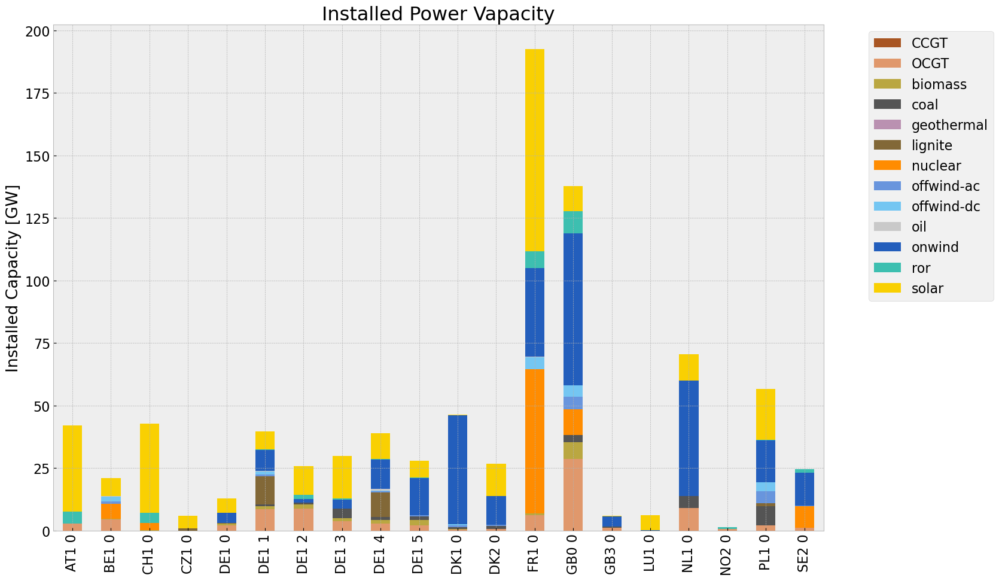

<Figure size 640x480 with 0 Axes>

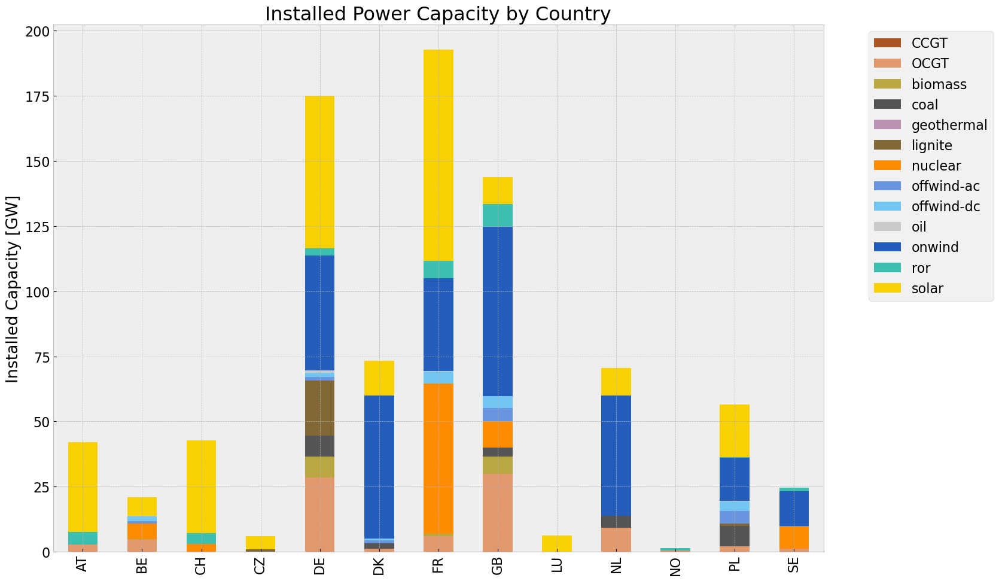

In [333]:
# consolidated istalled cap without load_shedding

#capacities_noinv = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv.fillna(0, inplace=True)
#gen = (capacities_noinv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv = inst_cap_table(n2, color_cap)
cap_noinv_country= inst_cap_table_country(n2, color_cap)



## Generation

<Figure size 640x480 with 0 Axes>

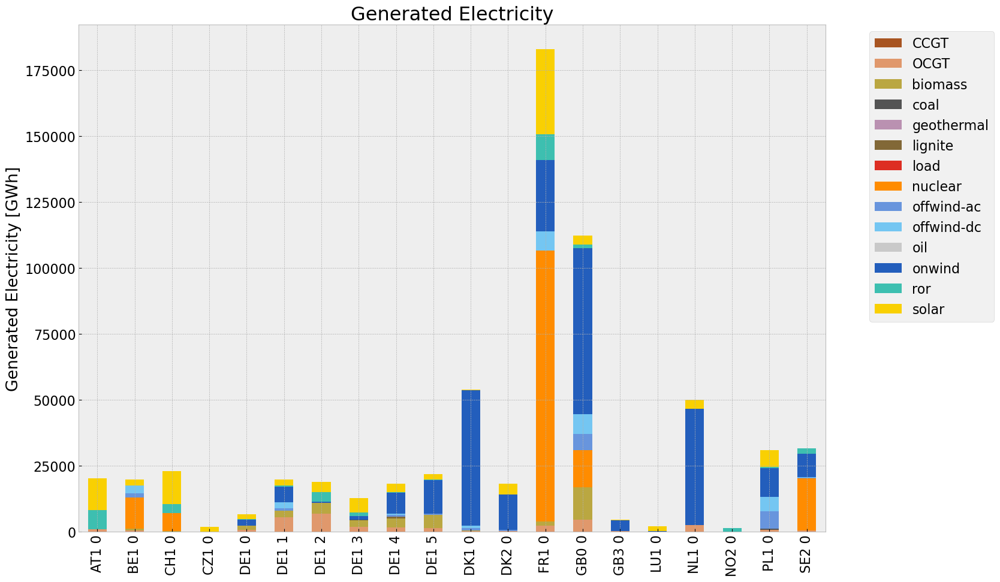

<Figure size 640x480 with 0 Axes>

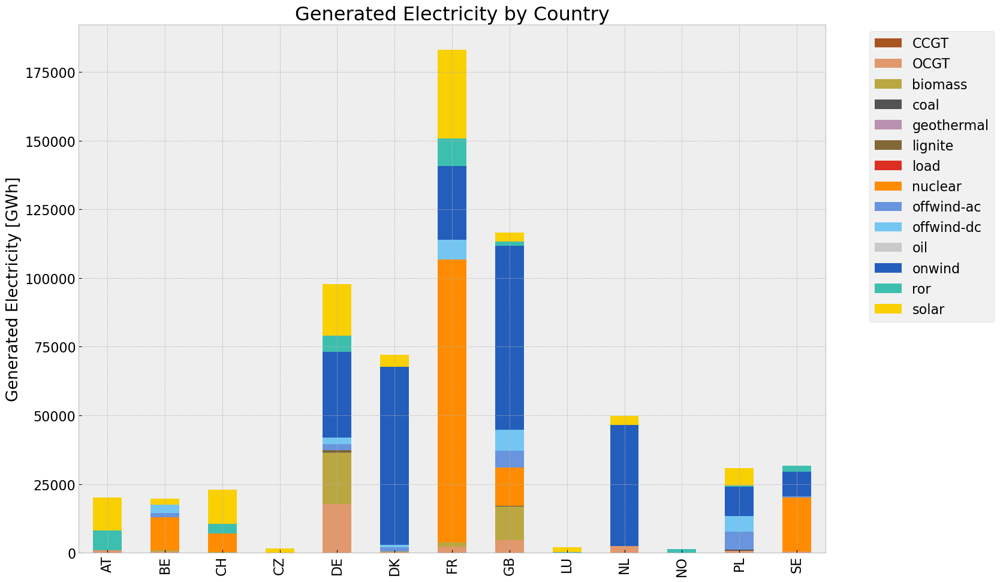

In [334]:
# consolidated generation table
#carrier = n2.generators.carrier.unique()
#df_tot_generation = n2.generators_t.p.sum()

#generations = pd.Series(index = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
                #generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')

#generations.fillna(0, inplace=True)
#gen_noinv = generations.unstack()/1000#GWh

gen_noinv= gen_power_table(n2,colors_gen_table)
gen_noinv_country = gen_power_table_country(n2,colors_gen_table)


## Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\2796143640.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\2796143640.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum(

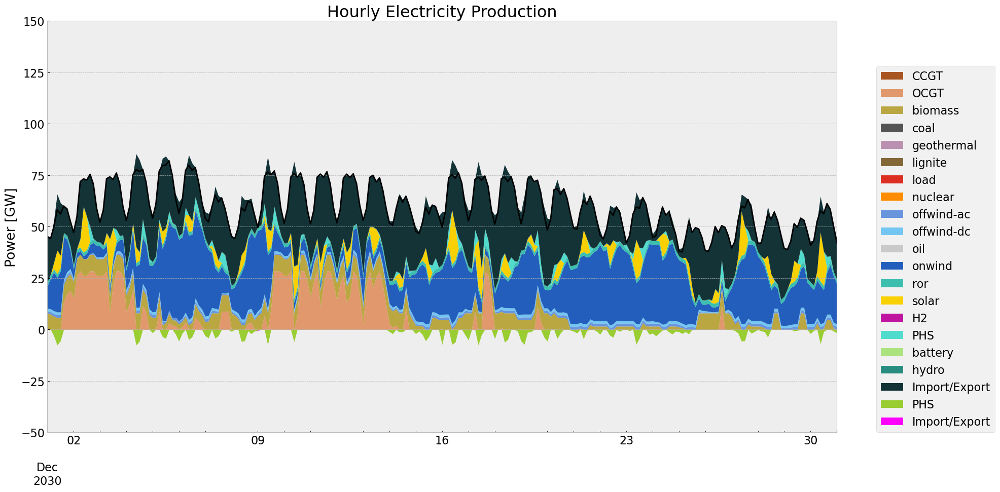

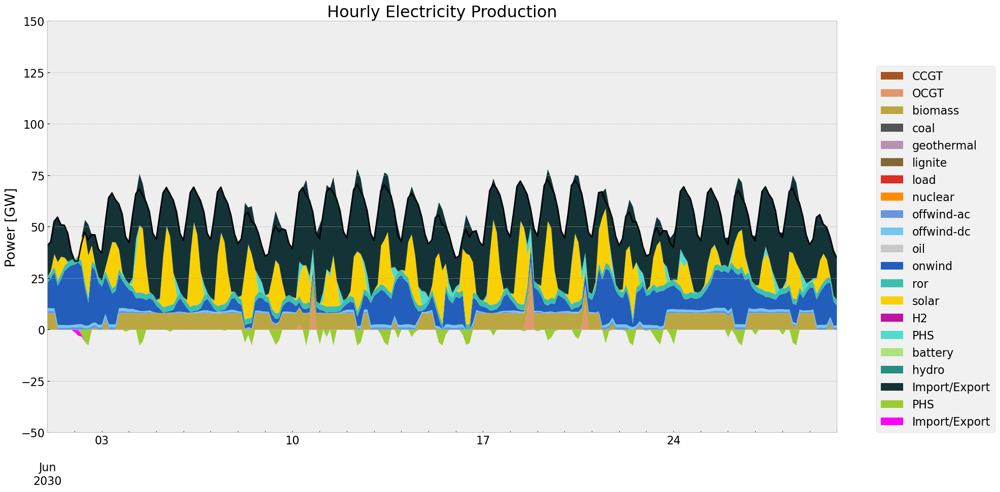

In [335]:
p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n2, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n2, '2030-06-01', '2030-06-30', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='

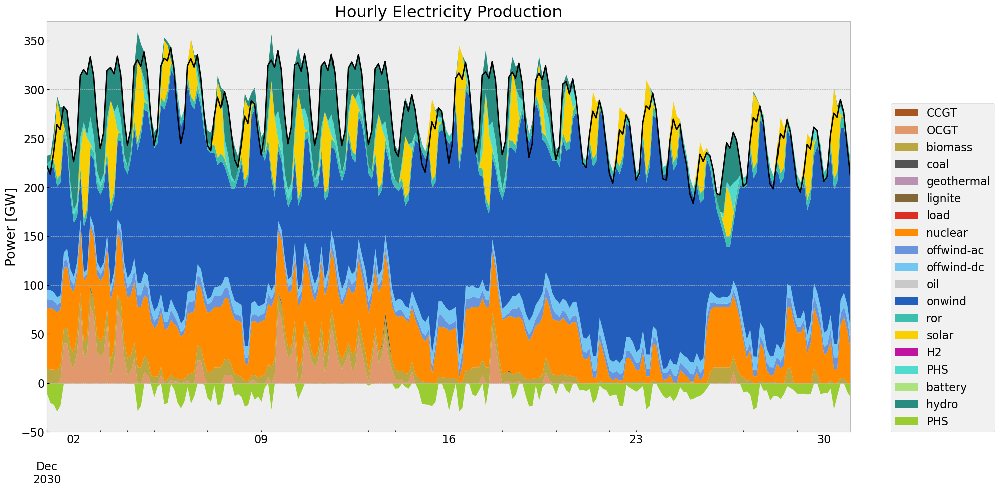

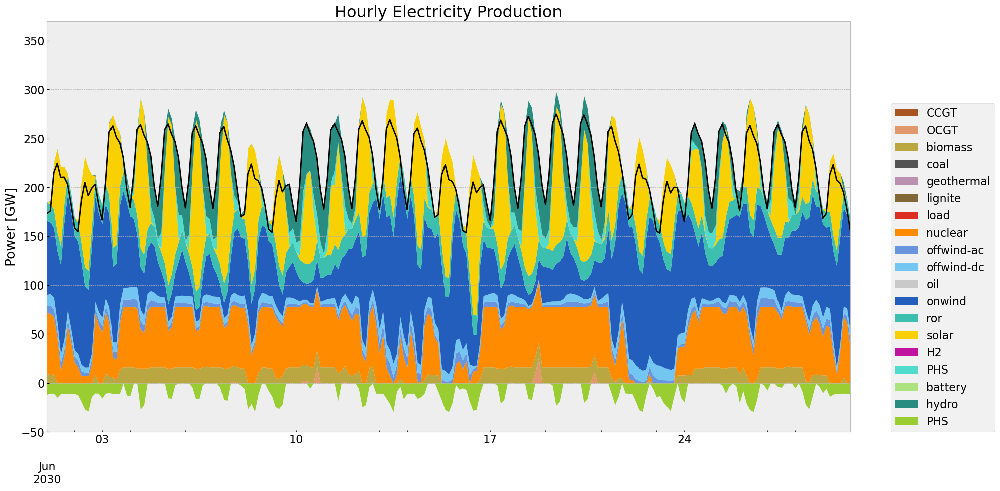

In [336]:
#generation curve all countries
#winter
gen_curve_tot(n2, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n2, '2030-06-01', '2030-06-30', colors_gen)

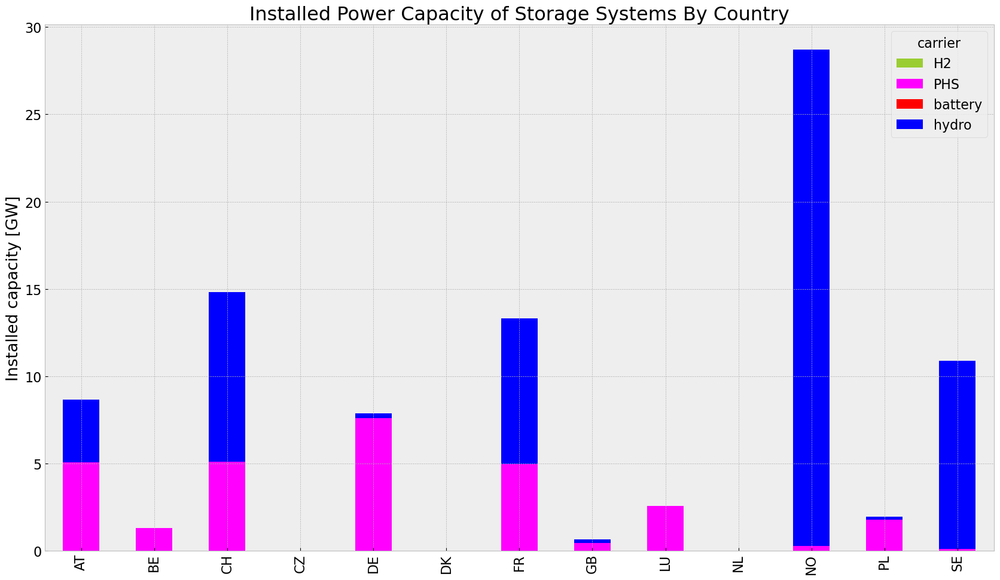

In [337]:
#storage unit capacities
store_noinv = inst_store_table(n2)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3576090030.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3576090030.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\1117423567.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\1117423567.py:3: FutureWarning: 'H' is deprecated and will be removed in a future v

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,2.953414e+07,0.451621,0.1980,1.294838e+07
biomass,3.377481e+07,0.468000,0.0000,0.000000e+00
coal,9.045827e+05,0.329908,0.3361,9.215606e+05
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,6.801254e+05,0.337285,0.4069,8.205027e+05
load,4.028269e+04,1.000000,0.0000,0.000000e+00
nuclear,1.554148e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.794435e+07,1.000000,0.0000,0.000000e+00


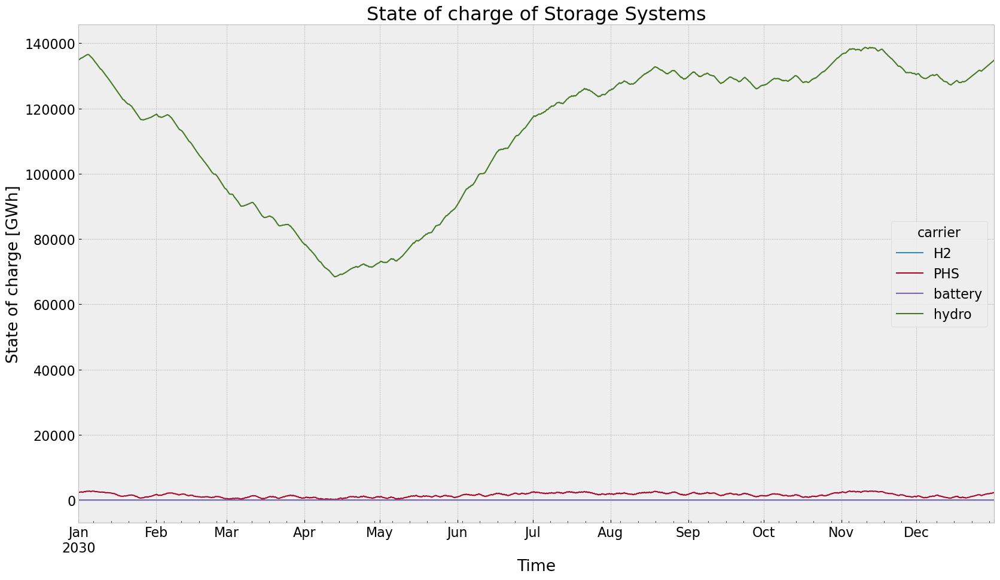

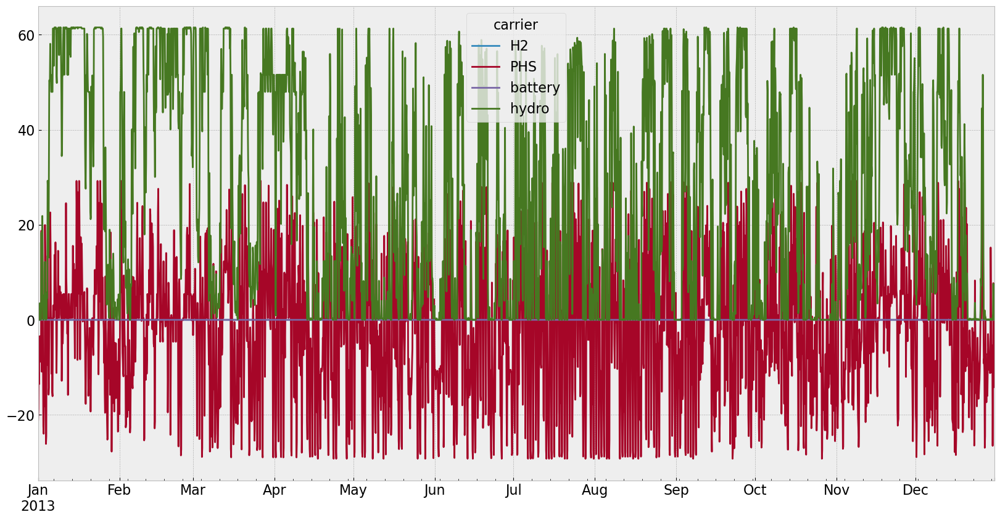

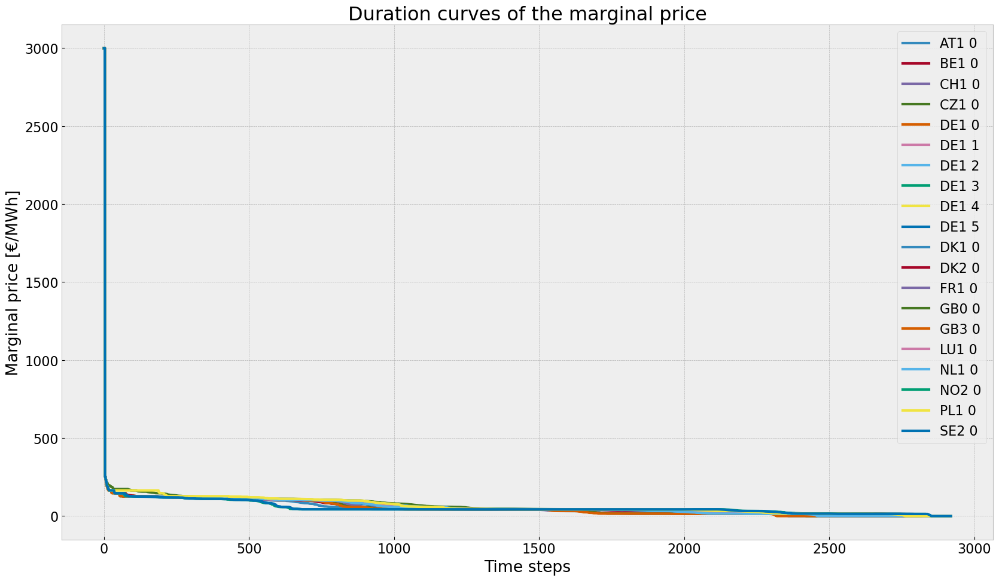

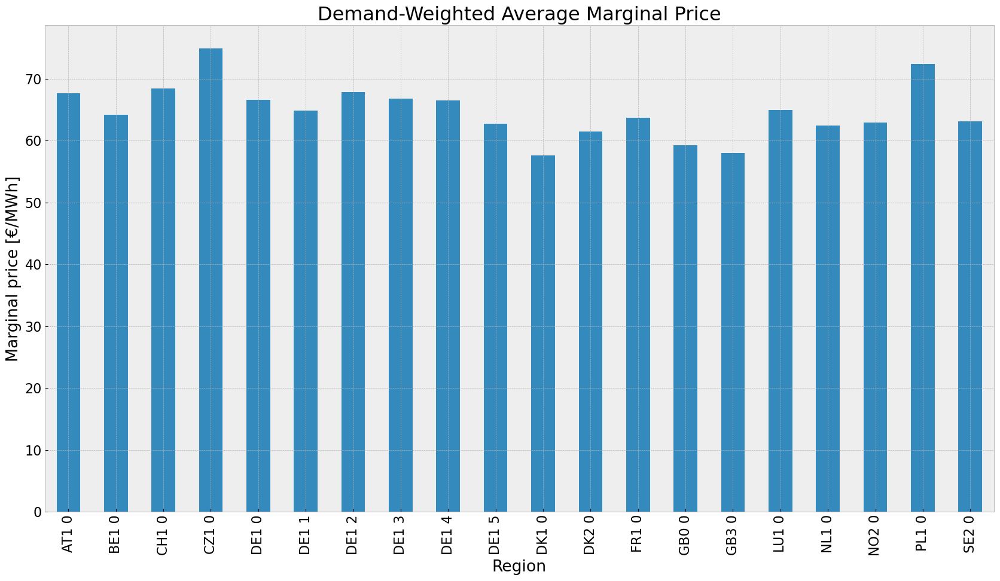

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


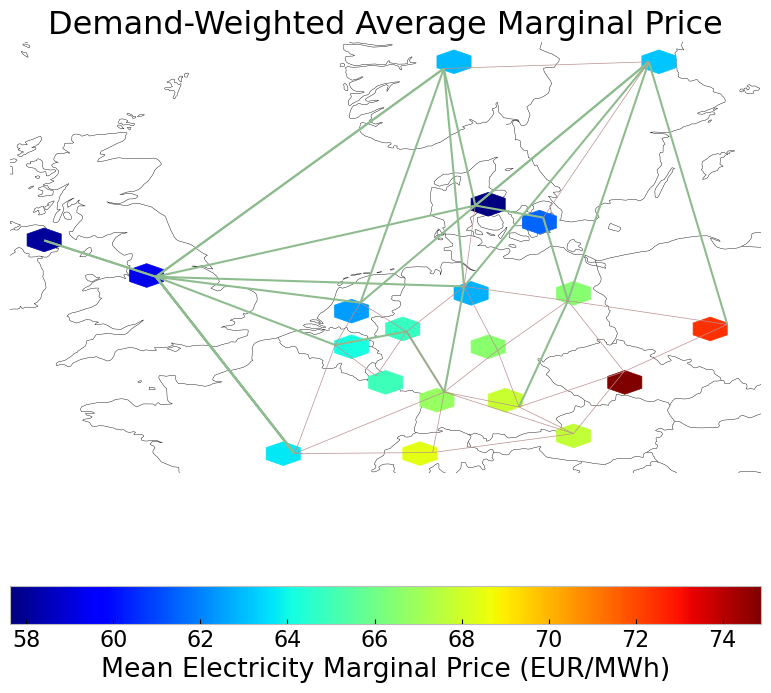

In [338]:
#state of charge
state_of_charge_plot(n2)
n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))
#price
price_dur_curve_plot(n2)
price_regions_table(n2)
price_regions(n2)
#emission
em_noinv =em_table(n2)
em_noinv

## 3. Scenario: rolling horizon foresight with no additional investment

In [339]:
n3= n2.copy()
n3.name = 'noinv_roll_dispatchcut'
horizon = 24
n3.storage_units['cyclic_state_of_charge'] = False
n3.storage_units['cyclic_state_of_charge_per_period'] = False
optimize.optimize_with_rolling_horizon(n3, horizon=horizon, overlap=0, solver_name='gurobi')
#n3 = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\Dispatchcut\\20240512\\noinv_roll_dispatchcut.nc")

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 21:00:00] (1/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wzc7dsq1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wzc7dsq1.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4cf2c19a


INFO:gurobipy:Model fingerprint: 0x4cf2c19a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25491 rows and 6862 columns


INFO:gurobipy:Presolve removed 25491 rows and 6862 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1341 rows, 5642 columns, 9352 nonzeros


INFO:gurobipy:Presolved: 1341 rows, 5642 columns, 9352 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.903e+03


INFO:gurobipy: AA' NZ     : 3.903e+03


 Factor NZ  : 3.639e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.639e+04 (roughly 3 MB of memory)


 Factor Ops : 1.751e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.751e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.25135757e+11 -1.94287833e+11  9.69e+04 3.64e-12  1.88e+08     0s


INFO:gurobipy:   0   2.25135757e+11 -1.94287833e+11  9.69e+04 3.64e-12  1.88e+08     0s


   1   1.84703727e+10 -9.62593237e+10  6.94e+03 2.91e-11  1.96e+07     0s


INFO:gurobipy:   1   1.84703727e+10 -9.62593237e+10  6.94e+03 2.91e-11  1.96e+07     0s


   2   2.53316618e+09 -2.37313602e+10  4.58e+02 1.02e-10  2.75e+06     0s


INFO:gurobipy:   2   2.53316618e+09 -2.37313602e+10  4.58e+02 1.02e-10  2.75e+06     0s


   3   5.74519374e+08 -2.50106259e+09  2.37e+01 1.20e-10  2.80e+05     0s


INFO:gurobipy:   3   5.74519374e+08 -2.50106259e+09  2.37e+01 1.20e-10  2.80e+05     0s


   4   1.95945236e+08 -1.04713869e+09  1.35e+00 4.37e-11  1.10e+05     0s


INFO:gurobipy:   4   1.95945236e+08 -1.04713869e+09  1.35e+00 4.37e-11  1.10e+05     0s


   5   1.29953142e+08 -4.73489009e+08  7.02e-01 2.18e-11  5.35e+04     0s


INFO:gurobipy:   5   1.29953142e+08 -4.73489009e+08  7.02e-01 2.18e-11  5.35e+04     0s


   6   9.43462347e+07 -1.60348875e+08  3.71e-01 1.46e-11  2.26e+04     0s


INFO:gurobipy:   6   9.43462347e+07 -1.60348875e+08  3.71e-01 1.46e-11  2.26e+04     0s


   7   4.76529547e+07 -2.55853912e+07  9.93e-03 1.46e-11  6.48e+03     0s


INFO:gurobipy:   7   4.76529547e+07 -2.55853912e+07  9.93e-03 1.46e-11  6.48e+03     0s


   8   4.02415127e+07  8.32703331e+06  4.35e-03 2.91e-11  2.82e+03     0s


INFO:gurobipy:   8   4.02415127e+07  8.32703331e+06  4.35e-03 2.91e-11  2.82e+03     0s


   9   3.61663650e+07  2.22449578e+07  1.91e-03 2.91e-11  1.23e+03     0s


INFO:gurobipy:   9   3.61663650e+07  2.22449578e+07  1.91e-03 2.91e-11  1.23e+03     0s


  10   3.30652811e+07  2.80220672e+07  2.76e-04 2.91e-11  4.46e+02     0s


INFO:gurobipy:  10   3.30652811e+07  2.80220672e+07  2.76e-04 2.91e-11  4.46e+02     0s


  11   3.25280712e+07  3.05718352e+07  1.09e-04 1.46e-11  1.73e+02     0s


INFO:gurobipy:  11   3.25280712e+07  3.05718352e+07  1.09e-04 1.46e-11  1.73e+02     0s


  12   3.23680565e+07  3.13964990e+07  6.13e-05 2.91e-11  8.60e+01     0s


INFO:gurobipy:  12   3.23680565e+07  3.13964990e+07  6.13e-05 2.91e-11  8.60e+01     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2086    3.2133955e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2086    3.2133955e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2086 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 2086 iterations and 0.22 seconds (0.06 work units)


Optimal objective  3.213395495e+07


INFO:gurobipy:Optimal objective  3.213395495e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.21e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 21:00:00] (2/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lckdmez0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lckdmez0.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdcd803fb


INFO:gurobipy:Model fingerprint: 0xdcd803fb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25503 rows and 6832 columns


INFO:gurobipy:Presolve removed 25503 rows and 6832 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1329 rows, 5672 columns, 9376 nonzeros


INFO:gurobipy:Presolved: 1329 rows, 5672 columns, 9376 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.896e+03


INFO:gurobipy: AA' NZ     : 3.896e+03


 Factor NZ  : 3.570e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.570e+04 (roughly 3 MB of memory)


 Factor Ops : 1.659e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.659e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.22620167e+11 -1.91508690e+11  1.03e+05 3.64e-12  1.79e+08     0s


INFO:gurobipy:   0   2.22620167e+11 -1.91508690e+11  1.03e+05 3.64e-12  1.79e+08     0s


   1   2.23980054e+10 -9.78430502e+10  8.94e+03 2.55e-11  2.15e+07     0s


INFO:gurobipy:   1   2.23980054e+10 -9.78430502e+10  8.94e+03 2.55e-11  2.15e+07     0s


   2   4.08061263e+09 -2.39793675e+10  8.87e+02 2.33e-10  3.24e+06     0s


INFO:gurobipy:   2   4.08061263e+09 -2.39793675e+10  8.87e+02 2.33e-10  3.24e+06     0s


   3   9.95699381e+08 -2.67909483e+09  7.42e+01 3.40e-10  3.51e+05     0s


INFO:gurobipy:   3   9.95699381e+08 -2.67909483e+09  7.42e+01 3.40e-10  3.51e+05     0s


   4   4.92586425e+08 -7.29203140e+08  7.21e+00 1.11e-10  1.09e+05     0s


INFO:gurobipy:   4   4.92586425e+08 -7.29203140e+08  7.21e+00 1.11e-10  1.09e+05     0s


   5   4.01243756e+08 -2.24018196e+08  3.76e+00 5.21e-11  5.54e+04     0s


INFO:gurobipy:   5   4.01243756e+08 -2.24018196e+08  3.76e+00 5.21e-11  5.54e+04     0s


   6   3.37879065e+08  3.61784635e+07  1.83e+00 2.91e-11  2.67e+04     0s


INFO:gurobipy:   6   3.37879065e+08  3.61784635e+07  1.83e+00 2.91e-11  2.67e+04     0s


   7   2.70658436e+08  1.56324642e+08  4.61e-01 1.46e-11  1.01e+04     0s


INFO:gurobipy:   7   2.70658436e+08  1.56324642e+08  4.61e-01 1.46e-11  1.01e+04     0s


   8   2.55788540e+08  2.03843952e+08  2.36e-01 2.91e-11  4.58e+03     0s


INFO:gurobipy:   8   2.55788540e+08  2.03843952e+08  2.36e-01 2.91e-11  4.58e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1787    2.3641613e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1787    2.3641613e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1787 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1787 iterations and 0.16 seconds (0.05 work units)


Optimal objective  2.364161322e+08


INFO:gurobipy:Optimal objective  2.364161322e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.36e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 21:00:00] (3/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ubb_5jt5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ubb_5jt5.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xae625edf


INFO:gurobipy:Model fingerprint: 0xae625edf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25509 rows and 6883 columns


INFO:gurobipy:Presolve removed 25509 rows and 6883 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1323 rows, 5621 columns, 9319 nonzeros


INFO:gurobipy:Presolved: 1323 rows, 5621 columns, 9319 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.890e+03


INFO:gurobipy: AA' NZ     : 3.890e+03


 Factor NZ  : 3.759e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.759e+04 (roughly 3 MB of memory)


 Factor Ops : 1.948e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.948e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.60222973e+11 -5.12172676e+11  1.11e+05 9.41e+03  5.01e+08     0s


INFO:gurobipy:   0   2.60222973e+11 -5.12172676e+11  1.11e+05 9.41e+03  5.01e+08     0s


   1   3.83821828e+10 -2.60634940e+11  7.78e+03 7.28e-11  5.29e+07     0s


INFO:gurobipy:   1   3.83821828e+10 -2.60634940e+11  7.78e+03 7.28e-11  5.29e+07     0s


   2   1.07404136e+10 -5.22876370e+10  4.74e+02 7.28e-11  6.69e+06     0s


INFO:gurobipy:   2   1.07404136e+10 -5.22876370e+10  4.74e+02 7.28e-11  6.69e+06     0s


   3   3.86139454e+09 -8.95972166e+09  7.18e+01 1.63e-09  1.23e+06     0s


INFO:gurobipy:   3   3.86139454e+09 -8.95972166e+09  7.18e+01 1.63e-09  1.23e+06     0s


   4   2.18537197e+09 -1.92886369e+09  2.59e+01 4.51e-10  3.83e+05     0s


INFO:gurobipy:   4   2.18537197e+09 -1.92886369e+09  2.59e+01 4.51e-10  3.83e+05     0s


   5   1.66433931e+09 -1.64341141e+08  1.36e+01 1.46e-10  1.68e+05     0s


INFO:gurobipy:   5   1.66433931e+09 -1.64341141e+08  1.36e+01 1.46e-10  1.68e+05     0s


   6   1.39288179e+09  5.98347796e+08  6.01e+00 1.31e-10  7.26e+04     0s


INFO:gurobipy:   6   1.39288179e+09  5.98347796e+08  6.01e+00 1.31e-10  7.26e+04     0s


   7   1.23096121e+09  8.64663442e+08  1.70e+00 8.73e-11  3.30e+04     0s


INFO:gurobipy:   7   1.23096121e+09  8.64663442e+08  1.70e+00 8.73e-11  3.30e+04     0s


   8   1.20381544e+09  9.89033677e+08  1.09e+00 4.37e-11  1.94e+04     0s


INFO:gurobipy:   8   1.20381544e+09  9.89033677e+08  1.09e+00 4.37e-11  1.94e+04     0s


   9   1.16372102e+09  1.07150860e+09  3.32e-01 2.91e-11  8.27e+03     0s


INFO:gurobipy:   9   1.16372102e+09  1.07150860e+09  3.32e-01 2.91e-11  8.27e+03     0s


  10   1.14459055e+09  1.10634602e+09  1.02e-01 2.91e-11  3.42e+03     0s


INFO:gurobipy:  10   1.14459055e+09  1.10634602e+09  1.02e-01 2.91e-11  3.42e+03     0s


  11   1.13797295e+09  1.11458186e+09  3.69e-02 2.91e-11  2.09e+03     0s


INFO:gurobipy:  11   1.13797295e+09  1.11458186e+09  3.69e-02 2.91e-11  2.09e+03     0s


  12   1.13681363e+09  1.11994926e+09  2.60e-02 2.91e-11  1.50e+03     0s


INFO:gurobipy:  12   1.13681363e+09  1.11994926e+09  2.60e-02 2.91e-11  1.50e+03     0s


  13   1.13557308e+09  1.12762485e+09  1.51e-02 2.91e-11  7.09e+02     0s


INFO:gurobipy:  13   1.13557308e+09  1.12762485e+09  1.51e-02 2.91e-11  7.09e+02     0s


  14   1.13467337e+09  1.13103387e+09  7.99e-03 2.91e-11  3.25e+02     0s


INFO:gurobipy:  14   1.13467337e+09  1.13103387e+09  7.99e-03 2.91e-11  3.25e+02     0s


  15   1.13453208e+09  1.13239792e+09  6.79e-03 2.91e-11  1.91e+02     0s


INFO:gurobipy:  15   1.13453208e+09  1.13239792e+09  6.79e-03 2.91e-11  1.91e+02     0s


  16   1.13391310e+09  1.13293972e+09  1.77e-03 2.91e-11  8.69e+01     0s


INFO:gurobipy:  16   1.13391310e+09  1.13293972e+09  1.77e-03 2.91e-11  8.69e+01     0s


  17   1.13379178e+09  1.13329012e+09  8.40e-04 2.91e-11  4.47e+01     0s


INFO:gurobipy:  17   1.13379178e+09  1.13329012e+09  8.40e-04 2.91e-11  4.47e+01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2054    1.1336666e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2054    1.1336666e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2054 iterations and 0.27 seconds (0.07 work units)


INFO:gurobipy:Solved in 2054 iterations and 0.27 seconds (0.07 work units)


Optimal objective  1.133666551e+09


INFO:gurobipy:Optimal objective  1.133666551e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.13e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 21:00:00] (4/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mzeynqtj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mzeynqtj.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x335a7396


INFO:gurobipy:Model fingerprint: 0x335a7396


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25499 rows and 6813 columns


INFO:gurobipy:Presolve removed 25499 rows and 6813 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1333 rows, 5691 columns, 9399 nonzeros


INFO:gurobipy:Presolved: 1333 rows, 5691 columns, 9399 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.900e+03


INFO:gurobipy: AA' NZ     : 3.900e+03


 Factor NZ  : 3.665e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.665e+04 (roughly 3 MB of memory)


 Factor Ops : 1.718e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.718e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.70035685e+11 -5.10918506e+11  6.93e+04 9.66e+03  3.24e+08     0s


INFO:gurobipy:   0   1.70035685e+11 -5.10918506e+11  6.93e+04 9.66e+03  3.24e+08     0s


   1   2.69086571e+10 -2.23941600e+11  5.04e+03 5.82e-11  3.82e+07     0s


INFO:gurobipy:   1   2.69086571e+10 -2.23941600e+11  5.04e+03 5.82e-11  3.82e+07     0s


   2   7.95828864e+09 -4.49993245e+10  3.82e+02 1.69e-09  5.44e+06     0s


INFO:gurobipy:   2   7.95828864e+09 -4.49993245e+10  3.82e+02 1.69e-09  5.44e+06     0s


   3   2.59220126e+09 -1.26702984e+10  7.58e+01 3.35e-10  1.43e+06     0s


INFO:gurobipy:   3   2.59220126e+09 -1.26702984e+10  7.58e+01 3.35e-10  1.43e+06     0s


   4   1.71322175e+09 -3.73879038e+09  4.17e+01 8.73e-11  5.03e+05     0s


INFO:gurobipy:   4   1.71322175e+09 -3.73879038e+09  4.17e+01 8.73e-11  5.03e+05     0s


   5   1.06527003e+09 -4.97867834e+08  2.47e+00 8.00e-11  1.38e+05     0s


INFO:gurobipy:   5   1.06527003e+09 -4.97867834e+08  2.47e+00 8.00e-11  1.38e+05     0s


   6   9.82084446e+08  2.61486470e+08  9.02e-01 2.91e-11  6.34e+04     0s


INFO:gurobipy:   6   9.82084446e+08  2.61486470e+08  9.02e-01 2.91e-11  6.34e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.23 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.23 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1741    8.3327601e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1741    8.3327601e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1741 iterations and 0.27 seconds (0.05 work units)


INFO:gurobipy:Solved in 1741 iterations and 0.27 seconds (0.05 work units)


Optimal objective  8.332760096e+08


INFO:gurobipy:Optimal objective  8.332760096e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 21:00:00] (5/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a1h71cuk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a1h71cuk.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x139743b2


INFO:gurobipy:Model fingerprint: 0x139743b2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25506 rows and 6857 columns


INFO:gurobipy:Presolve removed 25506 rows and 6857 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1326 rows, 5647 columns, 9348 nonzeros


INFO:gurobipy:Presolved: 1326 rows, 5647 columns, 9348 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.893e+03


INFO:gurobipy: AA' NZ     : 3.893e+03


 Factor NZ  : 3.551e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.551e+04 (roughly 3 MB of memory)


 Factor Ops : 1.614e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.614e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.54520030e+11 -5.11458245e+11  1.07e+05 9.82e+03  4.88e+08     0s


INFO:gurobipy:   0   2.54520030e+11 -5.11458245e+11  1.07e+05 9.82e+03  4.88e+08     0s


   1   3.73893178e+10 -2.65258377e+11  6.79e+03 7.28e-11  5.00e+07     0s


INFO:gurobipy:   1   3.73893178e+10 -2.65258377e+11  6.79e+03 7.28e-11  5.00e+07     0s


   2   1.11879327e+10 -5.29986261e+10  4.16e+02 2.18e-10  6.64e+06     0s


INFO:gurobipy:   2   1.11879327e+10 -5.29986261e+10  4.16e+02 2.18e-10  6.64e+06     0s


   3   4.77871099e+09 -8.16667329e+09  1.01e+02 4.51e-10  1.27e+06     0s


INFO:gurobipy:   3   4.77871099e+09 -8.16667329e+09  1.01e+02 4.51e-10  1.27e+06     0s


   4   2.18268982e+09 -1.52376584e+09  2.59e+01 1.89e-10  3.49e+05     0s


INFO:gurobipy:   4   2.18268982e+09 -1.52376584e+09  2.59e+01 1.89e-10  3.49e+05     0s


   5   1.63312826e+09 -7.84179840e+07  1.34e+01 1.31e-10  1.59e+05     0s


INFO:gurobipy:   5   1.63312826e+09 -7.84179840e+07  1.34e+01 1.31e-10  1.59e+05     0s


   6   1.40471974e+09  6.17250133e+08  7.29e+00 2.04e-10  7.24e+04     0s


INFO:gurobipy:   6   1.40471974e+09  6.17250133e+08  7.29e+00 2.04e-10  7.24e+04     0s


   7   1.30356974e+09  9.74896863e+08  3.13e+00 5.82e-11  2.96e+04     0s


INFO:gurobipy:   7   1.30356974e+09  9.74896863e+08  3.13e+00 5.82e-11  2.96e+04     0s


   8   1.27305146e+09  1.07853064e+09  1.95e+00 5.82e-11  1.74e+04     0s


INFO:gurobipy:   8   1.27305146e+09  1.07853064e+09  1.95e+00 5.82e-11  1.74e+04     0s


   9   1.24964857e+09  1.10099377e+09  1.12e+00 2.91e-11  1.33e+04     0s


INFO:gurobipy:   9   1.24964857e+09  1.10099377e+09  1.12e+00 2.91e-11  1.33e+04     0s


  10   1.22226680e+09  1.14177682e+09  1.79e-01 4.37e-11  7.13e+03     0s


INFO:gurobipy:  10   1.22226680e+09  1.14177682e+09  1.79e-01 4.37e-11  7.13e+03     0s


  11   1.21873144e+09  1.17590653e+09  1.23e-01 2.91e-11  3.79e+03     0s


INFO:gurobipy:  11   1.21873144e+09  1.17590653e+09  1.23e-01 2.91e-11  3.79e+03     0s


  12   1.21665726e+09  1.18452851e+09  1.00e-01 2.91e-11  2.85e+03     0s


INFO:gurobipy:  12   1.21665726e+09  1.18452851e+09  1.00e-01 2.91e-11  2.85e+03     0s


  13   1.21210509e+09  1.19066470e+09  5.03e-02 2.91e-11  1.90e+03     0s


INFO:gurobipy:  13   1.21210509e+09  1.19066470e+09  5.03e-02 2.91e-11  1.90e+03     0s


  14   1.21021189e+09  1.19451649e+09  3.42e-02 2.91e-11  1.39e+03     0s


INFO:gurobipy:  14   1.21021189e+09  1.19451649e+09  3.42e-02 2.91e-11  1.39e+03     0s


  15   1.20706422e+09  1.20121388e+09  9.82e-03 2.91e-11  5.18e+02     0s


INFO:gurobipy:  15   1.20706422e+09  1.20121388e+09  9.82e-03 2.91e-11  5.18e+02     0s


  16   1.20636345e+09  1.20280215e+09  6.21e-03 1.46e-11  3.15e+02     0s


INFO:gurobipy:  16   1.20636345e+09  1.20280215e+09  6.21e-03 1.46e-11  3.15e+02     0s


  17   1.20612023e+09  1.20326806e+09  5.05e-03 2.91e-11  2.52e+02     0s


INFO:gurobipy:  17   1.20612023e+09  1.20326806e+09  5.05e-03 2.91e-11  2.52e+02     0s


  18   1.20583035e+09  1.20387258e+09  3.57e-03 2.91e-11  1.73e+02     0s


INFO:gurobipy:  18   1.20583035e+09  1.20387258e+09  3.57e-03 2.91e-11  1.73e+02     0s


  19   1.20577134e+09  1.20437211e+09  3.28e-03 1.46e-11  1.24e+02     0s


INFO:gurobipy:  19   1.20577134e+09  1.20437211e+09  3.28e-03 1.46e-11  1.24e+02     0s


  20   1.20529003e+09  1.20472794e+09  8.86e-04 2.91e-11  4.97e+01     0s


INFO:gurobipy:  20   1.20529003e+09  1.20472794e+09  8.86e-04 2.91e-11  4.97e+01     0s


  21   1.20527151e+09  1.20485118e+09  8.11e-04 1.46e-11  3.72e+01     0s


INFO:gurobipy:  21   1.20527151e+09  1.20485118e+09  8.11e-04 1.46e-11  3.72e+01     0s


  22   1.20515335e+09  1.20495295e+09  2.82e-04 2.18e-11  1.77e+01     0s


INFO:gurobipy:  22   1.20515335e+09  1.20495295e+09  2.82e-04 2.18e-11  1.77e+01     0s


  23   1.20514540e+09  1.20499250e+09  2.54e-04 1.52e-11  1.35e+01     0s


INFO:gurobipy:  23   1.20514540e+09  1.20499250e+09  2.54e-04 1.52e-11  1.35e+01     0s


  24   1.20513024e+09  1.20502182e+09  1.84e-04 2.03e-11  9.60e+00     0s


INFO:gurobipy:  24   1.20513024e+09  1.20502182e+09  1.84e-04 2.03e-11  9.60e+00     0s


  25   1.20512385e+09  1.20503540e+09  1.60e-04 2.91e-11  7.83e+00     0s


INFO:gurobipy:  25   1.20512385e+09  1.20503540e+09  1.60e-04 2.91e-11  7.83e+00     0s


  26   1.20510799e+09  1.20505743e+09  9.29e-05 2.91e-11  4.48e+00     0s


INFO:gurobipy:  26   1.20510799e+09  1.20505743e+09  9.29e-05 2.91e-11  4.48e+00     0s


  27   1.20510045e+09  1.20506590e+09  6.43e-05 2.91e-11  3.06e+00     0s


INFO:gurobipy:  27   1.20510045e+09  1.20506590e+09  6.43e-05 2.91e-11  3.06e+00     0s


  28   1.20509439e+09  1.20507630e+09  3.96e-05 1.46e-11  1.60e+00     0s


INFO:gurobipy:  28   1.20509439e+09  1.20507630e+09  3.96e-05 1.46e-11  1.60e+00     0s


  29   1.20509086e+09  1.20507843e+09  2.68e-05 1.46e-11  1.10e+00     0s


INFO:gurobipy:  29   1.20509086e+09  1.20507843e+09  2.68e-05 1.46e-11  1.10e+00     0s


  30   1.20509051e+09  1.20508018e+09  2.52e-05 2.91e-11  9.14e-01     0s


INFO:gurobipy:  30   1.20509051e+09  1.20508018e+09  2.52e-05 2.91e-11  9.14e-01     0s


  31   1.20508814e+09  1.20508176e+09  1.53e-05 2.91e-11  5.64e-01     0s


INFO:gurobipy:  31   1.20508814e+09  1.20508176e+09  1.53e-05 2.91e-11  5.64e-01     0s


  32   1.20508610e+09  1.20508290e+09  7.19e-06 1.48e-11  2.83e-01     0s


INFO:gurobipy:  32   1.20508610e+09  1.20508290e+09  7.19e-06 1.48e-11  2.83e-01     0s


  33   1.20508587e+09  1.20508352e+09  6.29e-06 1.47e-11  2.09e-01     0s


INFO:gurobipy:  33   1.20508587e+09  1.20508352e+09  6.29e-06 1.47e-11  2.09e-01     0s


  34   1.20508491e+09  1.20508372e+09  2.86e-06 1.46e-11  1.05e-01     0s


INFO:gurobipy:  34   1.20508491e+09  1.20508372e+09  2.86e-06 1.46e-11  1.05e-01     0s


  35   1.20508435e+09  1.20508393e+09  8.71e-07 1.66e-11  3.73e-02     0s


INFO:gurobipy:  35   1.20508435e+09  1.20508393e+09  8.71e-07 1.66e-11  3.73e-02     0s


  36   1.20508424e+09  1.20508400e+09  4.91e-07 1.83e-11  2.14e-02     0s


INFO:gurobipy:  36   1.20508424e+09  1.20508400e+09  4.91e-07 1.83e-11  2.14e-02     0s


  37   1.20508422e+09  1.20508403e+09  4.11e-07 1.82e-11  1.64e-02     0s


INFO:gurobipy:  37   1.20508422e+09  1.20508403e+09  4.11e-07 1.82e-11  1.64e-02     0s


  38   1.20508415e+09  1.20508406e+09  1.76e-07 2.91e-11  7.71e-03     0s


INFO:gurobipy:  38   1.20508415e+09  1.20508406e+09  1.76e-07 2.91e-11  7.71e-03     0s


INFO:gurobipy:


Barrier performed 38 iterations in 0.41 seconds (0.08 work units)


INFO:gurobipy:Barrier performed 38 iterations in 0.41 seconds (0.08 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1936    1.2050841e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1936    1.2050841e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1936 iterations and 0.47 seconds (0.07 work units)


INFO:gurobipy:Solved in 1936 iterations and 0.47 seconds (0.07 work units)


Optimal objective  1.205084092e+09


INFO:gurobipy:Optimal objective  1.205084092e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.21e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 21:00:00] (6/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-atgkjgkr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-atgkjgkr.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5aa69773


INFO:gurobipy:Model fingerprint: 0x5aa69773


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25513 rows and 6927 columns


INFO:gurobipy:Presolve removed 25513 rows and 6927 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1319 rows, 5577 columns, 9271 nonzeros


INFO:gurobipy:Presolved: 1319 rows, 5577 columns, 9271 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.886e+03


INFO:gurobipy: AA' NZ     : 3.886e+03


 Factor NZ  : 3.806e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.806e+04 (roughly 3 MB of memory)


 Factor Ops : 2.067e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.067e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.56858916e+11 -5.15007725e+11  1.10e+05 1.53e+04  5.04e+08     0s


INFO:gurobipy:   0   2.56858916e+11 -5.15007725e+11  1.10e+05 1.53e+04  5.04e+08     0s


   1   4.21356961e+10 -2.63707382e+11  7.43e+03 7.28e-11  5.31e+07     0s


INFO:gurobipy:   1   4.21356961e+10 -2.63707382e+11  7.43e+03 7.28e-11  5.31e+07     0s


   2   1.49180719e+10 -4.58060939e+10  4.77e+02 4.37e-10  6.56e+06     0s


INFO:gurobipy:   2   1.49180719e+10 -4.58060939e+10  4.77e+02 4.37e-10  6.56e+06     0s


   3   8.94031373e+09 -5.28989034e+09  1.01e+02 1.19e-09  1.42e+06     0s


INFO:gurobipy:   3   8.94031373e+09 -5.28989034e+09  1.01e+02 1.19e-09  1.42e+06     0s


   4   6.67009236e+09  2.43766977e+09  2.31e+01 3.64e-10  4.03e+05     0s


INFO:gurobipy:   4   6.67009236e+09  2.43766977e+09  2.31e+01 3.64e-10  4.03e+05     0s


   5   6.25350494e+09  4.54909604e+09  1.17e+01 1.16e-10  1.62e+05     0s


INFO:gurobipy:   5   6.25350494e+09  4.54909604e+09  1.17e+01 1.16e-10  1.62e+05     0s


   6   6.06870858e+09  5.30102786e+09  6.48e+00 8.73e-11  7.31e+04     0s


INFO:gurobipy:   6   6.06870858e+09  5.30102786e+09  6.48e+00 8.73e-11  7.31e+04     0s


   7   5.95061693e+09  5.62856629e+09  3.07e+00 1.02e-10  3.07e+04     0s


INFO:gurobipy:   7   5.95061693e+09  5.62856629e+09  3.07e+00 1.02e-10  3.07e+04     0s


   8   5.86694783e+09  5.73558140e+09  8.63e-01 5.82e-11  1.23e+04     0s


INFO:gurobipy:   8   5.86694783e+09  5.73558140e+09  8.63e-01 5.82e-11  1.23e+04     0s


   9   5.86012771e+09  5.76544443e+09  7.19e-01 4.37e-11  8.89e+03     0s


INFO:gurobipy:   9   5.86012771e+09  5.76544443e+09  7.19e-01 4.37e-11  8.89e+03     0s


  10   5.84561726e+09  5.79325316e+09  4.17e-01 2.91e-11  4.92e+03     0s


INFO:gurobipy:  10   5.84561726e+09  5.79325316e+09  4.17e-01 2.91e-11  4.92e+03     0s


  11   5.83971142e+09  5.79778079e+09  3.04e-01 2.91e-11  3.92e+03     0s


INFO:gurobipy:  11   5.83971142e+09  5.79778079e+09  3.04e-01 2.91e-11  3.92e+03     0s


  12   5.83202502e+09  5.80841837e+09  1.59e-01 2.91e-11  2.20e+03     0s


INFO:gurobipy:  12   5.83202502e+09  5.80841837e+09  1.59e-01 2.91e-11  2.20e+03     0s


  13   5.82611901e+09  5.81467444e+09  5.36e-02 2.91e-11  1.05e+03     0s


INFO:gurobipy:  13   5.82611901e+09  5.81467444e+09  5.36e-02 2.91e-11  1.05e+03     0s


  14   5.82490905e+09  5.81968720e+09  3.25e-02 2.91e-11  4.86e+02     0s


INFO:gurobipy:  14   5.82490905e+09  5.81968720e+09  3.25e-02 2.91e-11  4.86e+02     0s


  15   5.82326735e+09  5.82107413e+09  7.52e-03 2.91e-11  2.01e+02     0s


INFO:gurobipy:  15   5.82326735e+09  5.82107413e+09  7.52e-03 2.91e-11  2.01e+02     0s


  16   5.82307006e+09  5.82208309e+09  4.62e-03 2.91e-11  9.09e+01     0s


INFO:gurobipy:  16   5.82307006e+09  5.82208309e+09  4.62e-03 2.91e-11  9.09e+01     0s


  17   5.82281340e+09  5.82263441e+09  7.79e-04 2.91e-11  1.65e+01     0s


INFO:gurobipy:  17   5.82281340e+09  5.82263441e+09  7.79e-04 2.91e-11  1.65e+01     0s


  18   5.82277642e+09  5.82269268e+09  3.42e-04 2.91e-11  7.69e+00     0s


INFO:gurobipy:  18   5.82277642e+09  5.82269268e+09  3.42e-04 2.91e-11  7.69e+00     0s


  19   5.82275282e+09  5.82272711e+09  7.10e-05 2.91e-11  2.34e+00     0s


INFO:gurobipy:  19   5.82275282e+09  5.82272711e+09  7.10e-05 2.91e-11  2.34e+00     0s


  20   5.82274708e+09  5.82274207e+09  1.17e-05 2.91e-11  4.55e-01     0s


INFO:gurobipy:  20   5.82274708e+09  5.82274207e+09  1.17e-05 2.91e-11  4.55e-01     0s


  21   5.82274572e+09  5.82274468e+09  2.04e-06 2.91e-11  9.38e-02     0s


INFO:gurobipy:  21   5.82274572e+09  5.82274468e+09  2.04e-06 2.91e-11  9.38e-02     0s


  22   5.82274546e+09  5.82274508e+09  6.45e-07 2.91e-11  3.44e-02     0s


INFO:gurobipy:  22   5.82274546e+09  5.82274508e+09  6.45e-07 2.91e-11  3.44e-02     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.35 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.35 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1976    5.8227453e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1976    5.8227453e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1976 iterations and 0.38 seconds (0.05 work units)


INFO:gurobipy:Solved in 1976 iterations and 0.38 seconds (0.05 work units)


Optimal objective  5.822745339e+09


INFO:gurobipy:Optimal objective  5.822745339e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.82e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 21:00:00] (7/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-15uicl4g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-15uicl4g.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x990bd66c


INFO:gurobipy:Model fingerprint: 0x990bd66c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25495 rows and 6877 columns


INFO:gurobipy:Presolve removed 25495 rows and 6877 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1337 rows, 5627 columns, 9339 nonzeros


INFO:gurobipy:Presolved: 1337 rows, 5627 columns, 9339 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.521e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.521e+04 (roughly 3 MB of memory)


 Factor Ops : 1.541e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.541e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.11658609e+11 -1.89662962e+11  9.71e+04 3.64e-12  1.70e+08     0s


INFO:gurobipy:   0   2.11658609e+11 -1.89662962e+11  9.71e+04 3.64e-12  1.70e+08     0s


   1   2.43513583e+10 -9.53037965e+10  9.54e+03 2.91e-11  2.21e+07     0s


INFO:gurobipy:   1   2.43513583e+10 -9.53037965e+10  9.54e+03 2.91e-11  2.21e+07     0s


   2   5.32307633e+09 -2.46535260e+10  1.18e+03 2.11e-10  3.71e+06     0s


INFO:gurobipy:   2   5.32307633e+09 -2.46535260e+10  1.18e+03 2.11e-10  3.71e+06     0s


   3   1.00468989e+09 -3.47940315e+09  5.76e+01 3.78e-10  4.22e+05     0s


INFO:gurobipy:   3   1.00468989e+09 -3.47940315e+09  5.76e+01 3.78e-10  4.22e+05     0s


   4   6.07433723e+08 -6.85731658e+08  5.86e+00 9.46e-11  1.16e+05     0s


INFO:gurobipy:   4   6.07433723e+08 -6.85731658e+08  5.86e+00 9.46e-11  1.16e+05     0s


   5   4.96772142e+08 -1.26440547e+08  2.70e+00 4.09e-11  5.55e+04     0s


INFO:gurobipy:   5   4.96772142e+08 -1.26440547e+08  2.70e+00 4.09e-11  5.55e+04     0s


   6   4.30885391e+08  3.54624270e+07  1.27e+00 2.64e-11  3.52e+04     0s


INFO:gurobipy:   6   4.30885391e+08  3.54624270e+07  1.27e+00 2.64e-11  3.52e+04     0s


   7   3.87054375e+08  1.13698824e+08  5.42e-01 1.86e-11  2.43e+04     0s


INFO:gurobipy:   7   3.87054375e+08  1.13698824e+08  5.42e-01 1.86e-11  2.43e+04     0s


   8   3.67123324e+08  2.32766497e+08  3.14e-01 2.91e-11  1.19e+04     0s


INFO:gurobipy:   8   3.67123324e+08  2.32766497e+08  3.14e-01 2.91e-11  1.19e+04     0s


   9   3.41262279e+08  2.91282043e+08  5.81e-02 1.46e-11  4.44e+03     0s


INFO:gurobipy:   9   3.41262279e+08  2.91282043e+08  5.81e-02 1.46e-11  4.44e+03     0s


  10   3.32126361e+08  3.18562766e+08  8.60e-03 2.91e-11  1.20e+03     0s


INFO:gurobipy:  10   3.32126361e+08  3.18562766e+08  8.60e-03 2.91e-11  1.20e+03     0s


  11   3.30364193e+08  3.25615593e+08  3.23e-03 1.46e-11  4.21e+02     0s


INFO:gurobipy:  11   3.30364193e+08  3.25615593e+08  3.23e-03 1.46e-11  4.21e+02     0s


  12   3.29707617e+08  3.27634814e+08  1.57e-03 1.46e-11  1.84e+02     0s


INFO:gurobipy:  12   3.29707617e+08  3.27634814e+08  1.57e-03 1.46e-11  1.84e+02     0s


  13   3.29295092e+08  3.28267097e+08  6.10e-04 2.91e-11  9.12e+01     0s


INFO:gurobipy:  13   3.29295092e+08  3.28267097e+08  6.10e-04 2.91e-11  9.12e+01     0s


  14   3.29144402e+08  3.28737019e+08  2.77e-04 1.46e-11  3.62e+01     0s


INFO:gurobipy:  14   3.29144402e+08  3.28737019e+08  2.77e-04 1.46e-11  3.62e+01     0s


  15   3.29038196e+08  3.28937074e+08  4.79e-05 1.46e-11  8.97e+00     0s


INFO:gurobipy:  15   3.29038196e+08  3.28937074e+08  4.79e-05 1.46e-11  8.97e+00     0s


  16   3.29017040e+08  3.28993796e+08  1.12e-05 1.46e-11  2.06e+00     0s


INFO:gurobipy:  16   3.29017040e+08  3.28993796e+08  1.12e-05 1.46e-11  2.06e+00     0s


  17   3.29010562e+08  3.29005726e+08  1.50e-06 2.91e-11  4.29e-01     0s


INFO:gurobipy:  17   3.29010562e+08  3.29005726e+08  1.50e-06 2.91e-11  4.29e-01     0s


  18   3.29009549e+08  3.29008065e+08  3.11e-07 1.46e-11  1.32e-01     0s


INFO:gurobipy:  18   3.29009549e+08  3.29008065e+08  3.11e-07 1.46e-11  1.32e-01     0s


  19   3.29009309e+08  3.29009047e+08  7.28e-08 2.91e-11  2.32e-02     0s


INFO:gurobipy:  19   3.29009309e+08  3.29009047e+08  7.28e-08 2.91e-11  2.32e-02     0s


  20   3.29009235e+08  3.29009188e+08  1.30e-08 2.91e-11  4.15e-03     0s


INFO:gurobipy:  20   3.29009235e+08  3.29009188e+08  1.30e-08 2.91e-11  4.15e-03     0s


  21   3.29009218e+08  3.29009216e+08  2.29e-09 2.91e-11  1.63e-04     0s


INFO:gurobipy:  21   3.29009218e+08  3.29009216e+08  2.29e-09 2.91e-11  1.63e-04     0s


  22   3.29009217e+08  3.29009217e+08  2.72e-09 2.91e-11  1.27e-06     0s


INFO:gurobipy:  22   3.29009217e+08  3.29009217e+08  2.72e-09 2.91e-11  1.27e-06     0s


  23   3.29009217e+08  3.29009217e+08  1.68e-10 2.91e-11  1.27e-09     0s


INFO:gurobipy:  23   3.29009217e+08  3.29009217e+08  1.68e-10 2.91e-11  1.27e-09     0s


INFO:gurobipy:


Barrier solved model in 23 iterations and 0.34 seconds (0.05 work units)


INFO:gurobipy:Barrier solved model in 23 iterations and 0.34 seconds (0.05 work units)


Optimal objective 3.29009217e+08


INFO:gurobipy:Optimal objective 3.29009217e+08


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2043    3.2900922e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2043    3.2900922e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2043 iterations and 0.36 seconds (0.06 work units)


INFO:gurobipy:Solved in 2043 iterations and 0.36 seconds (0.06 work units)


Optimal objective  3.290092172e+08


INFO:gurobipy:Optimal objective  3.290092172e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 21:00:00] (8/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 102.93it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-356nxrb_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-356nxrb_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9163531b


INFO:gurobipy:Model fingerprint: 0x9163531b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25504 rows and 6921 columns


INFO:gurobipy:Presolve removed 25504 rows and 6921 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1328 rows, 5583 columns, 9286 nonzeros


INFO:gurobipy:Presolved: 1328 rows, 5583 columns, 9286 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.895e+03


INFO:gurobipy: AA' NZ     : 3.895e+03


 Factor NZ  : 3.517e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.517e+04 (roughly 3 MB of memory)


 Factor Ops : 1.542e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.542e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.04531893e+11 -4.98332332e+11  8.31e+04 9.70e+03  3.80e+08     0s


INFO:gurobipy:   0   2.04531893e+11 -4.98332332e+11  8.31e+04 9.70e+03  3.80e+08     0s


   1   3.56157131e+10 -2.31724087e+11  5.94e+03 5.82e-11  4.33e+07     0s


INFO:gurobipy:   1   3.56157131e+10 -2.31724087e+11  5.94e+03 5.82e-11  4.33e+07     0s


   2   1.37153360e+10 -4.27670776e+10  4.29e+02 9.17e-10  6.01e+06     0s


INFO:gurobipy:   2   1.37153360e+10 -4.27670776e+10  4.29e+02 9.17e-10  6.01e+06     0s


   3   8.99745921e+09 -3.93976160e+09  1.25e+02 4.22e-10  1.33e+06     0s


INFO:gurobipy:   3   8.99745921e+09 -3.93976160e+09  1.25e+02 4.22e-10  1.33e+06     0s


   4   6.92179401e+09  3.89207427e+09  2.94e+01 7.13e-10  3.01e+05     0s


INFO:gurobipy:   4   6.92179401e+09  3.89207427e+09  2.94e+01 7.13e-10  3.01e+05     0s


   5   6.42458725e+09  5.43681244e+09  1.10e+01 2.18e-10  9.77e+04     0s


INFO:gurobipy:   5   6.42458725e+09  5.43681244e+09  1.10e+01 2.18e-10  9.77e+04     0s


   6   6.24078537e+09  5.85758535e+09  4.02e+00 1.16e-10  3.74e+04     0s


INFO:gurobipy:   6   6.24078537e+09  5.85758535e+09  4.02e+00 1.16e-10  3.74e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1832    6.1268236e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1832    6.1268236e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1832 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1832 iterations and 0.16 seconds (0.05 work units)


Optimal objective  6.126823614e+09


INFO:gurobipy:Optimal objective  6.126823614e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.13e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 21:00:00] (9/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s5lz9oce.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s5lz9oce.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe22593cd


INFO:gurobipy:Model fingerprint: 0xe22593cd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25503 rows and 6972 columns


INFO:gurobipy:Presolve removed 25503 rows and 6972 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1329 rows, 5532 columns, 9236 nonzeros


INFO:gurobipy:Presolved: 1329 rows, 5532 columns, 9236 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.896e+03


INFO:gurobipy: AA' NZ     : 3.896e+03


 Factor NZ  : 3.640e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.640e+04 (roughly 3 MB of memory)


 Factor Ops : 1.722e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.722e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.09020305e+11 -1.84887126e+11  9.29e+04 3.64e-12  1.73e+08     0s


INFO:gurobipy:   0   2.09020305e+11 -1.84887126e+11  9.29e+04 3.64e-12  1.73e+08     0s


   1   2.89237600e+10 -8.85955885e+10  1.12e+04 2.91e-11  2.50e+07     0s


INFO:gurobipy:   1   2.89237600e+10 -8.85955885e+10  1.12e+04 2.91e-11  2.50e+07     0s


   2   7.00956254e+09 -2.51697936e+10  1.75e+03 4.00e-10  4.62e+06     0s


INFO:gurobipy:   2   7.00956254e+09 -2.51697936e+10  1.75e+03 4.00e-10  4.62e+06     0s


   3   3.97472315e+09 -7.76168395e+09  7.56e+02 3.71e-10  1.62e+06     0s


INFO:gurobipy:   3   3.97472315e+09 -7.76168395e+09  7.56e+02 3.71e-10  1.62e+06     0s


   4   2.78930371e+09 -2.42310605e+09  3.24e+02 2.04e-10  6.66e+05     0s


INFO:gurobipy:   4   2.78930371e+09 -2.42310605e+09  3.24e+02 2.04e-10  6.66e+05     0s


   5   2.36958868e+09  7.39309561e+07  1.33e+02 2.18e-10  2.72e+05     0s


INFO:gurobipy:   5   2.36958868e+09  7.39309561e+07  1.33e+02 2.18e-10  2.72e+05     0s


   6   2.16862104e+09  1.04883408e+09  6.88e+01 1.75e-10  1.28e+05     0s


INFO:gurobipy:   6   2.16862104e+09  1.04883408e+09  6.88e+01 1.75e-10  1.28e+05     0s


   7   1.98239845e+09  1.51751036e+09  1.77e+01 1.89e-10  4.76e+04     0s


INFO:gurobipy:   7   1.98239845e+09  1.51751036e+09  1.77e+01 1.89e-10  4.76e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2222    1.8758455e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2222    1.8758455e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2222 iterations and 0.16 seconds (0.06 work units)


INFO:gurobipy:Solved in 2222 iterations and 0.16 seconds (0.06 work units)


Optimal objective  1.875845525e+09


INFO:gurobipy:Optimal objective  1.875845525e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.88e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 21:00:00] (10/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.37it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rc3le4a2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rc3le4a2.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x198a01ac


INFO:gurobipy:Model fingerprint: 0x198a01ac


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25506 rows and 7026 columns


INFO:gurobipy:Presolve removed 25506 rows and 7026 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1326 rows, 5478 columns, 9143 nonzeros


INFO:gurobipy:Presolved: 1326 rows, 5478 columns, 9143 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.863e+03


INFO:gurobipy: AA' NZ     : 3.863e+03


 Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


 Factor Ops : 1.580e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.580e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.36577417e+11 -1.86383094e+11  6.16e+04 9.02e-02  1.25e+08     0s


INFO:gurobipy:   0   1.36577417e+11 -1.86383094e+11  6.16e+04 9.02e-02  1.25e+08     0s


   1   1.50561877e+10 -8.43439611e+10  5.57e+03 4.37e-11  1.63e+07     0s


INFO:gurobipy:   1   1.50561877e+10 -8.43439611e+10  5.57e+03 4.37e-11  1.63e+07     0s


   2   2.92448930e+09 -2.03775147e+10  5.83e+02 1.75e-10  2.66e+06     0s


INFO:gurobipy:   2   2.92448930e+09 -2.03775147e+10  5.83e+02 1.75e-10  2.66e+06     0s


   3   6.29785471e+08 -2.87639047e+09  3.92e+01 3.60e-10  3.34e+05     0s


INFO:gurobipy:   3   6.29785471e+08 -2.87639047e+09  3.92e+01 3.60e-10  3.34e+05     0s


   4   2.40756327e+08 -1.11823506e+09  3.55e+00 1.27e-10  1.25e+05     0s


INFO:gurobipy:   4   2.40756327e+08 -1.11823506e+09  3.55e+00 1.27e-10  1.25e+05     0s


   5   1.60933296e+08 -5.49899871e+08  1.73e+00 5.46e-11  6.50e+04     0s


INFO:gurobipy:   5   1.60933296e+08 -5.49899871e+08  1.73e+00 5.46e-11  6.50e+04     0s


   6   1.13792348e+08 -2.90713481e+08  1.03e+00 3.09e-11  3.69e+04     0s


INFO:gurobipy:   6   1.13792348e+08 -2.90713481e+08  1.03e+00 3.09e-11  3.69e+04     0s


   7   6.56847557e+07 -1.07532043e+08  3.10e-01 1.46e-11  1.58e+04     0s


INFO:gurobipy:   7   6.56847557e+07 -1.07532043e+08  3.10e-01 1.46e-11  1.58e+04     0s


   8   5.10070042e+07 -4.45233496e+07  1.70e-01 1.46e-11  8.71e+03     0s


INFO:gurobipy:   8   5.10070042e+07 -4.45233496e+07  1.70e-01 1.46e-11  8.71e+03     0s


   9   4.07582630e+07 -4.54102456e+06  8.57e-02 1.46e-11  4.13e+03     0s


INFO:gurobipy:   9   4.07582630e+07 -4.54102456e+06  8.57e-02 1.46e-11  4.13e+03     0s


  10   3.22641255e+07  1.50127233e+07  2.31e-02 2.91e-11  1.57e+03     0s


INFO:gurobipy:  10   3.22641255e+07  1.50127233e+07  2.31e-02 2.91e-11  1.57e+03     0s


  11   3.02721823e+07  2.23957204e+07  1.28e-02 1.46e-11  7.18e+02     0s


INFO:gurobipy:  11   3.02721823e+07  2.23957204e+07  1.28e-02 1.46e-11  7.18e+02     0s


  12   2.92532445e+07  2.48948228e+07  8.09e-03 1.46e-11  3.97e+02     0s


INFO:gurobipy:  12   2.92532445e+07  2.48948228e+07  8.09e-03 1.46e-11  3.97e+02     0s


  13   2.82638907e+07  2.58773393e+07  3.57e-03 2.91e-11  2.18e+02     0s


INFO:gurobipy:  13   2.82638907e+07  2.58773393e+07  3.57e-03 2.91e-11  2.18e+02     0s


  14   2.79248472e+07  2.64943342e+07  2.04e-03 1.46e-11  1.30e+02     0s


INFO:gurobipy:  14   2.79248472e+07  2.64943342e+07  2.04e-03 1.46e-11  1.30e+02     0s


  15   2.76155039e+07  2.69847989e+07  6.89e-04 1.46e-11  5.75e+01     0s


INFO:gurobipy:  15   2.76155039e+07  2.69847989e+07  6.89e-04 1.46e-11  5.75e+01     0s


  16   2.74868949e+07  2.72808131e+07  1.76e-04 2.91e-11  1.88e+01     0s


INFO:gurobipy:  16   2.74868949e+07  2.72808131e+07  1.76e-04 2.91e-11  1.88e+01     0s


  17   2.74539977e+07  2.73522984e+07  6.71e-05 2.91e-11  9.27e+00     0s


INFO:gurobipy:  17   2.74539977e+07  2.73522984e+07  6.71e-05 2.91e-11  9.27e+00     0s


  18   2.74414059e+07  2.73946329e+07  2.95e-05 1.46e-11  4.26e+00     0s


INFO:gurobipy:  18   2.74414059e+07  2.73946329e+07  2.95e-05 1.46e-11  4.26e+00     0s


  19   2.74339703e+07  2.74145524e+07  9.38e-06 2.91e-11  1.77e+00     0s


INFO:gurobipy:  19   2.74339703e+07  2.74145524e+07  9.38e-06 2.91e-11  1.77e+00     0s


  20   2.74317820e+07  2.74254388e+07  4.28e-06 1.46e-11  5.78e-01     0s


INFO:gurobipy:  20   2.74317820e+07  2.74254388e+07  4.28e-06 1.46e-11  5.78e-01     0s


  21   2.74302916e+07  2.74287205e+07  9.61e-07 1.46e-11  1.43e-01     0s


INFO:gurobipy:  21   2.74302916e+07  2.74287205e+07  9.61e-07 1.46e-11  1.43e-01     0s


  22   2.74297822e+07  2.74295927e+07  5.02e-08 2.91e-11  1.73e-02     0s


INFO:gurobipy:  22   2.74297822e+07  2.74295927e+07  5.02e-08 2.91e-11  1.73e-02     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.28 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.28 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2269    2.7429734e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2269    2.7429734e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2269 iterations and 0.32 seconds (0.07 work units)


INFO:gurobipy:Solved in 2269 iterations and 0.32 seconds (0.07 work units)


Optimal objective  2.742973406e+07


INFO:gurobipy:Optimal objective  2.742973406e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.74e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 21:00:00] (11/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-alaoed_q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-alaoed_q.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x99a7304c


INFO:gurobipy:Model fingerprint: 0x99a7304c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25524 rows and 6908 columns


INFO:gurobipy:Presolve removed 25524 rows and 6908 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1308 rows, 5596 columns, 9261 nonzeros


INFO:gurobipy:Presolved: 1308 rows, 5596 columns, 9261 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.857e+03


INFO:gurobipy: AA' NZ     : 3.857e+03


 Factor NZ  : 3.559e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.559e+04 (roughly 3 MB of memory)


 Factor Ops : 1.693e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.693e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.88513873e+11 -5.28414624e+11  9.13e+04 1.14e+04  4.28e+08     0s


INFO:gurobipy:   0   1.88513873e+11 -5.28414624e+11  9.13e+04 1.14e+04  4.28e+08     0s


   1   2.90391434e+10 -2.73554933e+11  6.77e+03 5.82e-11  5.03e+07     0s


INFO:gurobipy:   1   2.90391434e+10 -2.73554933e+11  6.77e+03 5.82e-11  5.03e+07     0s


   2   6.02264402e+09 -5.26129400e+10  3.95e+02 5.82e-11  6.10e+06     0s


INFO:gurobipy:   2   6.02264402e+09 -5.26129400e+10  3.95e+02 5.82e-11  6.10e+06     0s


   3   1.61380473e+09 -1.33276380e+10  6.99e+01 3.20e-10  1.41e+06     0s


INFO:gurobipy:   3   1.61380473e+09 -1.33276380e+10  6.99e+01 3.20e-10  1.41e+06     0s


   4   7.62496341e+08 -1.91001872e+09  1.03e+01 1.09e-10  2.42e+05     0s


INFO:gurobipy:   4   7.62496341e+08 -1.91001872e+09  1.03e+01 1.09e-10  2.42e+05     0s


   5   5.07466017e+08 -8.54230999e+08  4.40e+00 6.55e-11  1.22e+05     0s


INFO:gurobipy:   5   5.07466017e+08 -8.54230999e+08  4.40e+00 6.55e-11  1.22e+05     0s


   6   3.83165700e+08 -3.66354598e+08  2.44e+00 3.27e-11  6.72e+04     0s


INFO:gurobipy:   6   3.83165700e+08 -3.66354598e+08  2.44e+00 3.27e-11  6.72e+04     0s


   7   2.62262046e+08 -1.48421404e+08  9.94e-01 1.91e-11  3.67e+04     0s


INFO:gurobipy:   7   2.62262046e+08 -1.48421404e+08  9.94e-01 1.91e-11  3.67e+04     0s


   8   2.22102579e+08 -3.09113434e+07  6.60e-01 1.46e-11  2.26e+04     0s


INFO:gurobipy:   8   2.22102579e+08 -3.09113434e+07  6.60e-01 1.46e-11  2.26e+04     0s


   9   1.86755761e+08  6.52230925e+07  3.85e-01 7.86e-12  1.09e+04     0s


INFO:gurobipy:   9   1.86755761e+08  6.52230925e+07  3.85e-01 7.86e-12  1.09e+04     0s


  10   1.57986334e+08  1.06191834e+08  1.68e-01 2.07e-11  4.62e+03     0s


INFO:gurobipy:  10   1.57986334e+08  1.06191834e+08  1.68e-01 2.07e-11  4.62e+03     0s


  11   1.41961316e+08  1.18211437e+08  5.30e-02 1.44e-11  2.12e+03     0s


INFO:gurobipy:  11   1.41961316e+08  1.18211437e+08  5.30e-02 1.44e-11  2.12e+03     0s


  12   1.39751260e+08  1.25508503e+08  3.96e-02 1.30e-11  1.27e+03     0s


INFO:gurobipy:  12   1.39751260e+08  1.25508503e+08  3.96e-02 1.30e-11  1.27e+03     0s


  13   1.36413452e+08  1.28728279e+08  1.99e-02 3.27e-12  6.86e+02     0s


INFO:gurobipy:  13   1.36413452e+08  1.28728279e+08  1.99e-02 3.27e-12  6.86e+02     0s


  14   1.34949332e+08  1.30668543e+08  1.15e-02 1.00e-11  3.82e+02     0s


INFO:gurobipy:  14   1.34949332e+08  1.30668543e+08  1.15e-02 1.00e-11  3.82e+02     0s


  15   1.33636816e+08  1.32023849e+08  4.32e-03 1.64e-12  1.44e+02     0s


INFO:gurobipy:  15   1.33636816e+08  1.32023849e+08  4.32e-03 1.64e-12  1.44e+02     0s


  16   1.33134664e+08  1.32601841e+08  1.62e-03 3.31e-12  4.76e+01     0s


INFO:gurobipy:  16   1.33134664e+08  1.32601841e+08  1.62e-03 3.31e-12  4.76e+01     0s


  17   1.32891224e+08  1.32684989e+08  3.80e-04 1.05e-11  1.84e+01     0s


INFO:gurobipy:  17   1.32891224e+08  1.32684989e+08  3.80e-04 1.05e-11  1.84e+01     0s


  18   1.32850351e+08  1.32746963e+08  1.90e-04 1.34e-11  9.23e+00     0s


INFO:gurobipy:  18   1.32850351e+08  1.32746963e+08  1.90e-04 1.34e-11  9.23e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.27 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.27 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1874    1.3280650e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1874    1.3280650e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1874 iterations and 0.29 seconds (0.06 work units)


INFO:gurobipy:Solved in 1874 iterations and 0.29 seconds (0.06 work units)


Optimal objective  1.328064980e+08


INFO:gurobipy:Optimal objective  1.328064980e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 21:00:00] (12/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pqjyke8w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pqjyke8w.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x22a16a39


INFO:gurobipy:Model fingerprint: 0x22a16a39


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25555 rows and 7047 columns


INFO:gurobipy:Presolve removed 25555 rows and 7047 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1277 rows, 5457 columns, 9033 nonzeros


INFO:gurobipy:Presolved: 1277 rows, 5457 columns, 9033 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.773e+03


INFO:gurobipy: AA' NZ     : 3.773e+03


 Factor NZ  : 3.500e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.500e+04 (roughly 3 MB of memory)


 Factor Ops : 1.688e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.688e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.78840439e+11 -1.86329637e+11  8.96e+04 3.64e-12  1.57e+08     0s


INFO:gurobipy:   0   1.78840439e+11 -1.86329637e+11  8.96e+04 3.64e-12  1.57e+08     0s


   1   1.39406696e+10 -8.56373939e+10  5.63e+03 2.91e-11  1.57e+07     0s


INFO:gurobipy:   1   1.39406696e+10 -8.56373939e+10  5.63e+03 2.91e-11  1.57e+07     0s


   2   2.71816228e+09 -1.84539335e+10  6.34e+02 1.46e-10  2.43e+06     0s


INFO:gurobipy:   2   2.71816228e+09 -1.84539335e+10  6.34e+02 1.46e-10  2.43e+06     0s


   3   5.70039521e+08 -2.56015074e+09  3.50e+01 8.73e-11  2.98e+05     0s


INFO:gurobipy:   3   5.70039521e+08 -2.56015074e+09  3.50e+01 8.73e-11  2.98e+05     0s


   4   2.33339142e+08 -1.19006204e+09  5.35e+00 3.64e-11  1.31e+05     0s


INFO:gurobipy:   4   2.33339142e+08 -1.19006204e+09  5.35e+00 3.64e-11  1.31e+05     0s


   5   1.87058865e+08 -6.70937908e+08  3.73e+00 2.91e-11  7.89e+04     0s


INFO:gurobipy:   5   1.87058865e+08 -6.70937908e+08  3.73e+00 2.91e-11  7.89e+04     0s


   6   1.28908547e+08 -3.24149852e+08  2.02e+00 2.91e-11  4.16e+04     0s


INFO:gurobipy:   6   1.28908547e+08 -3.24149852e+08  2.02e+00 2.91e-11  4.16e+04     0s


   7   7.51143745e+07 -7.46287823e+07  6.50e-01 2.91e-11  1.37e+04     0s


INFO:gurobipy:   7   7.51143745e+07 -7.46287823e+07  6.50e-01 2.91e-11  1.37e+04     0s


   8   5.21402081e+07 -6.05646091e+06  2.67e-01 2.91e-11  5.33e+03     0s


INFO:gurobipy:   8   5.21402081e+07 -6.05646091e+06  2.67e-01 2.91e-11  5.33e+03     0s


   9   3.75009968e+07  2.01750734e+07  4.53e-02 2.91e-11  1.59e+03     0s


INFO:gurobipy:   9   3.75009968e+07  2.01750734e+07  4.53e-02 2.91e-11  1.59e+03     0s


  10   3.32006134e+07  2.80236795e+07  8.17e-03 2.91e-11  4.74e+02     0s


INFO:gurobipy:  10   3.32006134e+07  2.80236795e+07  8.17e-03 2.91e-11  4.74e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1951    3.1623978e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1951    3.1623978e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1951 iterations and 0.21 seconds (0.07 work units)


INFO:gurobipy:Solved in 1951 iterations and 0.21 seconds (0.07 work units)


Optimal objective  3.162397795e+07


INFO:gurobipy:Optimal objective  3.162397795e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.16e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 21:00:00] (13/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 38.67it/s]
INFO:linopy.io: Writing time: 0.87s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l0_djsmm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l0_djsmm.lp


Reading time = 0.26 seconds


INFO:gurobipy:Reading time = 0.26 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x37a1abb1


INFO:gurobipy:Model fingerprint: 0x37a1abb1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25509 rows and 6800 columns


INFO:gurobipy:Presolve removed 25509 rows and 6800 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1323 rows, 5704 columns, 9396 nonzeros


INFO:gurobipy:Presolved: 1323 rows, 5704 columns, 9396 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.885e+03


INFO:gurobipy: AA' NZ     : 3.885e+03


 Factor NZ  : 3.533e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.533e+04 (roughly 3 MB of memory)


 Factor Ops : 1.642e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.642e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.10986025e+11 -5.08780968e+11  9.15e+04 1.47e+04  4.21e+08     0s


INFO:gurobipy:   0   2.10986025e+11 -5.08780968e+11  9.15e+04 1.47e+04  4.21e+08     0s


   1   3.36530589e+10 -2.44710354e+11  6.55e+03 8.73e-11  4.64e+07     0s


INFO:gurobipy:   1   3.36530589e+10 -2.44710354e+11  6.55e+03 8.73e-11  4.64e+07     0s


   2   9.24062774e+09 -4.80752827e+10  3.85e+02 2.33e-10  5.88e+06     0s


INFO:gurobipy:   2   9.24062774e+09 -4.80752827e+10  3.85e+02 2.33e-10  5.88e+06     0s


   3   2.55942478e+09 -9.90382541e+09  5.72e+01 1.40e-09  1.16e+06     0s


INFO:gurobipy:   3   2.55942478e+09 -9.90382541e+09  5.72e+01 1.40e-09  1.16e+06     0s


   4   1.49759799e+09 -2.27718492e+09  1.65e+01 4.22e-10  3.39e+05     0s


INFO:gurobipy:   4   1.49759799e+09 -2.27718492e+09  1.65e+01 4.22e-10  3.39e+05     0s


   5   1.00470115e+09 -4.07071204e+08  3.55e+00 1.46e-10  1.25e+05     0s


INFO:gurobipy:   5   1.00470115e+09 -4.07071204e+08  3.55e+00 1.46e-10  1.25e+05     0s


   6   9.02709913e+08  2.72942069e+08  1.23e+00 6.18e-11  5.53e+04     0s


INFO:gurobipy:   6   9.02709913e+08  2.72942069e+08  1.23e+00 6.18e-11  5.53e+04     0s


   7   8.38582571e+08  5.33580317e+08  3.15e-01 2.91e-11  2.67e+04     0s


INFO:gurobipy:   7   8.38582571e+08  5.33580317e+08  3.15e-01 2.91e-11  2.67e+04     0s


   8   8.23367763e+08  6.17114923e+08  2.19e-01 1.82e-11  1.81e+04     0s


INFO:gurobipy:   8   8.23367763e+08  6.17114923e+08  2.19e-01 1.82e-11  1.81e+04     0s


   9   7.90098702e+08  7.01424408e+08  4.31e-02 2.91e-11  7.77e+03     0s


INFO:gurobipy:   9   7.90098702e+08  7.01424408e+08  4.31e-02 2.91e-11  7.77e+03     0s


  10   7.75095651e+08  7.43234834e+08  6.47e-03 1.46e-11  2.79e+03     0s


INFO:gurobipy:  10   7.75095651e+08  7.43234834e+08  6.47e-03 1.46e-11  2.79e+03     0s


  11   7.73600540e+08  7.52928605e+08  4.45e-03 1.46e-11  1.81e+03     0s


INFO:gurobipy:  11   7.73600540e+08  7.52928605e+08  4.45e-03 1.46e-11  1.81e+03     0s


  12   7.72414873e+08  7.55098253e+08  3.00e-03 1.46e-11  1.52e+03     0s


INFO:gurobipy:  12   7.72414873e+08  7.55098253e+08  3.00e-03 1.46e-11  1.52e+03     0s


  13   7.71215852e+08  7.62854753e+08  1.60e-03 1.58e-11  7.32e+02     0s


INFO:gurobipy:  13   7.71215852e+08  7.62854753e+08  1.60e-03 1.58e-11  7.32e+02     0s


  14   7.70324242e+08  7.65463584e+08  6.79e-04 2.91e-11  4.26e+02     1s


INFO:gurobipy:  14   7.70324242e+08  7.65463584e+08  6.79e-04 2.91e-11  4.26e+02     1s


INFO:gurobipy:


Barrier performed 14 iterations in 0.51 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.51 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1746    7.6958351e+08   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    1746    7.6958351e+08   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 1746 iterations and 0.53 seconds (0.07 work units)


INFO:gurobipy:Solved in 1746 iterations and 0.53 seconds (0.07 work units)


Optimal objective  7.695835103e+08


INFO:gurobipy:Optimal objective  7.695835103e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 21:00:00] (14/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8w48at8f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8w48at8f.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc09cfcdb


INFO:gurobipy:Model fingerprint: 0xc09cfcdb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25510 rows and 6835 columns


INFO:gurobipy:Presolve removed 25510 rows and 6835 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1322 rows, 5669 columns, 9366 nonzeros


INFO:gurobipy:Presolved: 1322 rows, 5669 columns, 9366 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.889e+03


INFO:gurobipy: AA' NZ     : 3.889e+03


 Factor NZ  : 3.760e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.760e+04 (roughly 3 MB of memory)


 Factor Ops : 1.949e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.949e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.93654768e+11 -4.98667208e+11  8.33e+04 1.16e+04  3.83e+08     0s


INFO:gurobipy:   0   1.93654768e+11 -4.98667208e+11  8.33e+04 1.16e+04  3.83e+08     0s


   1   3.26590190e+10 -2.37084201e+11  6.24e+03 7.28e-11  4.43e+07     0s


INFO:gurobipy:   1   3.26590190e+10 -2.37084201e+11  6.24e+03 7.28e-11  4.43e+07     0s


   2   8.69399808e+09 -4.49193253e+10  4.65e+02 1.46e-10  5.73e+06     0s


INFO:gurobipy:   2   8.69399808e+09 -4.49193253e+10  4.65e+02 1.46e-10  5.73e+06     0s


   3   2.58785335e+09 -9.98541050e+09  6.47e+01 1.46e-10  1.18e+06     0s


INFO:gurobipy:   3   2.58785335e+09 -9.98541050e+09  6.47e+01 1.46e-10  1.18e+06     0s


   4   1.54611446e+09 -1.46766838e+09  2.62e+01 1.31e-10  2.80e+05     0s


INFO:gurobipy:   4   1.54611446e+09 -1.46766838e+09  2.62e+01 1.31e-10  2.80e+05     0s


   5   1.04846650e+09 -3.01593439e+08  1.17e+01 5.82e-11  1.23e+05     0s


INFO:gurobipy:   5   1.04846650e+09 -3.01593439e+08  1.17e+01 5.82e-11  1.23e+05     0s


   6   8.63895332e+08  1.78299280e+08  5.94e+00 4.37e-11  6.17e+04     0s


INFO:gurobipy:   6   8.63895332e+08  1.78299280e+08  5.94e+00 4.37e-11  6.17e+04     0s


   7   7.31130453e+08  4.18836491e+08  1.45e+00 2.91e-11  2.77e+04     0s


INFO:gurobipy:   7   7.31130453e+08  4.18836491e+08  1.45e+00 2.91e-11  2.77e+04     0s


   8   7.04424830e+08  5.11563008e+08  8.62e-01 2.91e-11  1.71e+04     0s


INFO:gurobipy:   8   7.04424830e+08  5.11563008e+08  8.62e-01 2.91e-11  1.71e+04     0s


   9   6.79813435e+08  5.68140765e+08  3.92e-01 1.46e-11  9.86e+03     0s


INFO:gurobipy:   9   6.79813435e+08  5.68140765e+08  3.92e-01 1.46e-11  9.86e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1933    6.4595963e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1933    6.4595963e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1933 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1933 iterations and 0.18 seconds (0.06 work units)


Optimal objective  6.459596311e+08


INFO:gurobipy:Optimal objective  6.459596311e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.46e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 21:00:00] (15/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6g8wd4j4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6g8wd4j4.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x45fc69cf


INFO:gurobipy:Model fingerprint: 0x45fc69cf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25507 rows and 6891 columns


INFO:gurobipy:Presolve removed 25507 rows and 6891 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1325 rows, 5613 columns, 9313 nonzeros


INFO:gurobipy:Presolved: 1325 rows, 5613 columns, 9313 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.892e+03


INFO:gurobipy: AA' NZ     : 3.892e+03


 Factor NZ  : 3.458e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.458e+04 (roughly 3 MB of memory)


 Factor Ops : 1.533e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.533e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.88239021e+11 -4.78468567e+11  8.27e+04 9.76e+03  3.69e+08     0s


INFO:gurobipy:   0   1.88239021e+11 -4.78468567e+11  8.27e+04 9.76e+03  3.69e+08     0s


   1   3.01237706e+10 -2.24993752e+11  5.88e+03 7.28e-11  4.15e+07     0s


INFO:gurobipy:   1   3.01237706e+10 -2.24993752e+11  5.88e+03 7.28e-11  4.15e+07     0s


   2   1.08803888e+10 -4.08396807e+10  4.26e+02 3.93e-10  5.53e+06     0s


INFO:gurobipy:   2   1.08803888e+10 -4.08396807e+10  4.26e+02 3.93e-10  5.53e+06     0s


   3   5.01544666e+09 -7.06556861e+09  4.76e+01 3.64e-10  1.14e+06     0s


INFO:gurobipy:   3   5.01544666e+09 -7.06556861e+09  4.76e+01 3.64e-10  1.14e+06     0s


   4   3.78914298e+09 -8.27944104e+08  1.46e+01 1.60e-10  4.24e+05     0s


INFO:gurobipy:   4   3.78914298e+09 -8.27944104e+08  1.46e+01 1.60e-10  4.24e+05     0s


   5   3.31971299e+09  1.38691476e+09  6.56e+00 1.02e-10  1.76e+05     0s


INFO:gurobipy:   5   3.31971299e+09  1.38691476e+09  6.56e+00 1.02e-10  1.76e+05     0s


   6   3.13422464e+09  2.25456302e+09  3.27e+00 5.82e-11  8.02e+04     0s


INFO:gurobipy:   6   3.13422464e+09  2.25456302e+09  3.27e+00 5.82e-11  8.02e+04     0s


   7   2.99283917e+09  2.61817703e+09  7.55e-01 5.82e-11  3.37e+04     0s


INFO:gurobipy:   7   2.99283917e+09  2.61817703e+09  7.55e-01 5.82e-11  3.37e+04     0s


   8   2.96180095e+09  2.75519805e+09  3.32e-01 4.37e-11  1.85e+04     0s


INFO:gurobipy:   8   2.96180095e+09  2.75519805e+09  3.32e-01 4.37e-11  1.85e+04     0s


   9   2.94908409e+09  2.82435139e+09  1.95e-01 2.91e-11  1.12e+04     0s


INFO:gurobipy:   9   2.94908409e+09  2.82435139e+09  1.95e-01 2.91e-11  1.12e+04     0s


  10   2.94126389e+09  2.86611407e+09  1.21e-01 2.91e-11  6.74e+03     0s


INFO:gurobipy:  10   2.94126389e+09  2.86611407e+09  1.21e-01 2.91e-11  6.74e+03     0s


  11   2.92930632e+09  2.89930844e+09  2.57e-02 2.91e-11  2.68e+03     0s


INFO:gurobipy:  11   2.92930632e+09  2.89930844e+09  2.57e-02 2.91e-11  2.68e+03     0s


  12   2.92812719e+09  2.90929116e+09  1.91e-02 2.91e-11  1.68e+03     0s


INFO:gurobipy:  12   2.92812719e+09  2.90929116e+09  1.91e-02 2.91e-11  1.68e+03     0s


  13   2.92577095e+09  2.91811777e+09  5.76e-03 2.91e-11  6.84e+02     0s


INFO:gurobipy:  13   2.92577095e+09  2.91811777e+09  5.76e-03 2.91e-11  6.84e+02     0s


  14   2.92502745e+09  2.92153892e+09  2.14e-03 2.91e-11  3.11e+02     0s


INFO:gurobipy:  14   2.92502745e+09  2.92153892e+09  2.14e-03 2.91e-11  3.11e+02     0s


  15   2.92463807e+09  2.92339054e+09  2.82e-04 2.91e-11  1.11e+02     0s


INFO:gurobipy:  15   2.92463807e+09  2.92339054e+09  2.82e-04 2.91e-11  1.11e+02     0s


  16   2.92455637e+09  2.92439845e+09  4.29e-05 2.91e-11  1.41e+01     0s


INFO:gurobipy:  16   2.92455637e+09  2.92439845e+09  4.29e-05 2.91e-11  1.41e+01     0s


  17   2.92453355e+09  2.92448072e+09  6.43e-06 2.91e-11  4.70e+00     0s


INFO:gurobipy:  17   2.92453355e+09  2.92448072e+09  6.43e-06 2.91e-11  4.70e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.24 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.24 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2066    2.9245275e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2066    2.9245275e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2066 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Solved in 2066 iterations and 0.28 seconds (0.06 work units)


Optimal objective  2.924527526e+09


INFO:gurobipy:Optimal objective  2.924527526e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.92e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 21:00:00] (16/122).


KeyboardInterrupt: 

### Export Model for later use

In [ ]:
#file = "noinv_roll_dispatchcut.nc"
#output_path = os.path.join(os.getcwd(), file)
#n3.export_to_netcdf(output_path)

In [ ]:
tot_cos_noinv_roll=n3.objective/1e9 #billion €
system_cost_noinv_roll = system_cost(n3) #million €/a
marg_price_region_noinv_roll = n3.buses_t.marginal_price.mean()
stat_noinv_roll = n3.statistics()

<Figure size 640x480 with 0 Axes>

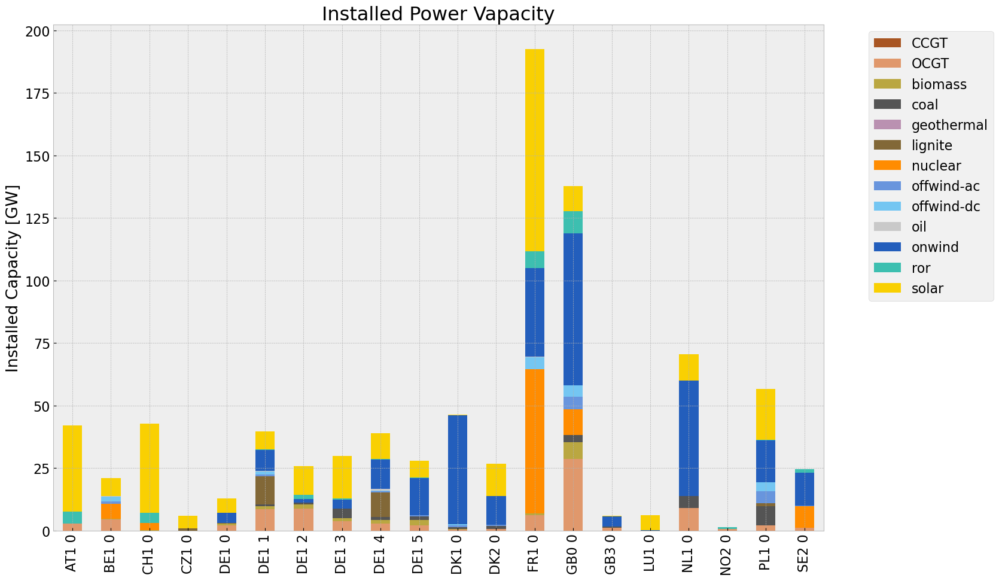

<Figure size 640x480 with 0 Axes>

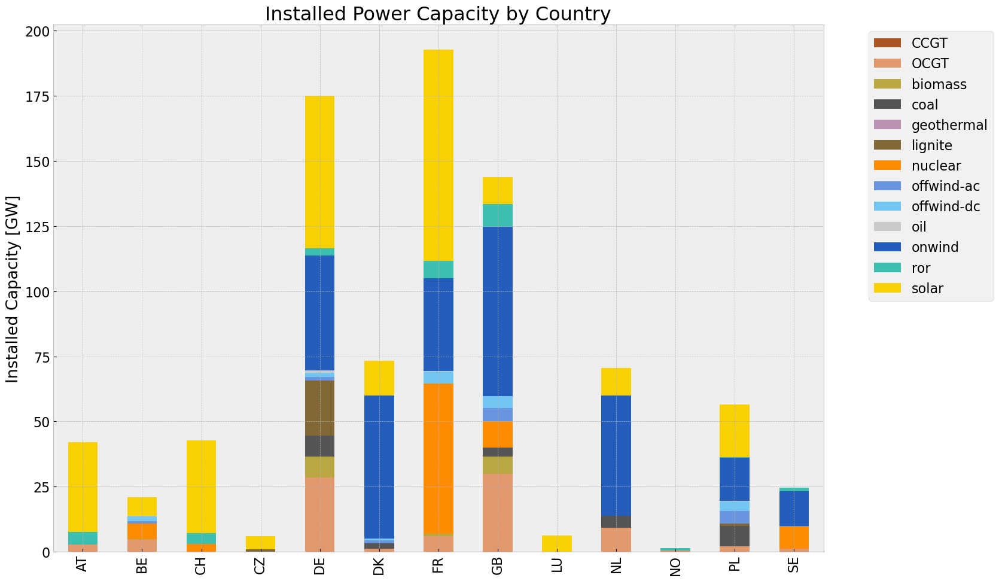

<Figure size 640x480 with 0 Axes>

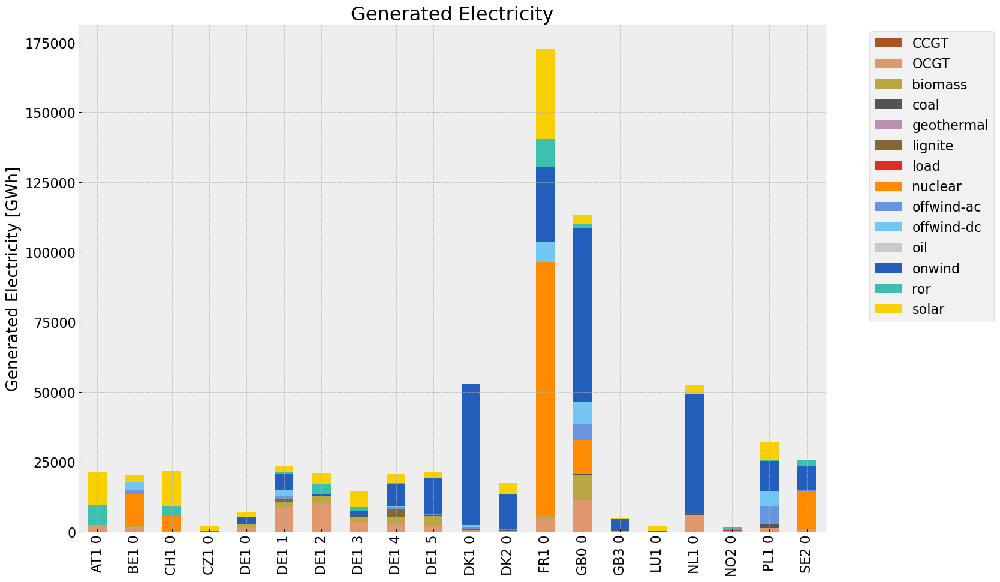

<Figure size 640x480 with 0 Axes>

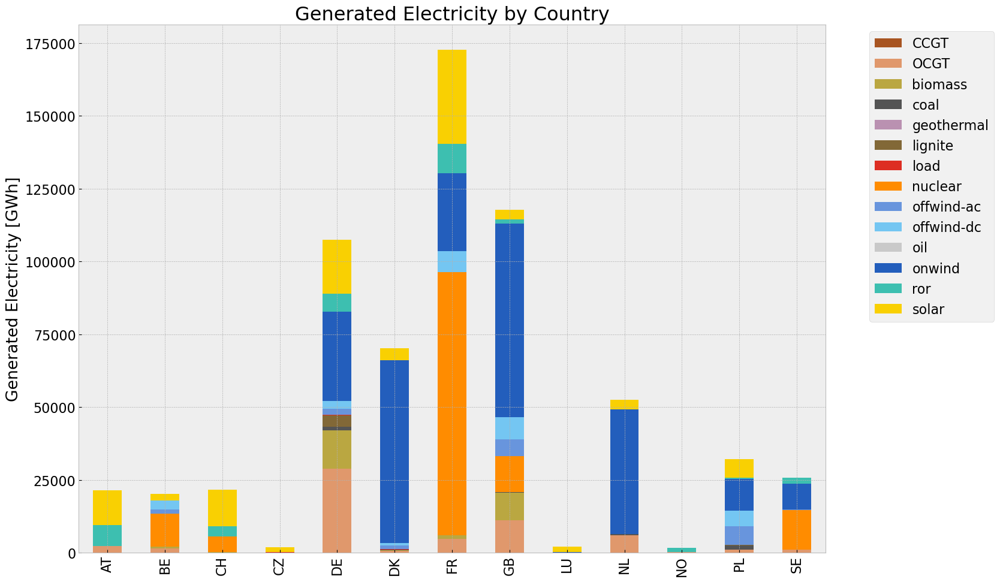

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jere

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,5.761332e+07,0.451621,0.1980,2.525888e+07
biomass,2.436073e+07,0.468000,0.0000,0.000000e+00
coal,3.720152e+06,0.329908,0.3361,3.789974e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,4.069951e+06,0.337285,0.4069,4.909985e+06
load,1.119253e+06,1.000000,0.0000,0.000000e+00
nuclear,1.327600e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.762239e+07,1.000000,0.0000,0.000000e+00


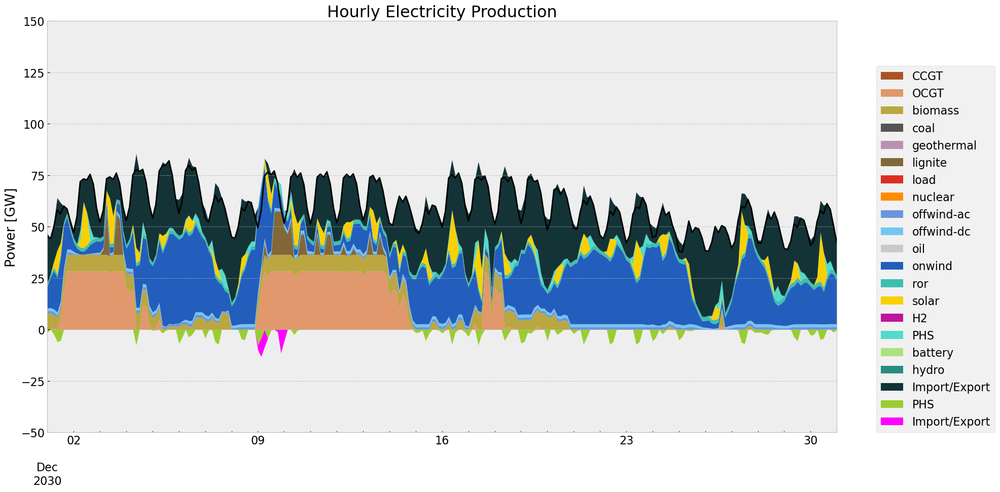

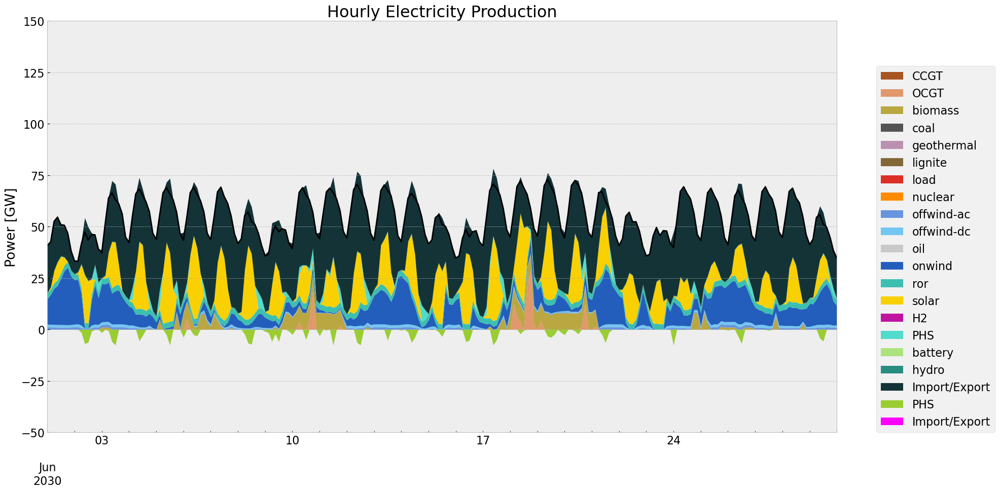

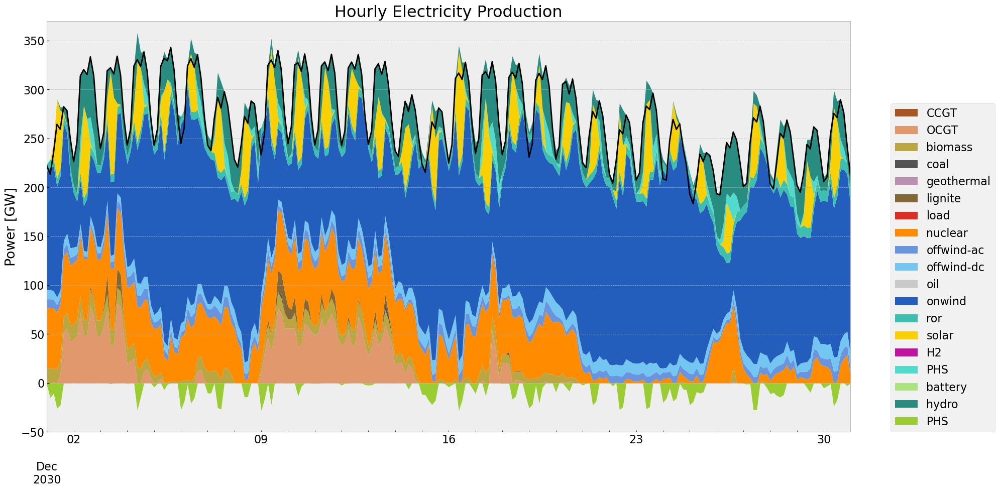

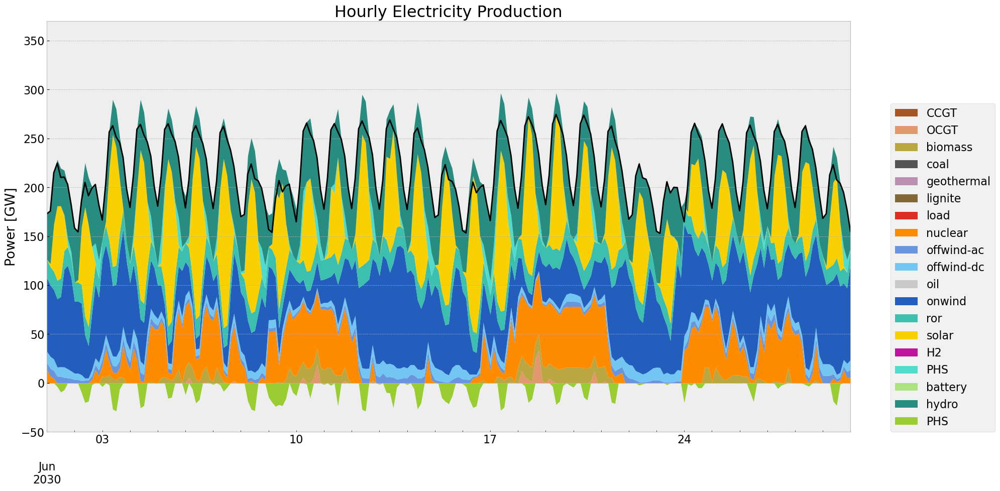

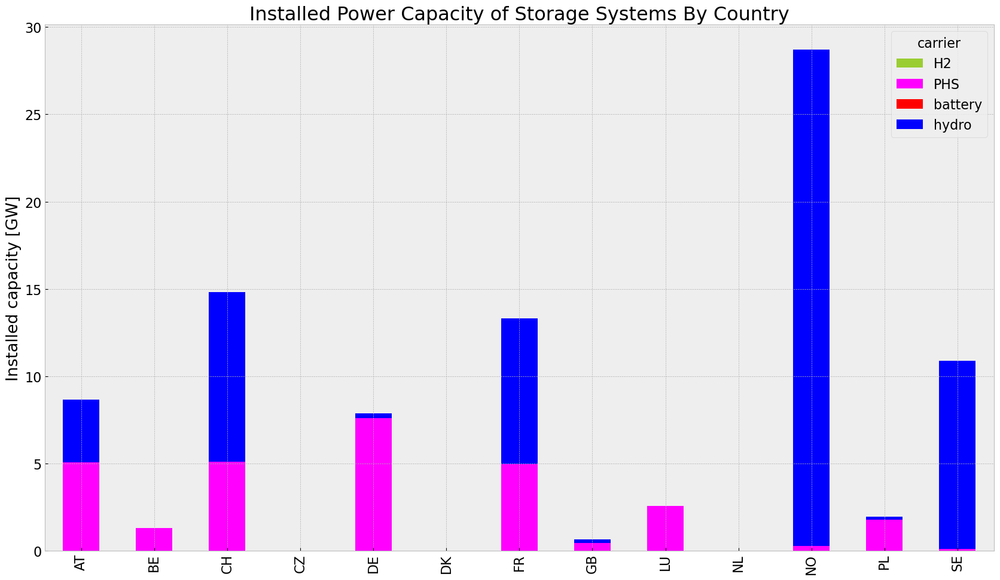

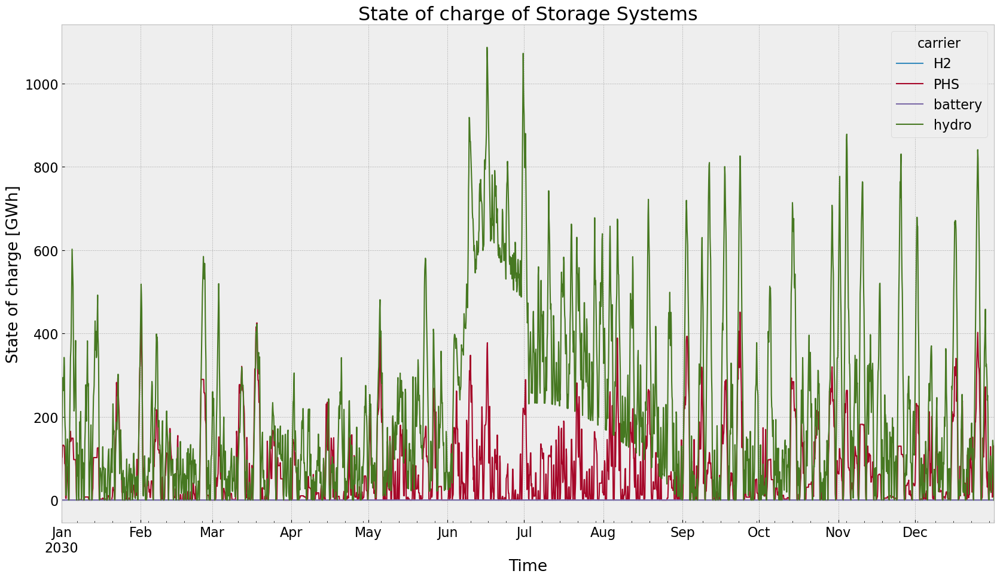

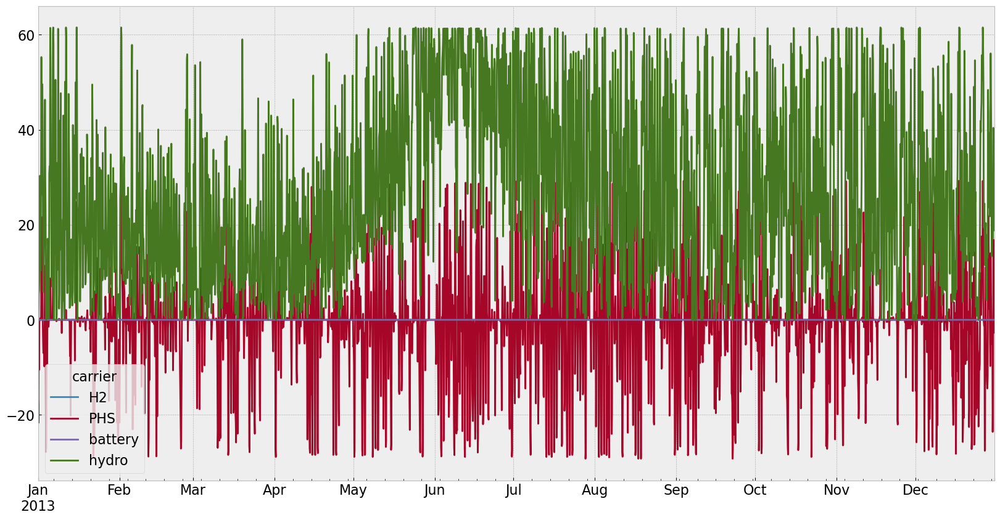

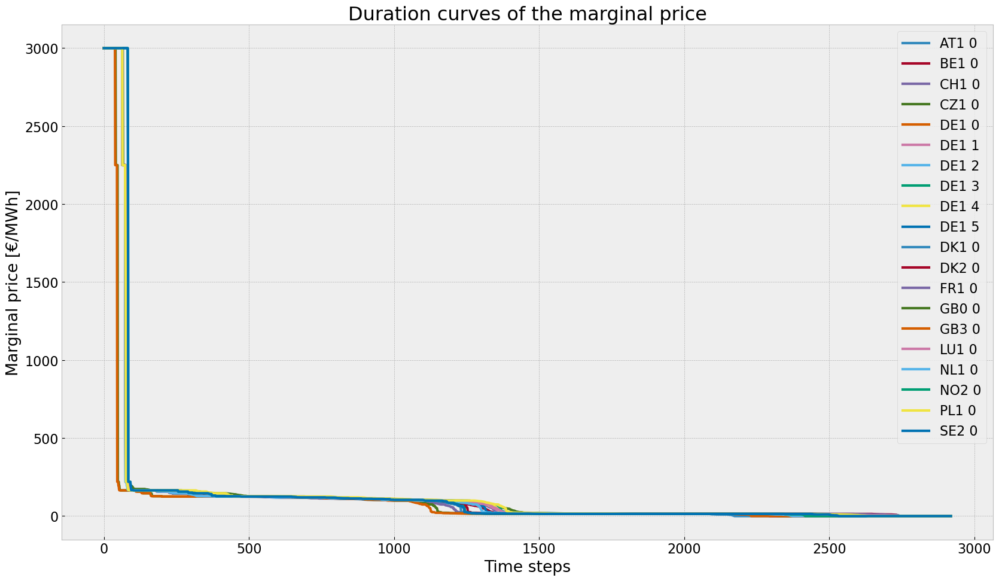

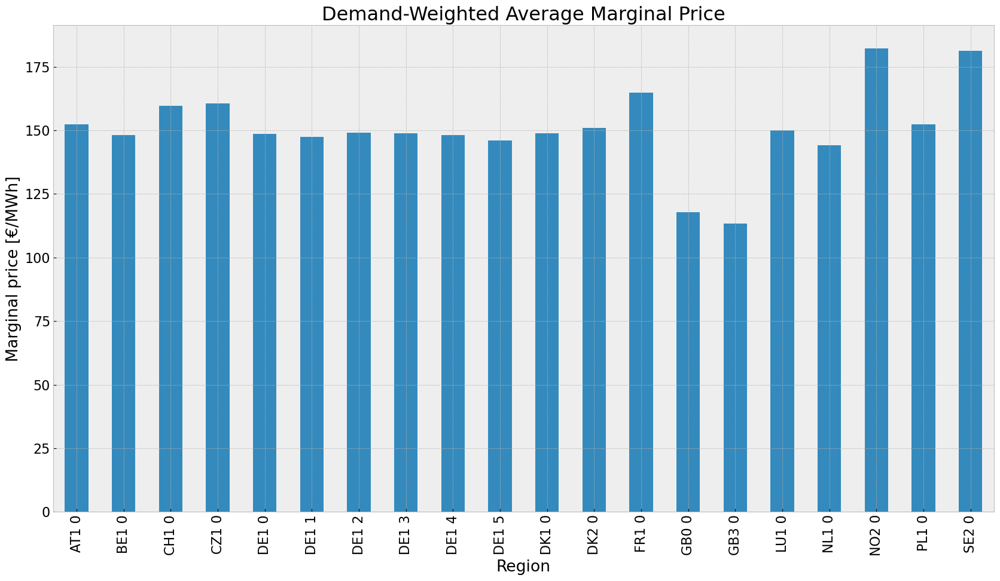

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


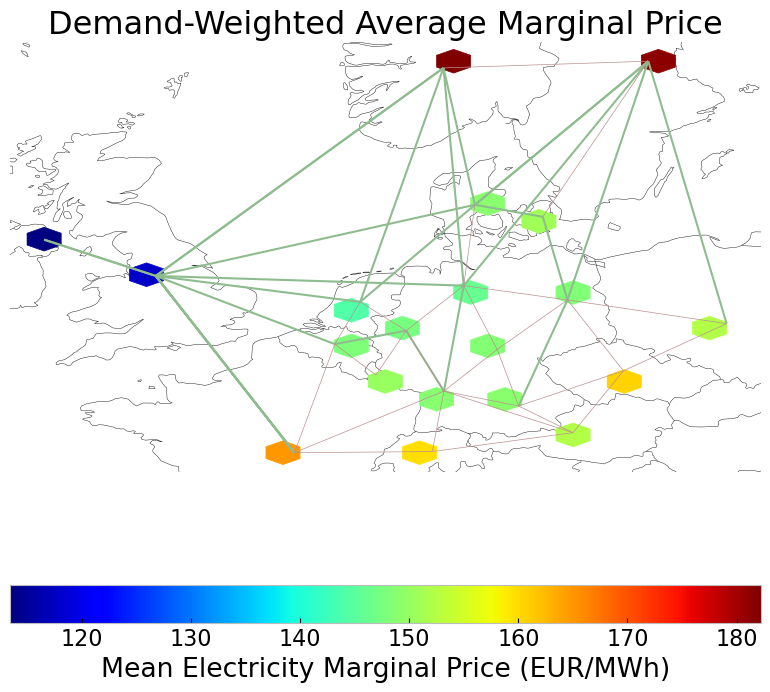

In [ ]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv_roll = inst_cap_table(n3, color_cap)
cap_noinv_roll_country = inst_cap_table_country(n3, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_noinv_roll  = gen_power_table(n3,colors_gen_table)
gen_noinv_roll_country = gen_power_table_country(n3,colors_gen_table)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n3, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n3, '2030-06-01', '2030-06-30', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n3, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n3, '2030-06-01', '2030-06-30', colors_gen)

#installed storage unit & stores
store_noinv_roll = inst_store_table(n3)

#State of Charge Storage unit
state_of_charge_plot(n3)
n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n3)

#avg electricity price
price_regions_table(n3)
price_regions(n3)

#Emission
em_noinv_roll =em_table(n3)
em_noinv_roll

## 4. Allowed Investment scenario solved with Rolling Horizon

In [ ]:
n4 = n1.copy()
n4.name = 'inv_roll_dispatchcut'
horizon = 24

no_inv(n4,n1)
#set extendable to false
#set the optimal capacity of generators from the base scenario as the new minimum capacity 
#for index, value in n4.generators.p_nom_extendable.items():
#    if value:  
#        n4.generators.at[index, 'p_nom'] = n1.generators.at[index, 'p_nom_opt']
#        #n2.generators.at[index, 'p_nom_max'] = n.generators.at[index, 'p_nom_opt']
#        n4.generators.at[index,'p_nom_extendable'] = False

#set the optimal capacity of storage units from the base scenario as the new minimum capacity 
#for index, value in n4.storage_units.p_nom_extendable.items():
#    if value:  
#        n4.storage_units.at[index, 'p_nom'] = n1.storage_units.at[index, 'p_nom_opt']
#        #n2.storage_units.at[index, 'p_nom_max'] = n.storage_units.at[index, 'p_nom_opt']
#        n4.storage_units.at[index,'p_nom_extendable'] = False

#set the optimal capacity of stores from the base scenario as the new minimum capacity 
#for index, value in n4.stores.e_nom_extendable.items():
#    if value:  
#        n4.stores.at[index, 'e_nom'] = n1.stores.at[index, 'e_nom_opt']
#        #n2.stores.at[index, 'e_nom_max'] = n.stores.at[index, 'e_nom_opt']
#        n4.stores.at[index, 'e_nom_extendable'] =False

#set the optimal capacity of lines from the base scenario as the new minimum capacity 
#for index, value in n2.lines.s_nom_extendable.items():
#    if value:  
#        n4.lines.at[index, 's_nom'] = n1.lines.at[index, 's_nom_opt']
#        #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
#        n4.lines.at[index, 's_nom_extendable'] =False

#set the optimal capacity of lines from the base scenario as the new minimum capacity 
#for index, value in n4.links.p_nom_extendable.items():
#    if value:  
#        n4.links.at[index, 's_nom'] = n1.links.at[index, 'p_nom_opt']
#        #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
#        n4.links.at[index, 'p_nom_extendable'] =False

n4.storage_units['cyclic_state_of_charge'] = False
n4.storage_units['cyclic_state_of_charge_per_period'] = False
optimize.optimize_with_rolling_horizon(n4, horizon=horizon, overlap=0, solver_name='gurobi')
#n4 = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\Dispatchcut\\20240512\\inv_roll_dispatchcut.nc")

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 21:00:00] (1/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6_rtrdfx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6_rtrdfx.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x38343f28


INFO:gurobipy:Model fingerprint: 0x38343f28


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25491 rows and 6846 columns


INFO:gurobipy:Presolve removed 25491 rows and 6846 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1341 rows, 5658 columns, 9368 nonzeros


INFO:gurobipy:Presolved: 1341 rows, 5658 columns, 9368 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.903e+03


INFO:gurobipy: AA' NZ     : 3.903e+03


 Factor NZ  : 3.639e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.639e+04 (roughly 3 MB of memory)


 Factor Ops : 1.751e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.751e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.25401787e+11 -1.94722054e+11  9.69e+04 3.64e-12  1.88e+08     0s


INFO:gurobipy:   0   2.25401787e+11 -1.94722054e+11  9.69e+04 3.64e-12  1.88e+08     0s


   1   1.84548525e+10 -9.66357334e+10  6.93e+03 2.91e-11  1.96e+07     0s


INFO:gurobipy:   1   1.84548525e+10 -9.66357334e+10  6.93e+03 2.91e-11  1.96e+07     0s


   2   2.46300922e+09 -2.38652840e+10  4.31e+02 1.09e-10  2.73e+06     0s


INFO:gurobipy:   2   2.46300922e+09 -2.38652840e+10  4.31e+02 1.09e-10  2.73e+06     0s


   3   5.68434276e+08 -2.58182816e+09  1.97e+01 2.02e-10  2.84e+05     0s


INFO:gurobipy:   3   5.68434276e+08 -2.58182816e+09  1.97e+01 2.02e-10  2.84e+05     0s


   4   1.97980447e+08 -1.02454387e+09  1.65e+00 7.55e-11  1.08e+05     0s


INFO:gurobipy:   4   1.97980447e+08 -1.02454387e+09  1.65e+00 7.55e-11  1.08e+05     0s


   5   1.29751340e+08 -4.57547938e+08  8.30e-01 3.18e-11  5.19e+04     0s


INFO:gurobipy:   5   1.29751340e+08 -4.57547938e+08  8.30e-01 3.18e-11  5.19e+04     0s


   6   9.40272325e+07 -1.59449634e+08  4.36e-01 2.91e-11  2.24e+04     0s


INFO:gurobipy:   6   9.40272325e+07 -1.59449634e+08  4.36e-01 2.91e-11  2.24e+04     0s


   7   5.03420375e+07 -3.67687407e+07  3.84e-02 1.46e-11  7.69e+03     0s


INFO:gurobipy:   7   5.03420375e+07 -3.67687407e+07  3.84e-02 1.46e-11  7.69e+03     0s


   8   4.21808543e+07  6.08932726e+06  1.65e-02 2.91e-11  3.19e+03     0s


INFO:gurobipy:   8   4.21808543e+07  6.08932726e+06  1.65e-02 2.91e-11  3.19e+03     0s


   9   3.55690456e+07  2.09703429e+07  4.46e-03 2.91e-11  1.29e+03     0s


INFO:gurobipy:   9   3.55690456e+07  2.09703429e+07  4.46e-03 2.91e-11  1.29e+03     0s


  10   3.33650960e+07  2.79080629e+07  1.19e-03 2.91e-11  4.82e+02     0s


INFO:gurobipy:  10   3.33650960e+07  2.79080629e+07  1.19e-03 2.91e-11  4.82e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1984    3.2133955e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1984    3.2133955e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1984 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1984 iterations and 0.18 seconds (0.05 work units)


Optimal objective  3.213395495e+07


INFO:gurobipy:Optimal objective  3.213395495e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.21e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 21:00:00] (2/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
  

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t6onx2qv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t6onx2qv.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc9991f21


INFO:gurobipy:Model fingerprint: 0xc9991f21


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25503 rows and 6808 columns


INFO:gurobipy:Presolve removed 25503 rows and 6808 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1329 rows, 5696 columns, 9400 nonzeros


INFO:gurobipy:Presolved: 1329 rows, 5696 columns, 9400 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.896e+03


INFO:gurobipy: AA' NZ     : 3.896e+03


 Factor NZ  : 3.570e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.570e+04 (roughly 3 MB of memory)


 Factor Ops : 1.659e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.659e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.22980840e+11 -1.92160993e+11  1.03e+05 3.64e-12  1.79e+08     0s


INFO:gurobipy:   0   2.22980840e+11 -1.92160993e+11  1.03e+05 3.64e-12  1.79e+08     0s


   1   2.23767821e+10 -9.84228366e+10  8.93e+03 2.91e-11  2.15e+07     0s


INFO:gurobipy:   1   2.23767821e+10 -9.84228366e+10  8.93e+03 2.91e-11  2.15e+07     0s


   2   4.01046854e+09 -2.42542051e+10  8.75e+02 6.98e-10  3.24e+06     0s


INFO:gurobipy:   2   4.01046854e+09 -2.42542051e+10  8.75e+02 6.98e-10  3.24e+06     0s


   3   9.89545261e+08 -3.34866566e+09  6.81e+01 5.58e-10  4.08e+05     0s


INFO:gurobipy:   3   9.89545261e+08 -3.34866566e+09  6.81e+01 5.58e-10  4.08e+05     0s


   4   5.15275606e+08 -6.48950249e+08  7.77e+00 1.31e-10  1.03e+05     0s


INFO:gurobipy:   4   5.15275606e+08 -6.48950249e+08  7.77e+00 1.31e-10  1.03e+05     0s


   5   4.40143649e+08 -2.22797512e+08  4.82e+00 6.47e-11  5.86e+04     0s


INFO:gurobipy:   5   4.40143649e+08 -2.22797512e+08  4.82e+00 6.47e-11  5.86e+04     0s


   6   3.41115905e+08  8.78474076e+06  1.72e+00 2.96e-11  2.92e+04     0s


INFO:gurobipy:   6   3.41115905e+08  8.78474076e+06  1.72e+00 2.96e-11  2.92e+04     0s


   7   2.70699340e+08  1.65653885e+08  3.97e-01 2.91e-11  9.22e+03     0s


INFO:gurobipy:   7   2.70699340e+08  1.65653885e+08  3.97e-01 2.91e-11  9.22e+03     0s


   8   2.59408006e+08  1.99453455e+08  2.52e-01 2.91e-11  5.26e+03     0s


INFO:gurobipy:   8   2.59408006e+08  1.99453455e+08  2.52e-01 2.91e-11  5.26e+03     0s


   9   2.43306221e+08  2.20370959e+08  6.22e-02 1.46e-11  2.01e+03     0s


INFO:gurobipy:   9   2.43306221e+08  2.20370959e+08  6.22e-02 1.46e-11  2.01e+03     0s


  10   2.39340193e+08  2.27785970e+08  2.41e-02 1.46e-11  1.01e+03     0s


INFO:gurobipy:  10   2.39340193e+08  2.27785970e+08  2.41e-02 1.46e-11  1.01e+03     0s


  11   2.38114865e+08  2.33578417e+08  1.34e-02 2.91e-11  3.98e+02     0s


INFO:gurobipy:  11   2.38114865e+08  2.33578417e+08  1.34e-02 2.91e-11  3.98e+02     0s


  12   2.37293088e+08  2.34795617e+08  6.56e-03 1.46e-11  2.19e+02     0s


INFO:gurobipy:  12   2.37293088e+08  2.34795617e+08  6.56e-03 1.46e-11  2.19e+02     0s


  13   2.36725382e+08  2.35611973e+08  2.19e-03 2.91e-11  9.76e+01     0s


INFO:gurobipy:  13   2.36725382e+08  2.35611973e+08  2.19e-03 2.91e-11  9.76e+01     0s


  14   2.36524889e+08  2.36027877e+08  6.48e-04 2.91e-11  4.36e+01     0s


INFO:gurobipy:  14   2.36524889e+08  2.36027877e+08  6.48e-04 2.91e-11  4.36e+01     0s


  15   2.36431827e+08  2.36344347e+08  2.46e-05 2.91e-11  7.67e+00     0s


INFO:gurobipy:  15   2.36431827e+08  2.36344347e+08  2.46e-05 2.91e-11  7.67e+00     0s


  16   2.36417966e+08  2.36399087e+08  1.77e-06 2.91e-11  1.66e+00     0s


INFO:gurobipy:  16   2.36417966e+08  2.36399087e+08  1.77e-06 2.91e-11  1.66e+00     0s


  17   2.36416842e+08  2.36412193e+08  5.00e-07 2.91e-11  4.08e-01     0s


INFO:gurobipy:  17   2.36416842e+08  2.36412193e+08  5.00e-07 2.91e-11  4.08e-01     0s


  18   2.36416459e+08  2.36415179e+08  2.10e-07 2.91e-11  1.12e-01     0s


INFO:gurobipy:  18   2.36416459e+08  2.36415179e+08  2.10e-07 2.91e-11  1.12e-01     0s


  19   2.36416277e+08  2.36415569e+08  8.80e-08 1.46e-11  6.20e-02     0s


INFO:gurobipy:  19   2.36416277e+08  2.36415569e+08  8.80e-08 1.46e-11  6.20e-02     0s


  20   2.36416198e+08  2.36415921e+08  5.89e-08 1.46e-11  2.42e-02     0s


INFO:gurobipy:  20   2.36416198e+08  2.36415921e+08  5.89e-08 1.46e-11  2.42e-02     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.23 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.23 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1812    2.3641613e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1812    2.3641613e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1812 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 1812 iterations and 0.26 seconds (0.06 work units)


Optimal objective  2.364161322e+08


INFO:gurobipy:Optimal objective  2.364161322e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.36e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 21:00:00] (3/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
  

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-01a026hi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-01a026hi.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x414145a3


INFO:gurobipy:Model fingerprint: 0x414145a3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25509 rows and 6859 columns


INFO:gurobipy:Presolve removed 25509 rows and 6859 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1323 rows, 5645 columns, 9343 nonzeros


INFO:gurobipy:Presolved: 1323 rows, 5645 columns, 9343 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.890e+03


INFO:gurobipy: AA' NZ     : 3.890e+03


 Factor NZ  : 3.759e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.759e+04 (roughly 3 MB of memory)


 Factor Ops : 1.948e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.948e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.60645510e+11 -5.14671044e+11  1.11e+05 9.42e+03  5.01e+08     0s


INFO:gurobipy:   0   2.60645510e+11 -5.14671044e+11  1.11e+05 9.42e+03  5.01e+08     0s


   1   3.81887805e+10 -2.62777862e+11  7.79e+03 7.28e-11  5.30e+07     0s


INFO:gurobipy:   1   3.81887805e+10 -2.62777862e+11  7.79e+03 7.28e-11  5.30e+07     0s


   2   1.01188528e+10 -5.32839216e+10  4.60e+02 1.46e-10  6.66e+06     0s


INFO:gurobipy:   2   1.01188528e+10 -5.32839216e+10  4.60e+02 1.46e-10  6.66e+06     0s


   3   3.21561770e+09 -1.08799087e+10  7.28e+01 2.33e-10  1.33e+06     0s


INFO:gurobipy:   3   3.21561770e+09 -1.08799087e+10  7.28e+01 2.33e-10  1.33e+06     0s


   4   1.92379629e+09 -3.04002171e+09  2.66e+01 1.67e-10  4.55e+05     0s


INFO:gurobipy:   4   1.92379629e+09 -3.04002171e+09  2.66e+01 1.67e-10  4.55e+05     0s


   5   1.36362991e+09 -4.07174334e+08  9.12e+00 5.82e-11  1.59e+05     0s


INFO:gurobipy:   5   1.36362991e+09 -4.07174334e+08  9.12e+00 5.82e-11  1.59e+05     0s


   6   1.13191100e+09  4.35454861e+08  2.43e+00 4.37e-11  6.19e+04     0s


INFO:gurobipy:   6   1.13191100e+09  4.35454861e+08  2.43e+00 4.37e-11  6.19e+04     0s


   7   1.05406239e+09  7.62442951e+08  5.65e-01 2.91e-11  2.58e+04     0s


INFO:gurobipy:   7   1.05406239e+09  7.62442951e+08  5.65e-01 2.91e-11  2.58e+04     0s


   8   1.04282582e+09  8.51452108e+08  4.53e-01 2.91e-11  1.69e+04     0s


INFO:gurobipy:   8   1.04282582e+09  8.51452108e+08  4.53e-01 2.91e-11  1.69e+04     0s


   9   1.02927750e+09  8.86864813e+08  3.36e-01 2.91e-11  1.26e+04     0s


INFO:gurobipy:   9   1.02927750e+09  8.86864813e+08  3.36e-01 2.91e-11  1.26e+04     0s


  10   1.01957656e+09  9.31979005e+08  2.63e-01 2.91e-11  7.75e+03     0s


INFO:gurobipy:  10   1.01957656e+09  9.31979005e+08  2.63e-01 2.91e-11  7.75e+03     0s


  11   1.00933161e+09  9.44182061e+08  1.97e-01 1.46e-11  5.77e+03     0s


INFO:gurobipy:  11   1.00933161e+09  9.44182061e+08  1.97e-01 1.46e-11  5.77e+03     0s


  12   1.00105140e+09  9.48398148e+08  1.47e-01 1.46e-11  4.66e+03     0s


INFO:gurobipy:  12   1.00105140e+09  9.48398148e+08  1.47e-01 1.46e-11  4.66e+03     0s


  13   9.95237375e+08  9.51752929e+08  1.14e-01 1.46e-11  3.85e+03     0s


INFO:gurobipy:  13   9.95237375e+08  9.51752929e+08  1.14e-01 1.46e-11  3.85e+03     0s


  14   9.90487757e+08  9.54123831e+08  8.70e-02 2.91e-11  3.22e+03     0s


INFO:gurobipy:  14   9.90487757e+08  9.54123831e+08  8.70e-02 2.91e-11  3.22e+03     0s


  15   9.81550635e+08  9.62362218e+08  3.62e-02 1.46e-11  1.70e+03     0s


INFO:gurobipy:  15   9.81550635e+08  9.62362218e+08  3.62e-02 1.46e-11  1.70e+03     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1906    9.7394939e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1906    9.7394939e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1906 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1906 iterations and 0.22 seconds (0.06 work units)


Optimal objective  9.739493946e+08


INFO:gurobipy:Optimal objective  9.739493946e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.74e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 21:00:00] (4/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
  

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2of7aksl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2of7aksl.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x76bed7d0


INFO:gurobipy:Model fingerprint: 0x76bed7d0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25499 rows and 6789 columns


INFO:gurobipy:Presolve removed 25499 rows and 6789 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1333 rows, 5715 columns, 9423 nonzeros


INFO:gurobipy:Presolved: 1333 rows, 5715 columns, 9423 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.900e+03


INFO:gurobipy: AA' NZ     : 3.900e+03


 Factor NZ  : 3.665e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.665e+04 (roughly 3 MB of memory)


 Factor Ops : 1.718e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.718e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.70201643e+11 -5.13397042e+11  6.93e+04 9.67e+03  3.24e+08     0s


INFO:gurobipy:   0   1.70201643e+11 -5.13397042e+11  6.93e+04 9.67e+03  3.24e+08     0s


   1   2.66597498e+10 -2.25942743e+11  5.04e+03 7.28e-11  3.82e+07     0s


INFO:gurobipy:   1   2.66597498e+10 -2.25942743e+11  5.04e+03 7.28e-11  3.82e+07     0s


   2   7.66785180e+09 -4.58698620e+10  3.77e+02 1.83e-09  5.45e+06     0s


INFO:gurobipy:   2   7.66785180e+09 -4.58698620e+10  3.77e+02 1.83e-09  5.45e+06     0s


   3   2.67357456e+09 -1.33938715e+10  9.87e+01 1.35e-09  1.52e+06     0s


INFO:gurobipy:   3   2.67357456e+09 -1.33938715e+10  9.87e+01 1.35e-09  1.52e+06     0s


   4   1.47109497e+09 -1.30176850e+09  2.67e+01 4.51e-10  2.53e+05     0s


INFO:gurobipy:   4   1.47109497e+09 -1.30176850e+09  2.67e+01 4.51e-10  2.53e+05     0s


   5   1.20642617e+09 -1.22525809e+07  1.21e+01 1.78e-10  1.09e+05     0s


INFO:gurobipy:   5   1.20642617e+09 -1.22525809e+07  1.21e+01 1.78e-10  1.09e+05     0s


   6   1.08617664e+09  4.48185026e+08  6.83e+00 7.09e-11  5.66e+04     0s


INFO:gurobipy:   6   1.08617664e+09  4.48185026e+08  6.83e+00 7.09e-11  5.66e+04     0s


   7   9.39981170e+08  6.73743230e+08  1.87e+00 2.91e-11  2.34e+04     0s


INFO:gurobipy:   7   9.39981170e+08  6.73743230e+08  1.87e+00 2.91e-11  2.34e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1691    8.3167864e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1691    8.3167864e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1691 iterations and 0.16 seconds (0.06 work units)


INFO:gurobipy:Solved in 1691 iterations and 0.16 seconds (0.06 work units)


Optimal objective  8.316786380e+08


INFO:gurobipy:Optimal objective  8.316786380e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 21:00:00] (5/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
  

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cj5eiu7b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cj5eiu7b.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x81ffb899


INFO:gurobipy:Model fingerprint: 0x81ffb899


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25506 rows and 6833 columns


INFO:gurobipy:Presolve removed 25506 rows and 6833 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1326 rows, 5671 columns, 9372 nonzeros


INFO:gurobipy:Presolved: 1326 rows, 5671 columns, 9372 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.893e+03


INFO:gurobipy: AA' NZ     : 3.893e+03


 Factor NZ  : 3.551e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.551e+04 (roughly 3 MB of memory)


 Factor Ops : 1.614e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.614e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.54919566e+11 -5.13980340e+11  1.07e+05 9.82e+03  4.88e+08     0s


INFO:gurobipy:   0   2.54919566e+11 -5.13980340e+11  1.07e+05 9.82e+03  4.88e+08     0s


   1   3.71869688e+10 -2.67431869e+11  6.80e+03 7.28e-11  5.01e+07     0s


INFO:gurobipy:   1   3.71869688e+10 -2.67431869e+11  6.80e+03 7.28e-11  5.01e+07     0s


   2   1.06442384e+10 -5.40408495e+10  4.44e+02 1.16e-10  6.71e+06     0s


INFO:gurobipy:   2   1.06442384e+10 -5.40408495e+10  4.44e+02 1.16e-10  6.71e+06     0s


   3   3.74868434e+09 -9.08037750e+09  9.53e+01 2.47e-10  1.24e+06     0s


INFO:gurobipy:   3   3.74868434e+09 -9.08037750e+09  9.53e+01 2.47e-10  1.24e+06     0s


   4   1.86857856e+09 -1.90432950e+09  3.20e+01 1.60e-10  3.53e+05     0s


INFO:gurobipy:   4   1.86857856e+09 -1.90432950e+09  3.20e+01 1.60e-10  3.53e+05     0s


   5   1.43596631e+09  1.35890412e+08  9.75e+00 8.73e-11  1.17e+05     0s


INFO:gurobipy:   5   1.43596631e+09  1.35890412e+08  9.75e+00 8.73e-11  1.17e+05     0s


   6   1.27446020e+09  7.35482129e+08  2.97e+00 5.82e-11  4.79e+04     0s


INFO:gurobipy:   6   1.27446020e+09  7.35482129e+08  2.97e+00 5.82e-11  4.79e+04     0s


   7   1.24101152e+09  9.56479431e+08  1.81e+00 4.37e-11  2.52e+04     0s


INFO:gurobipy:   7   1.24101152e+09  9.56479431e+08  1.81e+00 4.37e-11  2.52e+04     0s


   8   1.21443598e+09  1.04616050e+09  1.16e+00 2.91e-11  1.49e+04     0s


INFO:gurobipy:   8   1.21443598e+09  1.04616050e+09  1.16e+00 2.91e-11  1.49e+04     0s


   9   1.19440812e+09  1.08707020e+09  7.70e-01 1.46e-11  9.47e+03     0s


INFO:gurobipy:   9   1.19440812e+09  1.08707020e+09  7.70e-01 1.46e-11  9.47e+03     0s


  10   1.18033892e+09  1.11597139e+09  5.41e-01 2.91e-11  5.68e+03     0s


INFO:gurobipy:  10   1.18033892e+09  1.11597139e+09  5.41e-01 2.91e-11  5.68e+03     0s


  11   1.17366082e+09  1.12617486e+09  4.45e-01 2.91e-11  4.19e+03     0s


INFO:gurobipy:  11   1.17366082e+09  1.12617486e+09  4.45e-01 2.91e-11  4.19e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1753    1.1405043e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1753    1.1405043e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1753 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1753 iterations and 0.19 seconds (0.05 work units)


Optimal objective  1.140504301e+09


INFO:gurobipy:Optimal objective  1.140504301e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.14e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 21:00:00] (6/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
  

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tpokbvdu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tpokbvdu.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfa68192d


INFO:gurobipy:Model fingerprint: 0xfa68192d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25513 rows and 6904 columns


INFO:gurobipy:Presolve removed 25513 rows and 6904 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1319 rows, 5600 columns, 9294 nonzeros


INFO:gurobipy:Presolved: 1319 rows, 5600 columns, 9294 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.886e+03


INFO:gurobipy: AA' NZ     : 3.886e+03


 Factor NZ  : 3.806e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.806e+04 (roughly 3 MB of memory)


 Factor Ops : 2.067e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.067e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.57245993e+11 -5.17197115e+11  1.10e+05 1.53e+04  5.04e+08     0s


INFO:gurobipy:   0   2.57245993e+11 -5.17197115e+11  1.10e+05 1.53e+04  5.04e+08     0s


   1   4.19176665e+10 -2.65768632e+11  7.43e+03 7.28e-11  5.31e+07     0s


INFO:gurobipy:   1   4.19176665e+10 -2.65768632e+11  7.43e+03 7.28e-11  5.31e+07     0s


   2   1.40954825e+10 -4.69748608e+10  4.75e+02 2.04e-10  6.55e+06     0s


INFO:gurobipy:   2   1.40954825e+10 -4.69748608e+10  4.75e+02 2.04e-10  6.55e+06     0s


   3   7.46029145e+09 -6.55365342e+09  9.08e+01 8.00e-10  1.38e+06     0s


INFO:gurobipy:   3   7.46029145e+09 -6.55365342e+09  9.08e+01 8.00e-10  1.38e+06     0s


   4   5.52472245e+09  1.56955627e+09  3.28e+01 2.62e-10  3.83e+05     0s


INFO:gurobipy:   4   5.52472245e+09  1.56955627e+09  3.28e+01 2.62e-10  3.83e+05     0s


   5   4.85723048e+09  3.01265481e+09  1.50e+01 1.46e-10  1.76e+05     0s


INFO:gurobipy:   5   4.85723048e+09  3.01265481e+09  1.50e+01 1.46e-10  1.76e+05     0s


   6   4.64981699e+09  3.78712518e+09  8.52e+00 8.73e-11  8.25e+04     0s


INFO:gurobipy:   6   4.64981699e+09  3.78712518e+09  8.52e+00 8.73e-11  8.25e+04     0s


   7   4.45968466e+09  4.12441388e+09  2.63e+00 8.73e-11  3.14e+04     0s


INFO:gurobipy:   7   4.45968466e+09  4.12441388e+09  2.63e+00 8.73e-11  3.14e+04     0s


   8   4.39120172e+09  4.26989278e+09  9.43e-01 7.28e-11  1.13e+04     0s


INFO:gurobipy:   8   4.39120172e+09  4.26989278e+09  9.43e-01 7.28e-11  1.13e+04     0s


   9   4.37945016e+09  4.30159073e+09  7.08e-01 4.37e-11  7.32e+03     0s


INFO:gurobipy:   9   4.37945016e+09  4.30159073e+09  7.08e-01 4.37e-11  7.32e+03     0s


  10   4.36837631e+09  4.31491351e+09  5.04e-01 4.37e-11  5.03e+03     0s


INFO:gurobipy:  10   4.36837631e+09  4.31491351e+09  5.04e-01 4.37e-11  5.03e+03     0s


  11   4.36312855e+09  4.32579027e+09  4.09e-01 2.91e-11  3.54e+03     0s


INFO:gurobipy:  11   4.36312855e+09  4.32579027e+09  4.09e-01 2.91e-11  3.54e+03     0s


  12   4.34708837e+09  4.32934884e+09  1.22e-01 2.91e-11  1.64e+03     0s


INFO:gurobipy:  12   4.34708837e+09  4.32934884e+09  1.22e-01 2.91e-11  1.64e+03     0s


  13   4.34315443e+09  4.33568888e+09  5.08e-02 4.37e-11  6.92e+02     0s


INFO:gurobipy:  13   4.34315443e+09  4.33568888e+09  5.08e-02 4.37e-11  6.92e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2020    4.3401307e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2020    4.3401307e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2020 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 2020 iterations and 0.20 seconds (0.05 work units)


Optimal objective  4.340130669e+09


INFO:gurobipy:Optimal objective  4.340130669e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.34e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 21:00:00] (7/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
  

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jpw4l6n3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jpw4l6n3.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1e6156d2


INFO:gurobipy:Model fingerprint: 0x1e6156d2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25495 rows and 6853 columns


INFO:gurobipy:Presolve removed 25495 rows and 6853 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1337 rows, 5651 columns, 9363 nonzeros


INFO:gurobipy:Presolved: 1337 rows, 5651 columns, 9363 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.521e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.521e+04 (roughly 3 MB of memory)


 Factor Ops : 1.541e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.541e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.11982182e+11 -1.90309458e+11  9.71e+04 3.64e-12  1.70e+08     0s


INFO:gurobipy:   0   2.11982182e+11 -1.90309458e+11  9.71e+04 3.64e-12  1.70e+08     0s


   1   2.43334780e+10 -9.58777894e+10  9.54e+03 2.91e-11  2.21e+07     0s


INFO:gurobipy:   1   2.43334780e+10 -9.58777894e+10  9.54e+03 2.91e-11  2.21e+07     0s


   2   5.25282414e+09 -2.50416518e+10  1.16e+03 3.49e-10  3.71e+06     0s


INFO:gurobipy:   2   5.25282414e+09 -2.50416518e+10  1.16e+03 3.49e-10  3.71e+06     0s


   3   1.05735653e+09 -3.42490389e+09  6.33e+01 8.73e-11  4.22e+05     0s


INFO:gurobipy:   3   1.05735653e+09 -3.42490389e+09  6.33e+01 8.73e-11  4.22e+05     0s


   4   5.99971507e+08 -6.22768176e+08  5.51e+00 2.00e-11  1.09e+05     0s


INFO:gurobipy:   4   5.99971507e+08 -6.22768176e+08  5.51e+00 2.00e-11  1.09e+05     0s


   5   4.97498831e+08 -7.59593795e+07  2.73e+00 2.91e-11  5.09e+04     0s


INFO:gurobipy:   5   4.97498831e+08 -7.59593795e+07  2.73e+00 2.91e-11  5.09e+04     0s


   6   4.43775877e+08  4.62937012e+07  1.59e+00 1.46e-11  3.52e+04     0s


INFO:gurobipy:   6   4.43775877e+08  4.62937012e+07  1.59e+00 1.46e-11  3.52e+04     0s


   7   3.92393725e+08  1.94959057e+08  7.38e-01 1.46e-11  1.75e+04     0s


INFO:gurobipy:   7   3.92393725e+08  1.94959057e+08  7.38e-01 1.46e-11  1.75e+04     0s


   8   3.62159579e+08  2.70037957e+08  3.37e-01 1.46e-11  8.15e+03     0s


INFO:gurobipy:   8   3.62159579e+08  2.70037957e+08  3.37e-01 1.46e-11  8.15e+03     0s


   9   3.46452258e+08  3.06604330e+08  1.61e-01 2.91e-11  3.52e+03     0s


INFO:gurobipy:   9   3.46452258e+08  3.06604330e+08  1.61e-01 2.91e-11  3.52e+03     0s


  10   3.32896798e+08  3.21906009e+08  2.74e-02 2.91e-11  9.71e+02     0s


INFO:gurobipy:  10   3.32896798e+08  3.21906009e+08  2.74e-02 2.91e-11  9.71e+02     0s


  11   3.30418671e+08  3.26046315e+08  8.70e-03 2.91e-11  3.86e+02     0s


INFO:gurobipy:  11   3.30418671e+08  3.26046315e+08  8.70e-03 2.91e-11  3.86e+02     0s


  12   3.29778422e+08  3.27860553e+08  4.61e-03 1.46e-11  1.69e+02     0s


INFO:gurobipy:  12   3.29778422e+08  3.27860553e+08  4.61e-03 1.46e-11  1.69e+02     0s


  13   3.29349145e+08  3.28372699e+08  1.96e-03 1.46e-11  8.63e+01     0s


INFO:gurobipy:  13   3.29349145e+08  3.28372699e+08  1.96e-03 1.46e-11  8.63e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2152    3.2900922e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2152    3.2900922e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2152 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Solved in 2152 iterations and 0.27 seconds (0.06 work units)


Optimal objective  3.290092172e+08


INFO:gurobipy:Optimal objective  3.290092172e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 21:00:00] (8/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
  

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_pff68r4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_pff68r4.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1bd7115f


INFO:gurobipy:Model fingerprint: 0x1bd7115f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25504 rows and 6897 columns


INFO:gurobipy:Presolve removed 25504 rows and 6897 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1328 rows, 5607 columns, 9310 nonzeros


INFO:gurobipy:Presolved: 1328 rows, 5607 columns, 9310 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.895e+03


INFO:gurobipy: AA' NZ     : 3.895e+03


 Factor NZ  : 3.517e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.517e+04 (roughly 3 MB of memory)


 Factor Ops : 1.542e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.542e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.04785605e+11 -5.00844368e+11  8.31e+04 9.71e+03  3.81e+08     0s


INFO:gurobipy:   0   2.04785605e+11 -5.00844368e+11  8.31e+04 9.71e+03  3.81e+08     0s


   1   3.53752092e+10 -2.33835355e+11  5.93e+03 7.28e-11  4.34e+07     0s


INFO:gurobipy:   1   3.53752092e+10 -2.33835355e+11  5.93e+03 7.28e-11  4.34e+07     0s


   2   1.27643733e+10 -4.40086216e+10  4.09e+02 7.13e-10  5.96e+06     0s


INFO:gurobipy:   2   1.27643733e+10 -4.40086216e+10  4.09e+02 7.13e-10  5.96e+06     0s


   3   7.16357108e+09 -5.27265218e+09  9.21e+01 1.15e-09  1.23e+06     0s


INFO:gurobipy:   3   7.16357108e+09 -5.27265218e+09  9.21e+01 1.15e-09  1.23e+06     0s


   4   5.21741329e+09  2.02856682e+09  2.74e+01 3.06e-10  3.11e+05     0s


INFO:gurobipy:   4   5.21741329e+09  2.02856682e+09  2.74e+01 3.06e-10  3.11e+05     0s


   5   4.68476322e+09  3.36074117e+09  1.20e+01 2.04e-10  1.28e+05     0s


INFO:gurobipy:   5   4.68476322e+09  3.36074117e+09  1.20e+01 2.04e-10  1.28e+05     0s


   6   4.47509517e+09  3.78240819e+09  5.72e+00 2.04e-10  6.61e+04     0s


INFO:gurobipy:   6   4.47509517e+09  3.78240819e+09  5.72e+00 2.04e-10  6.61e+04     0s


   7   4.36468917e+09  4.07448484e+09  2.32e+00 1.31e-10  2.75e+04     0s


INFO:gurobipy:   7   4.36468917e+09  4.07448484e+09  2.32e+00 1.31e-10  2.75e+04     0s


   8   4.34239612e+09  4.18860315e+09  1.67e+00 5.82e-11  1.48e+04     0s


INFO:gurobipy:   8   4.34239612e+09  4.18860315e+09  1.67e+00 5.82e-11  1.48e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1760    4.2832421e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1760    4.2832421e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1760 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1760 iterations and 0.17 seconds (0.05 work units)


Optimal objective  4.283242056e+09


INFO:gurobipy:Optimal objective  4.283242056e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.28e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 21:00:00] (9/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
  

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7r913zyf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7r913zyf.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9daf38a2


INFO:gurobipy:Model fingerprint: 0x9daf38a2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25503 rows and 6948 columns


INFO:gurobipy:Presolve removed 25503 rows and 6948 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1329 rows, 5556 columns, 9260 nonzeros


INFO:gurobipy:Presolved: 1329 rows, 5556 columns, 9260 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.896e+03


INFO:gurobipy: AA' NZ     : 3.896e+03


 Factor NZ  : 3.640e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.640e+04 (roughly 3 MB of memory)


 Factor Ops : 1.722e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.722e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.09347756e+11 -1.85530442e+11  9.29e+04 3.64e-12  1.73e+08     0s


INFO:gurobipy:   0   2.09347756e+11 -1.85530442e+11  9.29e+04 3.64e-12  1.73e+08     0s


   1   2.89167611e+10 -8.91582602e+10  1.12e+04 2.91e-11  2.50e+07     0s


INFO:gurobipy:   1   2.89167611e+10 -8.91582602e+10  1.12e+04 2.91e-11  2.50e+07     0s


   2   6.89383158e+09 -2.55615986e+10  1.72e+03 5.24e-10  4.60e+06     0s


INFO:gurobipy:   2   6.89383158e+09 -2.55615986e+10  1.72e+03 5.24e-10  4.60e+06     0s


   3   3.41555205e+09 -9.67016324e+09  6.20e+02 4.58e-10  1.63e+06     0s


INFO:gurobipy:   3   3.41555205e+09 -9.67016324e+09  6.20e+02 4.58e-10  1.63e+06     0s


   4   2.35698385e+09 -3.19316689e+09  2.85e+02 1.53e-10  6.61e+05     0s


INFO:gurobipy:   4   2.35698385e+09 -3.19316689e+09  2.85e+02 1.53e-10  6.61e+05     0s


   5   1.97119403e+09 -6.60838662e+08  1.71e+02 2.04e-10  3.13e+05     0s


INFO:gurobipy:   5   1.97119403e+09 -6.60838662e+08  1.71e+02 2.04e-10  3.13e+05     0s


   6   1.62677205e+09  4.33949277e+08  7.62e+01 2.18e-10  1.36e+05     0s


INFO:gurobipy:   6   1.62677205e+09  4.33949277e+08  7.62e+01 2.18e-10  1.36e+05     0s


   7   1.40357139e+09  8.76437836e+08  1.17e+01 1.46e-10  5.11e+04     0s


INFO:gurobipy:   7   1.40357139e+09  8.76437836e+08  1.17e+01 1.46e-10  5.11e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2040    1.3003858e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2040    1.3003858e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2040 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 2040 iterations and 0.20 seconds (0.05 work units)


Optimal objective  1.300385831e+09


INFO:gurobipy:Optimal objective  1.300385831e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.30e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 21:00:00] (10/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z8926d95.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z8926d95.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x11e4d269


INFO:gurobipy:Model fingerprint: 0x11e4d269


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25506 rows and 7002 columns


INFO:gurobipy:Presolve removed 25506 rows and 7002 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1326 rows, 5502 columns, 9167 nonzeros


INFO:gurobipy:Presolved: 1326 rows, 5502 columns, 9167 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.863e+03


INFO:gurobipy: AA' NZ     : 3.863e+03


 Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


 Factor Ops : 1.580e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.580e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.36727610e+11 -1.86997130e+11  6.16e+04 9.02e-02  1.24e+08     0s


INFO:gurobipy:   0   1.36727610e+11 -1.86997130e+11  6.16e+04 9.02e-02  1.24e+08     0s


   1   1.50309521e+10 -8.48389747e+10  5.56e+03 2.91e-11  1.63e+07     0s


INFO:gurobipy:   1   1.50309521e+10 -8.48389747e+10  5.56e+03 2.91e-11  1.63e+07     0s


   2   2.80702443e+09 -2.05425500e+10  5.33e+02 7.28e-11  2.60e+06     0s


INFO:gurobipy:   2   2.80702443e+09 -2.05425500e+10  5.33e+02 7.28e-11  2.60e+06     0s


   3   6.14779026e+08 -3.12904800e+09  3.28e+01 9.46e-11  3.52e+05     0s


INFO:gurobipy:   3   6.14779026e+08 -3.12904800e+09  3.28e+01 9.46e-11  3.52e+05     0s


   4   2.46578526e+08 -1.11594810e+09  3.20e+00 3.27e-11  1.24e+05     0s


INFO:gurobipy:   4   2.46578526e+08 -1.11594810e+09  3.20e+00 3.27e-11  1.24e+05     0s


   5   1.65902580e+08 -5.94205008e+08  1.61e+00 1.82e-11  6.92e+04     0s


INFO:gurobipy:   5   1.65902580e+08 -5.94205008e+08  1.61e+00 1.82e-11  6.92e+04     0s


   6   1.08052318e+08 -2.93970093e+08  7.51e-01 1.46e-11  3.65e+04     0s


INFO:gurobipy:   6   1.08052318e+08 -2.93970093e+08  7.51e-01 1.46e-11  3.65e+04     0s


   7   6.39983356e+07 -8.96937092e+07  1.95e-01 2.91e-11  1.40e+04     0s


INFO:gurobipy:   7   6.39983356e+07 -8.96937092e+07  1.95e-01 2.91e-11  1.40e+04     0s


   8   5.20076572e+07 -4.83010035e+07  1.17e-01 1.46e-11  9.11e+03     0s


INFO:gurobipy:   8   5.20076572e+07 -4.83010035e+07  1.17e-01 1.46e-11  9.11e+03     0s


   9   4.10321113e+07 -4.74590421e+06  5.90e-02 1.46e-11  4.16e+03     0s


INFO:gurobipy:   9   4.10321113e+07 -4.74590421e+06  5.90e-02 1.46e-11  4.16e+03     0s


  10   3.30090221e+07  1.59687732e+07  1.95e-02 1.46e-11  1.55e+03     0s


INFO:gurobipy:  10   3.30090221e+07  1.59687732e+07  1.95e-02 1.46e-11  1.55e+03     0s


  11   3.06566187e+07  1.95353065e+07  1.04e-02 2.91e-11  1.01e+03     0s


INFO:gurobipy:  11   3.06566187e+07  1.95353065e+07  1.04e-02 2.91e-11  1.01e+03     0s


  12   2.99352761e+07  2.33934580e+07  7.88e-03 2.91e-11  5.94e+02     0s


INFO:gurobipy:  12   2.99352761e+07  2.33934580e+07  7.88e-03 2.91e-11  5.94e+02     0s


  13   2.91693234e+07  2.50487409e+07  5.40e-03 1.46e-11  3.74e+02     0s


INFO:gurobipy:  13   2.91693234e+07  2.50487409e+07  5.40e-03 1.46e-11  3.74e+02     0s


  14   2.83195345e+07  2.61225230e+07  2.70e-03 1.46e-11  1.99e+02     0s


INFO:gurobipy:  14   2.83195345e+07  2.61225230e+07  2.70e-03 1.46e-11  1.99e+02     0s


  15   2.77855792e+07  2.65913027e+07  1.01e-03 1.46e-11  1.08e+02     0s


INFO:gurobipy:  15   2.77855792e+07  2.65913027e+07  1.01e-03 1.46e-11  1.08e+02     0s


  16   2.75830924e+07  2.70838669e+07  3.90e-04 1.46e-11  4.53e+01     0s


INFO:gurobipy:  16   2.75830924e+07  2.70838669e+07  3.90e-04 1.46e-11  4.53e+01     0s


  17   2.74812147e+07  2.72854723e+07  1.13e-04 2.91e-11  1.78e+01     0s


INFO:gurobipy:  17   2.74812147e+07  2.72854723e+07  1.13e-04 2.91e-11  1.78e+01     0s


  18   2.74582956e+07  2.73454369e+07  5.83e-05 1.46e-11  1.02e+01     0s


INFO:gurobipy:  18   2.74582956e+07  2.73454369e+07  5.83e-05 1.46e-11  1.02e+01     0s


  19   2.74436840e+07  2.73869139e+07  2.67e-05 1.46e-11  5.15e+00     0s


INFO:gurobipy:  19   2.74436840e+07  2.73869139e+07  2.67e-05 1.46e-11  5.15e+00     0s


  20   2.74368479e+07  2.74136839e+07  1.29e-05 2.91e-11  2.10e+00     0s


INFO:gurobipy:  20   2.74368479e+07  2.74136839e+07  1.29e-05 2.91e-11  2.10e+00     0s


  21   2.74321073e+07  2.74231578e+07  3.68e-06 1.46e-11  8.12e-01     0s


INFO:gurobipy:  21   2.74321073e+07  2.74231578e+07  3.68e-06 1.46e-11  8.12e-01     0s


  22   2.74301555e+07  2.74274648e+07  4.91e-07 2.91e-11  2.44e-01     0s


INFO:gurobipy:  22   2.74301555e+07  2.74274648e+07  4.91e-07 2.91e-11  2.44e-01     0s


  23   2.74298361e+07  2.74289635e+07  9.75e-08 1.46e-11  7.92e-02     0s


INFO:gurobipy:  23   2.74298361e+07  2.74289635e+07  9.75e-08 1.46e-11  7.92e-02     0s


  24   2.74297771e+07  2.74294193e+07  2.98e-08 2.91e-11  3.25e-02     0s


INFO:gurobipy:  24   2.74297771e+07  2.74294193e+07  2.98e-08 2.91e-11  3.25e-02     0s


INFO:gurobipy:


Barrier performed 24 iterations in 0.25 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 24 iterations in 0.25 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2211    2.7429734e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2211    2.7429734e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2211 iterations and 0.27 seconds (0.07 work units)


INFO:gurobipy:Solved in 2211 iterations and 0.27 seconds (0.07 work units)


Optimal objective  2.742973406e+07


INFO:gurobipy:Optimal objective  2.742973406e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.74e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 21:00:00] (11/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5xafup3v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5xafup3v.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x989f0036


INFO:gurobipy:Model fingerprint: 0x989f0036


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25524 rows and 6900 columns


INFO:gurobipy:Presolve removed 25524 rows and 6900 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1308 rows, 5604 columns, 9269 nonzeros


INFO:gurobipy:Presolved: 1308 rows, 5604 columns, 9269 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.857e+03


INFO:gurobipy: AA' NZ     : 3.857e+03


 Factor NZ  : 3.559e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.559e+04 (roughly 3 MB of memory)


 Factor Ops : 1.693e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.693e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.88625343e+11 -5.29237914e+11  9.13e+04 1.14e+04  4.28e+08     0s


INFO:gurobipy:   0   1.88625343e+11 -5.29237914e+11  9.13e+04 1.14e+04  4.28e+08     0s


   1   2.89938334e+10 -2.74227862e+11  6.77e+03 5.82e-11  5.03e+07     0s


INFO:gurobipy:   1   2.89938334e+10 -2.74227862e+11  6.77e+03 5.82e-11  5.03e+07     0s


   2   6.03117714e+09 -5.27951617e+10  4.05e+02 1.02e-10  6.13e+06     0s


INFO:gurobipy:   2   6.03117714e+09 -5.27951617e+10  4.05e+02 1.02e-10  6.13e+06     0s


   3   1.51203667e+09 -1.33759365e+10  7.09e+01 2.33e-10  1.40e+06     0s


INFO:gurobipy:   3   1.51203667e+09 -1.33759365e+10  7.09e+01 2.33e-10  1.40e+06     0s


   4   7.51717378e+08 -1.87356621e+09  1.01e+01 1.75e-10  2.38e+05     0s


INFO:gurobipy:   4   7.51717378e+08 -1.87356621e+09  1.01e+01 1.75e-10  2.38e+05     0s


   5   5.02797203e+08 -7.93837650e+08  4.33e+00 9.46e-11  1.16e+05     0s


INFO:gurobipy:   5   5.02797203e+08 -7.93837650e+08  4.33e+00 9.46e-11  1.16e+05     0s


   6   3.76905318e+08 -3.43139575e+08  2.38e+00 5.09e-11  6.44e+04     0s


INFO:gurobipy:   6   3.76905318e+08 -3.43139575e+08  2.38e+00 5.09e-11  6.44e+04     0s


   7   2.59234943e+08 -1.51074366e+08  9.85e-01 2.91e-11  3.66e+04     0s


INFO:gurobipy:   7   2.59234943e+08 -1.51074366e+08  9.85e-01 2.91e-11  3.66e+04     0s


   8   2.25736984e+08 -3.63184024e+07  6.88e-01 1.82e-11  2.34e+04     0s


INFO:gurobipy:   8   2.25736984e+08 -3.63184024e+07  6.88e-01 1.82e-11  2.34e+04     0s


   9   1.75903437e+08  4.62361616e+07  2.79e-01 7.28e-12  1.16e+04     0s


INFO:gurobipy:   9   1.75903437e+08  4.62361616e+07  2.79e-01 7.28e-12  1.16e+04     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1812    1.3280650e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1812    1.3280650e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1812 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1812 iterations and 0.24 seconds (0.06 work units)


Optimal objective  1.328064980e+08


INFO:gurobipy:Optimal objective  1.328064980e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 21:00:00] (12/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sv3ish3e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sv3ish3e.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1c7639db


INFO:gurobipy:Model fingerprint: 0x1c7639db


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25555 rows and 7047 columns


INFO:gurobipy:Presolve removed 25555 rows and 7047 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1277 rows, 5457 columns, 9033 nonzeros


INFO:gurobipy:Presolved: 1277 rows, 5457 columns, 9033 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.773e+03


INFO:gurobipy: AA' NZ     : 3.773e+03


 Factor NZ  : 3.500e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.500e+04 (roughly 3 MB of memory)


 Factor Ops : 1.688e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.688e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.78840439e+11 -1.86329637e+11  8.96e+04 3.64e-12  1.57e+08     0s


INFO:gurobipy:   0   1.78840439e+11 -1.86329637e+11  8.96e+04 3.64e-12  1.57e+08     0s


   1   1.39406696e+10 -8.56373939e+10  5.63e+03 2.91e-11  1.57e+07     0s


INFO:gurobipy:   1   1.39406696e+10 -8.56373939e+10  5.63e+03 2.91e-11  1.57e+07     0s


   2   2.71816228e+09 -1.84539335e+10  6.34e+02 1.46e-10  2.43e+06     0s


INFO:gurobipy:   2   2.71816228e+09 -1.84539335e+10  6.34e+02 1.46e-10  2.43e+06     0s


   3   5.70039521e+08 -2.56015074e+09  3.50e+01 5.46e-11  2.98e+05     0s


INFO:gurobipy:   3   5.70039521e+08 -2.56015074e+09  3.50e+01 5.46e-11  2.98e+05     0s


   4   2.33339142e+08 -1.19006204e+09  5.35e+00 2.91e-11  1.31e+05     0s


INFO:gurobipy:   4   2.33339142e+08 -1.19006204e+09  5.35e+00 2.91e-11  1.31e+05     0s


   5   1.87058865e+08 -6.70937908e+08  3.73e+00 2.91e-11  7.89e+04     0s


INFO:gurobipy:   5   1.87058865e+08 -6.70937908e+08  3.73e+00 2.91e-11  7.89e+04     0s


   6   1.28908547e+08 -3.24149852e+08  2.02e+00 1.46e-11  4.16e+04     0s


INFO:gurobipy:   6   1.28908547e+08 -3.24149852e+08  2.02e+00 1.46e-11  4.16e+04     0s


   7   7.51143745e+07 -7.46287823e+07  6.50e-01 2.91e-11  1.37e+04     0s


INFO:gurobipy:   7   7.51143745e+07 -7.46287823e+07  6.50e-01 2.91e-11  1.37e+04     0s


   8   5.21402081e+07 -6.05646091e+06  2.67e-01 2.91e-11  5.33e+03     0s


INFO:gurobipy:   8   5.21402081e+07 -6.05646091e+06  2.67e-01 2.91e-11  5.33e+03     0s


   9   3.75009968e+07  2.01750734e+07  4.53e-02 2.91e-11  1.59e+03     0s


INFO:gurobipy:   9   3.75009968e+07  2.01750734e+07  4.53e-02 2.91e-11  1.59e+03     0s


  10   3.32006134e+07  2.80236795e+07  8.17e-03 2.91e-11  4.74e+02     0s


INFO:gurobipy:  10   3.32006134e+07  2.80236795e+07  8.17e-03 2.91e-11  4.74e+02     0s


  11   3.20683337e+07  3.03465866e+07  1.49e-03 2.91e-11  1.58e+02     0s


INFO:gurobipy:  11   3.20683337e+07  3.03465866e+07  1.49e-03 2.91e-11  1.58e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1882    3.1623978e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1882    3.1623978e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1882 iterations and 0.18 seconds (0.07 work units)


INFO:gurobipy:Solved in 1882 iterations and 0.18 seconds (0.07 work units)


Optimal objective  3.162397795e+07


INFO:gurobipy:Optimal objective  3.162397795e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.16e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 21:00:00] (13/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_ppl_1ir.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_ppl_1ir.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xea81709c


INFO:gurobipy:Model fingerprint: 0xea81709c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25509 rows and 6800 columns


INFO:gurobipy:Presolve removed 25509 rows and 6800 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1323 rows, 5704 columns, 9396 nonzeros


INFO:gurobipy:Presolved: 1323 rows, 5704 columns, 9396 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.885e+03


INFO:gurobipy: AA' NZ     : 3.885e+03


 Factor NZ  : 3.533e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.533e+04 (roughly 3 MB of memory)


 Factor Ops : 1.642e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.642e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.10986025e+11 -5.08780968e+11  9.15e+04 1.47e+04  4.21e+08     0s


INFO:gurobipy:   0   2.10986025e+11 -5.08780968e+11  9.15e+04 1.47e+04  4.21e+08     0s


   1   3.36530589e+10 -2.44710354e+11  6.55e+03 7.28e-11  4.64e+07     0s


INFO:gurobipy:   1   3.36530589e+10 -2.44710354e+11  6.55e+03 7.28e-11  4.64e+07     0s


   2   9.24062774e+09 -4.80752827e+10  3.85e+02 8.73e-11  5.88e+06     0s


INFO:gurobipy:   2   9.24062774e+09 -4.80752827e+10  3.85e+02 8.73e-11  5.88e+06     0s


   3   2.55942478e+09 -9.90382541e+09  5.72e+01 3.35e-10  1.16e+06     0s


INFO:gurobipy:   3   2.55942478e+09 -9.90382541e+09  5.72e+01 3.35e-10  1.16e+06     0s


   4   1.49759799e+09 -2.27718492e+09  1.65e+01 1.96e-10  3.39e+05     0s


INFO:gurobipy:   4   1.49759799e+09 -2.27718492e+09  1.65e+01 1.96e-10  3.39e+05     0s


   5   1.00470115e+09 -4.07071204e+08  3.55e+00 7.64e-11  1.25e+05     0s


INFO:gurobipy:   5   1.00470115e+09 -4.07071204e+08  3.55e+00 7.64e-11  1.25e+05     0s


   6   9.02709913e+08  2.72942069e+08  1.23e+00 3.46e-11  5.53e+04     0s


INFO:gurobipy:   6   9.02709913e+08  2.72942069e+08  1.23e+00 3.46e-11  5.53e+04     0s


   7   8.38582571e+08  5.33580317e+08  3.15e-01 2.91e-11  2.67e+04     0s


INFO:gurobipy:   7   8.38582571e+08  5.33580317e+08  3.15e-01 2.91e-11  2.67e+04     0s


   8   8.23367763e+08  6.17114923e+08  2.19e-01 1.46e-11  1.81e+04     0s


INFO:gurobipy:   8   8.23367763e+08  6.17114923e+08  2.19e-01 1.46e-11  1.81e+04     0s


   9   7.90098702e+08  7.01424408e+08  4.31e-02 2.91e-11  7.77e+03     0s


INFO:gurobipy:   9   7.90098702e+08  7.01424408e+08  4.31e-02 2.91e-11  7.77e+03     0s


  10   7.75095651e+08  7.43234834e+08  6.47e-03 2.96e-11  2.79e+03     0s


INFO:gurobipy:  10   7.75095651e+08  7.43234834e+08  6.47e-03 2.96e-11  2.79e+03     0s


  11   7.73600540e+08  7.52928605e+08  4.45e-03 3.01e-11  1.81e+03     0s


INFO:gurobipy:  11   7.73600540e+08  7.52928605e+08  4.45e-03 3.01e-11  1.81e+03     0s


  12   7.72414873e+08  7.55098253e+08  3.00e-03 1.46e-11  1.52e+03     0s


INFO:gurobipy:  12   7.72414873e+08  7.55098253e+08  3.00e-03 1.46e-11  1.52e+03     0s


  13   7.71215852e+08  7.62854753e+08  1.60e-03 1.48e-11  7.32e+02     0s


INFO:gurobipy:  13   7.71215852e+08  7.62854753e+08  1.60e-03 1.48e-11  7.32e+02     0s


  14   7.70324242e+08  7.65463584e+08  6.79e-04 1.46e-11  4.26e+02     0s


INFO:gurobipy:  14   7.70324242e+08  7.65463584e+08  6.79e-04 1.46e-11  4.26e+02     0s


  15   7.69834570e+08  7.68070812e+08  1.89e-04 2.91e-11  1.54e+02     0s


INFO:gurobipy:  15   7.69834570e+08  7.68070812e+08  1.89e-04 2.91e-11  1.54e+02     0s


  16   7.69665004e+08  7.69067419e+08  4.01e-05 2.91e-11  5.23e+01     0s


INFO:gurobipy:  16   7.69665004e+08  7.69067419e+08  4.01e-05 2.91e-11  5.23e+01     0s


  17   7.69613020e+08  7.69393614e+08  1.22e-05 1.46e-11  1.92e+01     0s


INFO:gurobipy:  17   7.69613020e+08  7.69393614e+08  1.22e-05 1.46e-11  1.92e+01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.25 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.25 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1753    7.6958351e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1753    7.6958351e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1753 iterations and 0.30 seconds (0.07 work units)


INFO:gurobipy:Solved in 1753 iterations and 0.30 seconds (0.07 work units)


Optimal objective  7.695835103e+08


INFO:gurobipy:Optimal objective  7.695835103e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 21:00:00] (14/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ttu288k0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ttu288k0.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xec013ac6


INFO:gurobipy:Model fingerprint: 0xec013ac6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25510 rows and 6835 columns


INFO:gurobipy:Presolve removed 25510 rows and 6835 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1322 rows, 5669 columns, 9366 nonzeros


INFO:gurobipy:Presolved: 1322 rows, 5669 columns, 9366 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.889e+03


INFO:gurobipy: AA' NZ     : 3.889e+03


 Factor NZ  : 3.760e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.760e+04 (roughly 3 MB of memory)


 Factor Ops : 1.949e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.949e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.93654768e+11 -4.98667208e+11  8.33e+04 1.16e+04  3.83e+08     0s


INFO:gurobipy:   0   1.93654768e+11 -4.98667208e+11  8.33e+04 1.16e+04  3.83e+08     0s


   1   3.26590190e+10 -2.37084201e+11  6.24e+03 7.28e-11  4.43e+07     0s


INFO:gurobipy:   1   3.26590190e+10 -2.37084201e+11  6.24e+03 7.28e-11  4.43e+07     0s


   2   8.69399808e+09 -4.49193253e+10  4.65e+02 8.73e-11  5.73e+06     0s


INFO:gurobipy:   2   8.69399808e+09 -4.49193253e+10  4.65e+02 8.73e-11  5.73e+06     0s


   3   2.58785335e+09 -9.98541050e+09  6.47e+01 1.31e-10  1.18e+06     0s


INFO:gurobipy:   3   2.58785335e+09 -9.98541050e+09  6.47e+01 1.31e-10  1.18e+06     0s


   4   1.54611446e+09 -1.46766838e+09  2.62e+01 1.02e-10  2.80e+05     0s


INFO:gurobipy:   4   1.54611446e+09 -1.46766838e+09  2.62e+01 1.02e-10  2.80e+05     0s


   5   1.04846650e+09 -3.01593439e+08  1.17e+01 5.82e-11  1.23e+05     0s


INFO:gurobipy:   5   1.04846650e+09 -3.01593439e+08  1.17e+01 5.82e-11  1.23e+05     0s


   6   8.63895332e+08  1.78299280e+08  5.94e+00 4.37e-11  6.17e+04     0s


INFO:gurobipy:   6   8.63895332e+08  1.78299280e+08  5.94e+00 4.37e-11  6.17e+04     0s


   7   7.31130453e+08  4.18836491e+08  1.45e+00 2.18e-11  2.77e+04     0s


INFO:gurobipy:   7   7.31130453e+08  4.18836491e+08  1.45e+00 2.18e-11  2.77e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2008    6.4595963e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2008    6.4595963e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2008 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 2008 iterations and 0.18 seconds (0.06 work units)


Optimal objective  6.459596311e+08


INFO:gurobipy:Optimal objective  6.459596311e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.46e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 21:00:00] (15/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c_1tte4c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c_1tte4c.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4beec375


INFO:gurobipy:Model fingerprint: 0x4beec375


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25507 rows and 6891 columns


INFO:gurobipy:Presolve removed 25507 rows and 6891 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1325 rows, 5613 columns, 9313 nonzeros


INFO:gurobipy:Presolved: 1325 rows, 5613 columns, 9313 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.892e+03


INFO:gurobipy: AA' NZ     : 3.892e+03


 Factor NZ  : 3.458e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.458e+04 (roughly 3 MB of memory)


 Factor Ops : 1.533e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.533e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.88239021e+11 -4.78468567e+11  8.27e+04 9.76e+03  3.69e+08     0s


INFO:gurobipy:   0   1.88239021e+11 -4.78468567e+11  8.27e+04 9.76e+03  3.69e+08     0s


   1   3.01237706e+10 -2.24993752e+11  5.88e+03 5.82e-11  4.15e+07     0s


INFO:gurobipy:   1   3.01237706e+10 -2.24993752e+11  5.88e+03 5.82e-11  4.15e+07     0s


   2   1.08803888e+10 -4.08396807e+10  4.26e+02 7.28e-10  5.53e+06     0s


INFO:gurobipy:   2   1.08803888e+10 -4.08396807e+10  4.26e+02 7.28e-10  5.53e+06     0s


   3   5.01544666e+09 -7.06556861e+09  4.76e+01 6.11e-10  1.14e+06     0s


INFO:gurobipy:   3   5.01544666e+09 -7.06556861e+09  4.76e+01 6.11e-10  1.14e+06     0s


   4   3.78914298e+09 -8.27944104e+08  1.46e+01 2.04e-10  4.24e+05     0s


INFO:gurobipy:   4   3.78914298e+09 -8.27944104e+08  1.46e+01 2.04e-10  4.24e+05     0s


   5   3.31971299e+09  1.38691476e+09  6.56e+00 1.46e-10  1.76e+05     0s


INFO:gurobipy:   5   3.31971299e+09  1.38691476e+09  6.56e+00 1.46e-10  1.76e+05     0s


   6   3.13422464e+09  2.25456302e+09  3.27e+00 7.28e-11  8.02e+04     0s


INFO:gurobipy:   6   3.13422464e+09  2.25456302e+09  3.27e+00 7.28e-11  8.02e+04     0s


   7   2.99283917e+09  2.61817703e+09  7.55e-01 4.37e-11  3.37e+04     0s


INFO:gurobipy:   7   2.99283917e+09  2.61817703e+09  7.55e-01 4.37e-11  3.37e+04     0s


   8   2.96180095e+09  2.75519805e+09  3.32e-01 4.37e-11  1.85e+04     0s


INFO:gurobipy:   8   2.96180095e+09  2.75519805e+09  3.32e-01 4.37e-11  1.85e+04     0s


   9   2.94908409e+09  2.82435139e+09  1.95e-01 2.91e-11  1.12e+04     0s


INFO:gurobipy:   9   2.94908409e+09  2.82435139e+09  1.95e-01 2.91e-11  1.12e+04     0s


  10   2.94126389e+09  2.86611407e+09  1.21e-01 2.91e-11  6.74e+03     0s


INFO:gurobipy:  10   2.94126389e+09  2.86611407e+09  1.21e-01 2.91e-11  6.74e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1853    2.9245275e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1853    2.9245275e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1853 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1853 iterations and 0.22 seconds (0.05 work units)


Optimal objective  2.924527526e+09


INFO:gurobipy:Optimal objective  2.924527526e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.92e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 21:00:00] (16/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7qzheo86.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7qzheo86.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7b434cf2


INFO:gurobipy:Model fingerprint: 0x7b434cf2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25508 rows and 6917 columns


INFO:gurobipy:Presolve removed 25508 rows and 6917 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1324 rows, 5587 columns, 9286 nonzeros


INFO:gurobipy:Presolved: 1324 rows, 5587 columns, 9286 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.891e+03


INFO:gurobipy: AA' NZ     : 3.891e+03


 Factor NZ  : 3.461e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.461e+04 (roughly 3 MB of memory)


 Factor Ops : 1.535e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.535e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.78429733e+11 -5.04425254e+11  7.67e+04 1.02e+04  3.66e+08     0s


INFO:gurobipy:   0   1.78429733e+11 -5.04425254e+11  7.67e+04 1.02e+04  3.66e+08     0s


   1   3.12434242e+10 -2.35896600e+11  5.25e+03 7.28e-11  4.17e+07     0s


INFO:gurobipy:   1   3.12434242e+10 -2.35896600e+11  5.25e+03 7.28e-11  4.17e+07     0s


   2   1.02582832e+10 -4.23421743e+10  3.69e+02 4.66e-10  5.52e+06     0s


INFO:gurobipy:   2   1.02582832e+10 -4.23421743e+10  3.69e+02 4.66e-10  5.52e+06     0s


   3   3.96213504e+09 -7.57209704e+09  5.47e+01 3.06e-10  1.10e+06     0s


INFO:gurobipy:   3   3.96213504e+09 -7.57209704e+09  5.47e+01 3.06e-10  1.10e+06     0s


   4   2.07389768e+09 -1.32621521e+09  1.43e+01 5.38e-10  3.14e+05     0s


INFO:gurobipy:   4   2.07389768e+09 -1.32621521e+09  1.43e+01 5.38e-10  3.14e+05     0s


   5   1.71806230e+09  3.73631643e+07  8.34e+00 2.04e-10  1.55e+05     0s


INFO:gurobipy:   5   1.71806230e+09  3.73631643e+07  8.34e+00 2.04e-10  1.55e+05     0s


   6   1.53929132e+09  7.42768629e+08  4.75e+00 8.73e-11  7.31e+04     0s


INFO:gurobipy:   6   1.53929132e+09  7.42768629e+08  4.75e+00 8.73e-11  7.31e+04     0s


   7   1.36079418e+09  1.00334342e+09  1.03e+00 7.28e-11  3.23e+04     0s


INFO:gurobipy:   7   1.36079418e+09  1.00334342e+09  1.03e+00 7.28e-11  3.23e+04     0s


   8   1.34024600e+09  1.11153284e+09  7.02e-01 2.91e-11  2.07e+04     0s


INFO:gurobipy:   8   1.34024600e+09  1.11153284e+09  7.02e-01 2.91e-11  2.07e+04     0s


   9   1.31100539e+09  1.17525309e+09  2.87e-01 2.91e-11  1.22e+04     0s


INFO:gurobipy:   9   1.31100539e+09  1.17525309e+09  2.87e-01 2.91e-11  1.22e+04     0s


  10   1.30502238e+09  1.21380877e+09  2.28e-01 2.91e-11  8.21e+03     0s


INFO:gurobipy:  10   1.30502238e+09  1.21380877e+09  2.28e-01 2.91e-11  8.21e+03     0s


  11   1.29809738e+09  1.25188314e+09  1.62e-01 2.91e-11  4.17e+03     0s


INFO:gurobipy:  11   1.29809738e+09  1.25188314e+09  1.62e-01 2.91e-11  4.17e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.16 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.16 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1998    1.2765627e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1998    1.2765627e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1998 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1998 iterations and 0.18 seconds (0.06 work units)


Optimal objective  1.276562692e+09


INFO:gurobipy:Optimal objective  1.276562692e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.28e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 21:00:00] (17/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dtf2wlj6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dtf2wlj6.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb0765187


INFO:gurobipy:Model fingerprint: 0xb0765187


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25491 rows and 6789 columns


INFO:gurobipy:Presolve removed 25491 rows and 6789 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1341 rows, 5715 columns, 9431 nonzeros


INFO:gurobipy:Presolved: 1341 rows, 5715 columns, 9431 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.908e+03


INFO:gurobipy: AA' NZ     : 3.908e+03


 Factor NZ  : 3.568e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.568e+04 (roughly 3 MB of memory)


 Factor Ops : 1.619e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.619e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.90536152e+11 -4.94830166e+11  8.05e+04 9.43e+03  3.66e+08     0s


INFO:gurobipy:   0   1.90536152e+11 -4.94830166e+11  8.05e+04 9.43e+03  3.66e+08     0s


   1   2.94920664e+10 -2.33204824e+11  5.44e+03 7.28e-11  4.06e+07     0s


INFO:gurobipy:   1   2.94920664e+10 -2.33204824e+11  5.44e+03 7.28e-11  4.06e+07     0s


   2   7.72553439e+09 -4.31844665e+10  3.33e+02 5.82e-10  5.14e+06     0s


INFO:gurobipy:   2   7.72553439e+09 -4.31844665e+10  3.33e+02 5.82e-10  5.14e+06     0s


   3   2.42214121e+09 -8.22030252e+09  7.00e+01 4.22e-10  9.94e+05     0s


INFO:gurobipy:   3   2.42214121e+09 -8.22030252e+09  7.00e+01 4.22e-10  9.94e+05     0s


   4   1.30122090e+09 -1.11974932e+09  1.87e+01 1.75e-10  2.18e+05     0s


INFO:gurobipy:   4   1.30122090e+09 -1.11974932e+09  1.87e+01 1.75e-10  2.18e+05     0s


   5   9.78219300e+08 -2.15854148e+07  6.12e+00 7.28e-11  8.84e+04     0s


INFO:gurobipy:   5   9.78219300e+08 -2.15854148e+07  6.12e+00 7.28e-11  8.84e+04     0s


   6   8.74495907e+08  3.44167348e+08  3.17e+00 3.27e-11  4.66e+04     0s


INFO:gurobipy:   6   8.74495907e+08  3.44167348e+08  3.17e+00 3.27e-11  4.66e+04     0s


   7   8.20664217e+08  5.16807346e+08  1.99e+00 2.91e-11  2.67e+04     0s


INFO:gurobipy:   7   8.20664217e+08  5.16807346e+08  1.99e+00 2.91e-11  2.67e+04     0s


   8   7.84064160e+08  5.73082058e+08  1.41e+00 1.00e-11  1.85e+04     0s


INFO:gurobipy:   8   7.84064160e+08  5.73082058e+08  1.41e+00 1.00e-11  1.85e+04     0s


   9   7.35902650e+08  6.41774603e+08  6.61e-01 1.41e-11  8.24e+03     0s


INFO:gurobipy:   9   7.35902650e+08  6.41774603e+08  6.61e-01 1.41e-11  8.24e+03     0s


  10   6.97899278e+08  6.70775610e+08  1.19e-01 2.18e-11  2.37e+03     0s


INFO:gurobipy:  10   6.97899278e+08  6.70775610e+08  1.19e-01 2.18e-11  2.37e+03     0s


  11   6.92421053e+08  6.79958576e+08  6.08e-02 8.36e-12  1.09e+03     0s


INFO:gurobipy:  11   6.92421053e+08  6.79958576e+08  6.08e-02 8.36e-12  1.09e+03     0s


  12   6.89453988e+08  6.83463184e+08  3.14e-02 1.42e-11  5.24e+02     0s


INFO:gurobipy:  12   6.89453988e+08  6.83463184e+08  3.14e-02 1.42e-11  5.24e+02     0s


  13   6.88103931e+08  6.84577368e+08  1.85e-02 2.37e-11  3.08e+02     0s


INFO:gurobipy:  13   6.88103931e+08  6.84577368e+08  1.85e-02 2.37e-11  3.08e+02     0s


  14   6.86897189e+08  6.85300852e+08  7.10e-03 9.44e-12  1.40e+02     0s


INFO:gurobipy:  14   6.86897189e+08  6.85300852e+08  7.10e-03 9.44e-12  1.40e+02     0s


  15   6.86379702e+08  6.85904315e+08  2.20e-03 3.13e-11  4.15e+01     0s


INFO:gurobipy:  15   6.86379702e+08  6.85904315e+08  2.20e-03 3.13e-11  4.15e+01     0s


  16   6.86122193e+08  6.86070348e+08  9.92e-06 1.83e-11  4.53e+00     0s


INFO:gurobipy:  16   6.86122193e+08  6.86070348e+08  9.92e-06 1.83e-11  4.53e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1930    6.8611536e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1930    6.8611536e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1930 iterations and 0.26 seconds (0.05 work units)


INFO:gurobipy:Solved in 1930 iterations and 0.26 seconds (0.05 work units)


Optimal objective  6.861153621e+08


INFO:gurobipy:Optimal objective  6.861153621e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.86e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 21:00:00] (18/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1czjj2ep.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1czjj2ep.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x53897a52


INFO:gurobipy:Model fingerprint: 0x53897a52


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25501 rows and 6746 columns


INFO:gurobipy:Presolve removed 25501 rows and 6746 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1331 rows, 5758 columns, 9464 nonzeros


INFO:gurobipy:Presolved: 1331 rows, 5758 columns, 9464 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.898e+03


INFO:gurobipy: AA' NZ     : 3.898e+03


 Factor NZ  : 3.604e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.604e+04 (roughly 3 MB of memory)


 Factor Ops : 1.714e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.714e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.04896974e+11 -5.22134155e+11  8.69e+04 9.86e+03  4.15e+08     0s


INFO:gurobipy:   0   2.04896974e+11 -5.22134155e+11  8.69e+04 9.86e+03  4.15e+08     0s


   1   3.22871896e+10 -2.55921744e+11  5.77e+03 8.73e-11  4.51e+07     0s


INFO:gurobipy:   1   3.22871896e+10 -2.55921744e+11  5.77e+03 8.73e-11  4.51e+07     0s


   2   8.74049089e+09 -4.25557151e+10  4.35e+02 8.73e-11  5.41e+06     0s


INFO:gurobipy:   2   8.74049089e+09 -4.25557151e+10  4.35e+02 8.73e-11  5.41e+06     0s


   3   2.69927150e+09 -9.06588464e+09  9.61e+01 1.46e-10  1.13e+06     0s


INFO:gurobipy:   3   2.69927150e+09 -9.06588464e+09  9.61e+01 1.46e-10  1.13e+06     0s


   4   1.40556868e+09 -2.46614379e+09  3.37e+01 8.73e-11  3.54e+05     0s


INFO:gurobipy:   4   1.40556868e+09 -2.46614379e+09  3.37e+01 8.73e-11  3.54e+05     0s


   5   9.96713987e+08 -3.32201920e+08  9.45e+00 7.28e-11  1.18e+05     0s


INFO:gurobipy:   5   9.96713987e+08 -3.32201920e+08  9.45e+00 7.28e-11  1.18e+05     0s


   6   8.61880309e+08  2.52846552e+08  3.54e+00 5.09e-11  5.33e+04     0s


INFO:gurobipy:   6   8.61880309e+08  2.52846552e+08  3.54e+00 5.09e-11  5.33e+04     0s


   7   8.00844050e+08  5.12803981e+08  1.84e+00 2.91e-11  2.51e+04     0s


INFO:gurobipy:   7   8.00844050e+08  5.12803981e+08  1.84e+00 2.91e-11  2.51e+04     0s


   8   7.69428018e+08  5.95359285e+08  1.14e+00 1.46e-11  1.51e+04     0s


INFO:gurobipy:   8   7.69428018e+08  5.95359285e+08  1.14e+00 1.46e-11  1.51e+04     0s


   9   7.26662120e+08  6.49950787e+08  3.54e-01 2.38e-11  6.66e+03     0s


INFO:gurobipy:   9   7.26662120e+08  6.49950787e+08  3.54e-01 2.38e-11  6.66e+03     0s


  10   7.05944176e+08  6.78025101e+08  6.90e-02 1.84e-11  2.42e+03     0s


INFO:gurobipy:  10   7.05944176e+08  6.78025101e+08  6.90e-02 1.84e-11  2.42e+03     0s


  11   7.03369630e+08  6.86946176e+08  4.63e-02 2.46e-11  1.42e+03     0s


INFO:gurobipy:  11   7.03369630e+08  6.86946176e+08  4.63e-02 2.46e-11  1.42e+03     0s


  12   6.99936893e+08  6.91473137e+08  1.68e-02 1.73e-11  7.34e+02     0s


INFO:gurobipy:  12   6.99936893e+08  6.91473137e+08  1.68e-02 1.73e-11  7.34e+02     0s


  13   6.99324516e+08  6.95103606e+08  1.19e-02 1.26e-11  3.66e+02     0s


INFO:gurobipy:  13   6.99324516e+08  6.95103606e+08  1.19e-02 1.26e-11  3.66e+02     0s


  14   6.98477987e+08  6.96081400e+08  5.43e-03 1.44e-11  2.08e+02     0s


INFO:gurobipy:  14   6.98477987e+08  6.96081400e+08  5.43e-03 1.44e-11  2.08e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1956    6.9765014e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1956    6.9765014e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1956 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1956 iterations and 0.20 seconds (0.06 work units)


Optimal objective  6.976501449e+08


INFO:gurobipy:Optimal objective  6.976501449e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.98e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 21:00:00] (19/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3x93lggj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3x93lggj.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3ea0a883


INFO:gurobipy:Model fingerprint: 0x3ea0a883


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25497 rows and 6757 columns


INFO:gurobipy:Presolve removed 25497 rows and 6757 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1335 rows, 5747 columns, 9457 nonzeros


INFO:gurobipy:Presolved: 1335 rows, 5747 columns, 9457 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.06s


INFO:gurobipy:Ordering time: 0.06s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.902e+03


INFO:gurobipy: AA' NZ     : 3.902e+03


 Factor NZ  : 3.565e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.565e+04 (roughly 3 MB of memory)


 Factor Ops : 1.620e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.620e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.80982417e+11 -5.03007847e+11  7.56e+04 1.10e+04  3.55e+08     0s


INFO:gurobipy:   0   1.80982417e+11 -5.03007847e+11  7.56e+04 1.10e+04  3.55e+08     0s


   1   2.86656871e+10 -2.31135948e+11  5.01e+03 7.28e-11  3.92e+07     0s


INFO:gurobipy:   1   2.86656871e+10 -2.31135948e+11  5.01e+03 7.28e-11  3.92e+07     0s


   2   7.64496576e+09 -4.41896278e+10  3.69e+02 8.29e-10  5.29e+06     0s


INFO:gurobipy:   2   7.64496576e+09 -4.41896278e+10  3.69e+02 8.29e-10  5.29e+06     0s


   3   2.61070751e+09 -7.80273484e+09  9.27e+01 3.93e-10  9.94e+05     0s


INFO:gurobipy:   3   2.61070751e+09 -7.80273484e+09  9.27e+01 3.93e-10  9.94e+05     0s


   4   1.14370376e+09 -9.59289973e+08  6.93e+00 1.16e-10  1.85e+05     0s


INFO:gurobipy:   4   1.14370376e+09 -9.59289973e+08  6.93e+00 1.16e-10  1.85e+05     0s


   5   9.10086390e+08  5.60751857e+07  2.28e+00 5.09e-11  7.46e+04     0s


INFO:gurobipy:   5   9.10086390e+08  5.60751857e+07  2.28e+00 5.09e-11  7.46e+04     0s


   6   8.29861976e+08  3.91662371e+08  1.17e+00 1.82e-11  3.82e+04     0s


INFO:gurobipy:   6   8.29861976e+08  3.91662371e+08  1.17e+00 1.82e-11  3.82e+04     0s


   7   7.40569755e+08  5.63949084e+08  2.93e-01 2.65e-11  1.54e+04     0s


INFO:gurobipy:   7   7.40569755e+08  5.63949084e+08  2.93e-01 2.65e-11  1.54e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.34 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.34 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1866    6.7834362e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1866    6.7834362e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1866 iterations and 0.37 seconds (0.06 work units)


INFO:gurobipy:Solved in 1866 iterations and 0.37 seconds (0.06 work units)


Optimal objective  6.783436157e+08


INFO:gurobipy:Optimal objective  6.783436157e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.78e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 21:00:00] (20/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cwnsoub6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cwnsoub6.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x71378a89


INFO:gurobipy:Model fingerprint: 0x71378a89


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25498 rows and 6793 columns


INFO:gurobipy:Presolve removed 25498 rows and 6793 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1334 rows, 5711 columns, 9420 nonzeros


INFO:gurobipy:Presolved: 1334 rows, 5711 columns, 9420 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.901e+03


INFO:gurobipy: AA' NZ     : 3.901e+03


 Factor NZ  : 3.585e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.585e+04 (roughly 3 MB of memory)


 Factor Ops : 1.710e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.710e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.94662004e+11 -4.84643114e+11  7.94e+04 1.44e+04  3.62e+08     0s


INFO:gurobipy:   0   1.94662004e+11 -4.84643114e+11  7.94e+04 1.44e+04  3.62e+08     0s


   1   3.04789536e+10 -2.25889954e+11  5.15e+03 5.82e-11  3.91e+07     0s


INFO:gurobipy:   1   3.04789536e+10 -2.25889954e+11  5.15e+03 5.82e-11  3.91e+07     0s


   2   8.98791561e+09 -3.98170118e+10  3.90e+02 3.20e-10  5.08e+06     0s


INFO:gurobipy:   2   8.98791561e+09 -3.98170118e+10  3.90e+02 3.20e-10  5.08e+06     0s


   3   3.74593884e+09 -9.57771207e+09  7.13e+01 1.34e-09  1.25e+06     0s


INFO:gurobipy:   3   3.74593884e+09 -9.57771207e+09  7.13e+01 1.34e-09  1.25e+06     0s


   4   2.44675213e+09 -1.63303868e+09  2.53e+01 5.82e-10  3.74e+05     0s


INFO:gurobipy:   4   2.44675213e+09 -1.63303868e+09  2.53e+01 5.82e-10  3.74e+05     0s


   5   1.98666143e+09  5.41952594e+08  9.68e+00 2.91e-10  1.31e+05     0s


INFO:gurobipy:   5   1.98666143e+09  5.41952594e+08  9.68e+00 2.91e-10  1.31e+05     0s


   6   1.83733780e+09  1.19402818e+09  5.51e+00 7.28e-11  5.82e+04     0s


INFO:gurobipy:   6   1.83733780e+09  1.19402818e+09  5.51e+00 7.28e-11  5.82e+04     0s


   7   1.67442844e+09  1.37439210e+09  1.27e+00 7.28e-11  2.66e+04     0s


INFO:gurobipy:   7   1.67442844e+09  1.37439210e+09  1.27e+00 7.28e-11  2.66e+04     0s


   8   1.64842606e+09  1.50509274e+09  7.71e-01 8.73e-11  1.28e+04     0s


INFO:gurobipy:   8   1.64842606e+09  1.50509274e+09  7.71e-01 8.73e-11  1.28e+04     0s


   9   1.61727821e+09  1.54926306e+09  2.38e-01 4.37e-11  6.02e+03     0s


INFO:gurobipy:   9   1.61727821e+09  1.54926306e+09  2.38e-01 4.37e-11  6.02e+03     0s


  10   1.60191958e+09  1.58499938e+09  2.25e-02 2.91e-11  1.49e+03     0s


INFO:gurobipy:  10   1.60191958e+09  1.58499938e+09  2.25e-02 2.91e-11  1.49e+03     0s


  11   1.59970881e+09  1.59462146e+09  5.14e-03 2.91e-11  4.46e+02     0s


INFO:gurobipy:  11   1.59970881e+09  1.59462146e+09  5.14e-03 2.91e-11  4.46e+02     0s


  12   1.59942090e+09  1.59670688e+09  3.52e-03 2.91e-11  2.38e+02     0s


INFO:gurobipy:  12   1.59942090e+09  1.59670688e+09  3.52e-03 2.91e-11  2.38e+02     0s


  13   1.59894427e+09  1.59780275e+09  9.38e-04 2.91e-11  1.00e+02     0s


INFO:gurobipy:  13   1.59894427e+09  1.59780275e+09  9.38e-04 2.91e-11  1.00e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1860    1.5987302e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1860    1.5987302e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1860 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1860 iterations and 0.19 seconds (0.05 work units)


Optimal objective  1.598730221e+09


INFO:gurobipy:Optimal objective  1.598730221e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.60e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 21:00:00] (21/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kfkpt3_0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kfkpt3_0.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3cbe2e5c


INFO:gurobipy:Model fingerprint: 0x3cbe2e5c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25499 rows and 6809 columns


INFO:gurobipy:Presolve removed 25499 rows and 6809 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1333 rows, 5695 columns, 9403 nonzeros


INFO:gurobipy:Presolved: 1333 rows, 5695 columns, 9403 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.900e+03


INFO:gurobipy: AA' NZ     : 3.900e+03


 Factor NZ  : 3.672e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.672e+04 (roughly 3 MB of memory)


 Factor Ops : 1.807e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.807e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.79020447e+11 -5.07632295e+11  7.59e+04 1.44e+04  3.59e+08     0s


INFO:gurobipy:   0   1.79020447e+11 -5.07632295e+11  7.59e+04 1.44e+04  3.59e+08     0s


   1   2.72676410e+10 -2.34929631e+11  4.95e+03 8.73e-11  3.94e+07     0s


INFO:gurobipy:   1   2.72676410e+10 -2.34929631e+11  4.95e+03 8.73e-11  3.94e+07     0s


   2   5.84161038e+09 -4.65767074e+10  2.84e+02 2.47e-10  5.19e+06     0s


INFO:gurobipy:   2   5.84161038e+09 -4.65767074e+10  2.84e+02 2.47e-10  5.19e+06     0s


   3   1.94034019e+09 -6.57631514e+09  5.91e+01 1.69e-09  7.96e+05     0s


INFO:gurobipy:   3   1.94034019e+09 -6.57631514e+09  5.91e+01 1.69e-09  7.96e+05     0s


   4   8.36426027e+08 -8.79583622e+08  3.17e+00 2.91e-10  1.51e+05     0s


INFO:gurobipy:   4   8.36426027e+08 -8.79583622e+08  3.17e+00 2.91e-10  1.51e+05     0s


   5   7.07671084e+08 -8.24659000e+07  1.38e+00 1.13e-10  6.95e+04     0s


INFO:gurobipy:   5   7.07671084e+08 -8.24659000e+07  1.38e+00 1.13e-10  6.95e+04     0s


   6   6.43860279e+08  1.57347370e+08  8.87e-01 6.18e-11  4.27e+04     0s


INFO:gurobipy:   6   6.43860279e+08  1.57347370e+08  8.87e-01 6.18e-11  4.27e+04     0s


   7   5.43179834e+08  3.29422300e+08  2.42e-01 2.66e-11  1.88e+04     0s


INFO:gurobipy:   7   5.43179834e+08  3.29422300e+08  2.42e-01 2.66e-11  1.88e+04     0s


   8   5.21321294e+08  4.03586377e+08  1.61e-01 2.09e-11  1.03e+04     0s


INFO:gurobipy:   8   5.21321294e+08  4.03586377e+08  1.61e-01 2.09e-11  1.03e+04     0s


   9   4.86627462e+08  4.38872281e+08  3.46e-02 4.08e-11  4.19e+03     0s


INFO:gurobipy:   9   4.86627462e+08  4.38872281e+08  3.46e-02 4.08e-11  4.19e+03     0s


  10   4.80755429e+08  4.56673703e+08  2.00e-02 1.82e-11  2.11e+03     0s


INFO:gurobipy:  10   4.80755429e+08  4.56673703e+08  2.00e-02 1.82e-11  2.11e+03     0s


  11   4.78229692e+08  4.61970169e+08  1.41e-02 1.29e-11  1.43e+03     0s


INFO:gurobipy:  11   4.78229692e+08  4.61970169e+08  1.41e-02 1.29e-11  1.43e+03     0s


  12   4.75033837e+08  4.66435642e+08  7.08e-03 1.49e-11  7.54e+02     0s


INFO:gurobipy:  12   4.75033837e+08  4.66435642e+08  7.08e-03 1.49e-11  7.54e+02     0s


  13   4.73877063e+08  4.68982808e+08  4.62e-03 1.76e-11  4.29e+02     0s


INFO:gurobipy:  13   4.73877063e+08  4.68982808e+08  4.62e-03 1.76e-11  4.29e+02     0s


  14   4.72499700e+08  4.70670038e+08  1.79e-03 2.48e-11  1.60e+02     0s


INFO:gurobipy:  14   4.72499700e+08  4.70670038e+08  1.79e-03 2.48e-11  1.60e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1917    4.7158348e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1917    4.7158348e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1917 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1917 iterations and 0.24 seconds (0.06 work units)


Optimal objective  4.715834832e+08


INFO:gurobipy:Optimal objective  4.715834832e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.72e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 21:00:00] (22/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.65it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_i9s6_9g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_i9s6_9g.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3ccf9a23


INFO:gurobipy:Model fingerprint: 0x3ccf9a23


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25498 rows and 6790 columns


INFO:gurobipy:Presolve removed 25498 rows and 6790 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1334 rows, 5714 columns, 9423 nonzeros


INFO:gurobipy:Presolved: 1334 rows, 5714 columns, 9423 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.901e+03


INFO:gurobipy: AA' NZ     : 3.901e+03


 Factor NZ  : 3.470e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.470e+04 (roughly 3 MB of memory)


 Factor Ops : 1.536e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.536e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.79087428e+11 -4.79169882e+11  7.96e+04 1.37e+04  3.54e+08     0s


INFO:gurobipy:   0   1.79087428e+11 -4.79169882e+11  7.96e+04 1.37e+04  3.54e+08     0s


   1   2.49757431e+10 -2.27452822e+11  5.21e+03 5.82e-11  3.85e+07     0s


INFO:gurobipy:   1   2.49757431e+10 -2.27452822e+11  5.21e+03 5.82e-11  3.85e+07     0s


   2   5.97087691e+09 -4.04820579e+10  3.61e+02 7.28e-11  4.78e+06     0s


INFO:gurobipy:   2   5.97087691e+09 -4.04820579e+10  3.61e+02 7.28e-11  4.78e+06     0s


   3   1.99572024e+09 -7.94008039e+09  8.51e+01 1.38e-10  9.44e+05     0s


INFO:gurobipy:   3   1.99572024e+09 -7.94008039e+09  8.51e+01 1.38e-10  9.44e+05     0s


   4   1.01631174e+09 -1.08768405e+09  1.43e+01 1.60e-10  1.89e+05     0s


INFO:gurobipy:   4   1.01631174e+09 -1.08768405e+09  1.43e+01 1.60e-10  1.89e+05     0s


   5   7.75980166e+08 -1.84505530e+08  6.18e+00 8.00e-11  8.51e+04     0s


INFO:gurobipy:   5   7.75980166e+08 -1.84505530e+08  6.18e+00 8.00e-11  8.51e+04     0s


   6   6.46037864e+08  8.10800074e+07  2.95e+00 3.64e-11  4.97e+04     0s


INFO:gurobipy:   6   6.46037864e+08  8.10800074e+07  2.95e+00 3.64e-11  4.97e+04     0s


   7   5.77278505e+08  2.99862695e+08  1.70e+00 2.18e-11  2.44e+04     0s


INFO:gurobipy:   7   5.77278505e+08  2.99862695e+08  1.70e+00 2.18e-11  2.44e+04     0s


   8   5.25000865e+08  3.77131103e+08  8.55e-01 2.18e-11  1.30e+04     0s


INFO:gurobipy:   8   5.25000865e+08  3.77131103e+08  8.55e-01 2.18e-11  1.30e+04     0s


   9   4.91841327e+08  4.23946157e+08  3.57e-01 9.99e-12  5.94e+03     0s


INFO:gurobipy:   9   4.91841327e+08  4.23946157e+08  3.57e-01 9.99e-12  5.94e+03     0s


  10   4.73321297e+08  4.46754353e+08  9.49e-02 1.06e-11  2.32e+03     0s


INFO:gurobipy:  10   4.73321297e+08  4.46754353e+08  9.49e-02 1.06e-11  2.32e+03     0s


  11   4.69938333e+08  4.56170900e+08  5.51e-02 7.22e-12  1.20e+03     0s


INFO:gurobipy:  11   4.69938333e+08  4.56170900e+08  5.51e-02 7.22e-12  1.20e+03     0s


  12   4.66935937e+08  4.60061918e+08  2.30e-02 3.64e-12  6.01e+02     0s


INFO:gurobipy:  12   4.66935937e+08  4.60061918e+08  2.30e-02 3.64e-12  6.01e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1796    4.6443320e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1796    4.6443320e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1796 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1796 iterations and 0.20 seconds (0.05 work units)


Optimal objective  4.644332042e+08


INFO:gurobipy:Optimal objective  4.644332042e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.64e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 21:00:00] (23/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a7m60nlg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a7m60nlg.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4b3825cb


INFO:gurobipy:Model fingerprint: 0x4b3825cb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25496 rows and 6872 columns


INFO:gurobipy:Presolve removed 25496 rows and 6872 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1336 rows, 5632 columns, 9337 nonzeros


INFO:gurobipy:Presolved: 1336 rows, 5632 columns, 9337 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.897e+03


INFO:gurobipy: AA' NZ     : 3.897e+03


 Factor NZ  : 3.645e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.645e+04 (roughly 3 MB of memory)


 Factor Ops : 1.742e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.742e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.87073021e+11 -1.84167408e+11  7.62e+04 3.64e-12  1.61e+08     0s


INFO:gurobipy:   0   1.87073021e+11 -1.84167408e+11  7.62e+04 3.64e-12  1.61e+08     0s


   1   1.34239557e+10 -8.82495205e+10  4.44e+03 2.91e-11  1.54e+07     0s


INFO:gurobipy:   1   1.34239557e+10 -8.82495205e+10  4.44e+03 2.91e-11  1.54e+07     0s


   2   2.68886608e+09 -1.89120272e+10  5.17e+02 6.91e-11  2.41e+06     0s


INFO:gurobipy:   2   2.68886608e+09 -1.89120272e+10  5.17e+02 6.91e-11  2.41e+06     0s


   3   5.41130366e+08 -2.41049274e+09  1.72e+01 6.37e-10  2.68e+05     0s


INFO:gurobipy:   3   5.41130366e+08 -2.41049274e+09  1.72e+01 6.37e-10  2.68e+05     0s


   4   2.10132507e+08 -8.58712387e+08  1.97e+00 2.04e-10  9.51e+04     0s


INFO:gurobipy:   4   2.10132507e+08 -8.58712387e+08  1.97e+00 2.04e-10  9.51e+04     0s


   5   1.46512044e+08 -3.77466133e+08  1.13e+00 8.55e-11  4.65e+04     0s


INFO:gurobipy:   5   1.46512044e+08 -3.77466133e+08  1.13e+00 8.55e-11  4.65e+04     0s


   6   1.11003766e+08 -1.23535733e+08  7.18e-01 2.91e-11  2.08e+04     0s


INFO:gurobipy:   6   1.11003766e+08 -1.23535733e+08  7.18e-01 2.91e-11  2.08e+04     0s


   7   5.20422864e+07 -1.71524226e+07  5.52e-02 1.46e-11  6.14e+03     0s


INFO:gurobipy:   7   5.20422864e+07 -1.71524226e+07  5.52e-02 1.46e-11  6.14e+03     0s


   8   4.25914165e+07  1.43618049e+07  1.95e-02 2.91e-11  2.50e+03     0s


INFO:gurobipy:   8   4.25914165e+07  1.43618049e+07  1.95e-02 2.91e-11  2.50e+03     0s


   9   3.74330979e+07  2.72027513e+07  4.62e-03 2.91e-11  9.07e+02     0s


INFO:gurobipy:   9   3.74330979e+07  2.72027513e+07  4.62e-03 2.91e-11  9.07e+02     0s


  10   3.55437697e+07  3.17321998e+07  9.97e-04 1.46e-11  3.38e+02     0s


INFO:gurobipy:  10   3.55437697e+07  3.17321998e+07  9.97e-04 1.46e-11  3.38e+02     0s


  11   3.51086166e+07  3.32305624e+07  4.74e-04 2.91e-11  1.67e+02     0s


INFO:gurobipy:  11   3.51086166e+07  3.32305624e+07  4.74e-04 2.91e-11  1.67e+02     0s


  12   3.49478204e+07  3.40171468e+07  3.08e-04 2.91e-11  8.25e+01     0s


INFO:gurobipy:  12   3.49478204e+07  3.40171468e+07  3.08e-04 2.91e-11  8.25e+01     0s


  13   3.47671369e+07  3.43074759e+07  1.31e-04 1.46e-11  4.08e+01     0s


INFO:gurobipy:  13   3.47671369e+07  3.43074759e+07  1.31e-04 1.46e-11  4.08e+01     0s


  14   3.47175252e+07  3.43592620e+07  8.21e-05 2.91e-11  3.18e+01     0s


INFO:gurobipy:  14   3.47175252e+07  3.43592620e+07  8.21e-05 2.91e-11  3.18e+01     0s


  15   3.46659252e+07  3.45544237e+07  3.16e-05 2.91e-11  9.89e+00     0s


INFO:gurobipy:  15   3.46659252e+07  3.45544237e+07  3.16e-05 2.91e-11  9.89e+00     0s


  16   3.46339762e+07  3.46057786e+07  5.37e-06 2.91e-11  2.50e+00     0s


INFO:gurobipy:  16   3.46339762e+07  3.46057786e+07  5.37e-06 2.91e-11  2.50e+00     0s


  17   3.46313653e+07  3.46169176e+07  3.66e-06 2.91e-11  1.28e+00     0s


INFO:gurobipy:  17   3.46313653e+07  3.46169176e+07  3.66e-06 2.91e-11  1.28e+00     0s


  18   3.46279368e+07  3.46214613e+07  1.54e-06 2.91e-11  5.74e-01     0s


INFO:gurobipy:  18   3.46279368e+07  3.46214613e+07  1.54e-06 2.91e-11  5.74e-01     0s


  19   3.46265654e+07  3.46232490e+07  7.33e-07 1.46e-11  2.94e-01     0s


INFO:gurobipy:  19   3.46265654e+07  3.46232490e+07  7.33e-07 1.46e-11  2.94e-01     0s


  20   3.46260322e+07  3.46242793e+07  4.36e-07 1.46e-11  1.55e-01     0s


INFO:gurobipy:  20   3.46260322e+07  3.46242793e+07  4.36e-07 1.46e-11  1.55e-01     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.37 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.37 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1856    3.4625223e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1856    3.4625223e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1856 iterations and 0.40 seconds (0.05 work units)


INFO:gurobipy:Solved in 1856 iterations and 0.40 seconds (0.05 work units)


Optimal objective  3.462522334e+07


INFO:gurobipy:Optimal objective  3.462522334e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.46e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 21:00:00] (24/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s6zizt16.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s6zizt16.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3ad2c1e3


INFO:gurobipy:Model fingerprint: 0x3ad2c1e3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25551 rows and 6887 columns


INFO:gurobipy:Presolve removed 25551 rows and 6887 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1281 rows, 5617 columns, 9227 nonzeros


INFO:gurobipy:Presolved: 1281 rows, 5617 columns, 9227 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.802e+03


INFO:gurobipy: AA' NZ     : 3.802e+03


 Factor NZ  : 3.453e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.453e+04 (roughly 3 MB of memory)


 Factor Ops : 1.578e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.578e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.26887738e+11 -4.94638167e+11  1.01e+05 1.09e+04  4.52e+08     0s


INFO:gurobipy:   0   2.26887738e+11 -4.94638167e+11  1.01e+05 1.09e+04  4.52e+08     0s


   1   3.26330908e+10 -2.40603174e+11  7.07e+03 5.82e-11  4.77e+07     0s


INFO:gurobipy:   1   3.26330908e+10 -2.40603174e+11  7.07e+03 5.82e-11  4.77e+07     0s


   2   8.72491311e+09 -4.53147730e+10  4.32e+02 7.28e-11  5.76e+06     0s


INFO:gurobipy:   2   8.72491311e+09 -4.53147730e+10  4.32e+02 7.28e-11  5.76e+06     0s


   3   2.75981855e+09 -7.24612964e+09  8.74e+01 4.80e-10  9.85e+05     0s


INFO:gurobipy:   3   2.75981855e+09 -7.24612964e+09  8.74e+01 4.80e-10  9.85e+05     0s


   4   1.56324840e+09 -1.79780488e+09  3.43e+01 1.02e-10  3.20e+05     0s


INFO:gurobipy:   4   1.56324840e+09 -1.79780488e+09  3.43e+01 1.02e-10  3.20e+05     0s


   5   1.11127050e+09 -2.37246974e+08  1.57e+01 7.28e-11  1.25e+05     0s


INFO:gurobipy:   5   1.11127050e+09 -2.37246974e+08  1.57e+01 7.28e-11  1.25e+05     0s


   6   9.03762707e+08  2.79723291e+08  6.24e+00 6.55e-11  5.66e+04     0s


INFO:gurobipy:   6   9.03762707e+08  2.79723291e+08  6.24e+00 6.55e-11  5.66e+04     0s


   7   8.62346875e+08  4.44126370e+08  4.57e+00 4.37e-11  3.77e+04     0s


INFO:gurobipy:   7   8.62346875e+08  4.44126370e+08  4.57e+00 4.37e-11  3.77e+04     0s


   8   8.19847570e+08  4.89404279e+08  3.06e+00 2.91e-11  2.97e+04     0s


INFO:gurobipy:   8   8.19847570e+08  4.89404279e+08  3.06e+00 2.91e-11  2.97e+04     0s


   9   7.61167096e+08  5.85905057e+08  1.12e+00 2.91e-11  1.57e+04     0s


INFO:gurobipy:   9   7.61167096e+08  5.85905057e+08  1.12e+00 2.91e-11  1.57e+04     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1787    7.0035443e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1787    7.0035443e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1787 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1787 iterations and 0.19 seconds (0.06 work units)


Optimal objective  7.003544272e+08


INFO:gurobipy:Optimal objective  7.003544272e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.00e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 21:00:00] (25/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uy2_wdmy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uy2_wdmy.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbac2dcda


INFO:gurobipy:Model fingerprint: 0xbac2dcda


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25501 rows and 6804 columns


INFO:gurobipy:Presolve removed 25501 rows and 6804 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1331 rows, 5700 columns, 9406 nonzeros


INFO:gurobipy:Presolved: 1331 rows, 5700 columns, 9406 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.898e+03


INFO:gurobipy: AA' NZ     : 3.898e+03


 Factor NZ  : 3.871e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.871e+04 (roughly 3 MB of memory)


 Factor Ops : 2.078e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.078e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.98399343e+11 -5.11731876e+11  8.67e+04 1.35e+04  4.07e+08     0s


INFO:gurobipy:   0   1.98399343e+11 -5.11731876e+11  8.67e+04 1.35e+04  4.07e+08     0s


   1   3.06599120e+10 -2.46421232e+11  5.82e+03 7.28e-11  4.40e+07     0s


INFO:gurobipy:   1   3.06599120e+10 -2.46421232e+11  5.82e+03 7.28e-11  4.40e+07     0s


   2   8.19031982e+09 -4.19084278e+10  3.77e+02 1.75e-10  5.21e+06     0s


INFO:gurobipy:   2   8.19031982e+09 -4.19084278e+10  3.77e+02 1.75e-10  5.21e+06     0s


   3   3.14657040e+09 -8.73152123e+09  6.86e+01 2.62e-10  1.12e+06     0s


INFO:gurobipy:   3   3.14657040e+09 -8.73152123e+09  6.86e+01 2.62e-10  1.12e+06     0s


   4   1.34606881e+09 -1.90049448e+09  1.14e+01 1.89e-10  2.92e+05     0s


INFO:gurobipy:   4   1.34606881e+09 -1.90049448e+09  1.14e+01 1.89e-10  2.92e+05     0s


   5   9.36619939e+08 -5.39971961e+08  4.51e+00 1.16e-10  1.31e+05     0s


INFO:gurobipy:   5   9.36619939e+08 -5.39971961e+08  4.51e+00 1.16e-10  1.31e+05     0s


   6   7.75962281e+08  1.61130040e+08  2.09e+00 7.28e-11  5.45e+04     0s


INFO:gurobipy:   6   7.75962281e+08  1.61130040e+08  2.09e+00 7.28e-11  5.45e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.19 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.19 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2101    6.0615129e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2101    6.0615129e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2101 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 2101 iterations and 0.22 seconds (0.05 work units)


Optimal objective  6.061512880e+08


INFO:gurobipy:Optimal objective  6.061512880e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 21:00:00] (26/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-slsneudq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-slsneudq.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5106ee60


INFO:gurobipy:Model fingerprint: 0x5106ee60


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25488 rows and 6797 columns


INFO:gurobipy:Presolve removed 25488 rows and 6797 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1344 rows, 5707 columns, 9426 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5707 columns, 9426 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.911e+03


INFO:gurobipy: AA' NZ     : 3.911e+03


 Factor NZ  : 3.598e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.598e+04 (roughly 3 MB of memory)


 Factor Ops : 1.643e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.643e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.75282764e+11 -4.99300424e+11  7.20e+04 1.38e+04  3.74e+08     0s


INFO:gurobipy:   0   1.75282764e+11 -4.99300424e+11  7.20e+04 1.38e+04  3.74e+08     0s


   1   2.43929900e+10 -2.43380529e+11  4.99e+03 7.28e-11  4.20e+07     0s


INFO:gurobipy:   1   2.43929900e+10 -2.43380529e+11  4.99e+03 7.28e-11  4.20e+07     0s


   2   4.88271072e+09 -4.41483299e+10  3.82e+02 7.28e-11  5.16e+06     0s


INFO:gurobipy:   2   4.88271072e+09 -4.41483299e+10  3.82e+02 7.28e-11  5.16e+06     0s


   3   1.93875949e+09 -9.36036388e+09  8.50e+01 7.28e-11  1.07e+06     0s


INFO:gurobipy:   3   1.93875949e+09 -9.36036388e+09  8.50e+01 7.28e-11  1.07e+06     0s


   4   6.66017658e+08 -1.63352717e+09  1.03e+01 4.37e-11  2.05e+05     0s


INFO:gurobipy:   4   6.66017658e+08 -1.63352717e+09  1.03e+01 4.37e-11  2.05e+05     0s


   5   4.09998712e+08 -5.81212485e+08  3.80e+00 3.27e-11  8.75e+04     0s


INFO:gurobipy:   5   4.09998712e+08 -5.81212485e+08  3.80e+00 3.27e-11  8.75e+04     0s


   6   2.76805311e+08 -2.09738917e+08  1.66e+00 1.46e-11  4.27e+04     0s


INFO:gurobipy:   6   2.76805311e+08 -2.09738917e+08  1.66e+00 1.46e-11  4.27e+04     0s


   7   1.74241916e+08 -2.73050956e+07  3.64e-01 7.28e-12  1.77e+04     0s


INFO:gurobipy:   7   1.74241916e+08 -2.73050956e+07  3.64e-01 7.28e-12  1.77e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1885    1.1736754e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1885    1.1736754e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1885 iterations and 0.15 seconds (0.06 work units)


INFO:gurobipy:Solved in 1885 iterations and 0.15 seconds (0.06 work units)


Optimal objective  1.173675400e+08


INFO:gurobipy:Optimal objective  1.173675400e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.17e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 21:00:00] (27/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0nb_xy15.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0nb_xy15.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xab22968d


INFO:gurobipy:Model fingerprint: 0xab22968d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25498 rows and 6832 columns


INFO:gurobipy:Presolve removed 25498 rows and 6832 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1334 rows, 5672 columns, 9369 nonzeros


INFO:gurobipy:Presolved: 1334 rows, 5672 columns, 9369 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.891e+03


INFO:gurobipy: AA' NZ     : 3.891e+03


 Factor NZ  : 3.527e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.527e+04 (roughly 3 MB of memory)


 Factor Ops : 1.588e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.588e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.79497586e+11 -5.03445881e+11  8.16e+04 1.49e+04  3.85e+08     0s


INFO:gurobipy:   0   1.79497586e+11 -5.03445881e+11  8.16e+04 1.49e+04  3.85e+08     0s


   1   2.53896636e+10 -2.26766617e+11  5.53e+03 7.28e-11  4.08e+07     0s


INFO:gurobipy:   1   2.53896636e+10 -2.26766617e+11  5.53e+03 7.28e-11  4.08e+07     0s


   2   6.36976161e+09 -4.35980415e+10  3.44e+02 1.16e-10  5.14e+06     0s


INFO:gurobipy:   2   6.36976161e+09 -4.35980415e+10  3.44e+02 1.16e-10  5.14e+06     0s


   3   2.02167348e+09 -1.01837495e+10  7.49e+01 1.02e-10  1.15e+06     0s


INFO:gurobipy:   3   2.02167348e+09 -1.01837495e+10  7.49e+01 1.02e-10  1.15e+06     0s


   4   8.82778648e+08 -1.46235015e+09  6.23e+00 1.16e-10  2.09e+05     0s


INFO:gurobipy:   4   8.82778648e+08 -1.46235015e+09  6.23e+00 1.16e-10  2.09e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.13 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.13 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1868    4.3504930e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1868    4.3504930e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1868 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1868 iterations and 0.17 seconds (0.05 work units)


Optimal objective  4.350493027e+08


INFO:gurobipy:Optimal objective  4.350493027e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 21:00:00] (28/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-48ip1sqx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-48ip1sqx.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3b274e9e


INFO:gurobipy:Model fingerprint: 0x3b274e9e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25498 rows and 6865 columns


INFO:gurobipy:Presolve removed 25498 rows and 6865 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1334 rows, 5639 columns, 9336 nonzeros


INFO:gurobipy:Presolved: 1334 rows, 5639 columns, 9336 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.891e+03


INFO:gurobipy: AA' NZ     : 3.891e+03


 Factor NZ  : 3.587e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.587e+04 (roughly 3 MB of memory)


 Factor Ops : 1.673e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.673e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.61728057e+11 -1.78213787e+11  7.04e+04 9.02e-02  1.39e+08     0s


INFO:gurobipy:   0   1.61728057e+11 -1.78213787e+11  7.04e+04 9.02e-02  1.39e+08     0s


   1   1.47640405e+10 -8.39811830e+10  5.28e+03 2.91e-11  1.58e+07     0s


INFO:gurobipy:   1   1.47640405e+10 -8.39811830e+10  5.28e+03 2.91e-11  1.58e+07     0s


   2   2.65649051e+09 -1.93752126e+10  5.33e+02 9.46e-11  2.44e+06     0s


INFO:gurobipy:   2   2.65649051e+09 -1.93752126e+10  5.33e+02 9.46e-11  2.44e+06     0s


   3   5.52792861e+08 -2.42764842e+09  1.98e+01 4.37e-11  2.71e+05     0s


INFO:gurobipy:   3   5.52792861e+08 -2.42764842e+09  1.98e+01 4.37e-11  2.71e+05     0s


   4   2.30396066e+08 -8.69769352e+08  2.37e+00 2.91e-11  9.78e+04     0s


INFO:gurobipy:   4   2.30396066e+08 -8.69769352e+08  2.37e+00 2.91e-11  9.78e+04     0s


   5   1.48715896e+08 -4.36597466e+08  1.14e+00 1.46e-11  5.19e+04     0s


INFO:gurobipy:   5   1.48715896e+08 -4.36597466e+08  1.14e+00 1.46e-11  5.19e+04     0s


   6   1.13064890e+08 -2.77425503e+08  6.95e-01 1.46e-11  3.46e+04     0s


INFO:gurobipy:   6   1.13064890e+08 -2.77425503e+08  6.95e-01 1.46e-11  3.46e+04     0s


   7   8.04051886e+07 -1.76193532e+08  3.30e-01 2.91e-11  2.27e+04     0s


INFO:gurobipy:   7   8.04051886e+07 -1.76193532e+08  3.30e-01 2.91e-11  2.27e+04     0s


   8   6.65243968e+07 -4.24126492e+07  2.01e-01 1.46e-11  9.65e+03     0s


INFO:gurobipy:   8   6.65243968e+07 -4.24126492e+07  2.01e-01 1.46e-11  9.65e+03     0s


   9   4.80138650e+07  1.30939530e+07  3.72e-02 2.91e-11  3.09e+03     0s


INFO:gurobipy:   9   4.80138650e+07  1.30939530e+07  3.72e-02 2.91e-11  3.09e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.16 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.16 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1939    3.9105449e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1939    3.9105449e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1939 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1939 iterations and 0.18 seconds (0.06 work units)


Optimal objective  3.910544854e+07


INFO:gurobipy:Optimal objective  3.910544854e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.91e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 21:00:00] (29/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vpr4yxl2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vpr4yxl2.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc84466c2


INFO:gurobipy:Model fingerprint: 0xc84466c2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25496 rows and 6720 columns


INFO:gurobipy:Presolve removed 25496 rows and 6720 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1336 rows, 5784 columns, 9495 nonzeros


INFO:gurobipy:Presolved: 1336 rows, 5784 columns, 9495 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.903e+03


INFO:gurobipy: AA' NZ     : 3.903e+03


 Factor NZ  : 3.684e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.684e+04 (roughly 3 MB of memory)


 Factor Ops : 1.814e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.814e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.93531174e+11 -5.06496336e+11  8.35e+04 1.06e+04  3.95e+08     0s


INFO:gurobipy:   0   1.93531174e+11 -5.06496336e+11  8.35e+04 1.06e+04  3.95e+08     0s


   1   2.88442617e+10 -2.40340187e+11  5.29e+03 7.28e-11  4.13e+07     0s


INFO:gurobipy:   1   2.88442617e+10 -2.40340187e+11  5.29e+03 7.28e-11  4.13e+07     0s


   2   7.15358705e+09 -4.38740952e+10  3.61e+02 1.16e-10  5.17e+06     0s


INFO:gurobipy:   2   7.15358705e+09 -4.38740952e+10  3.61e+02 1.16e-10  5.17e+06     0s


   3   2.20033122e+09 -9.15676621e+09  9.15e+01 1.02e-10  1.07e+06     0s


INFO:gurobipy:   3   2.20033122e+09 -9.15676621e+09  9.15e+01 1.02e-10  1.07e+06     0s


   4   1.22101207e+09 -1.35401960e+09  2.37e+01 1.60e-10  2.32e+05     0s


INFO:gurobipy:   4   1.22101207e+09 -1.35401960e+09  2.37e+01 1.60e-10  2.32e+05     0s


   5   8.12294398e+08 -2.12383239e+08  6.76e+00 5.09e-11  8.98e+04     0s


INFO:gurobipy:   5   8.12294398e+08 -2.12383239e+08  6.76e+00 5.09e-11  8.98e+04     0s


   6   7.08256970e+08  1.42855564e+08  3.86e+00 2.91e-11  4.92e+04     0s


INFO:gurobipy:   6   7.08256970e+08  1.42855564e+08  3.86e+00 2.91e-11  4.92e+04     0s


   7   5.82802989e+08  3.46237769e+08  9.77e-01 2.91e-11  2.05e+04     0s


INFO:gurobipy:   7   5.82802989e+08  3.46237769e+08  9.77e-01 2.91e-11  2.05e+04     0s


   8   5.59665266e+08  4.05451738e+08  6.49e-01 1.79e-11  1.33e+04     0s


INFO:gurobipy:   8   5.59665266e+08  4.05451738e+08  6.49e-01 1.79e-11  1.33e+04     0s


   9   5.45997947e+08  4.50105943e+08  4.65e-01 2.91e-11  8.29e+03     0s


INFO:gurobipy:   9   5.45997947e+08  4.50105943e+08  4.65e-01 2.91e-11  8.29e+03     0s


  10   5.24035990e+08  4.85365128e+08  1.86e-01 2.91e-11  3.34e+03     0s


INFO:gurobipy:  10   5.24035990e+08  4.85365128e+08  1.86e-01 2.91e-11  3.34e+03     0s


  11   5.15281454e+08  4.97119410e+08  8.74e-02 2.91e-11  1.57e+03     0s


INFO:gurobipy:  11   5.15281454e+08  4.97119410e+08  8.74e-02 2.91e-11  1.57e+03     0s


  12   5.12285139e+08  5.01499181e+08  5.59e-02 1.78e-11  9.32e+02     0s


INFO:gurobipy:  12   5.12285139e+08  5.01499181e+08  5.59e-02 1.78e-11  9.32e+02     0s


  13   5.10817773e+08  5.03121426e+08  4.10e-02 2.91e-11  6.65e+02     0s


INFO:gurobipy:  13   5.10817773e+08  5.03121426e+08  4.10e-02 2.91e-11  6.65e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1962    5.0675554e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1962    5.0675554e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1962 iterations and 0.25 seconds (0.07 work units)


INFO:gurobipy:Solved in 1962 iterations and 0.25 seconds (0.07 work units)


Optimal objective  5.067555362e+08


INFO:gurobipy:Optimal objective  5.067555362e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.07e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 21:00:00] (30/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4ilp1rks.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4ilp1rks.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf37b7b3e


INFO:gurobipy:Model fingerprint: 0xf37b7b3e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25502 rows and 6717 columns


INFO:gurobipy:Presolve removed 25502 rows and 6717 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1330 rows, 5787 columns, 9492 nonzeros


INFO:gurobipy:Presolved: 1330 rows, 5787 columns, 9492 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.897e+03


INFO:gurobipy: AA' NZ     : 3.897e+03


 Factor NZ  : 3.564e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.564e+04 (roughly 3 MB of memory)


 Factor Ops : 1.619e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.619e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.84968981e+11 -5.05019270e+11  7.84e+04 9.42e+03  3.75e+08     0s


INFO:gurobipy:   0   1.84968981e+11 -5.05019270e+11  7.84e+04 9.42e+03  3.75e+08     0s


   1   2.81595212e+10 -2.28407688e+11  4.99e+03 8.73e-11  3.91e+07     0s


INFO:gurobipy:   1   2.81595212e+10 -2.28407688e+11  4.99e+03 8.73e-11  3.91e+07     0s


   2   6.36114103e+09 -4.37407066e+10  2.76e+02 1.02e-10  4.92e+06     0s


INFO:gurobipy:   2   6.36114103e+09 -4.37407066e+10  2.76e+02 1.02e-10  4.92e+06     0s


   3   1.89627938e+09 -9.95645857e+09  5.73e+01 1.89e-10  1.08e+06     0s


INFO:gurobipy:   3   1.89627938e+09 -9.95645857e+09  5.73e+01 1.89e-10  1.08e+06     0s


   4   9.28972293e+08 -1.02383985e+09  2.87e-01 1.60e-10  1.69e+05     0s


INFO:gurobipy:   4   9.28972293e+08 -1.02383985e+09  2.87e-01 1.60e-10  1.69e+05     0s


   5   7.79043481e+08  4.92374787e+07  6.26e-02 5.82e-11  6.30e+04     0s


INFO:gurobipy:   5   7.79043481e+08  4.92374787e+07  6.26e-02 5.82e-11  6.30e+04     0s


   6   7.10837140e+08  3.21659198e+08  2.94e-02 2.91e-11  3.36e+04     0s


INFO:gurobipy:   6   7.10837140e+08  3.21659198e+08  2.94e-02 2.91e-11  3.36e+04     0s


   7   6.49015641e+08  4.78047611e+08  8.80e-03 1.68e-11  1.48e+04     0s


INFO:gurobipy:   7   6.49015641e+08  4.78047611e+08  8.80e-03 1.68e-11  1.48e+04     0s


   8   6.37164469e+08  5.28540691e+08  6.44e-03 3.50e-11  9.37e+03     0s


INFO:gurobipy:   8   6.37164469e+08  5.28540691e+08  6.44e-03 3.50e-11  9.37e+03     0s


   9   6.13858637e+08  5.66281318e+08  2.21e-03 1.12e-11  4.11e+03     0s


INFO:gurobipy:   9   6.13858637e+08  5.66281318e+08  2.21e-03 1.12e-11  4.11e+03     0s


  10   6.06670245e+08  5.82418232e+08  1.17e-03 1.23e-11  2.09e+03     0s


INFO:gurobipy:  10   6.06670245e+08  5.82418232e+08  1.17e-03 1.23e-11  2.09e+03     0s


  11   6.01973920e+08  5.91337009e+08  5.25e-04 2.11e-11  9.18e+02     0s


INFO:gurobipy:  11   6.01973920e+08  5.91337009e+08  5.25e-04 2.11e-11  9.18e+02     0s


  12   5.99736003e+08  5.94566513e+08  2.60e-04 2.50e-11  4.46e+02     0s


INFO:gurobipy:  12   5.99736003e+08  5.94566513e+08  2.60e-04 2.50e-11  4.46e+02     0s


  13   5.98294653e+08  5.96038186e+08  9.88e-05 1.88e-11  1.95e+02     0s


INFO:gurobipy:  13   5.98294653e+08  5.96038186e+08  9.88e-05 1.88e-11  1.95e+02     0s


  14   5.97761179e+08  5.96765946e+08  4.03e-05 2.19e-11  8.59e+01     0s


INFO:gurobipy:  14   5.97761179e+08  5.96765946e+08  4.03e-05 2.19e-11  8.59e+01     0s


  15   5.97426137e+08  5.97222220e+08  4.95e-06 1.82e-11  1.76e+01     0s


INFO:gurobipy:  15   5.97426137e+08  5.97222220e+08  4.95e-06 1.82e-11  1.76e+01     0s


  16   5.97369745e+08  5.97319911e+08  7.52e-07 1.10e-11  4.30e+00     0s


INFO:gurobipy:  16   5.97369745e+08  5.97319911e+08  7.52e-07 1.10e-11  4.30e+00     0s


  17   5.97359328e+08  5.97350110e+08  1.30e-07 1.13e-11  7.95e-01     0s


INFO:gurobipy:  17   5.97359328e+08  5.97350110e+08  1.30e-07 1.13e-11  7.95e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1982    5.9735634e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1982    5.9735634e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1982 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1982 iterations and 0.21 seconds (0.06 work units)


Optimal objective  5.973563377e+08


INFO:gurobipy:Optimal objective  5.973563377e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.97e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 21:00:00] (31/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ceem2fwo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ceem2fwo.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x205de354


INFO:gurobipy:Model fingerprint: 0x205de354


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25503 rows and 6721 columns


INFO:gurobipy:Presolve removed 25503 rows and 6721 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 1329 rows, 5783 columns, 9487 nonzeros


INFO:gurobipy:Presolved: 1329 rows, 5783 columns, 9487 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.896e+03


INFO:gurobipy: AA' NZ     : 3.896e+03


 Factor NZ  : 3.564e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.564e+04 (roughly 3 MB of memory)


 Factor Ops : 1.619e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.619e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.81125018e+11 -5.05990533e+11  8.07e+04 1.06e+04  3.80e+08     0s


INFO:gurobipy:   0   1.81125018e+11 -5.05990533e+11  8.07e+04 1.06e+04  3.80e+08     0s


   1   2.78157368e+10 -2.40051557e+11  5.44e+03 7.28e-11  4.15e+07     0s


INFO:gurobipy:   1   2.78157368e+10 -2.40051557e+11  5.44e+03 7.28e-11  4.15e+07     0s


   2   5.93987281e+09 -4.06781300e+10  3.06e+02 7.28e-11  4.66e+06     0s


INFO:gurobipy:   2   5.93987281e+09 -4.06781300e+10  3.06e+02 7.28e-11  4.66e+06     0s


   3   2.21793812e+09 -7.69760084e+09  8.10e+01 1.75e-10  9.25e+05     0s


INFO:gurobipy:   3   2.21793812e+09 -7.69760084e+09  8.10e+01 1.75e-10  9.25e+05     0s


   4   8.70952877e+08 -1.27385809e+09  9.96e+00 1.60e-10  1.89e+05     0s


INFO:gurobipy:   4   8.70952877e+08 -1.27385809e+09  9.96e+00 1.60e-10  1.89e+05     0s


   5   6.04433444e+08 -3.14976262e+08  3.27e+00 8.00e-11  8.00e+04     0s


INFO:gurobipy:   5   6.04433444e+08 -3.14976262e+08  3.27e+00 8.00e-11  8.00e+04     0s


   6   4.88248684e+08  5.91593975e+06  1.46e+00 3.64e-11  4.18e+04     0s


INFO:gurobipy:   6   4.88248684e+08  5.91593975e+06  1.46e+00 3.64e-11  4.18e+04     0s


   7   4.05872552e+08  1.81572709e+08  4.70e-01 2.18e-11  1.94e+04     0s


INFO:gurobipy:   7   4.05872552e+08  1.81572709e+08  4.70e-01 2.18e-11  1.94e+04     0s


   8   3.88851933e+08  2.51063217e+08  3.32e-01 1.46e-11  1.19e+04     0s


INFO:gurobipy:   8   3.88851933e+08  2.51063217e+08  3.32e-01 1.46e-11  1.19e+04     0s


   9   3.68836561e+08  3.01705518e+08  1.83e-01 1.09e-11  5.80e+03     0s


INFO:gurobipy:   9   3.68836561e+08  3.01705518e+08  1.83e-01 1.09e-11  5.80e+03     0s


  10   3.55527553e+08  3.30117117e+08  9.50e-02 1.49e-11  2.20e+03     0s


INFO:gurobipy:  10   3.55527553e+08  3.30117117e+08  9.50e-02 1.49e-11  2.20e+03     0s


  11   3.45416850e+08  3.34193383e+08  3.26e-02 1.47e-11  9.69e+02     0s


INFO:gurobipy:  11   3.45416850e+08  3.34193383e+08  3.26e-02 1.47e-11  9.69e+02     0s


  12   3.43822239e+08  3.36360056e+08  2.29e-02 9.01e-12  6.45e+02     0s


INFO:gurobipy:  12   3.43822239e+08  3.36360056e+08  2.29e-02 9.01e-12  6.45e+02     0s


  13   3.42268000e+08  3.37889215e+08  1.37e-02 1.60e-11  3.78e+02     0s


INFO:gurobipy:  13   3.42268000e+08  3.37889215e+08  1.37e-02 1.60e-11  3.78e+02     0s


  14   3.41346677e+08  3.38911296e+08  8.37e-03 1.09e-11  2.10e+02     0s


INFO:gurobipy:  14   3.41346677e+08  3.38911296e+08  8.37e-03 1.09e-11  2.10e+02     0s


  15   3.40518479e+08  3.39299886e+08  3.53e-03 8.80e-12  1.05e+02     0s


INFO:gurobipy:  15   3.40518479e+08  3.39299886e+08  3.53e-03 8.80e-12  1.05e+02     0s


  16   3.40038127e+08  3.39783915e+08  8.07e-04 1.88e-11  2.20e+01     0s


INFO:gurobipy:  16   3.40038127e+08  3.39783915e+08  8.07e-04 1.88e-11  2.20e+01     0s


  17   3.39950545e+08  3.39829174e+08  3.57e-04 3.89e-12  1.05e+01     0s


INFO:gurobipy:  17   3.39950545e+08  3.39829174e+08  3.57e-04 3.89e-12  1.05e+01     0s


  18   3.39912300e+08  3.39853978e+08  1.76e-04 2.30e-11  5.04e+00     0s


INFO:gurobipy:  18   3.39912300e+08  3.39853978e+08  1.76e-04 2.30e-11  5.04e+00     0s


  19   3.39893953e+08  3.39864346e+08  8.95e-05 1.08e-11  2.56e+00     0s


INFO:gurobipy:  19   3.39893953e+08  3.39864346e+08  8.95e-05 1.08e-11  2.56e+00     0s


  20   3.39885404e+08  3.39869122e+08  4.96e-05 1.69e-12  1.41e+00     0s


INFO:gurobipy:  20   3.39885404e+08  3.39869122e+08  4.96e-05 1.69e-12  1.41e+00     0s


  21   3.39878877e+08  3.39872378e+08  1.98e-05 9.98e-12  5.61e-01     0s


INFO:gurobipy:  21   3.39878877e+08  3.39872378e+08  1.98e-05 9.98e-12  5.61e-01     0s


  22   3.39875559e+08  3.39874050e+08  5.14e-06 4.46e-12  1.30e-01     0s


INFO:gurobipy:  22   3.39875559e+08  3.39874050e+08  5.14e-06 4.46e-12  1.30e-01     0s


  23   3.39874752e+08  3.39874243e+08  1.65e-06 1.83e-11  4.39e-02     0s


INFO:gurobipy:  23   3.39874752e+08  3.39874243e+08  1.65e-06 1.83e-11  4.39e-02     0s


  24   3.39874589e+08  3.39874315e+08  9.56e-07 1.69e-11  2.37e-02     0s


INFO:gurobipy:  24   3.39874589e+08  3.39874315e+08  9.56e-07 1.69e-11  2.37e-02     0s


  25   3.39874421e+08  3.39874336e+08  2.60e-07 1.46e-11  7.29e-03     0s


INFO:gurobipy:  25   3.39874421e+08  3.39874336e+08  2.60e-07 1.46e-11  7.29e-03     0s


  26   3.39874360e+08  3.39874347e+08  3.91e-08 1.46e-11  1.13e-03     0s


INFO:gurobipy:  26   3.39874360e+08  3.39874347e+08  3.91e-08 1.46e-11  1.13e-03     0s


  27   3.39874353e+08  3.39874353e+08  2.95e-08 2.91e-11  3.09e-05     0s


INFO:gurobipy:  27   3.39874353e+08  3.39874353e+08  2.95e-08 2.91e-11  3.09e-05     0s


INFO:gurobipy:


Barrier performed 27 iterations in 0.48 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 27 iterations in 0.48 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1997    3.3987435e+08   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    1997    3.3987435e+08   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 1997 iterations and 0.55 seconds (0.07 work units)


INFO:gurobipy:Solved in 1997 iterations and 0.55 seconds (0.07 work units)


Optimal objective  3.398743530e+08


INFO:gurobipy:Optimal objective  3.398743530e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.40e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 21:00:00] (32/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-quqfztnp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-quqfztnp.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd3210e82


INFO:gurobipy:Model fingerprint: 0xd3210e82


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25514 rows and 6735 columns


INFO:gurobipy:Presolve removed 25514 rows and 6735 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1318 rows, 5769 columns, 9449 nonzeros


INFO:gurobipy:Presolved: 1318 rows, 5769 columns, 9449 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.872e+03


INFO:gurobipy: AA' NZ     : 3.872e+03


 Factor NZ  : 3.436e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.436e+04 (roughly 3 MB of memory)


 Factor Ops : 1.473e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.473e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.23013366e+11 -4.89438315e+11  9.48e+04 9.61e+03  4.29e+08     0s


INFO:gurobipy:   0   2.23013366e+11 -4.89438315e+11  9.48e+04 9.61e+03  4.29e+08     0s


   1   3.10907865e+10 -2.36414009e+11  6.49e+03 7.28e-11  4.48e+07     0s


INFO:gurobipy:   1   3.10907865e+10 -2.36414009e+11  6.49e+03 7.28e-11  4.48e+07     0s


   2   7.21506627e+09 -4.43026556e+10  4.58e+02 8.73e-11  5.44e+06     0s


INFO:gurobipy:   2   7.21506627e+09 -4.43026556e+10  4.58e+02 8.73e-11  5.44e+06     0s


   3   2.18501638e+09 -1.07512508e+10  1.04e+02 1.16e-10  1.23e+06     0s


INFO:gurobipy:   3   2.18501638e+09 -1.07512508e+10  1.04e+02 1.16e-10  1.23e+06     0s


   4   9.70438644e+08 -1.57161220e+09  2.74e+00 7.28e-11  2.21e+05     0s


INFO:gurobipy:   4   9.70438644e+08 -1.57161220e+09  2.74e+00 7.28e-11  2.21e+05     0s


   5   8.04486862e+08 -3.30837234e+08  9.53e-01 3.27e-11  9.85e+04     0s


INFO:gurobipy:   5   8.04486862e+08 -3.30837234e+08  9.53e-01 3.27e-11  9.85e+04     0s


   6   7.12466634e+08  1.85726872e+08  4.65e-01 2.91e-11  4.56e+04     0s


INFO:gurobipy:   6   7.12466634e+08  1.85726872e+08  4.65e-01 2.91e-11  4.56e+04     0s


   7   6.28421106e+08  4.23324250e+08  1.48e-01 2.91e-11  1.78e+04     0s


INFO:gurobipy:   7   6.28421106e+08  4.23324250e+08  1.48e-01 2.91e-11  1.78e+04     0s


   8   6.05103581e+08  4.93561430e+08  9.44e-02 2.30e-11  9.66e+03     0s


INFO:gurobipy:   8   6.05103581e+08  4.93561430e+08  9.44e-02 2.30e-11  9.66e+03     0s


   9   5.87281269e+08  5.25364272e+08  5.53e-02 1.65e-11  5.36e+03     0s


INFO:gurobipy:   9   5.87281269e+08  5.25364272e+08  5.53e-02 1.65e-11  5.36e+03     0s


  10   5.73552429e+08  5.44316001e+08  2.49e-02 2.60e-11  2.53e+03     0s


INFO:gurobipy:  10   5.73552429e+08  5.44316001e+08  2.49e-02 2.60e-11  2.53e+03     0s


  11   5.63836312e+08  5.53229239e+08  6.43e-03 2.91e-11  9.18e+02     0s


INFO:gurobipy:  11   5.63836312e+08  5.53229239e+08  6.43e-03 2.91e-11  9.18e+02     0s


  12   5.62623699e+08  5.56018826e+08  4.47e-03 2.91e-11  5.72e+02     0s


INFO:gurobipy:  12   5.62623699e+08  5.56018826e+08  4.47e-03 2.91e-11  5.72e+02     0s


  13   5.61373257e+08  5.57445768e+08  2.54e-03 1.46e-11  3.40e+02     0s


INFO:gurobipy:  13   5.61373257e+08  5.57445768e+08  2.54e-03 1.46e-11  3.40e+02     0s


  14   5.60888901e+08  5.58490435e+08  1.80e-03 1.46e-11  2.08e+02     0s


INFO:gurobipy:  14   5.60888901e+08  5.58490435e+08  1.80e-03 1.46e-11  2.08e+02     0s


  15   5.60289548e+08  5.59042314e+08  8.99e-04 2.91e-11  1.08e+02     0s


INFO:gurobipy:  15   5.60289548e+08  5.59042314e+08  8.99e-04 2.91e-11  1.08e+02     0s


  16   5.59860323e+08  5.59453758e+08  2.75e-04 2.91e-11  3.52e+01     0s


INFO:gurobipy:  16   5.59860323e+08  5.59453758e+08  2.75e-04 2.91e-11  3.52e+01     0s


  17   5.59705721e+08  5.59578263e+08  6.54e-05 2.91e-11  1.10e+01     0s


INFO:gurobipy:  17   5.59705721e+08  5.59578263e+08  6.54e-05 2.91e-11  1.10e+01     0s


  18   5.59680842e+08  5.59622202e+08  3.57e-05 2.91e-11  5.08e+00     0s


INFO:gurobipy:  18   5.59680842e+08  5.59622202e+08  3.57e-05 2.91e-11  5.08e+00     0s


  19   5.59660379e+08  5.59635827e+08  1.26e-05 1.46e-11  2.13e+00     0s


INFO:gurobipy:  19   5.59660379e+08  5.59635827e+08  1.26e-05 1.46e-11  2.13e+00     0s


  20   5.59654083e+08  5.59645024e+08  5.63e-06 2.91e-11  7.84e-01     0s


INFO:gurobipy:  20   5.59654083e+08  5.59645024e+08  5.63e-06 2.91e-11  7.84e-01     0s


  21   5.59649274e+08  5.59647340e+08  4.44e-07 2.91e-11  1.67e-01     0s


INFO:gurobipy:  21   5.59649274e+08  5.59647340e+08  4.44e-07 2.91e-11  1.67e-01     0s


  22   5.59649016e+08  5.59648434e+08  2.19e-07 1.46e-11  5.04e-02     0s


INFO:gurobipy:  22   5.59649016e+08  5.59648434e+08  2.19e-07 1.46e-11  5.04e-02     0s


  23   5.59648767e+08  5.59648696e+08  1.99e-08 2.91e-11  6.17e-03     0s


INFO:gurobipy:  23   5.59648767e+08  5.59648696e+08  1.99e-08 2.91e-11  6.17e-03     0s


  24   5.59648741e+08  5.59648735e+08  2.55e-08 2.91e-11  5.27e-04     0s


INFO:gurobipy:  24   5.59648741e+08  5.59648735e+08  2.55e-08 2.91e-11  5.27e-04     0s


  25   5.59648737e+08  5.59648737e+08  7.92e-08 2.91e-11  2.22e-05     0s


INFO:gurobipy:  25   5.59648737e+08  5.59648737e+08  7.92e-08 2.91e-11  2.22e-05     0s


INFO:gurobipy:


Barrier performed 25 iterations in 0.25 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 25 iterations in 0.25 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2286    5.5964874e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2286    5.5964874e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2286 iterations and 0.28 seconds (0.09 work units)


INFO:gurobipy:Solved in 2286 iterations and 0.28 seconds (0.09 work units)


Optimal objective  5.596487370e+08


INFO:gurobipy:Optimal objective  5.596487370e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 21:00:00] (33/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.65it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ti843g2u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ti843g2u.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x84f108ee


INFO:gurobipy:Model fingerprint: 0x84f108ee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25510 rows and 6769 columns


INFO:gurobipy:Presolve removed 25510 rows and 6769 columns


Presolve time: 0.09s


INFO:gurobipy:Presolve time: 0.09s


Presolved: 1322 rows, 5735 columns, 9419 nonzeros


INFO:gurobipy:Presolved: 1322 rows, 5735 columns, 9419 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.876e+03


INFO:gurobipy: AA' NZ     : 3.876e+03


 Factor NZ  : 3.559e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.559e+04 (roughly 3 MB of memory)


 Factor Ops : 1.632e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.632e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.91806671e+11 -4.93936477e+11  7.90e+04 1.02e+04  3.90e+08     0s


INFO:gurobipy:   0   1.91806671e+11 -4.93936477e+11  7.90e+04 1.02e+04  3.90e+08     0s


   1   2.95693911e+10 -2.27825159e+11  5.62e+03 5.82e-11  4.24e+07     0s


INFO:gurobipy:   1   2.95693911e+10 -2.27825159e+11  5.62e+03 5.82e-11  4.24e+07     0s


   2   5.92882837e+09 -3.98113967e+10  3.70e+02 7.28e-11  4.80e+06     0s


INFO:gurobipy:   2   5.92882837e+09 -3.98113967e+10  3.70e+02 7.28e-11  4.80e+06     0s


   3   2.08289717e+09 -9.73174318e+09  1.16e+02 1.16e-10  1.15e+06     0s


INFO:gurobipy:   3   2.08289717e+09 -9.73174318e+09  1.16e+02 1.16e-10  1.15e+06     0s


   4   9.68265534e+08 -1.39158195e+09  1.75e+01 2.33e-10  2.14e+05     0s


INFO:gurobipy:   4   9.68265534e+08 -1.39158195e+09  1.75e+01 2.33e-10  2.14e+05     0s


   5   6.96683862e+08 -4.33845248e+08  6.22e+00 1.02e-10  1.00e+05     0s


INFO:gurobipy:   5   6.96683862e+08 -4.33845248e+08  6.22e+00 1.02e-10  1.00e+05     0s


   6   5.74356150e+08 -4.65311289e+07  2.90e+00 7.28e-11  5.45e+04     0s


INFO:gurobipy:   6   5.74356150e+08 -4.65311289e+07  2.90e+00 7.28e-11  5.45e+04     0s


   7   4.70800026e+08  1.99091623e+08  8.06e-01 1.55e-11  2.37e+04     0s


INFO:gurobipy:   7   4.70800026e+08  1.99091623e+08  8.06e-01 1.55e-11  2.37e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.39 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.39 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2001    3.8613292e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2001    3.8613292e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2001 iterations and 0.42 seconds (0.07 work units)


INFO:gurobipy:Solved in 2001 iterations and 0.42 seconds (0.07 work units)


Optimal objective  3.861329210e+08


INFO:gurobipy:Optimal objective  3.861329210e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.86e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 21:00:00] (34/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.37it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s9zouqq0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s9zouqq0.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa42a5e66


INFO:gurobipy:Model fingerprint: 0xa42a5e66


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25508 rows and 6724 columns


INFO:gurobipy:Presolve removed 25508 rows and 6724 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1324 rows, 5780 columns, 9466 nonzeros


INFO:gurobipy:Presolved: 1324 rows, 5780 columns, 9466 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.878e+03


INFO:gurobipy: AA' NZ     : 3.878e+03


 Factor NZ  : 3.447e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.447e+04 (roughly 3 MB of memory)


 Factor Ops : 1.493e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.493e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.87943332e+11 -5.05674176e+11  7.96e+04 1.01e+04  3.75e+08     0s


INFO:gurobipy:   0   1.87943332e+11 -5.05674176e+11  7.96e+04 1.01e+04  3.75e+08     0s


   1   2.82906757e+10 -2.33884493e+11  5.38e+03 8.00e-11  4.07e+07     0s


INFO:gurobipy:   1   2.82906757e+10 -2.33884493e+11  5.38e+03 8.00e-11  4.07e+07     0s


   2   6.13302872e+09 -4.38070618e+10  2.81e+02 1.02e-10  4.91e+06     0s


INFO:gurobipy:   2   6.13302872e+09 -4.38070618e+10  2.81e+02 1.02e-10  4.91e+06     0s


   3   2.03975203e+09 -1.01048136e+10  6.34e+01 6.40e-10  1.11e+06     0s


INFO:gurobipy:   3   2.03975203e+09 -1.01048136e+10  6.34e+01 6.40e-10  1.11e+06     0s


   4   8.29513782e+08 -9.84580294e+08  1.60e+00 2.55e-10  1.57e+05     0s


INFO:gurobipy:   4   8.29513782e+08 -9.84580294e+08  1.60e+00 2.55e-10  1.57e+05     0s


   5   6.45691860e+08 -1.12687286e+08  6.29e-01 8.91e-11  6.56e+04     0s


INFO:gurobipy:   5   6.45691860e+08 -1.12687286e+08  6.29e-01 8.91e-11  6.56e+04     0s


   6   5.24387321e+08  1.08829112e+08  2.33e-01 5.18e-11  3.59e+04     0s


INFO:gurobipy:   6   5.24387321e+08  1.08829112e+08  2.33e-01 5.18e-11  3.59e+04     0s


   7   4.84968611e+08  3.16775541e+08  1.43e-01 2.56e-11  1.45e+04     0s


INFO:gurobipy:   7   4.84968611e+08  3.16775541e+08  1.43e-01 2.56e-11  1.45e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.20 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.20 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1765    4.0830698e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1765    4.0830698e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1765 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1765 iterations and 0.23 seconds (0.06 work units)


Optimal objective  4.083069825e+08


INFO:gurobipy:Optimal objective  4.083069825e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 21:00:00] (35/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z_ko0oew.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z_ko0oew.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf284af1a


INFO:gurobipy:Model fingerprint: 0xf284af1a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 7e+03]


INFO:gurobipy:  Bounds range     [8e+00, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25550 rows and 6938 columns


INFO:gurobipy:Presolve removed 25550 rows and 6938 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1282 rows, 5566 columns, 9161 nonzeros


INFO:gurobipy:Presolved: 1282 rows, 5566 columns, 9161 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.791e+03


INFO:gurobipy: AA' NZ     : 3.791e+03


 Factor NZ  : 3.307e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.307e+04 (roughly 3 MB of memory)


 Factor Ops : 1.404e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.404e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.47657245e+11 -4.97466137e+11  7.14e+04 1.34e+04  3.31e+08     0s


INFO:gurobipy:   0   1.47657245e+11 -4.97466137e+11  7.14e+04 1.34e+04  3.31e+08     0s


   1   1.83692860e+10 -2.21307115e+11  5.06e+03 7.28e-11  3.77e+07     0s


INFO:gurobipy:   1   1.83692860e+10 -2.21307115e+11  5.06e+03 7.28e-11  3.77e+07     0s


   2   2.81668605e+09 -3.78616158e+10  3.42e+02 5.82e-11  4.30e+06     0s


INFO:gurobipy:   2   2.81668605e+09 -3.78616158e+10  3.42e+02 5.82e-11  4.30e+06     0s


   3   7.90953350e+08 -3.90174734e+09  2.60e+01 2.18e-10  4.39e+05     0s


INFO:gurobipy:   3   7.90953350e+08 -3.90174734e+09  2.60e+01 2.18e-10  4.39e+05     0s


   4   3.29338795e+08 -1.21631710e+09  3.63e+00 5.09e-11  1.40e+05     0s


INFO:gurobipy:   4   3.29338795e+08 -1.21631710e+09  3.63e+00 5.09e-11  1.40e+05     0s


   5   2.49571493e+08 -6.74130862e+08  2.40e+00 3.64e-11  8.33e+04     0s


INFO:gurobipy:   5   2.49571493e+08 -6.74130862e+08  2.40e+00 3.64e-11  8.33e+04     0s


   6   1.94670761e+08 -3.04951143e+08  1.69e+00 1.82e-11  4.50e+04     0s


INFO:gurobipy:   6   1.94670761e+08 -3.04951143e+08  1.69e+00 1.82e-11  4.50e+04     0s


   7   1.27996263e+08 -1.29601724e+08  8.55e-01 1.09e-11  2.32e+04     0s


INFO:gurobipy:   7   1.27996263e+08 -1.29601724e+08  8.55e-01 1.09e-11  2.32e+04     0s


   8   8.74404899e+07 -3.01726534e+07  4.28e-01 9.88e-12  1.06e+04     0s


INFO:gurobipy:   8   8.74404899e+07 -3.01726534e+07  4.28e-01 9.88e-12  1.06e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.30 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.30 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1766    4.1884933e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1766    4.1884933e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1766 iterations and 0.32 seconds (0.05 work units)


INFO:gurobipy:Solved in 1766 iterations and 0.32 seconds (0.05 work units)


Optimal objective  4.188493280e+07


INFO:gurobipy:Optimal objective  4.188493280e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.19e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 21:00:00] (36/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j12ecjqv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j12ecjqv.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf6b09f73


INFO:gurobipy:Model fingerprint: 0xf6b09f73


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25574 rows and 7094 columns


INFO:gurobipy:Presolve removed 25574 rows and 7094 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1258 rows, 5410 columns, 8944 nonzeros


INFO:gurobipy:Presolved: 1258 rows, 5410 columns, 8944 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.731e+03


INFO:gurobipy: AA' NZ     : 3.731e+03


 Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


 Factor Ops : 1.320e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.320e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.24655924e+11 -1.87619311e+11  1.08e+05 9.02e-02  1.98e+08     0s


INFO:gurobipy:   0   2.24655924e+11 -1.87619311e+11  1.08e+05 9.02e-02  1.98e+08     0s


   1   1.46877944e+10 -9.83768844e+10  5.99e+03 2.55e-11  1.82e+07     0s


INFO:gurobipy:   1   1.46877944e+10 -9.83768844e+10  5.99e+03 2.55e-11  1.82e+07     0s


   2   2.98176978e+09 -2.06197768e+10  7.81e+02 4.37e-11  2.83e+06     0s


INFO:gurobipy:   2   2.98176978e+09 -2.06197768e+10  7.81e+02 4.37e-11  2.83e+06     0s


   3   5.62842805e+08 -2.62215830e+09  3.73e+01 2.15e-10  3.07e+05     0s


INFO:gurobipy:   3   5.62842805e+08 -2.62215830e+09  3.73e+01 2.15e-10  3.07e+05     0s


   4   2.10529219e+08 -1.57068546e+09  2.72e+00 1.16e-10  1.65e+05     0s


INFO:gurobipy:   4   2.10529219e+08 -1.57068546e+09  2.72e+00 1.16e-10  1.65e+05     0s


   5   1.45152053e+08 -6.69521792e+08  1.39e+00 4.73e-11  7.54e+04     0s


INFO:gurobipy:   5   1.45152053e+08 -6.69521792e+08  1.39e+00 4.73e-11  7.54e+04     0s


   6   8.90735509e+07 -2.71996990e+08  5.93e-01 2.00e-11  3.34e+04     0s


INFO:gurobipy:   6   8.90735509e+07 -2.71996990e+08  5.93e-01 2.00e-11  3.34e+04     0s


   7   5.71854735e+07 -6.67365845e+07  1.86e-01 1.46e-11  1.14e+04     0s


INFO:gurobipy:   7   5.71854735e+07 -6.67365845e+07  1.86e-01 1.46e-11  1.14e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1877    2.9115808e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1877    2.9115808e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1877 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1877 iterations and 0.17 seconds (0.06 work units)


Optimal objective  2.911580803e+07


INFO:gurobipy:Optimal objective  2.911580803e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.91e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 21:00:00] (37/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3qtoa9v4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3qtoa9v4.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc897beb1


INFO:gurobipy:Model fingerprint: 0xc897beb1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25566 rows and 6880 columns


INFO:gurobipy:Presolve removed 25566 rows and 6880 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1266 rows, 5624 columns, 9196 nonzeros


INFO:gurobipy:Presolved: 1266 rows, 5624 columns, 9196 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.764e+03


INFO:gurobipy: AA' NZ     : 3.764e+03


 Factor NZ  : 3.322e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.322e+04 (roughly 3 MB of memory)


 Factor Ops : 1.409e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.409e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.37534800e+11 -5.29401708e+11  5.62e+04 1.42e+04  3.03e+08     0s


INFO:gurobipy:   0   1.37534800e+11 -5.29401708e+11  5.62e+04 1.42e+04  3.03e+08     0s


   1   2.14969203e+10 -2.25130794e+11  4.73e+03 7.28e-11  3.88e+07     0s


INFO:gurobipy:   1   2.14969203e+10 -2.25130794e+11  4.73e+03 7.28e-11  3.88e+07     0s


   2   2.87122858e+09 -3.90048861e+10  2.45e+02 5.82e-11  4.24e+06     0s


INFO:gurobipy:   2   2.87122858e+09 -3.90048861e+10  2.45e+02 5.82e-11  4.24e+06     0s


   3   8.75336292e+08 -3.19114130e+09  1.55e+01 1.31e-10  3.73e+05     0s


INFO:gurobipy:   3   8.75336292e+08 -3.19114130e+09  1.55e+01 1.31e-10  3.73e+05     0s


   4   3.61712109e+08 -1.05092452e+09  2.49e+00 5.82e-11  1.26e+05     0s


INFO:gurobipy:   4   3.61712109e+08 -1.05092452e+09  2.49e+00 5.82e-11  1.26e+05     0s


   5   2.72191653e+08 -4.80035648e+08  1.61e+00 2.91e-11  6.71e+04     0s


INFO:gurobipy:   5   2.72191653e+08 -4.80035648e+08  1.61e+00 2.91e-11  6.71e+04     0s


   6   1.90313657e+08 -1.98944474e+08  9.85e-01 2.91e-11  3.47e+04     0s


INFO:gurobipy:   6   1.90313657e+08 -1.98944474e+08  9.85e-01 2.91e-11  3.47e+04     0s


   7   1.12297603e+08 -8.81176213e+07  4.45e-01 1.46e-11  1.78e+04     0s


INFO:gurobipy:   7   1.12297603e+08 -8.81176213e+07  4.45e-01 1.46e-11  1.78e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1808    5.3843191e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1808    5.3843191e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1808 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1808 iterations and 0.17 seconds (0.06 work units)


Optimal objective  5.384319086e+07


INFO:gurobipy:Optimal objective  5.384319086e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.38e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 21:00:00] (38/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sx7kbqhz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sx7kbqhz.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcce8bc86


INFO:gurobipy:Model fingerprint: 0xcce8bc86


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25564 rows and 6928 columns


INFO:gurobipy:Presolve removed 25564 rows and 6928 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1268 rows, 5576 columns, 9150 nonzeros


INFO:gurobipy:Presolved: 1268 rows, 5576 columns, 9150 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.766e+03


INFO:gurobipy: AA' NZ     : 3.766e+03


 Factor NZ  : 3.474e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.474e+04 (roughly 3 MB of memory)


 Factor Ops : 1.638e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.638e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.21153857e+11 -5.12560220e+11  9.85e+04 1.13e+04  4.57e+08     0s


INFO:gurobipy:   0   2.21153857e+11 -5.12560220e+11  9.85e+04 1.13e+04  4.57e+08     0s


   1   2.92278048e+10 -2.62779473e+11  9.33e+03 5.82e-11  5.81e+07     0s


INFO:gurobipy:   1   2.92278048e+10 -2.62779473e+11  9.33e+03 5.82e-11  5.81e+07     0s


   2   3.70100072e+09 -5.17551726e+10  4.74e+02 4.37e-11  6.02e+06     0s


INFO:gurobipy:   2   3.70100072e+09 -5.17551726e+10  4.74e+02 4.37e-11  6.02e+06     0s


   3   9.50252769e+08 -5.79940475e+09  3.76e+01 1.89e-10  6.36e+05     0s


INFO:gurobipy:   3   9.50252769e+08 -5.79940475e+09  3.76e+01 1.89e-10  6.36e+05     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1735    6.6878115e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1735    6.6878115e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1735 iterations and 0.15 seconds (0.06 work units)


INFO:gurobipy:Solved in 1735 iterations and 0.15 seconds (0.06 work units)


Optimal objective  6.687811490e+07


INFO:gurobipy:Optimal objective  6.687811490e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.69e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 21:00:00] (39/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2he68gj4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2he68gj4.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2aeda173


INFO:gurobipy:Model fingerprint: 0x2aeda173


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25574 rows and 6845 columns


INFO:gurobipy:Presolve removed 25574 rows and 6845 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 1258 rows, 5659 columns, 9223 nonzeros


INFO:gurobipy:Presolved: 1258 rows, 5659 columns, 9223 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.756e+03


INFO:gurobipy: AA' NZ     : 3.756e+03


 Factor NZ  : 3.264e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.264e+04 (roughly 3 MB of memory)


 Factor Ops : 1.360e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.360e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.26553336e+11 -5.21277320e+11  1.02e+05 1.01e+04  4.63e+08     0s


INFO:gurobipy:   0   2.26553336e+11 -5.21277320e+11  1.02e+05 1.01e+04  4.63e+08     0s


   1   3.17409324e+10 -2.55743330e+11  7.31e+03 6.55e-11  4.99e+07     0s


INFO:gurobipy:   1   3.17409324e+10 -2.55743330e+11  7.31e+03 6.55e-11  4.99e+07     0s


   2   5.28358854e+09 -5.37842644e+10  4.08e+02 5.82e-11  6.11e+06     0s


INFO:gurobipy:   2   5.28358854e+09 -5.37842644e+10  4.08e+02 5.82e-11  6.11e+06     0s


   3   1.38216580e+09 -6.06527520e+09  5.06e+01 1.67e-10  6.98e+05     0s


INFO:gurobipy:   3   1.38216580e+09 -6.06527520e+09  5.06e+01 1.67e-10  6.98e+05     0s


   4   5.81223027e+08 -1.06839732e+09  2.35e+00 5.82e-11  1.46e+05     0s


INFO:gurobipy:   4   5.81223027e+08 -1.06839732e+09  2.35e+00 5.82e-11  1.46e+05     0s


   5   4.22754002e+08 -3.20597045e+08  8.18e-01 2.91e-11  6.57e+04     0s


INFO:gurobipy:   5   4.22754002e+08 -3.20597045e+08  8.18e-01 2.91e-11  6.57e+04     0s


   6   3.43799542e+08 -1.06836461e+07  4.21e-01 1.82e-11  3.13e+04     0s


INFO:gurobipy:   6   3.43799542e+08 -1.06836461e+07  4.21e-01 1.82e-11  3.13e+04     0s


   7   2.57060452e+08  1.24774807e+08  8.90e-02 1.46e-11  1.17e+04     0s


INFO:gurobipy:   7   2.57060452e+08  1.24774807e+08  8.90e-02 1.46e-11  1.17e+04     0s


   8   2.38172403e+08  1.64646654e+08  4.80e-02 1.46e-11  6.49e+03     0s


INFO:gurobipy:   8   2.38172403e+08  1.64646654e+08  4.80e-02 1.46e-11  6.49e+03     0s


   9   2.22817610e+08  1.89431284e+08  1.86e-02 1.46e-11  2.95e+03     0s


INFO:gurobipy:   9   2.22817610e+08  1.89431284e+08  1.86e-02 1.46e-11  2.95e+03     0s


  10   2.15047341e+08  2.01496540e+08  5.51e-03 2.91e-11  1.20e+03     0s


INFO:gurobipy:  10   2.15047341e+08  2.01496540e+08  5.51e-03 2.91e-11  1.20e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1850    2.1109830e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1850    2.1109830e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1850 iterations and 0.23 seconds (0.07 work units)


INFO:gurobipy:Solved in 1850 iterations and 0.23 seconds (0.07 work units)


Optimal objective  2.110982971e+08


INFO:gurobipy:Optimal objective  2.110982971e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 21:00:00] (40/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.49s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-knwdvkhm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-knwdvkhm.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x56139d98


INFO:gurobipy:Model fingerprint: 0x56139d98


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25575 rows and 6948 columns


INFO:gurobipy:Presolve removed 25575 rows and 6948 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1257 rows, 5556 columns, 9110 nonzeros


INFO:gurobipy:Presolved: 1257 rows, 5556 columns, 9110 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.746e+03


INFO:gurobipy: AA' NZ     : 3.746e+03


 Factor NZ  : 3.328e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.328e+04 (roughly 3 MB of memory)


 Factor Ops : 1.465e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.465e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.61936391e+11 -5.23740230e+11  7.57e+04 1.43e+04  3.62e+08     0s


INFO:gurobipy:   0   1.61936391e+11 -5.23740230e+11  7.57e+04 1.43e+04  3.62e+08     0s


   1   2.45896307e+10 -2.37197666e+11  5.58e+03 7.28e-11  4.21e+07     0s


INFO:gurobipy:   1   2.45896307e+10 -2.37197666e+11  5.58e+03 7.28e-11  4.21e+07     0s


   2   3.36267966e+09 -4.15876667e+10  3.14e+02 5.82e-11  4.67e+06     0s


INFO:gurobipy:   2   3.36267966e+09 -4.15876667e+10  3.14e+02 5.82e-11  4.67e+06     0s


   3   9.17833739e+08 -4.30462419e+09  2.32e+01 1.16e-10  4.86e+05     0s


INFO:gurobipy:   3   9.17833739e+08 -4.30462419e+09  2.32e+01 1.16e-10  4.86e+05     0s


   4   3.46778318e+08 -1.25693004e+09  2.38e+00 3.64e-11  1.45e+05     0s


INFO:gurobipy:   4   3.46778318e+08 -1.25693004e+09  2.38e+00 3.64e-11  1.45e+05     0s


   5   2.13251695e+08 -6.05065964e+08  1.22e+00 2.91e-11  7.38e+04     0s


INFO:gurobipy:   5   2.13251695e+08 -6.05065964e+08  1.22e+00 2.91e-11  7.38e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1784    4.5220334e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1784    4.5220334e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1784 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1784 iterations and 0.17 seconds (0.06 work units)


Optimal objective  4.522033437e+07


INFO:gurobipy:Optimal objective  4.522033437e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.52e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 21:00:00] (41/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-00141cp_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-00141cp_.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc8a51932


INFO:gurobipy:Model fingerprint: 0xc8a51932


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25599 rows and 6926 columns


INFO:gurobipy:Presolve removed 25599 rows and 6926 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 1233 rows, 5578 columns, 9094 nonzeros


INFO:gurobipy:Presolved: 1233 rows, 5578 columns, 9094 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.708e+03


INFO:gurobipy: AA' NZ     : 3.708e+03


 Factor NZ  : 3.317e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.317e+04 (roughly 3 MB of memory)


 Factor Ops : 1.462e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.462e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.55692203e+11 -5.06328974e+11  7.07e+04 9.58e+03  3.36e+08     0s


INFO:gurobipy:   0   1.55692203e+11 -5.06328974e+11  7.07e+04 9.58e+03  3.36e+08     0s


   1   2.15660679e+10 -2.33503498e+11  5.27e+03 7.28e-11  4.03e+07     0s


INFO:gurobipy:   1   2.15660679e+10 -2.33503498e+11  5.27e+03 7.28e-11  4.03e+07     0s


   2   3.99289481e+09 -3.93046394e+10  3.31e+02 5.82e-11  4.54e+06     0s


INFO:gurobipy:   2   3.99289481e+09 -3.93046394e+10  3.31e+02 5.82e-11  4.54e+06     0s


   3   1.24233115e+09 -3.68937168e+09  2.59e+01 2.62e-10  4.60e+05     0s


INFO:gurobipy:   3   1.24233115e+09 -3.68937168e+09  2.59e+01 2.62e-10  4.60e+05     0s


   4   5.00999963e+08 -9.52608482e+08  1.82e+00 1.09e-10  1.31e+05     0s


INFO:gurobipy:   4   5.00999963e+08 -9.52608482e+08  1.82e+00 1.09e-10  1.31e+05     0s


   5   3.66881567e+08 -3.65050258e+08  8.71e-01 4.73e-11  6.57e+04     0s


INFO:gurobipy:   5   3.66881567e+08 -3.65050258e+08  8.71e-01 4.73e-11  6.57e+04     0s


   6   2.87128741e+08 -7.55582830e+07  4.78e-01 2.36e-11  3.25e+04     0s


INFO:gurobipy:   6   2.87128741e+08 -7.55582830e+07  4.78e-01 2.36e-11  3.25e+04     0s


   7   2.01550531e+08  5.29161127e+07  1.31e-01 1.72e-11  1.33e+04     0s


INFO:gurobipy:   7   2.01550531e+08  5.29161127e+07  1.31e-01 1.72e-11  1.33e+04     0s


   8   1.82653250e+08  1.00332805e+08  8.05e-02 2.00e-11  7.37e+03     0s


INFO:gurobipy:   8   1.82653250e+08  1.00332805e+08  8.05e-02 2.00e-11  7.37e+03     0s


   9   1.68255020e+08  1.21342305e+08  4.61e-02 1.41e-11  4.20e+03     0s


INFO:gurobipy:   9   1.68255020e+08  1.21342305e+08  4.61e-02 1.41e-11  4.20e+03     0s


  10   1.57713949e+08  1.35153667e+08  2.23e-02 3.64e-12  2.02e+03     0s


INFO:gurobipy:  10   1.57713949e+08  1.35153667e+08  2.23e-02 3.64e-12  2.02e+03     0s


  11   1.50874480e+08  1.42015223e+08  6.74e-03 2.16e-11  7.93e+02     0s


INFO:gurobipy:  11   1.50874480e+08  1.42015223e+08  6.74e-03 2.16e-11  7.93e+02     0s


  12   1.48866932e+08  1.44880478e+08  2.70e-03 2.15e-11  3.57e+02     0s


INFO:gurobipy:  12   1.48866932e+08  1.44880478e+08  2.70e-03 2.15e-11  3.57e+02     0s


  13   1.47924595e+08  1.46159712e+08  1.04e-03 2.21e-11  1.58e+02     0s


INFO:gurobipy:  13   1.47924595e+08  1.46159712e+08  1.04e-03 2.21e-11  1.58e+02     0s


  14   1.47665350e+08  1.46770067e+08  6.24e-04 1.40e-11  8.02e+01     0s


INFO:gurobipy:  14   1.47665350e+08  1.46770067e+08  6.24e-04 1.40e-11  8.02e+01     0s


  15   1.47455910e+08  1.46973206e+08  2.82e-04 1.21e-11  4.32e+01     0s


INFO:gurobipy:  15   1.47455910e+08  1.46973206e+08  2.82e-04 1.21e-11  4.32e+01     0s


  16   1.47339228e+08  1.47191989e+08  9.51e-05 1.61e-11  1.32e+01     0s


INFO:gurobipy:  16   1.47339228e+08  1.47191989e+08  9.51e-05 1.61e-11  1.32e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.29 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.29 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1739    1.4726995e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1739    1.4726995e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1739 iterations and 0.36 seconds (0.07 work units)


INFO:gurobipy:Solved in 1739 iterations and 0.36 seconds (0.07 work units)


Optimal objective  1.472699511e+08


INFO:gurobipy:Optimal objective  1.472699511e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.47e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 21:00:00] (42/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-13fvrp93.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-13fvrp93.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa0948e08


INFO:gurobipy:Model fingerprint: 0xa0948e08


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25602 rows and 6928 columns


INFO:gurobipy:Presolve removed 25602 rows and 6928 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1230 rows, 5576 columns, 9080 nonzeros


INFO:gurobipy:Presolved: 1230 rows, 5576 columns, 9080 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.696e+03


INFO:gurobipy: AA' NZ     : 3.696e+03


 Factor NZ  : 3.336e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.336e+04 (roughly 3 MB of memory)


 Factor Ops : 1.555e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.555e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.32935668e+11 -5.19046166e+11  6.16e+04 1.07e+04  3.07e+08     0s


INFO:gurobipy:   0   1.32935668e+11 -5.19046166e+11  6.16e+04 1.07e+04  3.07e+08     0s


   1   2.16992535e+10 -2.25106740e+11  4.67e+03 7.28e-11  3.77e+07     0s


INFO:gurobipy:   1   2.16992535e+10 -2.25106740e+11  4.67e+03 7.28e-11  3.77e+07     0s


   2   2.80503823e+09 -4.02211088e+10  2.13e+02 5.82e-11  4.28e+06     0s


INFO:gurobipy:   2   2.80503823e+09 -4.02211088e+10  2.13e+02 5.82e-11  4.28e+06     0s


   3   8.62355353e+08 -2.88647332e+09  1.69e+01 1.24e-10  3.47e+05     0s


INFO:gurobipy:   3   8.62355353e+08 -2.88647332e+09  1.69e+01 1.24e-10  3.47e+05     0s


   4   4.07440007e+08 -1.05835118e+09  3.71e+00 5.82e-11  1.32e+05     0s


INFO:gurobipy:   4   4.07440007e+08 -1.05835118e+09  3.71e+00 5.82e-11  1.32e+05     0s


   5   2.91430351e+08 -3.95868911e+08  2.29e+00 2.91e-11  6.19e+04     0s


INFO:gurobipy:   5   2.91430351e+08 -3.95868911e+08  2.29e+00 2.91e-11  6.19e+04     0s


   6   1.94683542e+08 -1.75947169e+08  1.29e+00 1.46e-11  3.33e+04     0s


INFO:gurobipy:   6   1.94683542e+08 -1.75947169e+08  1.29e+00 1.46e-11  3.33e+04     0s


   7   1.42792769e+08 -3.92135075e+07  8.02e-01 1.76e-11  1.63e+04     0s


INFO:gurobipy:   7   1.42792769e+08 -3.92135075e+07  8.02e-01 1.76e-11  1.63e+04     0s


   8   1.03459838e+08  8.90362377e+06  4.40e-01 7.34e-12  8.48e+03     0s


INFO:gurobipy:   8   1.03459838e+08  8.90362377e+06  4.40e-01 7.34e-12  8.48e+03     0s


   9   7.71168925e+07  3.27451423e+07  1.99e-01 2.26e-11  3.98e+03     0s


INFO:gurobipy:   9   7.71168925e+07  3.27451423e+07  1.99e-01 2.26e-11  3.98e+03     0s


  10   6.15029023e+07  4.59676865e+07  6.17e-02 1.45e-11  1.39e+03     0s


INFO:gurobipy:  10   6.15029023e+07  4.59676865e+07  6.17e-02 1.45e-11  1.39e+03     0s


  11   5.75425316e+07  5.14091330e+07  2.92e-02 1.47e-11  5.50e+02     0s


INFO:gurobipy:  11   5.75425316e+07  5.14091330e+07  2.92e-02 1.47e-11  5.50e+02     0s


  12   5.62641012e+07  5.20923079e+07  1.91e-02 1.82e-11  3.74e+02     0s


INFO:gurobipy:  12   5.62641012e+07  5.20923079e+07  1.91e-02 1.82e-11  3.74e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1857    5.4083278e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1857    5.4083278e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1857 iterations and 0.24 seconds (0.07 work units)


INFO:gurobipy:Solved in 1857 iterations and 0.24 seconds (0.07 work units)


Optimal objective  5.408327787e+07


INFO:gurobipy:Optimal objective  5.408327787e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.41e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 21:00:00] (43/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 73.68it/s]
INFO:linopy.io: Writing time: 0.52s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-scmfv047.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-scmfv047.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x54d5fae0


INFO:gurobipy:Model fingerprint: 0x54d5fae0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25621 rows and 6986 columns


INFO:gurobipy:Presolve removed 25621 rows and 6986 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1211 rows, 5518 columns, 8989 nonzeros


INFO:gurobipy:Presolved: 1211 rows, 5518 columns, 8989 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.663e+03


INFO:gurobipy: AA' NZ     : 3.663e+03


 Factor NZ  : 3.137e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.137e+04 (roughly 3 MB of memory)


 Factor Ops : 1.312e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.312e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.19961546e+11 -5.18956196e+11  5.59e+04 1.04e+04  2.84e+08     0s


INFO:gurobipy:   0   1.19961546e+11 -5.18956196e+11  5.59e+04 1.04e+04  2.84e+08     0s


   1   1.82203890e+10 -2.13009185e+11  4.28e+03 7.28e-11  3.51e+07     0s


INFO:gurobipy:   1   1.82203890e+10 -2.13009185e+11  4.28e+03 7.28e-11  3.51e+07     0s


   2   3.18792725e+09 -3.94412794e+10  3.07e+02 7.28e-11  4.47e+06     0s


INFO:gurobipy:   2   3.18792725e+09 -3.94412794e+10  3.07e+02 7.28e-11  4.47e+06     0s


   3   1.03313997e+09 -4.07827852e+09  3.85e+01 7.28e-11  4.90e+05     0s


INFO:gurobipy:   3   1.03313997e+09 -4.07827852e+09  3.85e+01 7.28e-11  4.90e+05     0s


   4   3.98019934e+08 -1.45868496e+09  7.39e-01 4.37e-11  1.68e+05     0s


INFO:gurobipy:   4   3.98019934e+08 -1.45868496e+09  7.39e-01 4.37e-11  1.68e+05     0s


   5   2.84567929e+08 -5.61463825e+08  3.58e-01 2.18e-11  7.67e+04     0s


INFO:gurobipy:   5   2.84567929e+08 -5.61463825e+08  3.58e-01 2.18e-11  7.67e+04     0s


   6   2.17979001e+08 -2.62657189e+08  2.04e-01 1.82e-11  4.35e+04     0s


INFO:gurobipy:   6   2.17979001e+08 -2.62657189e+08  2.04e-01 1.82e-11  4.35e+04     0s


   7   1.71427254e+08 -5.25376426e+07  1.03e-01 1.92e-11  2.03e+04     0s


INFO:gurobipy:   7   1.71427254e+08 -5.25376426e+07  1.03e-01 1.92e-11  2.03e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.28 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.28 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1711    1.1089551e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1711    1.1089551e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1711 iterations and 0.31 seconds (0.06 work units)


INFO:gurobipy:Solved in 1711 iterations and 0.31 seconds (0.06 work units)


Optimal objective  1.108955062e+08


INFO:gurobipy:Optimal objective  1.108955062e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 21:00:00] (44/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vuy7r1nz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vuy7r1nz.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x47374dec


INFO:gurobipy:Model fingerprint: 0x47374dec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25566 rows and 6879 columns


INFO:gurobipy:Presolve removed 25566 rows and 6879 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1266 rows, 5625 columns, 9197 nonzeros


INFO:gurobipy:Presolved: 1266 rows, 5625 columns, 9197 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.764e+03


INFO:gurobipy: AA' NZ     : 3.764e+03


 Factor NZ  : 3.309e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.309e+04 (roughly 3 MB of memory)


 Factor Ops : 1.371e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.371e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.08376914e+11 -1.90267759e+11  1.04e+05 3.64e-12  1.80e+08     0s


INFO:gurobipy:   0   2.08376914e+11 -1.90267759e+11  1.04e+05 3.64e-12  1.80e+08     0s


   1   1.40734917e+10 -9.61852540e+10  6.16e+03 2.91e-11  1.73e+07     0s


INFO:gurobipy:   1   1.40734917e+10 -9.61852540e+10  6.16e+03 2.91e-11  1.73e+07     0s


   2   2.35431711e+09 -1.95205993e+10  6.15e+02 6.55e-11  2.43e+06     0s


INFO:gurobipy:   2   2.35431711e+09 -1.95205993e+10  6.15e+02 6.55e-11  2.43e+06     0s


   3   4.76561537e+08 -2.52337190e+09  1.98e+01 1.53e-10  2.73e+05     0s


INFO:gurobipy:   3   4.76561537e+08 -2.52337190e+09  1.98e+01 1.53e-10  2.73e+05     0s


   4   1.74256846e+08 -8.23707523e+08  2.90e+00 3.64e-11  8.91e+04     0s


INFO:gurobipy:   4   1.74256846e+08 -8.23707523e+08  2.90e+00 3.64e-11  8.91e+04     0s


   5   9.69817932e+07 -4.89748953e+08  1.46e+00 2.18e-11  5.22e+04     0s


INFO:gurobipy:   5   9.69817932e+07 -4.89748953e+08  1.46e+00 2.18e-11  5.22e+04     0s


   6   6.43055980e+07 -2.75463938e+08  8.41e-01 2.91e-11  3.02e+04     0s


INFO:gurobipy:   6   6.43055980e+07 -2.75463938e+08  8.41e-01 2.91e-11  3.02e+04     0s


   7   3.01408627e+07 -5.22337906e+07  2.36e-01 2.91e-11  7.32e+03     0s


INFO:gurobipy:   7   3.01408627e+07 -5.22337906e+07  2.36e-01 2.91e-11  7.32e+03     0s


   8   1.55601777e+07 -1.97677814e+07  1.01e-01 2.91e-11  3.14e+03     0s


INFO:gurobipy:   8   1.55601777e+07 -1.97677814e+07  1.01e-01 2.91e-11  3.14e+03     0s


   9   7.07802215e+06 -5.02033751e+06  3.07e-02 1.46e-11  1.07e+03     0s


INFO:gurobipy:   9   7.07802215e+06 -5.02033751e+06  3.07e-02 1.46e-11  1.07e+03     0s


  10   3.53338864e+06 -3.80797577e+05  7.44e-03 2.91e-11  3.48e+02     0s


INFO:gurobipy:  10   3.53338864e+06 -3.80797577e+05  7.44e-03 2.91e-11  3.48e+02     0s


  11   2.78107734e+06  7.46941932e+05  3.32e-03 1.46e-11  1.81e+02     0s


INFO:gurobipy:  11   2.78107734e+06  7.46941932e+05  3.32e-03 1.46e-11  1.81e+02     0s


  12   2.64761997e+06  1.52664068e+06  2.44e-03 1.46e-11  9.96e+01     0s


INFO:gurobipy:  12   2.64761997e+06  1.52664068e+06  2.44e-03 1.46e-11  9.96e+01     0s


  13   2.50149068e+06  1.75908733e+06  1.50e-03 2.91e-11  6.59e+01     0s


INFO:gurobipy:  13   2.50149068e+06  1.75908733e+06  1.50e-03 2.91e-11  6.59e+01     0s


  14   2.42173618e+06  1.92109006e+06  9.73e-04 1.46e-11  4.45e+01     0s


INFO:gurobipy:  14   2.42173618e+06  1.92109006e+06  9.73e-04 1.46e-11  4.45e+01     0s


  15   2.37247248e+06  2.14414158e+06  6.03e-04 1.46e-11  2.03e+01     0s


INFO:gurobipy:  15   2.37247248e+06  2.14414158e+06  6.03e-04 1.46e-11  2.03e+01     0s


  16   2.32965874e+06  2.21630296e+06  3.03e-04 1.46e-11  1.01e+01     0s


INFO:gurobipy:  16   2.32965874e+06  2.21630296e+06  3.03e-04 1.46e-11  1.01e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1852    2.2833510e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1852    2.2833510e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1852 iterations and 0.24 seconds (0.07 work units)


INFO:gurobipy:Solved in 1852 iterations and 0.24 seconds (0.07 work units)


Optimal objective  2.283351029e+06


INFO:gurobipy:Optimal objective  2.283351029e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.28e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 21:00:00] (45/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.65it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lk3n7pvl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lk3n7pvl.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfbf965e7


INFO:gurobipy:Model fingerprint: 0xfbf965e7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25543 rows and 6848 columns


INFO:gurobipy:Presolve removed 25543 rows and 6848 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1289 rows, 5656 columns, 9277 nonzeros


INFO:gurobipy:Presolved: 1289 rows, 5656 columns, 9277 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.814e+03


INFO:gurobipy: AA' NZ     : 3.814e+03


 Factor NZ  : 3.541e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.541e+04 (roughly 3 MB of memory)


 Factor Ops : 1.707e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.707e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.02076772e+11 -5.72272306e+11  1.96e+05 1.12e+04  8.58e+08     0s


INFO:gurobipy:   0   4.02076772e+11 -5.72272306e+11  1.96e+05 1.12e+04  8.58e+08     0s


   1   5.09275259e+10 -3.47471896e+11  1.51e+04 5.82e-11  8.90e+07     0s


INFO:gurobipy:   1   5.09275259e+10 -3.47471896e+11  1.51e+04 5.82e-11  8.90e+07     0s


   2   5.02806204e+09 -6.80567496e+10  6.12e+02 8.73e-11  7.93e+06     0s


INFO:gurobipy:   2   5.02806204e+09 -6.80567496e+10  6.12e+02 8.73e-11  7.93e+06     0s


   3   9.29353276e+08 -7.01444425e+09  3.68e+01 2.98e-10  7.35e+05     0s


INFO:gurobipy:   3   9.29353276e+08 -7.01444425e+09  3.68e+01 2.98e-10  7.35e+05     0s


   4   3.61336355e+08 -1.34960680e+09  3.86e+00 6.18e-11  1.52e+05     0s


INFO:gurobipy:   4   3.61336355e+08 -1.34960680e+09  3.86e+00 6.18e-11  1.52e+05     0s


   5   2.16437322e+08 -6.45212650e+08  1.82e+00 2.91e-11  7.64e+04     0s


INFO:gurobipy:   5   2.16437322e+08 -6.45212650e+08  1.82e+00 2.91e-11  7.64e+04     0s


   6   1.36454581e+08 -3.15313084e+08  9.85e-01 2.91e-11  4.00e+04     0s


INFO:gurobipy:   6   1.36454581e+08 -3.15313084e+08  9.85e-01 2.91e-11  4.00e+04     0s


   7   8.22827100e+07 -1.42318300e+08  4.67e-01 1.46e-11  1.99e+04     0s


INFO:gurobipy:   7   8.22827100e+07 -1.42318300e+08  4.67e-01 1.46e-11  1.99e+04     0s


   8   5.23327781e+07 -4.13504379e+07  2.14e-01 1.46e-11  8.28e+03     0s


INFO:gurobipy:   8   5.23327781e+07 -4.13504379e+07  2.14e-01 1.46e-11  8.28e+03     0s


   9   3.24097850e+07 -6.06199647e+06  6.81e-02 1.46e-11  3.40e+03     0s


INFO:gurobipy:   9   3.24097850e+07 -6.06199647e+06  6.81e-02 1.46e-11  3.40e+03     0s


  10   2.30257479e+07  1.36866056e+07  1.65e-02 2.91e-11  8.25e+02     0s


INFO:gurobipy:  10   2.30257479e+07  1.36866056e+07  1.65e-02 2.91e-11  8.25e+02     0s


  11   2.05114021e+07  1.65841379e+07  6.14e-03 2.91e-11  3.47e+02     0s


INFO:gurobipy:  11   2.05114021e+07  1.65841379e+07  6.14e-03 2.91e-11  3.47e+02     0s


  12   1.96518321e+07  1.78462869e+07  2.88e-03 2.91e-11  1.59e+02     0s


INFO:gurobipy:  12   1.96518321e+07  1.78462869e+07  2.88e-03 2.91e-11  1.59e+02     0s


  13   1.93033841e+07  1.82779334e+07  1.58e-03 1.46e-11  9.06e+01     0s


INFO:gurobipy:  13   1.93033841e+07  1.82779334e+07  1.58e-03 1.46e-11  9.06e+01     0s


  14   1.90750979e+07  1.85497895e+07  7.74e-04 1.46e-11  4.64e+01     0s


INFO:gurobipy:  14   1.90750979e+07  1.85497895e+07  7.74e-04 1.46e-11  4.64e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1829    1.8833732e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1829    1.8833732e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1829 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1829 iterations and 0.21 seconds (0.06 work units)


Optimal objective  1.883373161e+07


INFO:gurobipy:Optimal objective  1.883373161e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.88e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 21:00:00] (46/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 107.68it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bq35w72t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bq35w72t.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf7514ff2


INFO:gurobipy:Model fingerprint: 0xf7514ff2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25533 rows and 6759 columns


INFO:gurobipy:Presolve removed 25533 rows and 6759 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1299 rows, 5745 columns, 9382 nonzeros


INFO:gurobipy:Presolved: 1299 rows, 5745 columns, 9382 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.829e+03


INFO:gurobipy: AA' NZ     : 3.829e+03


 Factor NZ  : 3.400e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.400e+04 (roughly 3 MB of memory)


 Factor Ops : 1.518e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.518e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.65688838e+11 -5.69648528e+11  1.63e+05 1.41e+04  7.17e+08     0s


INFO:gurobipy:   0   3.65688838e+11 -5.69648528e+11  1.63e+05 1.41e+04  7.17e+08     0s


   1   4.94034227e+10 -3.19793498e+11  1.25e+04 5.82e-11  7.56e+07     0s


INFO:gurobipy:   1   4.94034227e+10 -3.19793498e+11  1.25e+04 5.82e-11  7.56e+07     0s


   2   5.21045746e+09 -6.21665732e+10  6.20e+02 5.82e-11  7.30e+06     0s


INFO:gurobipy:   2   5.21045746e+09 -6.21665732e+10  6.20e+02 5.82e-11  7.30e+06     0s


   3   1.12047027e+09 -6.45519593e+09  3.73e+01 1.46e-10  6.92e+05     0s


INFO:gurobipy:   3   1.12047027e+09 -6.45519593e+09  3.73e+01 1.46e-10  6.92e+05     0s


   4   4.39201129e+08 -1.04172537e+09  3.18e+00 3.64e-11  1.30e+05     0s


INFO:gurobipy:   4   4.39201129e+08 -1.04172537e+09  3.18e+00 3.64e-11  1.30e+05     0s


   5   2.94149550e+08 -4.25714027e+08  1.50e+00 2.91e-11  6.28e+04     0s


INFO:gurobipy:   5   2.94149550e+08 -4.25714027e+08  1.50e+00 2.91e-11  6.28e+04     0s


   6   1.97292336e+08 -1.14173027e+08  7.41e-01 2.18e-11  2.71e+04     0s


INFO:gurobipy:   6   1.97292336e+08 -1.14173027e+08  7.41e-01 2.18e-11  2.71e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1879    9.1847717e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1879    9.1847717e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1879 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1879 iterations and 0.19 seconds (0.06 work units)


Optimal objective  9.184771669e+07


INFO:gurobipy:Optimal objective  9.184771669e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.18e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 21:00:00] (47/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-89aix0em.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-89aix0em.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x889f2852


INFO:gurobipy:Model fingerprint: 0x889f2852


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25548 rows and 6755 columns


INFO:gurobipy:Presolve removed 25548 rows and 6755 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1284 rows, 5749 columns, 9371 nonzeros


INFO:gurobipy:Presolved: 1284 rows, 5749 columns, 9371 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.814e+03


INFO:gurobipy: AA' NZ     : 3.814e+03


 Factor NZ  : 3.448e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.448e+04 (roughly 3 MB of memory)


 Factor Ops : 1.565e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.565e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.09857480e+11 -5.70795233e+11  9.39e+04 1.40e+04  4.35e+08     0s


INFO:gurobipy:   0   2.09857480e+11 -5.70795233e+11  9.39e+04 1.40e+04  4.35e+08     0s


   1   2.85656349e+10 -2.71321791e+11  7.10e+03 7.28e-11  5.00e+07     0s


INFO:gurobipy:   1   2.85656349e+10 -2.71321791e+11  7.10e+03 7.28e-11  5.00e+07     0s


   2   3.53701523e+09 -5.92028704e+10  3.28e+02 7.28e-11  6.17e+06     0s


INFO:gurobipy:   2   3.53701523e+09 -5.92028704e+10  3.28e+02 7.28e-11  6.17e+06     0s


   3   1.13876825e+09 -4.06474226e+09  2.89e+01 2.04e-10  4.73e+05     0s


INFO:gurobipy:   3   1.13876825e+09 -4.06474226e+09  2.89e+01 2.04e-10  4.73e+05     0s


   4   4.26977185e+08 -1.09129096e+09  2.08e+00 5.09e-11  1.33e+05     0s


INFO:gurobipy:   4   4.26977185e+08 -1.09129096e+09  2.08e+00 5.09e-11  1.33e+05     0s


   5   2.63757749e+08 -4.32156539e+08  8.77e-01 2.18e-11  6.06e+04     0s


INFO:gurobipy:   5   2.63757749e+08 -4.32156539e+08  8.77e-01 2.18e-11  6.06e+04     0s


   6   1.75740328e+08 -1.95683321e+08  4.53e-01 1.46e-11  3.23e+04     0s


INFO:gurobipy:   6   1.75740328e+08 -1.95683321e+08  4.53e-01 1.46e-11  3.23e+04     0s


   7   1.30172070e+08 -8.87253786e+07  2.77e-01 1.10e-11  1.90e+04     0s


INFO:gurobipy:   7   1.30172070e+08 -8.87253786e+07  2.77e-01 1.10e-11  1.90e+04     0s


   8   1.06450792e+08  1.41114037e+06  1.85e-01 1.46e-11  9.13e+03     0s


INFO:gurobipy:   8   1.06450792e+08  1.41114037e+06  1.85e-01 1.46e-11  9.13e+03     0s


   9   8.61344465e+07  4.33616164e+07  6.59e-02 1.06e-11  3.72e+03     0s


INFO:gurobipy:   9   8.61344465e+07  4.33616164e+07  6.59e-02 1.06e-11  3.72e+03     0s


  10   7.50470205e+07  5.85463369e+07  1.93e-02 9.46e-12  1.43e+03     0s


INFO:gurobipy:  10   7.50470205e+07  5.85463369e+07  1.93e-02 9.46e-12  1.43e+03     0s


  11   7.22240121e+07  6.22607611e+07  8.92e-03 1.39e-11  8.66e+02     0s


INFO:gurobipy:  11   7.22240121e+07  6.22607611e+07  8.92e-03 1.39e-11  8.66e+02     0s


  12   7.13522717e+07  6.48605636e+07  6.37e-03 7.47e-12  5.64e+02     0s


INFO:gurobipy:  12   7.13522717e+07  6.48605636e+07  6.37e-03 7.47e-12  5.64e+02     0s


  13   6.99996084e+07  6.66900365e+07  3.07e-03 9.03e-12  2.88e+02     0s


INFO:gurobipy:  13   6.99996084e+07  6.66900365e+07  3.07e-03 9.03e-12  2.88e+02     0s


  14   6.91552582e+07  6.78455054e+07  1.18e-03 1.28e-11  1.14e+02     0s


INFO:gurobipy:  14   6.91552582e+07  6.78455054e+07  1.18e-03 1.28e-11  1.14e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1893    6.8537154e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1893    6.8537154e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1893 iterations and 0.25 seconds (0.07 work units)


INFO:gurobipy:Solved in 1893 iterations and 0.25 seconds (0.07 work units)


Optimal objective  6.853715356e+07


INFO:gurobipy:Optimal objective  6.853715356e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.85e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 21:00:00] (48/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2ei7u72u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2ei7u72u.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x73031bf8


INFO:gurobipy:Model fingerprint: 0x73031bf8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25541 rows and 6890 columns


INFO:gurobipy:Presolve removed 25541 rows and 6890 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1291 rows, 5614 columns, 9243 nonzeros


INFO:gurobipy:Presolved: 1291 rows, 5614 columns, 9243 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.821e+03


INFO:gurobipy: AA' NZ     : 3.821e+03


 Factor NZ  : 3.389e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.389e+04 (roughly 3 MB of memory)


 Factor Ops : 1.456e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.456e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.31982356e+11 -2.17797514e+11  1.12e+05 3.64e-12  1.94e+08     0s


INFO:gurobipy:   0   2.31982356e+11 -2.17797514e+11  1.12e+05 3.64e-12  1.94e+08     0s


   1   1.54725448e+10 -1.07117180e+11  6.28e+03 2.91e-11  1.85e+07     0s


INFO:gurobipy:   1   1.54725448e+10 -1.07117180e+11  6.28e+03 2.91e-11  1.85e+07     0s


   2   2.90165490e+09 -2.38296361e+10  6.51e+02 2.91e-11  2.90e+06     0s


INFO:gurobipy:   2   2.90165490e+09 -2.38296361e+10  6.51e+02 2.91e-11  2.90e+06     0s


   3   6.87500174e+08 -2.20838920e+09  3.73e+01 2.44e-10  2.69e+05     0s


INFO:gurobipy:   3   6.87500174e+08 -2.20838920e+09  3.73e+01 2.44e-10  2.69e+05     0s


   4   2.54293504e+08 -1.22792826e+09  4.30e+00 1.31e-10  1.33e+05     0s


INFO:gurobipy:   4   2.54293504e+08 -1.22792826e+09  4.30e+00 1.31e-10  1.33e+05     0s


   5   1.52758606e+08 -5.50099917e+08  1.98e+00 5.82e-11  6.27e+04     0s


INFO:gurobipy:   5   1.52758606e+08 -5.50099917e+08  1.98e+00 5.82e-11  6.27e+04     0s


   6   9.64915983e+07 -2.91836241e+08  9.45e-01 2.91e-11  3.46e+04     0s


INFO:gurobipy:   6   9.64915983e+07 -2.91836241e+08  9.45e-01 2.91e-11  3.46e+04     0s


   7   5.97564051e+07 -1.45124920e+08  2.87e-01 2.91e-11  1.82e+04     0s


INFO:gurobipy:   7   5.97564051e+07 -1.45124920e+08  2.87e-01 2.91e-11  1.82e+04     0s


   8   4.61066892e+07 -2.59989902e+07  1.19e-01 1.46e-11  6.42e+03     0s


INFO:gurobipy:   8   4.61066892e+07 -2.59989902e+07  1.19e-01 1.46e-11  6.42e+03     0s


   9   3.52672694e+07  8.67458699e+06  2.21e-02 1.46e-11  2.37e+03     0s


INFO:gurobipy:   9   3.52672694e+07  8.67458699e+06  2.21e-02 1.46e-11  2.37e+03     0s


  10   3.14056999e+07  2.59907644e+07  3.13e-03 2.91e-11  4.82e+02     0s


INFO:gurobipy:  10   3.14056999e+07  2.59907644e+07  3.13e-03 2.91e-11  4.82e+02     0s


  11   3.03318772e+07  2.86900383e+07  8.22e-04 2.91e-11  1.46e+02     0s


INFO:gurobipy:  11   3.03318772e+07  2.86900383e+07  8.22e-04 2.91e-11  1.46e+02     0s


  12   3.00457444e+07  2.94439340e+07  3.53e-04 1.46e-11  5.35e+01     0s


INFO:gurobipy:  12   3.00457444e+07  2.94439340e+07  3.53e-04 1.46e-11  5.35e+01     0s


  13   2.99240433e+07  2.96354056e+07  1.54e-04 1.46e-11  2.57e+01     0s


INFO:gurobipy:  13   2.99240433e+07  2.96354056e+07  1.54e-04 1.46e-11  2.57e+01     0s


  14   2.98747627e+07  2.97204578e+07  7.35e-05 2.91e-11  1.37e+01     0s


INFO:gurobipy:  14   2.98747627e+07  2.97204578e+07  7.35e-05 2.91e-11  1.37e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1846    2.9823960e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1846    2.9823960e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1846 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1846 iterations and 0.23 seconds (0.06 work units)


Optimal objective  2.982395981e+07


INFO:gurobipy:Optimal objective  2.982395981e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.98e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 21:00:00] (49/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 115.37it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2gsafeld.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2gsafeld.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x149f8748


INFO:gurobipy:Model fingerprint: 0x149f8748


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25524 rows and 6716 columns


INFO:gurobipy:Presolve removed 25524 rows and 6716 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1308 rows, 5788 columns, 9448 nonzeros


INFO:gurobipy:Presolved: 1308 rows, 5788 columns, 9448 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.852e+03


INFO:gurobipy: AA' NZ     : 3.852e+03


 Factor NZ  : 3.544e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.544e+04 (roughly 3 MB of memory)


 Factor Ops : 1.640e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.640e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.28386468e+11 -6.53892640e+11  2.93e+05 1.25e+04  1.28e+09     0s


INFO:gurobipy:   0   6.28386468e+11 -6.53892640e+11  2.93e+05 1.25e+04  1.28e+09     0s


   1   8.01262819e+10 -4.11811206e+11  2.26e+04 7.28e-11  1.26e+08     0s


INFO:gurobipy:   1   8.01262819e+10 -4.11811206e+11  2.26e+04 7.28e-11  1.26e+08     0s


   2   7.00210606e+09 -1.07229017e+11  1.12e+03 7.28e-11  1.29e+07     0s


INFO:gurobipy:   2   7.00210606e+09 -1.07229017e+11  1.12e+03 7.28e-11  1.29e+07     0s


   3   1.23993731e+09 -1.45001768e+10  1.42e+02 1.02e-10  1.53e+06     0s


INFO:gurobipy:   3   1.23993731e+09 -1.45001768e+10  1.42e+02 1.02e-10  1.53e+06     0s


   4   4.95362746e+08 -1.97438781e+09  1.29e+01 5.09e-11  2.19e+05     0s


INFO:gurobipy:   4   4.95362746e+08 -1.97438781e+09  1.29e+01 5.09e-11  2.19e+05     0s


   5   2.91892757e+08 -8.52368190e+08  6.33e+00 2.91e-11  1.00e+05     0s


INFO:gurobipy:   5   2.91892757e+08 -8.52368190e+08  6.33e+00 2.91e-11  1.00e+05     0s


   6   1.77897918e+08 -4.35938587e+08  3.61e+00 2.91e-11  5.34e+04     0s


INFO:gurobipy:   6   1.77897918e+08 -4.35938587e+08  3.61e+00 2.91e-11  5.34e+04     0s


   7   9.62547241e+07 -1.67150531e+08  1.51e+00 2.91e-11  2.28e+04     0s


INFO:gurobipy:   7   9.62547241e+07 -1.67150531e+08  1.51e+00 2.91e-11  2.28e+04     0s


   8   6.11835719e+07 -5.96954758e+07  7.10e-01 2.91e-11  1.05e+04     0s


INFO:gurobipy:   8   6.11835719e+07 -5.96954758e+07  7.10e-01 2.91e-11  1.05e+04     0s


   9   3.70822403e+07 -5.33443321e+06  2.52e-01 2.91e-11  3.66e+03     0s


INFO:gurobipy:   9   3.70822403e+07 -5.33443321e+06  2.52e-01 2.91e-11  3.66e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1784    1.9161182e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1784    1.9161182e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1784 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1784 iterations and 0.17 seconds (0.05 work units)


Optimal objective  1.916118189e+07


INFO:gurobipy:Optimal objective  1.916118189e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.92e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 21:00:00] (50/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ekxlypiq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ekxlypiq.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2d6b8480


INFO:gurobipy:Model fingerprint: 0x2d6b8480


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25515 rows and 6680 columns


INFO:gurobipy:Presolve removed 25515 rows and 6680 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1317 rows, 5824 columns, 9493 nonzeros


INFO:gurobipy:Presolved: 1317 rows, 5824 columns, 9493 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.861e+03


INFO:gurobipy: AA' NZ     : 3.861e+03


 Factor NZ  : 3.704e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.704e+04 (roughly 3 MB of memory)


 Factor Ops : 1.861e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.861e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.64809257e+11 -6.47476019e+11  1.18e+05 1.08e+04  5.42e+08     0s


INFO:gurobipy:   0   2.64809257e+11 -6.47476019e+11  1.18e+05 1.08e+04  5.42e+08     0s


   1   3.57688085e+10 -3.12680252e+11  9.10e+03 7.28e-11  6.13e+07     0s


INFO:gurobipy:   1   3.57688085e+10 -3.12680252e+11  9.10e+03 7.28e-11  6.13e+07     0s


   2   4.56125476e+09 -6.57759145e+10  4.38e+02 6.55e-11  7.03e+06     0s


INFO:gurobipy:   2   4.56125476e+09 -6.57759145e+10  4.38e+02 6.55e-11  7.03e+06     0s


   3   1.10944757e+09 -7.05330568e+09  4.67e+01 1.89e-10  7.40e+05     0s


INFO:gurobipy:   3   1.10944757e+09 -7.05330568e+09  4.67e+01 1.89e-10  7.40e+05     0s


   4   4.59072322e+08 -1.28102004e+09  5.81e+00 4.37e-11  1.51e+05     0s


INFO:gurobipy:   4   4.59072322e+08 -1.28102004e+09  5.81e+00 4.37e-11  1.51e+05     0s


   5   3.04578536e+08 -5.63660808e+08  3.12e+00 2.18e-11  7.49e+04     0s


INFO:gurobipy:   5   3.04578536e+08 -5.63660808e+08  3.12e+00 2.18e-11  7.49e+04     0s


   6   2.11717859e+08 -2.38806367e+08  1.95e+00 1.63e-11  3.88e+04     0s


INFO:gurobipy:   6   2.11717859e+08 -2.38806367e+08  1.95e+00 1.63e-11  3.88e+04     0s


   7   1.61179174e+08 -8.49141571e+07  1.35e+00 1.92e-11  2.12e+04     0s


INFO:gurobipy:   7   1.61179174e+08 -8.49141571e+07  1.35e+00 1.92e-11  2.12e+04     0s


   8   1.20959544e+08 -4.30228868e+07  8.01e-01 1.24e-11  1.41e+04     0s


INFO:gurobipy:   8   1.20959544e+08 -4.30228868e+07  8.01e-01 1.24e-11  1.41e+04     0s


   9   9.53432079e+07 -1.20704148e+07  4.51e-01 2.06e-11  9.22e+03     0s


INFO:gurobipy:   9   9.53432079e+07 -1.20704148e+07  4.51e-01 2.06e-11  9.22e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1754    5.8741411e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1754    5.8741411e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1754 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1754 iterations and 0.16 seconds (0.05 work units)


Optimal objective  5.874141124e+07


INFO:gurobipy:Optimal objective  5.874141124e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.87e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 21:00:00] (51/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hh_82t7_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hh_82t7_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x85c3e68f


INFO:gurobipy:Model fingerprint: 0x85c3e68f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25577 rows and 6791 columns


INFO:gurobipy:Presolve removed 25577 rows and 6791 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1255 rows, 5713 columns, 9265 nonzeros


INFO:gurobipy:Presolved: 1255 rows, 5713 columns, 9265 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.744e+03


INFO:gurobipy: AA' NZ     : 3.744e+03


 Factor NZ  : 3.341e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.341e+04 (roughly 3 MB of memory)


 Factor Ops : 1.459e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.459e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.54697832e+11 -6.64316678e+11  1.65e+05 1.38e+04  7.53e+08     0s


INFO:gurobipy:   0   3.54697832e+11 -6.64316678e+11  1.65e+05 1.38e+04  7.53e+08     0s


   1   4.34116456e+10 -3.60590079e+11  1.31e+04 7.28e-11  8.25e+07     0s


INFO:gurobipy:   1   4.34116456e+10 -3.60590079e+11  1.31e+04 7.28e-11  8.25e+07     0s


   2   3.76404543e+09 -7.36836210e+10  6.09e+02 5.82e-11  8.25e+06     0s


INFO:gurobipy:   2   3.76404543e+09 -7.36836210e+10  6.09e+02 5.82e-11  8.25e+06     0s


   3   8.65795873e+08 -5.44133769e+09  4.38e+01 1.75e-10  5.88e+05     0s


INFO:gurobipy:   3   8.65795873e+08 -5.44133769e+09  4.38e+01 1.75e-10  5.88e+05     0s


   4   2.58218534e+08 -1.24241430e+09  3.10e+00 3.64e-11  1.32e+05     0s


INFO:gurobipy:   4   2.58218534e+08 -1.24241430e+09  3.10e+00 3.64e-11  1.32e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1705    9.3966908e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1705    9.3966908e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1705 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1705 iterations and 0.18 seconds (0.05 work units)


Optimal objective  9.396690766e+06


INFO:gurobipy:Optimal objective  9.396690766e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.40e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 21:00:00] (52/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.88it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6m4q2utv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6m4q2utv.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xffc8c96c


INFO:gurobipy:Model fingerprint: 0xffc8c96c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25589 rows and 6821 columns


INFO:gurobipy:Presolve removed 25589 rows and 6821 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1243 rows, 5683 columns, 9209 nonzeros


INFO:gurobipy:Presolved: 1243 rows, 5683 columns, 9209 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.718e+03


INFO:gurobipy: AA' NZ     : 3.718e+03


 Factor NZ  : 3.441e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.441e+04 (roughly 3 MB of memory)


 Factor Ops : 1.654e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.654e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.97054998e+10 -6.72852913e+11  3.74e+04 1.12e+04  2.34e+08     0s


INFO:gurobipy:   0   9.97054998e+10 -6.72852913e+11  3.74e+04 1.12e+04  2.34e+08     0s


   1   1.55314315e+10 -1.91965323e+11  2.19e+03 7.28e-11  2.58e+07     0s


INFO:gurobipy:   1   1.55314315e+10 -1.91965323e+11  2.19e+03 7.28e-11  2.58e+07     0s


   2   2.23313181e+09 -2.98972842e+10  1.65e+02 7.28e-11  3.11e+06     0s


INFO:gurobipy:   2   2.23313181e+09 -2.98972842e+10  1.65e+02 7.28e-11  3.11e+06     0s


   3   7.36670758e+08 -2.70055751e+09  6.12e+00 1.02e-10  3.06e+05     0s


INFO:gurobipy:   3   7.36670758e+08 -2.70055751e+09  6.12e+00 1.02e-10  3.06e+05     0s


   4   4.56250713e+08 -1.49705822e+09  3.00e+00 5.46e-11  1.73e+05     0s


INFO:gurobipy:   4   4.56250713e+08 -1.49705822e+09  3.00e+00 5.46e-11  1.73e+05     0s


   5   3.05062099e+08 -7.31536065e+08  1.91e+00 2.55e-11  9.15e+04     0s


INFO:gurobipy:   5   3.05062099e+08 -7.31536065e+08  1.91e+00 2.55e-11  9.15e+04     0s


   6   1.97548880e+08 -3.81321847e+08  1.16e+00 1.46e-11  5.10e+04     0s


INFO:gurobipy:   6   1.97548880e+08 -3.81321847e+08  1.16e+00 1.46e-11  5.10e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1670    3.3474009e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1670    3.3474009e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1670 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1670 iterations and 0.18 seconds (0.06 work units)


Optimal objective  3.347400863e+07


INFO:gurobipy:Optimal objective  3.347400863e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.35e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 21:00:00] (53/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fj94zo8a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fj94zo8a.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0321781f


INFO:gurobipy:Model fingerprint: 0x0321781f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25600 rows and 6885 columns


INFO:gurobipy:Presolve removed 25600 rows and 6885 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1232 rows, 5619 columns, 9131 nonzeros


INFO:gurobipy:Presolved: 1232 rows, 5619 columns, 9131 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.704e+03


INFO:gurobipy: AA' NZ     : 3.704e+03


 Factor NZ  : 3.241e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.241e+04 (roughly 3 MB of memory)


 Factor Ops : 1.401e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.401e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.35674871e+11 -6.54396572e+11  4.20e+05 1.49e+04  1.80e+09     0s


INFO:gurobipy:   0   9.35674871e+11 -6.54396572e+11  4.20e+05 1.49e+04  1.80e+09     0s


   1   1.20045227e+11 -4.42027162e+11  3.43e+04 7.28e-11  1.78e+08     0s


INFO:gurobipy:   1   1.20045227e+11 -4.42027162e+11  3.43e+04 7.28e-11  1.78e+08     0s


   2   9.46253203e+09 -1.41392665e+11  1.64e+03 7.28e-11  1.82e+07     0s


INFO:gurobipy:   2   9.46253203e+09 -1.41392665e+11  1.64e+03 7.28e-11  1.82e+07     0s


   3   1.53562170e+09 -2.00289228e+10  1.34e+02 8.73e-11  2.11e+06     0s


INFO:gurobipy:   3   1.53562170e+09 -2.00289228e+10  1.34e+02 8.73e-11  2.11e+06     0s


   4   7.56540262e+08 -2.71147438e+09  9.98e+00 5.09e-11  3.14e+05     0s


INFO:gurobipy:   4   7.56540262e+08 -2.71147438e+09  9.98e+00 5.09e-11  3.14e+05     0s


   5   5.56645857e+08 -1.36508738e+09  6.08e+00 2.91e-11  1.73e+05     0s


INFO:gurobipy:   5   5.56645857e+08 -1.36508738e+09  6.08e+00 2.91e-11  1.73e+05     0s


   6   3.47781288e+08 -6.19288361e+08  3.04e+00 2.53e-11  8.65e+04     0s


INFO:gurobipy:   6   3.47781288e+08 -6.19288361e+08  3.04e+00 2.53e-11  8.65e+04     0s


   7   1.68789993e+08 -2.95216537e+08  1.05e+00 2.91e-11  4.14e+04     0s


INFO:gurobipy:   7   1.68789993e+08 -2.95216537e+08  1.05e+00 2.91e-11  4.14e+04     0s


   8   1.20724638e+08 -1.37044254e+08  6.30e-01 2.91e-11  2.30e+04     0s


INFO:gurobipy:   8   1.20724638e+08 -1.37044254e+08  6.30e-01 2.91e-11  2.30e+04     0s


   9   8.60068685e+07 -3.26704699e+07  3.46e-01 2.91e-11  1.06e+04     0s


INFO:gurobipy:   9   8.60068685e+07 -3.26704699e+07  3.46e-01 2.91e-11  1.06e+04     0s


  10   5.56726452e+07  1.15032855e+07  8.15e-02 2.91e-11  3.93e+03     0s


INFO:gurobipy:  10   5.56726452e+07  1.15032855e+07  8.15e-02 2.91e-11  3.93e+03     0s


  11   4.88723254e+07  2.80229698e+07  4.21e-02 2.53e-11  1.85e+03     0s


INFO:gurobipy:  11   4.88723254e+07  2.80229698e+07  4.21e-02 2.53e-11  1.85e+03     0s


  12   4.57123691e+07  3.39648378e+07  2.50e-02 1.46e-11  1.04e+03     0s


INFO:gurobipy:  12   4.57123691e+07  3.39648378e+07  2.50e-02 1.46e-11  1.04e+03     0s


  13   4.31080935e+07  3.66923793e+07  1.18e-02 2.91e-11  5.70e+02     0s


INFO:gurobipy:  13   4.31080935e+07  3.66923793e+07  1.18e-02 2.91e-11  5.70e+02     0s


  14   4.24415045e+07  3.81040897e+07  8.62e-03 2.91e-11  3.86e+02     0s


INFO:gurobipy:  14   4.24415045e+07  3.81040897e+07  8.62e-03 2.91e-11  3.86e+02     0s


  15   4.12984557e+07  3.96771718e+07  3.20e-03 2.31e-11  1.44e+02     0s


INFO:gurobipy:  15   4.12984557e+07  3.96771718e+07  3.20e-03 2.31e-11  1.44e+02     0s


  16   4.09045456e+07  4.02129464e+07  1.51e-03 2.91e-11  6.15e+01     0s


INFO:gurobipy:  16   4.09045456e+07  4.02129464e+07  1.51e-03 2.91e-11  6.15e+01     0s


  17   4.06526521e+07  4.03906485e+07  4.36e-04 2.91e-11  2.33e+01     0s


INFO:gurobipy:  17   4.06526521e+07  4.03906485e+07  4.36e-04 2.91e-11  2.33e+01     0s


  18   4.05782028e+07  4.04988667e+07  1.38e-04 2.91e-11  7.05e+00     0s


INFO:gurobipy:  18   4.05782028e+07  4.04988667e+07  1.38e-04 2.91e-11  7.05e+00     0s


  19   4.05519619e+07  4.05259031e+07  4.18e-05 2.91e-11  2.32e+00     0s


INFO:gurobipy:  19   4.05519619e+07  4.05259031e+07  4.18e-05 2.91e-11  2.32e+00     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.38 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.38 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1875    4.0539125e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1875    4.0539125e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1875 iterations and 0.41 seconds (0.06 work units)


INFO:gurobipy:Solved in 1875 iterations and 0.41 seconds (0.06 work units)


Optimal objective  4.053912534e+07


INFO:gurobipy:Optimal objective  4.053912534e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.05e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 21:00:00] (54/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.65it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xqe4nj6w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xqe4nj6w.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf62781f3


INFO:gurobipy:Model fingerprint: 0xf62781f3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25613 rows and 6894 columns


INFO:gurobipy:Presolve removed 25613 rows and 6894 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1219 rows, 5610 columns, 9098 nonzeros


INFO:gurobipy:Presolved: 1219 rows, 5610 columns, 9098 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.680e+03


INFO:gurobipy: AA' NZ     : 3.680e+03


 Factor NZ  : 3.254e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.254e+04 (roughly 3 MB of memory)


 Factor Ops : 1.431e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.431e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.86074281e+11 -6.33439445e+11  1.31e+05 1.25e+04  6.04e+08     0s


INFO:gurobipy:   0   2.86074281e+11 -6.33439445e+11  1.31e+05 1.25e+04  6.04e+08     0s


   1   3.81069830e+10 -3.10817263e+11  9.85e+03 7.28e-11  6.60e+07     0s


INFO:gurobipy:   1   3.81069830e+10 -3.10817263e+11  9.85e+03 7.28e-11  6.60e+07     0s


   2   4.90924032e+09 -7.01442846e+10  4.35e+02 5.82e-11  7.74e+06     0s


INFO:gurobipy:   2   4.90924032e+09 -7.01442846e+10  4.35e+02 5.82e-11  7.74e+06     0s


   3   1.21918510e+09 -5.97790948e+09  4.73e+01 8.66e-10  6.83e+05     0s


INFO:gurobipy:   3   1.21918510e+09 -5.97790948e+09  4.73e+01 8.66e-10  6.83e+05     0s


   4   5.13455232e+08 -1.19469133e+09  5.33e+00 1.38e-10  1.54e+05     0s


INFO:gurobipy:   4   5.13455232e+08 -1.19469133e+09  5.33e+00 1.38e-10  1.54e+05     0s


   5   3.19310690e+08 -4.31302297e+08  2.46e+00 4.91e-11  6.73e+04     0s


INFO:gurobipy:   5   3.19310690e+08 -4.31302297e+08  2.46e+00 4.91e-11  6.73e+04     0s


   6   2.05741010e+08 -1.85485401e+08  1.14e+00 2.46e-11  3.50e+04     0s


INFO:gurobipy:   6   2.05741010e+08 -1.85485401e+08  1.14e+00 2.46e-11  3.50e+04     0s


   7   1.15775932e+08 -5.13004458e+07  2.37e-01 1.57e-11  1.49e+04     0s


INFO:gurobipy:   7   1.15775932e+08 -5.13004458e+07  2.37e-01 1.57e-11  1.49e+04     0s


   8   9.69740156e+07  1.04738963e+07  1.10e-01 1.10e-11  7.71e+03     0s


INFO:gurobipy:   8   9.69740156e+07  1.04738963e+07  1.10e-01 1.10e-11  7.71e+03     0s


   9   8.98917414e+07  4.27116835e+07  6.65e-02 9.42e-12  4.20e+03     0s


INFO:gurobipy:   9   8.98917414e+07  4.27116835e+07  6.65e-02 9.42e-12  4.20e+03     0s


  10   8.24344621e+07  6.66726402e+07  2.20e-02 1.69e-11  1.40e+03     0s


INFO:gurobipy:  10   8.24344621e+07  6.66726402e+07  2.20e-02 1.69e-11  1.40e+03     0s


  11   8.01736416e+07  7.25395866e+07  1.17e-02 8.97e-12  6.80e+02     0s


INFO:gurobipy:  11   8.01736416e+07  7.25395866e+07  1.17e-02 8.97e-12  6.80e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1940    7.7198344e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1940    7.7198344e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1940 iterations and 0.18 seconds (0.07 work units)


INFO:gurobipy:Solved in 1940 iterations and 0.18 seconds (0.07 work units)


Optimal objective  7.719834384e+07


INFO:gurobipy:Optimal objective  7.719834384e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.72e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 21:00:00] (55/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-93chawjx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-93chawjx.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x288b74cf


INFO:gurobipy:Model fingerprint: 0x288b74cf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25602 rows and 6924 columns


INFO:gurobipy:Presolve removed 25602 rows and 6924 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1230 rows, 5580 columns, 9079 nonzeros


INFO:gurobipy:Presolved: 1230 rows, 5580 columns, 9079 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.691e+03


INFO:gurobipy: AA' NZ     : 3.691e+03


 Factor NZ  : 3.304e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.304e+04 (roughly 3 MB of memory)


 Factor Ops : 1.441e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.441e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   7.22179339e+11 -2.26269193e+11  3.26e+05 3.64e-12  5.72e+08     0s


INFO:gurobipy:   0   7.22179339e+11 -2.26269193e+11  3.26e+05 3.64e-12  5.72e+08     0s


   1   4.26143203e+10 -1.50098554e+11  1.85e+04 2.91e-11  4.33e+07     0s


INFO:gurobipy:   1   4.26143203e+10 -1.50098554e+11  1.85e+04 2.91e-11  4.33e+07     0s


   2   6.32023212e+09 -3.87759794e+10  2.14e+03 1.96e-10  6.23e+06     0s


INFO:gurobipy:   2   6.32023212e+09 -3.87759794e+10  2.14e+03 1.96e-10  6.23e+06     0s


   3   7.71332607e+08 -5.76630200e+09  8.39e+01 1.13e-10  6.29e+05     0s


INFO:gurobipy:   3   7.71332607e+08 -5.76630200e+09  8.39e+01 1.13e-10  6.29e+05     0s


   4   3.02573764e+08 -1.55566346e+09  9.60e+00 2.91e-11  1.68e+05     0s


INFO:gurobipy:   4   3.02573764e+08 -1.55566346e+09  9.60e+00 2.91e-11  1.68e+05     0s


   5   1.85280526e+08 -8.20009657e+08  5.10e+00 1.46e-11  9.07e+04     0s


INFO:gurobipy:   5   1.85280526e+08 -8.20009657e+08  5.10e+00 1.46e-11  9.07e+04     0s


   6   1.19425889e+08 -3.73418120e+08  2.79e+00 1.46e-11  4.43e+04     0s


INFO:gurobipy:   6   1.19425889e+08 -3.73418120e+08  2.79e+00 1.46e-11  4.43e+04     0s


   7   4.94455718e+07 -1.15394235e+08  6.79e-01 1.46e-11  1.48e+04     0s


INFO:gurobipy:   7   4.94455718e+07 -1.15394235e+08  6.79e-01 1.46e-11  1.48e+04     0s


   8   3.37398451e+07 -5.13723677e+07  4.02e-01 2.91e-11  7.63e+03     0s


INFO:gurobipy:   8   3.37398451e+07 -5.13723677e+07  4.02e-01 2.91e-11  7.63e+03     0s


   9   2.10012627e+07 -1.99091285e+07  2.06e-01 1.46e-11  3.67e+03     0s


INFO:gurobipy:   9   2.10012627e+07 -1.99091285e+07  2.06e-01 1.46e-11  3.67e+03     0s


  10   1.50043819e+07 -5.29686628e+06  1.16e-01 2.91e-11  1.82e+03     0s


INFO:gurobipy:  10   1.50043819e+07 -5.29686628e+06  1.16e-01 2.91e-11  1.82e+03     0s


  11   1.28706244e+07  2.01991391e+06  8.65e-02 2.91e-11  9.72e+02     0s


INFO:gurobipy:  11   1.28706244e+07  2.01991391e+06  8.65e-02 2.91e-11  9.72e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1637    7.4192607e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1637    7.4192607e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1637 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1637 iterations and 0.22 seconds (0.06 work units)


Optimal objective  7.419260735e+06


INFO:gurobipy:Optimal objective  7.419260735e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.42e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 21:00:00] (56/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c7gr36my.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c7gr36my.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe8770495


INFO:gurobipy:Model fingerprint: 0xe8770495


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25590 rows and 6866 columns


INFO:gurobipy:Presolve removed 25590 rows and 6866 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1242 rows, 5638 columns, 9163 nonzeros


INFO:gurobipy:Presolved: 1242 rows, 5638 columns, 9163 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.717e+03


INFO:gurobipy: AA' NZ     : 3.717e+03


 Factor NZ  : 3.184e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.184e+04 (roughly 3 MB of memory)


 Factor Ops : 1.330e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.330e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   7.00134585e+11 -6.52252923e+11  3.33e+05 1.40e+04  1.42e+09     0s


INFO:gurobipy:   0   7.00134585e+11 -6.52252923e+11  3.33e+05 1.40e+04  1.42e+09     0s


   1   8.50809445e+10 -4.19699130e+11  2.97e+04 6.55e-11  1.53e+08     0s


INFO:gurobipy:   1   8.50809445e+10 -4.19699130e+11  2.97e+04 6.55e-11  1.53e+08     0s


   2   6.12541972e+09 -1.27629142e+11  1.46e+03 1.02e-10  1.60e+07     0s


INFO:gurobipy:   2   6.12541972e+09 -1.27629142e+11  1.46e+03 1.02e-10  1.60e+07     0s


   3   1.06093585e+09 -1.49813292e+10  1.48e+02 5.82e-11  1.61e+06     0s


INFO:gurobipy:   3   1.06093585e+09 -1.49813292e+10  1.48e+02 5.82e-11  1.61e+06     0s


   4   4.18313967e+08 -2.28506021e+09  1.16e+01 4.37e-11  2.45e+05     0s


INFO:gurobipy:   4   4.18313967e+08 -2.28506021e+09  1.16e+01 4.37e-11  2.45e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.11 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.11 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1589    1.4773410e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1589    1.4773410e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1589 iterations and 0.14 seconds (0.04 work units)


INFO:gurobipy:Solved in 1589 iterations and 0.14 seconds (0.04 work units)


Optimal objective  1.477341021e+07


INFO:gurobipy:Optimal objective  1.477341021e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.48e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 21:00:00] (57/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.37it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6jr6zufr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6jr6zufr.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x90be100c


INFO:gurobipy:Model fingerprint: 0x90be100c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25597 rows and 6831 columns


INFO:gurobipy:Presolve removed 25597 rows and 6831 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1235 rows, 5673 columns, 9191 nonzeros


INFO:gurobipy:Presolved: 1235 rows, 5673 columns, 9191 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.710e+03


INFO:gurobipy: AA' NZ     : 3.710e+03


 Factor NZ  : 3.251e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.251e+04 (roughly 3 MB of memory)


 Factor Ops : 1.408e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.408e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.91284087e+11 -6.35873949e+11  1.23e+05 1.07e+04  5.68e+08     0s


INFO:gurobipy:   0   2.91284087e+11 -6.35873949e+11  1.23e+05 1.07e+04  5.68e+08     0s


   1   3.83510341e+10 -3.08900621e+11  8.77e+03 7.28e-11  6.09e+07     0s


INFO:gurobipy:   1   3.83510341e+10 -3.08900621e+11  8.77e+03 7.28e-11  6.09e+07     0s


   2   4.97781597e+09 -6.56341841e+10  3.88e+02 6.55e-11  7.11e+06     0s


INFO:gurobipy:   2   4.97781597e+09 -6.56341841e+10  3.88e+02 6.55e-11  7.11e+06     0s


   3   1.44107985e+09 -5.71433347e+09  5.38e+01 4.07e-10  6.74e+05     0s


INFO:gurobipy:   3   1.44107985e+09 -5.71433347e+09  5.38e+01 4.07e-10  6.74e+05     0s


   4   5.22400971e+08 -1.28982167e+09  2.37e+00 9.46e-11  1.60e+05     0s


INFO:gurobipy:   4   5.22400971e+08 -1.28982167e+09  2.37e+00 9.46e-11  1.60e+05     0s


   5   3.69956464e+08 -4.15923146e+08  1.11e+00 3.46e-11  6.94e+04     0s


INFO:gurobipy:   5   3.69956464e+08 -4.15923146e+08  1.11e+00 3.46e-11  6.94e+04     0s


   6   2.41209329e+08 -1.04145350e+08  4.46e-01 1.86e-11  3.05e+04     0s


INFO:gurobipy:   6   2.41209329e+08 -1.04145350e+08  4.46e-01 1.86e-11  3.05e+04     0s


   7   1.67246670e+08  2.27776789e+07  1.76e-01 2.91e-11  1.27e+04     0s


INFO:gurobipy:   7   1.67246670e+08  2.27776789e+07  1.76e-01 2.91e-11  1.27e+04     0s


   8   1.44399788e+08  7.16549171e+07  1.03e-01 2.38e-11  6.41e+03     0s


INFO:gurobipy:   8   1.44399788e+08  7.16549171e+07  1.03e-01 2.38e-11  6.41e+03     0s


   9   1.23593783e+08  9.43931706e+07  3.56e-02 2.56e-11  2.57e+03     0s


INFO:gurobipy:   9   1.23593783e+08  9.43931706e+07  3.56e-02 2.56e-11  2.57e+03     0s


  10   1.16580309e+08  1.06350893e+08  1.13e-02 1.43e-11  9.01e+02     0s


INFO:gurobipy:  10   1.16580309e+08  1.06350893e+08  1.13e-02 1.43e-11  9.01e+02     0s


  11   1.14639014e+08  1.09321281e+08  5.73e-03 1.21e-11  4.68e+02     0s


INFO:gurobipy:  11   1.14639014e+08  1.09321281e+08  5.73e-03 1.21e-11  4.68e+02     0s


  12   1.14034986e+08  1.10558127e+08  4.21e-03 1.32e-11  3.06e+02     0s


INFO:gurobipy:  12   1.14034986e+08  1.10558127e+08  4.21e-03 1.32e-11  3.06e+02     0s


  13   1.13430384e+08  1.11407197e+08  2.74e-03 1.47e-11  1.78e+02     0s


INFO:gurobipy:  13   1.13430384e+08  1.11407197e+08  2.74e-03 1.47e-11  1.78e+02     0s


  14   1.12812141e+08  1.11779165e+08  1.31e-03 1.62e-11  9.10e+01     0s


INFO:gurobipy:  14   1.12812141e+08  1.11779165e+08  1.31e-03 1.62e-11  9.10e+01     0s


  15   1.12392906e+08  1.12083223e+08  3.96e-04 1.97e-11  2.73e+01     0s


INFO:gurobipy:  15   1.12392906e+08  1.12083223e+08  3.96e-04 1.97e-11  2.73e+01     0s


  16   1.12341695e+08  1.12134515e+08  2.97e-04 1.08e-11  1.82e+01     0s


INFO:gurobipy:  16   1.12341695e+08  1.12134515e+08  2.97e-04 1.08e-11  1.82e+01     0s


  17   1.12273777e+08  1.12165985e+08  1.66e-04 1.97e-11  9.49e+00     0s


INFO:gurobipy:  17   1.12273777e+08  1.12165985e+08  1.66e-04 1.97e-11  9.49e+00     0s


  18   1.12213903e+08  1.12180245e+08  4.89e-05 1.50e-11  2.96e+00     0s


INFO:gurobipy:  18   1.12213903e+08  1.12180245e+08  4.89e-05 1.50e-11  2.96e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.26 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.26 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1842    1.1218811e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1842    1.1218811e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1842 iterations and 0.29 seconds (0.06 work units)


INFO:gurobipy:Solved in 1842 iterations and 0.29 seconds (0.06 work units)


Optimal objective  1.121881070e+08


INFO:gurobipy:Optimal objective  1.121881070e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.12e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 21:00:00] (58/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3h_yjvd1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3h_yjvd1.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3cdb0576


INFO:gurobipy:Model fingerprint: 0x3cdb0576


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25591 rows and 6888 columns


INFO:gurobipy:Presolve removed 25591 rows and 6888 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1241 rows, 5616 columns, 9140 nonzeros


INFO:gurobipy:Presolved: 1241 rows, 5616 columns, 9140 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.716e+03


INFO:gurobipy: AA' NZ     : 3.716e+03


 Factor NZ  : 3.408e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.408e+04 (roughly 3 MB of memory)


 Factor Ops : 1.582e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.582e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.13350806e+11 -6.46103088e+11  1.07e+05 1.18e+04  5.04e+08     0s


INFO:gurobipy:   0   2.13350806e+11 -6.46103088e+11  1.07e+05 1.18e+04  5.04e+08     0s


   1   2.52550513e+10 -3.10314760e+11  8.17e+03 8.73e-11  5.83e+07     0s


INFO:gurobipy:   1   2.52550513e+10 -3.10314760e+11  8.17e+03 8.73e-11  5.83e+07     0s


   2   2.30447230e+09 -5.85403734e+10  3.70e+02 6.55e-11  6.23e+06     0s


INFO:gurobipy:   2   2.30447230e+09 -5.85403734e+10  3.70e+02 6.55e-11  6.23e+06     0s


   3   8.18686461e+08 -4.90928609e+09  2.54e+01 1.16e-10  5.28e+05     0s


INFO:gurobipy:   3   8.18686461e+08 -4.90928609e+09  2.54e+01 1.16e-10  5.28e+05     0s


   4   2.45728277e+08 -1.68435284e+09  1.15e+00 5.09e-11  1.72e+05     0s


INFO:gurobipy:   4   2.45728277e+08 -1.68435284e+09  1.15e+00 5.09e-11  1.72e+05     0s


   5   1.42464588e+08 -7.29090182e+08  5.38e-01 1.82e-11  7.76e+04     0s


INFO:gurobipy:   5   1.42464588e+08 -7.29090182e+08  5.38e-01 1.82e-11  7.76e+04     0s


   6   9.81267026e+07 -3.90496128e+08  3.18e-01 1.18e-11  4.35e+04     0s


INFO:gurobipy:   6   9.81267026e+07 -3.90496128e+08  3.18e-01 1.18e-11  4.35e+04     0s


   7   4.10871291e+07 -1.08900965e+08  7.12e-02 1.46e-11  1.33e+04     0s


INFO:gurobipy:   7   4.10871291e+07 -1.08900965e+08  7.12e-02 1.46e-11  1.33e+04     0s


   8   2.82745106e+07 -4.28026276e+07  4.05e-02 1.57e-11  6.32e+03     0s


INFO:gurobipy:   8   2.82745106e+07 -4.28026276e+07  4.05e-02 1.57e-11  6.32e+03     0s


   9   2.11197456e+07 -1.32097709e+07  2.32e-02 4.82e-12  3.05e+03     0s


INFO:gurobipy:   9   2.11197456e+07 -1.32097709e+07  2.32e-02 4.82e-12  3.05e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1652    1.0792721e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1652    1.0792721e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1652 iterations and 0.16 seconds (0.04 work units)


INFO:gurobipy:Solved in 1652 iterations and 0.16 seconds (0.04 work units)


Optimal objective  1.079272133e+07


INFO:gurobipy:Optimal objective  1.079272133e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.08e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 21:00:00] (59/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-17sncf9a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-17sncf9a.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x36c81eae


INFO:gurobipy:Model fingerprint: 0x36c81eae


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25590 rows and 6805 columns


INFO:gurobipy:Presolve removed 25590 rows and 6805 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1242 rows, 5699 columns, 9224 nonzeros


INFO:gurobipy:Presolved: 1242 rows, 5699 columns, 9224 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.717e+03


INFO:gurobipy: AA' NZ     : 3.717e+03


 Factor NZ  : 3.254e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.254e+04 (roughly 3 MB of memory)


 Factor Ops : 1.375e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.375e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.95745188e+11 -6.40597014e+11  8.54e+04 1.28e+04  4.12e+08     0s


INFO:gurobipy:   0   1.95745188e+11 -6.40597014e+11  8.54e+04 1.28e+04  4.12e+08     0s


   1   2.72280888e+10 -2.71513184e+11  5.90e+03 7.28e-11  4.61e+07     0s


INFO:gurobipy:   1   2.72280888e+10 -2.71513184e+11  5.90e+03 7.28e-11  4.61e+07     0s


   2   3.43618729e+09 -5.53774674e+10  3.07e+02 5.82e-11  5.81e+06     0s


INFO:gurobipy:   2   3.43618729e+09 -5.53774674e+10  3.07e+02 5.82e-11  5.81e+06     0s


   3   1.18778057e+09 -4.23681894e+09  3.47e+01 1.02e-10  4.99e+05     0s


INFO:gurobipy:   3   1.18778057e+09 -4.23681894e+09  3.47e+01 1.02e-10  4.99e+05     0s


   4   3.84706215e+08 -1.23133354e+09  3.06e+00 5.09e-11  1.43e+05     0s


INFO:gurobipy:   4   3.84706215e+08 -1.23133354e+09  3.06e+00 5.09e-11  1.43e+05     0s


   5   2.36051088e+08 -5.85952439e+08  1.59e+00 2.18e-11  7.23e+04     0s


INFO:gurobipy:   5   2.36051088e+08 -5.85952439e+08  1.59e+00 2.18e-11  7.23e+04     0s


   6   1.52422666e+08 -2.86579205e+08  8.58e-01 1.46e-11  3.86e+04     0s


INFO:gurobipy:   6   1.52422666e+08 -2.86579205e+08  8.58e-01 1.46e-11  3.86e+04     0s


   7   1.03707088e+08 -1.48985121e+08  4.30e-01 2.18e-11  2.22e+04     0s


INFO:gurobipy:   7   1.03707088e+08 -1.48985121e+08  4.30e-01 2.18e-11  2.22e+04     0s


   8   8.84517892e+07 -8.74858440e+07  3.10e-01 1.34e-11  1.54e+04     0s


INFO:gurobipy:   8   8.84517892e+07 -8.74858440e+07  3.10e-01 1.34e-11  1.54e+04     0s


   9   8.21681495e+07 -5.80952021e+07  2.60e-01 1.45e-11  1.23e+04     0s


INFO:gurobipy:   9   8.21681495e+07 -5.80952021e+07  2.60e-01 1.45e-11  1.23e+04     0s


  10   5.69583422e+07  2.59376841e+07  3.81e-02 2.29e-11  2.72e+03     0s


INFO:gurobipy:  10   5.69583422e+07  2.59376841e+07  3.81e-02 2.29e-11  2.72e+03     0s


  11   5.02048631e+07  3.78098056e+07  9.79e-03 1.23e-11  1.09e+03     0s


INFO:gurobipy:  11   5.02048631e+07  3.78098056e+07  9.79e-03 1.23e-11  1.09e+03     0s


  12   4.88712516e+07  4.21745160e+07  5.81e-03 1.93e-11  5.87e+02     0s


INFO:gurobipy:  12   4.88712516e+07  4.21745160e+07  5.81e-03 1.93e-11  5.87e+02     0s


  13   4.80104643e+07  4.43794689e+07  3.56e-03 1.45e-11  3.18e+02     0s


INFO:gurobipy:  13   4.80104643e+07  4.43794689e+07  3.56e-03 1.45e-11  3.18e+02     0s


  14   4.73418299e+07  4.56056653e+07  1.89e-03 1.11e-11  1.52e+02     0s


INFO:gurobipy:  14   4.73418299e+07  4.56056653e+07  1.89e-03 1.11e-11  1.52e+02     0s


  15   4.70073888e+07  4.62377153e+07  1.07e-03 1.78e-11  6.75e+01     0s


INFO:gurobipy:  15   4.70073888e+07  4.62377153e+07  1.07e-03 1.78e-11  6.75e+01     0s


  16   4.67238817e+07  4.63800054e+07  3.97e-04 1.47e-11  3.01e+01     0s


INFO:gurobipy:  16   4.67238817e+07  4.63800054e+07  3.97e-04 1.47e-11  3.01e+01     0s


  17   4.66183004e+07  4.64910342e+07  1.46e-04 6.63e-12  1.12e+01     0s


INFO:gurobipy:  17   4.66183004e+07  4.64910342e+07  1.46e-04 6.63e-12  1.12e+01     0s


  18   4.65589237e+07  4.65269537e+07  1.25e-05 1.07e-11  2.80e+00     0s


INFO:gurobipy:  18   4.65589237e+07  4.65269537e+07  1.25e-05 1.07e-11  2.80e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1816    4.6550906e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1816    4.6550906e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1816 iterations and 0.27 seconds (0.05 work units)


INFO:gurobipy:Solved in 1816 iterations and 0.27 seconds (0.05 work units)


Optimal objective  4.655090604e+07


INFO:gurobipy:Optimal objective  4.655090604e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.66e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 21:00:00] (60/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m8ivmulv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m8ivmulv.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe67896f3


INFO:gurobipy:Model fingerprint: 0xe67896f3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25589 rows and 6828 columns


INFO:gurobipy:Presolve removed 25589 rows and 6828 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1243 rows, 5676 columns, 9202 nonzeros


INFO:gurobipy:Presolved: 1243 rows, 5676 columns, 9202 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.718e+03


INFO:gurobipy: AA' NZ     : 3.718e+03


 Factor NZ  : 3.276e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.276e+04 (roughly 3 MB of memory)


 Factor Ops : 1.393e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.393e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.50792813e+10 -6.35770231e+11  4.31e+04 1.34e+04  2.38e+08     0s


INFO:gurobipy:   0   9.50792813e+10 -6.35770231e+11  4.31e+04 1.34e+04  2.38e+08     0s


   1   1.76203686e+10 -1.95063570e+11  3.47e+03 7.28e-11  2.97e+07     0s


INFO:gurobipy:   1   1.76203686e+10 -1.95063570e+11  3.47e+03 7.28e-11  2.97e+07     0s


   2   2.23233976e+09 -3.54705807e+10  1.81e+02 5.82e-11  3.64e+06     0s


INFO:gurobipy:   2   2.23233976e+09 -3.54705807e+10  1.81e+02 5.82e-11  3.64e+06     0s


   3   7.69814456e+08 -4.00419923e+09  8.86e+00 5.17e-10  4.25e+05     0s


INFO:gurobipy:   3   7.69814456e+08 -4.00419923e+09  8.86e+00 5.17e-10  4.25e+05     0s


   4   3.07596561e+08 -1.71770195e+09  7.58e-01 2.11e-10  1.79e+05     0s


INFO:gurobipy:   4   3.07596561e+08 -1.71770195e+09  7.58e-01 2.11e-10  1.79e+05     0s


   5   2.01686257e+08 -8.18218113e+08  4.11e-01 9.46e-11  8.99e+04     0s


INFO:gurobipy:   5   2.01686257e+08 -8.18218113e+08  4.11e-01 9.46e-11  8.99e+04     0s


   6   1.38500297e+08 -3.95943277e+08  2.49e-01 5.09e-11  4.71e+04     0s


INFO:gurobipy:   6   1.38500297e+08 -3.95943277e+08  2.49e-01 5.09e-11  4.71e+04     0s


   7   8.62886216e+07 -1.72837012e+08  1.06e-01 2.91e-11  2.28e+04     0s


INFO:gurobipy:   7   8.62886216e+07 -1.72837012e+08  1.06e-01 2.91e-11  2.28e+04     0s


   8   5.99994073e+07 -5.40259912e+07  4.67e-02 1.46e-11  1.00e+04     0s


INFO:gurobipy:   8   5.99994073e+07 -5.40259912e+07  4.67e-02 1.46e-11  1.00e+04     0s


   9   4.02640091e+07  8.20515925e+06  9.79e-03 5.04e-12  2.82e+03     0s


INFO:gurobipy:   9   4.02640091e+07  8.20515925e+06  9.79e-03 5.04e-12  2.82e+03     0s


  10   3.30293258e+07  2.12981058e+07  1.84e-03 3.14e-12  1.03e+03     0s


INFO:gurobipy:  10   3.30293258e+07  2.12981058e+07  1.84e-03 3.14e-12  1.03e+03     0s


  11   3.17813883e+07  2.70913605e+07  1.01e-03 1.10e-11  4.13e+02     0s


INFO:gurobipy:  11   3.17813883e+07  2.70913605e+07  1.01e-03 1.10e-11  4.13e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1928    3.0059344e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1928    3.0059344e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1928 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1928 iterations and 0.18 seconds (0.06 work units)


Optimal objective  3.005934413e+07


INFO:gurobipy:Optimal objective  3.005934413e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.01e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 21:00:00] (61/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ohfnz9_8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ohfnz9_8.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdb650d71


INFO:gurobipy:Model fingerprint: 0xdb650d71


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25593 rows and 6871 columns


INFO:gurobipy:Presolve removed 25593 rows and 6871 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1239 rows, 5633 columns, 9178 nonzeros


INFO:gurobipy:Presolved: 1239 rows, 5633 columns, 9178 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.737e+03


INFO:gurobipy: AA' NZ     : 3.737e+03


 Factor NZ  : 3.342e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.342e+04 (roughly 3 MB of memory)


 Factor Ops : 1.476e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.476e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.47039567e+11 -6.05157315e+11  2.71e+05 1.35e+04  9.16e+08     0s


INFO:gurobipy:   0   4.47039567e+11 -6.05157315e+11  2.71e+05 1.35e+04  9.16e+08     0s


   1   5.48244155e+10 -3.62857219e+11  2.55e+04 5.82e-11  1.08e+08     0s


INFO:gurobipy:   1   5.48244155e+10 -3.62857219e+11  2.55e+04 5.82e-11  1.08e+08     0s


   2   4.63768151e+09 -9.11273721e+10  1.07e+03 5.82e-11  1.07e+07     0s


INFO:gurobipy:   2   4.63768151e+09 -9.11273721e+10  1.07e+03 5.82e-11  1.07e+07     0s


   3   1.05163253e+09 -9.05744075e+09  1.44e+02 1.75e-10  1.01e+06     0s


INFO:gurobipy:   3   1.05163253e+09 -9.05744075e+09  1.44e+02 1.75e-10  1.01e+06     0s


   4   4.18169241e+08 -1.51292931e+09  1.41e+01 2.18e-10  1.76e+05     0s


INFO:gurobipy:   4   4.18169241e+08 -1.51292931e+09  1.41e+01 2.18e-10  1.76e+05     0s


   5   2.64444233e+08 -7.37852585e+08  7.24e+00 1.06e-10  9.03e+04     0s


INFO:gurobipy:   5   2.64444233e+08 -7.37852585e+08  7.24e+00 1.06e-10  9.03e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1669    2.7342198e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1669    2.7342198e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1669 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1669 iterations and 0.20 seconds (0.05 work units)


Optimal objective  2.734219784e+07


INFO:gurobipy:Optimal objective  2.734219784e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.73e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 21:00:00] (62/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gznl4_74.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gznl4_74.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x68fa5cb5


INFO:gurobipy:Model fingerprint: 0x68fa5cb5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25568 rows and 6773 columns


INFO:gurobipy:Presolve removed 25568 rows and 6773 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1264 rows, 5731 columns, 9301 nonzeros


INFO:gurobipy:Presolved: 1264 rows, 5731 columns, 9301 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.762e+03


INFO:gurobipy: AA' NZ     : 3.762e+03


 Factor NZ  : 3.359e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.359e+04 (roughly 3 MB of memory)


 Factor Ops : 1.477e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.477e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.37965821e+11 -6.17867878e+11  2.90e+05 1.11e+04  1.26e+09     0s


INFO:gurobipy:   0   6.37965821e+11 -6.17867878e+11  2.90e+05 1.11e+04  1.26e+09     0s


   1   8.32513255e+10 -4.00372297e+11  2.24e+04 8.73e-11  1.25e+08     0s


INFO:gurobipy:   1   8.32513255e+10 -4.00372297e+11  2.24e+04 8.73e-11  1.25e+08     0s


   2   8.93266042e+09 -1.03406765e+11  1.19e+03 5.82e-11  1.31e+07     0s


INFO:gurobipy:   2   8.93266042e+09 -1.03406765e+11  1.19e+03 5.82e-11  1.31e+07     0s


   3   1.31676852e+09 -1.49921814e+10  9.54e+01 1.16e-10  1.54e+06     0s


INFO:gurobipy:   3   1.31676852e+09 -1.49921814e+10  9.54e+01 1.16e-10  1.54e+06     0s


   4   6.27260010e+08 -1.77266375e+09  3.12e+00 5.82e-11  2.11e+05     0s


INFO:gurobipy:   4   6.27260010e+08 -1.77266375e+09  3.12e+00 5.82e-11  2.11e+05     0s


   5   4.72782051e+08 -9.67761026e+08  1.91e+00 2.91e-11  1.26e+05     0s


INFO:gurobipy:   5   4.72782051e+08 -9.67761026e+08  1.91e+00 2.91e-11  1.26e+05     0s


   6   3.02746819e+08 -4.40667973e+08  9.10e-01 2.91e-11  6.49e+04     0s


INFO:gurobipy:   6   3.02746819e+08 -4.40667973e+08  9.10e-01 2.91e-11  6.49e+04     0s


   7   1.54089764e+08 -1.78869236e+08  2.60e-01 2.91e-11  2.90e+04     0s


INFO:gurobipy:   7   1.54089764e+08 -1.78869236e+08  2.60e-01 2.91e-11  2.90e+04     0s


   8   1.20672931e+08 -9.13063379e+07  1.71e-01 1.46e-11  1.85e+04     0s


INFO:gurobipy:   8   1.20672931e+08 -9.13063379e+07  1.71e-01 1.46e-11  1.85e+04     0s


   9   9.81298394e+07 -1.69292834e+07  1.06e-01 1.61e-11  1.00e+04     0s


INFO:gurobipy:   9   9.81298394e+07 -1.69292834e+07  1.06e-01 1.61e-11  1.00e+04     0s


  10   8.21972062e+07  4.38247396e+07  5.55e-02 2.91e-11  3.35e+03     0s


INFO:gurobipy:  10   8.21972062e+07  4.38247396e+07  5.55e-02 2.91e-11  3.35e+03     0s


  11   7.66175041e+07  5.53323566e+07  3.74e-02 2.91e-11  1.86e+03     0s


INFO:gurobipy:  11   7.66175041e+07  5.53323566e+07  3.74e-02 2.91e-11  1.86e+03     0s


  12   7.26870275e+07  6.05454251e+07  2.44e-02 1.46e-11  1.06e+03     0s


INFO:gurobipy:  12   7.26870275e+07  6.05454251e+07  2.44e-02 1.46e-11  1.06e+03     0s


  13   7.01189368e+07  6.26237292e+07  1.60e-02 1.59e-11  6.53e+02     0s


INFO:gurobipy:  13   7.01189368e+07  6.26237292e+07  1.60e-02 1.59e-11  6.53e+02     0s


  14   6.77945902e+07  6.36030072e+07  8.73e-03 1.46e-11  3.65e+02     0s


INFO:gurobipy:  14   6.77945902e+07  6.36030072e+07  8.73e-03 1.46e-11  3.65e+02     0s


  15   6.62165863e+07  6.42599909e+07  3.98e-03 1.46e-11  1.71e+02     0s


INFO:gurobipy:  15   6.62165863e+07  6.42599909e+07  3.98e-03 1.46e-11  1.71e+02     0s


  16   6.59506640e+07  6.44022408e+07  3.23e-03 1.46e-11  1.35e+02     0s


INFO:gurobipy:  16   6.59506640e+07  6.44022408e+07  3.23e-03 1.46e-11  1.35e+02     0s


  17   6.53367024e+07  6.47030589e+07  1.49e-03 2.91e-11  5.52e+01     0s


INFO:gurobipy:  17   6.53367024e+07  6.47030589e+07  1.49e-03 2.91e-11  5.52e+01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1978    6.4800970e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1978    6.4800970e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1978 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1978 iterations and 0.21 seconds (0.06 work units)


Optimal objective  6.480097024e+07


INFO:gurobipy:Optimal objective  6.480097024e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.48e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 21:00:00] (63/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1q49isqv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1q49isqv.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf99bcf1d


INFO:gurobipy:Model fingerprint: 0xf99bcf1d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25574 rows and 6756 columns


INFO:gurobipy:Presolve removed 25574 rows and 6756 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1258 rows, 5748 columns, 9312 nonzeros


INFO:gurobipy:Presolved: 1258 rows, 5748 columns, 9312 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.756e+03


INFO:gurobipy: AA' NZ     : 3.756e+03


 Factor NZ  : 3.388e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.388e+04 (roughly 3 MB of memory)


 Factor Ops : 1.490e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.490e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.14643049e+11 -6.12213250e+11  2.75e+05 1.42e+04  1.21e+09     0s


INFO:gurobipy:   0   6.14643049e+11 -6.12213250e+11  2.75e+05 1.42e+04  1.21e+09     0s


   1   7.94028089e+10 -3.95532311e+11  2.15e+04 7.28e-11  1.21e+08     0s


INFO:gurobipy:   1   7.94028089e+10 -3.95532311e+11  2.15e+04 7.28e-11  1.21e+08     0s


   2   6.90872899e+09 -1.01285504e+11  1.10e+03 1.16e-10  1.24e+07     0s


INFO:gurobipy:   2   6.90872899e+09 -1.01285504e+11  1.10e+03 1.16e-10  1.24e+07     0s


   3   1.27971455e+09 -1.31703274e+10  1.23e+02 5.82e-11  1.41e+06     0s


INFO:gurobipy:   3   1.27971455e+09 -1.31703274e+10  1.23e+02 5.82e-11  1.41e+06     0s


   4   4.83025240e+08 -1.73179112e+09  6.62e+00 4.37e-11  1.96e+05     0s


INFO:gurobipy:   4   4.83025240e+08 -1.73179112e+09  6.62e+00 4.37e-11  1.96e+05     0s


   5   2.91643394e+08 -7.39091061e+08  3.14e+00 4.37e-11  9.03e+04     0s


INFO:gurobipy:   5   2.91643394e+08 -7.39091061e+08  3.14e+00 4.37e-11  9.03e+04     0s


   6   1.87735765e+08 -3.74886056e+08  1.80e+00 2.91e-11  4.91e+04     0s


INFO:gurobipy:   6   1.87735765e+08 -3.74886056e+08  1.80e+00 2.91e-11  4.91e+04     0s


   7   1.04970296e+08 -1.96933112e+08  7.56e-01 2.91e-11  2.63e+04     0s


INFO:gurobipy:   7   1.04970296e+08 -1.96933112e+08  7.56e-01 2.91e-11  2.63e+04     0s


   8   8.18669718e+07 -8.37310830e+07  4.30e-01 1.46e-11  1.44e+04     0s


INFO:gurobipy:   8   8.18669718e+07 -8.37310830e+07  4.30e-01 1.46e-11  1.44e+04     0s


   9   5.60120104e+07  4.54947944e+06  8.54e-02 1.46e-11  4.47e+03     0s


INFO:gurobipy:   9   5.60120104e+07  4.54947944e+06  8.54e-02 1.46e-11  4.47e+03     0s


  10   4.63398674e+07  3.02808269e+07  1.39e-02 2.91e-11  1.40e+03     0s


INFO:gurobipy:  10   4.63398674e+07  3.02808269e+07  1.39e-02 2.91e-11  1.40e+03     0s


  11   4.40444095e+07  3.50207983e+07  6.80e-03 2.91e-11  7.84e+02     0s


INFO:gurobipy:  11   4.40444095e+07  3.50207983e+07  6.80e-03 2.91e-11  7.84e+02     0s


  12   4.29827487e+07  3.84749064e+07  3.90e-03 1.46e-11  3.92e+02     0s


INFO:gurobipy:  12   4.29827487e+07  3.84749064e+07  3.90e-03 1.46e-11  3.92e+02     0s


  13   4.22185547e+07  4.01523821e+07  2.01e-03 1.46e-11  1.80e+02     0s


INFO:gurobipy:  13   4.22185547e+07  4.01523821e+07  2.01e-03 1.46e-11  1.80e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1841    4.1330997e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1841    4.1330997e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1841 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1841 iterations and 0.20 seconds (0.06 work units)


Optimal objective  4.133099734e+07


INFO:gurobipy:Optimal objective  4.133099734e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.13e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 21:00:00] (64/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5k7yhtpz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5k7yhtpz.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe6c18287


INFO:gurobipy:Model fingerprint: 0xe6c18287


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25564 rows and 6762 columns


INFO:gurobipy:Presolve removed 25564 rows and 6762 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1268 rows, 5742 columns, 9316 nonzeros


INFO:gurobipy:Presolved: 1268 rows, 5742 columns, 9316 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.766e+03


INFO:gurobipy: AA' NZ     : 3.766e+03


 Factor NZ  : 3.449e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.449e+04 (roughly 3 MB of memory)


 Factor Ops : 1.550e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.550e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.56358036e+11 -6.00383409e+11  6.23e+04 1.37e+04  3.25e+08     0s


INFO:gurobipy:   0   1.56358036e+11 -6.00383409e+11  6.23e+04 1.37e+04  3.25e+08     0s


   1   2.28901900e+10 -2.40854341e+11  4.24e+03 7.28e-11  3.76e+07     0s


INFO:gurobipy:   1   2.28901900e+10 -2.40854341e+11  4.24e+03 7.28e-11  3.76e+07     0s


   2   3.34736475e+09 -4.72138286e+10  3.15e+02 7.28e-11  5.05e+06     0s


INFO:gurobipy:   2   3.34736475e+09 -4.72138286e+10  3.15e+02 7.28e-11  5.05e+06     0s


   3   1.12827414e+09 -4.21826026e+09  4.34e+01 1.24e-10  4.97e+05     0s


INFO:gurobipy:   3   1.12827414e+09 -4.21826026e+09  4.34e+01 1.24e-10  4.97e+05     0s


   4   4.11327643e+08 -1.31068344e+09  2.30e+00 3.64e-11  1.51e+05     0s


INFO:gurobipy:   4   4.11327643e+08 -1.31068344e+09  2.30e+00 3.64e-11  1.51e+05     0s


   5   2.54809149e+08 -5.53804652e+08  1.13e+00 2.18e-11  7.06e+04     0s


INFO:gurobipy:   5   2.54809149e+08 -5.53804652e+08  1.13e+00 2.18e-11  7.06e+04     0s


   6   1.72799297e+08 -2.48854413e+08  6.29e-01 2.91e-11  3.68e+04     0s


INFO:gurobipy:   6   1.72799297e+08 -2.48854413e+08  6.29e-01 2.91e-11  3.68e+04     0s


   7   1.29202559e+08 -8.11998514e+07  3.63e-01 1.73e-11  1.83e+04     0s


INFO:gurobipy:   7   1.29202559e+08 -8.11998514e+07  3.63e-01 1.73e-11  1.83e+04     0s


   8   9.65582852e+07  1.11794088e+07  1.48e-01 2.91e-11  7.43e+03     0s


INFO:gurobipy:   8   9.65582852e+07  1.11794088e+07  1.48e-01 2.91e-11  7.43e+03     0s


   9   7.58980205e+07  4.83442298e+07  1.87e-02 1.80e-11  2.40e+03     0s


INFO:gurobipy:   9   7.58980205e+07  4.83442298e+07  1.87e-02 1.80e-11  2.40e+03     0s


  10   7.21120305e+07  5.89775657e+07  8.00e-03 1.27e-11  1.14e+03     0s


INFO:gurobipy:  10   7.21120305e+07  5.89775657e+07  8.00e-03 1.27e-11  1.14e+03     0s


  11   7.02625586e+07  6.37885757e+07  3.62e-03 1.05e-11  5.63e+02     0s


INFO:gurobipy:  11   7.02625586e+07  6.37885757e+07  3.62e-03 1.05e-11  5.63e+02     0s


  12   6.94021751e+07  6.61948072e+07  1.92e-03 3.02e-11  2.79e+02     0s


INFO:gurobipy:  12   6.94021751e+07  6.61948072e+07  1.92e-03 3.02e-11  2.79e+02     0s


  13   6.88814328e+07  6.75560499e+07  9.43e-04 1.17e-11  1.15e+02     0s


INFO:gurobipy:  13   6.88814328e+07  6.75560499e+07  9.43e-04 1.17e-11  1.15e+02     0s


  14   6.86162530e+07  6.79225794e+07  4.75e-04 1.94e-11  6.04e+01     0s


INFO:gurobipy:  14   6.86162530e+07  6.79225794e+07  4.75e-04 1.94e-11  6.04e+01     0s


  15   6.84117996e+07  6.80773829e+07  1.19e-04 1.51e-11  2.91e+01     0s


INFO:gurobipy:  15   6.84117996e+07  6.80773829e+07  1.19e-04 1.51e-11  2.91e+01     0s


  16   6.83471335e+07  6.82833354e+07  1.60e-05 1.38e-11  5.55e+00     0s


INFO:gurobipy:  16   6.83471335e+07  6.82833354e+07  1.60e-05 1.38e-11  5.55e+00     0s


  17   6.83359495e+07  6.83109168e+07  4.45e-06 1.22e-11  2.18e+00     0s


INFO:gurobipy:  17   6.83359495e+07  6.83109168e+07  4.45e-06 1.22e-11  2.18e+00     0s


  18   6.83336169e+07  6.83235127e+07  2.41e-06 1.35e-11  8.79e-01     0s


INFO:gurobipy:  18   6.83336169e+07  6.83235127e+07  2.41e-06 1.35e-11  8.79e-01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1847    6.8330490e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1847    6.8330490e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1847 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1847 iterations and 0.22 seconds (0.06 work units)


Optimal objective  6.833048978e+07


INFO:gurobipy:Optimal objective  6.833048978e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.83e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 21:00:00] (65/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e_uqlxo7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e_uqlxo7.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x06e5ff47


INFO:gurobipy:Model fingerprint: 0x06e5ff47


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25567 rows and 6789 columns


INFO:gurobipy:Presolve removed 25567 rows and 6789 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1265 rows, 5715 columns, 9286 nonzeros


INFO:gurobipy:Presolved: 1265 rows, 5715 columns, 9286 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.763e+03


INFO:gurobipy: AA' NZ     : 3.763e+03


 Factor NZ  : 3.337e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.337e+04 (roughly 3 MB of memory)


 Factor Ops : 1.462e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.462e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.67226493e+11 -5.96873860e+11  2.58e+05 1.44e+04  1.13e+09     0s


INFO:gurobipy:   0   5.67226493e+11 -5.96873860e+11  2.58e+05 1.44e+04  1.13e+09     0s


   1   6.71206095e+10 -3.83547285e+11  2.03e+04 7.28e-11  1.14e+08     0s


INFO:gurobipy:   1   6.71206095e+10 -3.83547285e+11  2.03e+04 7.28e-11  1.14e+08     0s


   2   6.63958441e+09 -9.68205955e+10  1.20e+03 8.73e-11  1.23e+07     0s


INFO:gurobipy:   2   6.63958441e+09 -9.68205955e+10  1.20e+03 8.73e-11  1.23e+07     0s


   3   1.28531745e+09 -1.46328185e+10  1.38e+02 7.28e-11  1.57e+06     0s


INFO:gurobipy:   3   1.28531745e+09 -1.46328185e+10  1.38e+02 7.28e-11  1.57e+06     0s


   4   5.75153223e+08 -1.90099598e+09  9.60e+00 5.09e-11  2.21e+05     0s


INFO:gurobipy:   4   5.75153223e+08 -1.90099598e+09  9.60e+00 5.09e-11  2.21e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1755    8.5651318e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1755    8.5651318e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1755 iterations and 0.13 seconds (0.05 work units)


INFO:gurobipy:Solved in 1755 iterations and 0.13 seconds (0.05 work units)


Optimal objective  8.565131808e+07


INFO:gurobipy:Optimal objective  8.565131808e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.57e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 21:00:00] (66/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.65it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jhqw2xtn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jhqw2xtn.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa2ac391d


INFO:gurobipy:Model fingerprint: 0xa2ac391d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25564 rows and 6814 columns


INFO:gurobipy:Presolve removed 25564 rows and 6814 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1268 rows, 5690 columns, 9264 nonzeros


INFO:gurobipy:Presolved: 1268 rows, 5690 columns, 9264 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.766e+03


INFO:gurobipy: AA' NZ     : 3.766e+03


 Factor NZ  : 3.517e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.517e+04 (roughly 3 MB of memory)


 Factor Ops : 1.726e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.726e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.95242967e+11 -6.01920236e+11  2.65e+05 1.31e+04  1.16e+09     0s


INFO:gurobipy:   0   5.95242967e+11 -6.01920236e+11  2.65e+05 1.31e+04  1.16e+09     0s


   1   7.88093234e+10 -3.88269892e+11  2.06e+04 7.28e-11  1.17e+08     0s


INFO:gurobipy:   1   7.88093234e+10 -3.88269892e+11  2.06e+04 7.28e-11  1.17e+08     0s


   2   7.87846444e+09 -9.74524042e+10  1.02e+03 8.73e-11  1.20e+07     0s


INFO:gurobipy:   2   7.87846444e+09 -9.74524042e+10  1.02e+03 8.73e-11  1.20e+07     0s


   3   1.46701832e+09 -1.47079811e+10  1.33e+02 7.28e-11  1.59e+06     0s


INFO:gurobipy:   3   1.46701832e+09 -1.47079811e+10  1.33e+02 7.28e-11  1.59e+06     0s


   4   6.16227462e+08 -1.88522075e+09  7.48e+00 4.37e-11  2.23e+05     0s


INFO:gurobipy:   4   6.16227462e+08 -1.88522075e+09  7.48e+00 4.37e-11  2.23e+05     0s


   5   4.08308815e+08 -6.95409584e+08  3.58e+00 2.91e-11  9.77e+04     0s


INFO:gurobipy:   5   4.08308815e+08 -6.95409584e+08  3.58e+00 2.91e-11  9.77e+04     0s


   6   2.49161887e+08 -2.46676063e+08  1.61e+00 2.91e-11  4.37e+04     0s


INFO:gurobipy:   6   2.49161887e+08 -2.46676063e+08  1.61e+00 2.91e-11  4.37e+04     0s


   7   1.27807040e+08 -7.18828211e+07  4.23e-01 2.91e-11  1.76e+04     0s


INFO:gurobipy:   7   1.27807040e+08 -7.18828211e+07  4.23e-01 2.91e-11  1.76e+04     0s


   8   1.11053517e+08 -1.64169204e+07  3.09e-01 2.91e-11  1.12e+04     0s


INFO:gurobipy:   8   1.11053517e+08 -1.64169204e+07  3.09e-01 2.91e-11  1.12e+04     0s


   9   9.17553153e+07  2.29416066e+07  1.89e-01 2.91e-11  6.04e+03     0s


INFO:gurobipy:   9   9.17553153e+07  2.29416066e+07  1.89e-01 2.91e-11  6.04e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.16 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.16 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1794    6.6860972e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1794    6.6860972e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1794 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1794 iterations and 0.19 seconds (0.06 work units)


Optimal objective  6.686097169e+07


INFO:gurobipy:Optimal objective  6.686097169e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.69e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 21:00:00] (67/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-se4udaqq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-se4udaqq.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x73c5003d


INFO:gurobipy:Model fingerprint: 0x73c5003d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25566 rows and 6791 columns


INFO:gurobipy:Presolve removed 25566 rows and 6791 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1266 rows, 5713 columns, 9285 nonzeros


INFO:gurobipy:Presolved: 1266 rows, 5713 columns, 9285 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.764e+03


INFO:gurobipy: AA' NZ     : 3.764e+03


 Factor NZ  : 3.378e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.378e+04 (roughly 3 MB of memory)


 Factor Ops : 1.497e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.497e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.00769708e+11 -5.92650402e+11  4.37e+04 1.26e+04  2.32e+08     0s


INFO:gurobipy:   0   1.00769708e+11 -5.92650402e+11  4.37e+04 1.26e+04  2.32e+08     0s


   1   1.45452935e+10 -1.94509936e+11  2.71e+03 5.82e-11  2.66e+07     0s


INFO:gurobipy:   1   1.45452935e+10 -1.94509936e+11  2.71e+03 5.82e-11  2.66e+07     0s


   2   1.93719052e+09 -3.00383392e+10  1.91e+02 5.82e-11  3.10e+06     0s


INFO:gurobipy:   2   1.93719052e+09 -3.00383392e+10  1.91e+02 5.82e-11  3.10e+06     0s


   3   7.02618193e+08 -3.13110253e+09  5.36e+00 9.39e-10  3.38e+05     0s


INFO:gurobipy:   3   7.02618193e+08 -3.13110253e+09  5.36e+00 9.39e-10  3.38e+05     0s


   4   3.59313768e+08 -1.30043720e+09  1.35e+00 3.71e-10  1.46e+05     0s


INFO:gurobipy:   4   3.59313768e+08 -1.30043720e+09  1.35e+00 3.71e-10  1.46e+05     0s


   5   2.53217713e+08 -5.95146038e+08  8.58e-01 1.78e-10  7.43e+04     0s


INFO:gurobipy:   5   2.53217713e+08 -5.95146038e+08  8.58e-01 1.78e-10  7.43e+04     0s


   6   1.88455877e+08 -3.41726109e+08  6.02e-01 1.06e-10  4.64e+04     0s


INFO:gurobipy:   6   1.88455877e+08 -3.41726109e+08  6.02e-01 1.06e-10  4.64e+04     0s


   7   1.19906254e+08 -1.25815362e+08  3.03e-01 4.18e-11  2.15e+04     0s


INFO:gurobipy:   7   1.19906254e+08 -1.25815362e+08  3.03e-01 4.18e-11  2.15e+04     0s


   8   8.89267500e+07 -3.70682912e+07  1.64e-01 1.91e-11  1.10e+04     0s


INFO:gurobipy:   8   8.89267500e+07 -3.70682912e+07  1.64e-01 1.91e-11  1.10e+04     0s


   9   7.09180472e+07  1.71914251e+07  8.38e-02 2.09e-11  4.70e+03     0s


INFO:gurobipy:   9   7.09180472e+07  1.71914251e+07  8.38e-02 2.09e-11  4.70e+03     0s


  10   5.75703009e+07  3.79077775e+07  3.21e-02 1.73e-11  1.72e+03     0s


INFO:gurobipy:  10   5.75703009e+07  3.79077775e+07  3.21e-02 1.73e-11  1.72e+03     0s


  11   5.12310198e+07  4.20933992e+07  1.16e-02 1.22e-11  7.99e+02     0s


INFO:gurobipy:  11   5.12310198e+07  4.20933992e+07  1.16e-02 1.22e-11  7.99e+02     0s


  12   4.92220312e+07  4.41485922e+07  6.10e-03 5.47e-12  4.44e+02     0s


INFO:gurobipy:  12   4.92220312e+07  4.41485922e+07  6.10e-03 5.47e-12  4.44e+02     0s


  13   4.81881022e+07  4.57629839e+07  3.36e-03 7.97e-12  2.12e+02     0s


INFO:gurobipy:  13   4.81881022e+07  4.57629839e+07  3.36e-03 7.97e-12  2.12e+02     0s


  14   4.75752937e+07  4.63081314e+07  1.77e-03 1.08e-11  1.11e+02     0s


INFO:gurobipy:  14   4.75752937e+07  4.63081314e+07  1.77e-03 1.08e-11  1.11e+02     0s


  15   4.70625356e+07  4.67389640e+07  4.59e-04 1.35e-11  2.83e+01     0s


INFO:gurobipy:  15   4.70625356e+07  4.67389640e+07  4.59e-04 1.35e-11  2.83e+01     0s


  16   4.68713481e+07  4.68391755e+07  1.14e-05 5.60e-12  2.81e+00     0s


INFO:gurobipy:  16   4.68713481e+07  4.68391755e+07  1.14e-05 5.60e-12  2.81e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1895    4.6862539e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1895    4.6862539e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1895 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1895 iterations and 0.21 seconds (0.06 work units)


Optimal objective  4.686253950e+07


INFO:gurobipy:Optimal objective  4.686253950e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.69e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 21:00:00] (68/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qowyueq3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qowyueq3.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd065e6e2


INFO:gurobipy:Model fingerprint: 0xd065e6e2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25574 rows and 6870 columns


INFO:gurobipy:Presolve removed 25574 rows and 6870 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1258 rows, 5634 columns, 9198 nonzeros


INFO:gurobipy:Presolved: 1258 rows, 5634 columns, 9198 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.756e+03


INFO:gurobipy: AA' NZ     : 3.756e+03


 Factor NZ  : 3.311e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.311e+04 (roughly 3 MB of memory)


 Factor Ops : 1.409e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.409e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.38389384e+11 -5.75712168e+11  2.40e+05 1.14e+04  1.03e+09     0s


INFO:gurobipy:   0   5.38389384e+11 -5.75712168e+11  2.40e+05 1.14e+04  1.03e+09     0s


   1   7.01575935e+10 -3.61490504e+11  1.87e+04 7.28e-11  1.05e+08     0s


INFO:gurobipy:   1   7.01575935e+10 -3.61490504e+11  1.87e+04 7.28e-11  1.05e+08     0s


   2   6.88358639e+09 -8.70269312e+10  8.82e+02 1.02e-10  1.06e+07     0s


INFO:gurobipy:   2   6.88358639e+09 -8.70269312e+10  8.82e+02 1.02e-10  1.06e+07     0s


   3   1.32564729e+09 -1.08758155e+10  1.01e+02 8.73e-11  1.20e+06     0s


INFO:gurobipy:   3   1.32564729e+09 -1.08758155e+10  1.01e+02 8.73e-11  1.20e+06     0s


   4   5.88697424e+08 -1.26226690e+09  3.06e+00 3.64e-11  1.65e+05     0s


INFO:gurobipy:   4   5.88697424e+08 -1.26226690e+09  3.06e+00 3.64e-11  1.65e+05     0s


   5   3.81285909e+08 -5.33774242e+08  1.29e+00 2.91e-11  8.14e+04     0s


INFO:gurobipy:   5   3.81285909e+08 -5.33774242e+08  1.29e+00 2.91e-11  8.14e+04     0s


   6   2.78939553e+08 -2.16681302e+08  7.39e-01 1.69e-11  4.40e+04     0s


INFO:gurobipy:   6   2.78939553e+08 -2.16681302e+08  7.39e-01 1.69e-11  4.40e+04     0s


   7   1.64682339e+08 -9.60883091e+07  1.46e-01 2.91e-11  2.31e+04     0s


INFO:gurobipy:   7   1.64682339e+08 -9.60883091e+07  1.46e-01 2.91e-11  2.31e+04     0s


   8   1.36951395e+08  1.98969973e+07  6.68e-02 1.46e-11  1.04e+04     0s


INFO:gurobipy:   8   1.36951395e+08  1.98969973e+07  6.68e-02 1.46e-11  1.04e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1848    1.0613864e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1848    1.0613864e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1848 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1848 iterations and 0.17 seconds (0.06 work units)


Optimal objective  1.061386372e+08


INFO:gurobipy:Optimal objective  1.061386372e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 21:00:00] (69/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v8ehf5zk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v8ehf5zk.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x708af45a


INFO:gurobipy:Model fingerprint: 0x708af45a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25579 rows and 6983 columns


INFO:gurobipy:Presolve removed 25579 rows and 6983 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1253 rows, 5521 columns, 9080 nonzeros


INFO:gurobipy:Presolved: 1253 rows, 5521 columns, 9080 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.751e+03


INFO:gurobipy: AA' NZ     : 3.751e+03


 Factor NZ  : 3.505e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.505e+04 (roughly 3 MB of memory)


 Factor Ops : 1.694e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.694e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.77181796e+11 -5.59436340e+11  2.08e+05 1.33e+04  8.99e+08     0s


INFO:gurobipy:   0   4.77181796e+11 -5.59436340e+11  2.08e+05 1.33e+04  8.99e+08     0s


   1   5.84122302e+10 -3.36771480e+11  1.56e+04 7.28e-11  9.06e+07     0s


INFO:gurobipy:   1   5.84122302e+10 -3.36771480e+11  1.56e+04 7.28e-11  9.06e+07     0s


   2   7.60928597e+09 -7.40916013e+10  7.34e+02 7.28e-11  9.23e+06     0s


INFO:gurobipy:   2   7.60928597e+09 -7.40916013e+10  7.34e+02 7.28e-11  9.23e+06     0s


   3   1.52507626e+09 -1.09762250e+10  8.01e+01 1.46e-10  1.22e+06     0s


INFO:gurobipy:   3   1.52507626e+09 -1.09762250e+10  8.01e+01 1.46e-10  1.22e+06     0s


   4   8.70346258e+08 -1.07183559e+09  4.90e+00 7.64e-11  1.78e+05     0s


INFO:gurobipy:   4   8.70346258e+08 -1.07183559e+09  4.90e+00 7.64e-11  1.78e+05     0s


   5   6.56990564e+08 -2.80248534e+08  2.14e+00 3.46e-11  8.53e+04     0s


INFO:gurobipy:   5   6.56990564e+08 -2.80248534e+08  2.14e+00 3.46e-11  8.53e+04     0s


   6   5.41529933e+08 -1.10120473e+06  1.07e+00 2.00e-11  4.93e+04     0s


INFO:gurobipy:   6   5.41529933e+08 -1.10120473e+06  1.07e+00 2.00e-11  4.93e+04     0s


   7   4.57296908e+08  2.68391303e+08  3.61e-01 2.91e-11  1.71e+04     0s


INFO:gurobipy:   7   4.57296908e+08  2.68391303e+08  3.61e-01 2.91e-11  1.71e+04     0s


   8   4.20397139e+08  3.34886040e+08  1.37e-01 2.91e-11  7.74e+03     0s


INFO:gurobipy:   8   4.20397139e+08  3.34886040e+08  1.37e-01 2.91e-11  7.74e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1834    3.9150614e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1834    3.9150614e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1834 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1834 iterations and 0.17 seconds (0.06 work units)


Optimal objective  3.915061374e+08


INFO:gurobipy:Optimal objective  3.915061374e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.92e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 21:00:00] (70/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s_zbrs4z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s_zbrs4z.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x81c4c949


INFO:gurobipy:Model fingerprint: 0x81c4c949


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25574 rows and 6811 columns


INFO:gurobipy:Presolve removed 25574 rows and 6811 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1258 rows, 5693 columns, 9257 nonzeros


INFO:gurobipy:Presolved: 1258 rows, 5693 columns, 9257 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.756e+03


INFO:gurobipy: AA' NZ     : 3.756e+03


 Factor NZ  : 3.307e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.307e+04 (roughly 3 MB of memory)


 Factor Ops : 1.406e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.406e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.25860816e+11 -5.58767015e+11  1.81e+05 1.27e+04  8.37e+08     0s


INFO:gurobipy:   0   4.25860816e+11 -5.58767015e+11  1.81e+05 1.27e+04  8.37e+08     0s


   1   5.64222051e+10 -3.33601810e+11  1.46e+04 7.28e-11  8.92e+07     0s


INFO:gurobipy:   1   5.64222051e+10 -3.33601810e+11  1.46e+04 7.28e-11  8.92e+07     0s


   2   5.47186889e+09 -7.78468539e+10  6.63e+02 5.82e-11  9.09e+06     0s


INFO:gurobipy:   2   5.47186889e+09 -7.78468539e+10  6.63e+02 5.82e-11  9.09e+06     0s


   3   1.19295938e+09 -9.44148397e+09  6.95e+01 1.60e-10  1.01e+06     0s


INFO:gurobipy:   3   1.19295938e+09 -9.44148397e+09  6.95e+01 1.60e-10  1.01e+06     0s


   4   5.52383648e+08 -1.26643144e+09  8.88e+00 5.46e-11  1.63e+05     0s


INFO:gurobipy:   4   5.52383648e+08 -1.26643144e+09  8.88e+00 5.46e-11  1.63e+05     0s


   5   3.54324595e+08 -4.61001361e+08  3.99e+00 2.91e-11  7.24e+04     0s


INFO:gurobipy:   5   3.54324595e+08 -4.61001361e+08  3.99e+00 2.91e-11  7.24e+04     0s


   6   2.25770880e+08 -1.89018283e+08  1.91e+00 2.91e-11  3.66e+04     0s


INFO:gurobipy:   6   2.25770880e+08 -1.89018283e+08  1.91e+00 2.91e-11  3.66e+04     0s


   7   1.49933323e+08 -7.34407684e+07  8.69e-01 1.46e-11  1.97e+04     0s


INFO:gurobipy:   7   1.49933323e+08 -7.34407684e+07  8.69e-01 1.46e-11  1.97e+04     0s


   8   1.20405905e+08 -2.05207050e+07  5.13e-01 1.46e-11  1.24e+04     0s


INFO:gurobipy:   8   1.20405905e+08 -2.05207050e+07  5.13e-01 1.46e-11  1.24e+04     0s


   9   1.08951728e+08  4.24808005e+07  3.57e-01 1.46e-11  5.84e+03     0s


INFO:gurobipy:   9   1.08951728e+08  4.24808005e+07  3.57e-01 1.46e-11  5.84e+03     0s


  10   9.16513662e+07  6.76253462e+07  1.04e-01 2.91e-11  2.11e+03     0s


INFO:gurobipy:  10   9.16513662e+07  6.76253462e+07  1.04e-01 2.91e-11  2.11e+03     0s


  11   8.68285039e+07  7.39552395e+07  4.78e-02 2.91e-11  1.13e+03     0s


INFO:gurobipy:  11   8.68285039e+07  7.39552395e+07  4.78e-02 2.91e-11  1.13e+03     0s


  12   8.58716657e+07  7.60128121e+07  3.79e-02 1.46e-11  8.65e+02     0s


INFO:gurobipy:  12   8.58716657e+07  7.60128121e+07  3.79e-02 1.46e-11  8.65e+02     0s


  13   8.53299112e+07  7.64659996e+07  3.25e-02 2.91e-11  7.78e+02     0s


INFO:gurobipy:  13   8.53299112e+07  7.64659996e+07  3.25e-02 2.91e-11  7.78e+02     0s


  14   8.45610921e+07  7.79383701e+07  2.52e-02 1.46e-11  5.81e+02     0s


INFO:gurobipy:  14   8.45610921e+07  7.79383701e+07  2.52e-02 1.46e-11  5.81e+02     0s


  15   8.33783671e+07  7.95717494e+07  1.42e-02 1.46e-11  3.34e+02     0s


INFO:gurobipy:  15   8.33783671e+07  7.95717494e+07  1.42e-02 1.46e-11  3.34e+02     0s


  16   8.28557702e+07  8.04819346e+07  9.82e-03 1.46e-11  2.08e+02     0s


INFO:gurobipy:  16   8.28557702e+07  8.04819346e+07  9.82e-03 1.46e-11  2.08e+02     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1701    8.1630516e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1701    8.1630516e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1701 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1701 iterations and 0.22 seconds (0.06 work units)


Optimal objective  8.163051626e+07


INFO:gurobipy:Optimal objective  8.163051626e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.16e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 21:00:00] (71/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bs6lfyk1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bs6lfyk1.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x64ba48a8


INFO:gurobipy:Model fingerprint: 0x64ba48a8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25574 rows and 6805 columns


INFO:gurobipy:Presolve removed 25574 rows and 6805 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1258 rows, 5699 columns, 9263 nonzeros


INFO:gurobipy:Presolved: 1258 rows, 5699 columns, 9263 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.756e+03


INFO:gurobipy: AA' NZ     : 3.756e+03


 Factor NZ  : 3.447e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.447e+04 (roughly 3 MB of memory)


 Factor Ops : 1.573e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.573e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.46448485e+11 -5.71953970e+11  2.05e+05 1.35e+04  8.90e+08     0s


INFO:gurobipy:   0   4.46448485e+11 -5.71953970e+11  2.05e+05 1.35e+04  8.90e+08     0s


   1   5.87190056e+10 -3.48682061e+11  1.63e+04 7.28e-11  9.36e+07     0s


INFO:gurobipy:   1   5.87190056e+10 -3.48682061e+11  1.63e+04 7.28e-11  9.36e+07     0s


   2   5.80583018e+09 -7.70404899e+10  8.02e+02 7.28e-11  9.25e+06     0s


INFO:gurobipy:   2   5.80583018e+09 -7.70404899e+10  8.02e+02 7.28e-11  9.25e+06     0s


   3   1.32268592e+09 -1.06870993e+10  9.89e+01 1.38e-10  1.16e+06     0s


INFO:gurobipy:   3   1.32268592e+09 -1.06870993e+10  9.89e+01 1.38e-10  1.16e+06     0s


   4   5.05641957e+08 -1.67869224e+09  1.32e+01 3.64e-11  1.97e+05     0s


INFO:gurobipy:   4   5.05641957e+08 -1.67869224e+09  1.32e+01 3.64e-11  1.97e+05     0s


   5   3.00027746e+08 -6.51225394e+08  5.97e+00 1.82e-11  8.46e+04     0s


INFO:gurobipy:   5   3.00027746e+08 -6.51225394e+08  5.97e+00 1.82e-11  8.46e+04     0s


   6   2.05255059e+08 -3.21503119e+08  3.67e+00 2.91e-11  4.66e+04     0s


INFO:gurobipy:   6   2.05255059e+08 -3.21503119e+08  3.67e+00 2.91e-11  4.66e+04     0s


   7   1.06656639e+08 -9.81855191e+07  1.34e+00 2.91e-11  1.80e+04     0s


INFO:gurobipy:   7   1.06656639e+08 -9.81855191e+07  1.34e+00 2.91e-11  1.80e+04     0s


   8   7.41820259e+07 -9.01295567e+06  5.39e-01 2.91e-11  7.30e+03     0s


INFO:gurobipy:   8   7.41820259e+07 -9.01295567e+06  5.39e-01 2.91e-11  7.30e+03     0s


   9   5.90990800e+07  2.60837108e+07  2.34e-01 1.46e-11  2.90e+03     0s


INFO:gurobipy:   9   5.90990800e+07  2.60837108e+07  2.34e-01 1.46e-11  2.90e+03     0s


  10   4.86510062e+07  3.81665877e+07  4.79e-02 1.46e-11  9.19e+02     0s


INFO:gurobipy:  10   4.86510062e+07  3.81665877e+07  4.79e-02 1.46e-11  9.19e+02     0s


  11   4.57897261e+07  4.18735859e+07  1.27e-02 1.46e-11  3.43e+02     0s


INFO:gurobipy:  11   4.57897261e+07  4.18735859e+07  1.27e-02 1.46e-11  3.43e+02     0s


  12   4.51643598e+07  4.30859417e+07  6.49e-03 1.46e-11  1.82e+02     0s


INFO:gurobipy:  12   4.51643598e+07  4.30859417e+07  6.49e-03 1.46e-11  1.82e+02     0s


  13   4.48078714e+07  4.38575609e+07  3.09e-03 2.91e-11  8.33e+01     0s


INFO:gurobipy:  13   4.48078714e+07  4.38575609e+07  3.09e-03 2.91e-11  8.33e+01     0s


  14   4.45951995e+07  4.42254990e+07  1.18e-03 2.91e-11  3.24e+01     0s


INFO:gurobipy:  14   4.45951995e+07  4.42254990e+07  1.18e-03 2.91e-11  3.24e+01     0s


  15   4.44797909e+07  4.43709538e+07  1.96e-04 2.91e-11  9.54e+00     0s


INFO:gurobipy:  15   4.44797909e+07  4.43709538e+07  1.96e-04 2.91e-11  9.54e+00     0s


  16   4.44556709e+07  4.44234910e+07  3.15e-05 1.46e-11  2.82e+00     0s


INFO:gurobipy:  16   4.44556709e+07  4.44234910e+07  3.15e-05 1.46e-11  2.82e+00     0s


  17   4.44527736e+07  4.44411849e+07  1.66e-05 1.46e-11  1.02e+00     0s


INFO:gurobipy:  17   4.44527736e+07  4.44411849e+07  1.66e-05 1.46e-11  1.02e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1867    4.4448875e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1867    4.4448875e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1867 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1867 iterations and 0.21 seconds (0.06 work units)


Optimal objective  4.444887460e+07


INFO:gurobipy:Optimal objective  4.444887460e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.44e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 21:00:00] (72/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o6k_ew9a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o6k_ew9a.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x95ea94df


INFO:gurobipy:Model fingerprint: 0x95ea94df


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25572 rows and 6895 columns


INFO:gurobipy:Presolve removed 25572 rows and 6895 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1260 rows, 5609 columns, 9175 nonzeros


INFO:gurobipy:Presolved: 1260 rows, 5609 columns, 9175 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.758e+03


INFO:gurobipy: AA' NZ     : 3.758e+03


 Factor NZ  : 3.395e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.395e+04 (roughly 3 MB of memory)


 Factor Ops : 1.498e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.498e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.93218031e+11 -2.05707157e+11  9.16e+04 3.64e-12  1.62e+08     0s


INFO:gurobipy:   0   1.93218031e+11 -2.05707157e+11  9.16e+04 3.64e-12  1.62e+08     0s


   1   1.68435707e+10 -9.90308410e+10  7.16e+03 2.91e-11  1.90e+07     0s


INFO:gurobipy:   1   1.68435707e+10 -9.90308410e+10  7.16e+03 2.91e-11  1.90e+07     0s


   2   2.77947233e+09 -1.96146398e+10  7.54e+02 2.91e-11  2.58e+06     0s


INFO:gurobipy:   2   2.77947233e+09 -1.96146398e+10  7.54e+02 2.91e-11  2.58e+06     0s


INFO:gurobipy:


Barrier performed 2 iterations in 0.18 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.18 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1667    2.0692021e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1667    2.0692021e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1667 iterations and 0.27 seconds (0.05 work units)


INFO:gurobipy:Solved in 1667 iterations and 0.27 seconds (0.05 work units)


Optimal objective  2.069202055e+07


INFO:gurobipy:Optimal objective  2.069202055e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.07e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 21:00:00] (73/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.51s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6y4jen95.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6y4jen95.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x25dc2c16


INFO:gurobipy:Model fingerprint: 0x25dc2c16


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25568 rows and 6846 columns


INFO:gurobipy:Presolve removed 25568 rows and 6846 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1264 rows, 5658 columns, 9228 nonzeros


INFO:gurobipy:Presolved: 1264 rows, 5658 columns, 9228 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.762e+03


INFO:gurobipy: AA' NZ     : 3.762e+03


 Factor NZ  : 3.331e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.331e+04 (roughly 3 MB of memory)


 Factor Ops : 1.427e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.427e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.05028796e+11 -5.63896020e+11  2.23e+05 1.37e+04  9.64e+08     0s


INFO:gurobipy:   0   5.05028796e+11 -5.63896020e+11  2.23e+05 1.37e+04  9.64e+08     0s


   1   6.73296132e+10 -3.50815476e+11  1.76e+04 7.28e-11  9.99e+07     0s


INFO:gurobipy:   1   6.73296132e+10 -3.50815476e+11  1.76e+04 7.28e-11  9.99e+07     0s


   2   7.22893114e+09 -8.51398485e+10  8.77e+02 5.82e-11  1.04e+07     0s


INFO:gurobipy:   2   7.22893114e+09 -8.51398485e+10  8.77e+02 5.82e-11  1.04e+07     0s


   3   1.42607065e+09 -1.07505059e+10  1.10e+02 1.24e-10  1.20e+06     0s


INFO:gurobipy:   3   1.42607065e+09 -1.07505059e+10  1.10e+02 1.24e-10  1.20e+06     0s


   4   6.01561221e+08 -1.45203852e+09  8.38e+00 4.37e-11  1.85e+05     0s


INFO:gurobipy:   4   6.01561221e+08 -1.45203852e+09  8.38e+00 4.37e-11  1.85e+05     0s


   5   3.97000731e+08 -5.27219086e+08  3.66e+00 2.91e-11  8.24e+04     0s


INFO:gurobipy:   5   3.97000731e+08 -5.27219086e+08  3.66e+00 2.91e-11  8.24e+04     0s


   6   2.93514018e+08 -1.85214314e+08  2.12e+00 2.91e-11  4.25e+04     0s


INFO:gurobipy:   6   2.93514018e+08 -1.85214314e+08  2.12e+00 2.91e-11  4.25e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1827    1.0005380e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1827    1.0005380e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1827 iterations and 0.16 seconds (0.06 work units)


INFO:gurobipy:Solved in 1827 iterations and 0.16 seconds (0.06 work units)


Optimal objective  1.000538003e+08


INFO:gurobipy:Optimal objective  1.000538003e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.00e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 21:00:00] (74/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9ir12v8t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9ir12v8t.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb2122aeb


INFO:gurobipy:Model fingerprint: 0xb2122aeb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25571 rows and 6829 columns


INFO:gurobipy:Presolve removed 25571 rows and 6829 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1261 rows, 5675 columns, 9242 nonzeros


INFO:gurobipy:Presolved: 1261 rows, 5675 columns, 9242 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.759e+03


INFO:gurobipy: AA' NZ     : 3.759e+03


 Factor NZ  : 3.452e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.452e+04 (roughly 3 MB of memory)


 Factor Ops : 1.614e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.614e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.85530059e+11 -5.76646760e+11  8.21e+04 1.14e+04  3.94e+08     0s


INFO:gurobipy:   0   1.85530059e+11 -5.76646760e+11  8.21e+04 1.14e+04  3.94e+08     0s


   1   2.69414064e+10 -2.60462552e+11  6.25e+03 7.28e-11  4.65e+07     0s


INFO:gurobipy:   1   2.69414064e+10 -2.60462552e+11  6.25e+03 7.28e-11  4.65e+07     0s


   2   3.87333602e+09 -5.32589925e+10  2.87e+02 4.37e-11  5.65e+06     0s


INFO:gurobipy:   2   3.87333602e+09 -5.32589925e+10  2.87e+02 4.37e-11  5.65e+06     0s


   3   1.22256995e+09 -4.85108242e+09  2.50e+01 9.46e-10  5.53e+05     0s


INFO:gurobipy:   3   1.22256995e+09 -4.85108242e+09  2.50e+01 9.46e-10  5.53e+05     0s


   4   5.04745447e+08 -1.13673347e+09  2.59e+00 2.69e-10  1.45e+05     0s


INFO:gurobipy:   4   5.04745447e+08 -1.13673347e+09  2.59e+00 2.69e-10  1.45e+05     0s


   5   3.39908424e+08 -4.32834682e+08  1.07e+00 1.16e-10  6.82e+04     0s


INFO:gurobipy:   5   3.39908424e+08 -4.32834682e+08  1.07e+00 1.16e-10  6.82e+04     0s


   6   2.35136026e+08 -1.00608788e+08  4.44e-01 4.00e-11  2.96e+04     0s


INFO:gurobipy:   6   2.35136026e+08 -1.00608788e+08  4.44e-01 4.00e-11  2.96e+04     0s


   7   1.60407910e+08  2.26682574e+07  9.04e-02 1.50e-11  1.21e+04     0s


INFO:gurobipy:   7   1.60407910e+08  2.26682574e+07  9.04e-02 1.50e-11  1.21e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1906    1.2267094e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1906    1.2267094e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1906 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1906 iterations and 0.20 seconds (0.06 work units)


Optimal objective  1.226709358e+08


INFO:gurobipy:Optimal objective  1.226709358e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 21:00:00] (75/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.5s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kvmepocc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kvmepocc.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe2366c5b


INFO:gurobipy:Model fingerprint: 0xe2366c5b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25560 rows and 6789 columns


INFO:gurobipy:Presolve removed 25560 rows and 6789 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1272 rows, 5715 columns, 9293 nonzeros


INFO:gurobipy:Presolved: 1272 rows, 5715 columns, 9293 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.770e+03


INFO:gurobipy: AA' NZ     : 3.770e+03


 Factor NZ  : 3.370e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.370e+04 (roughly 3 MB of memory)


 Factor Ops : 1.486e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.486e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   8.64362193e+10 -5.86191612e+11  3.51e+04 1.14e+04  2.15e+08     0s


INFO:gurobipy:   0   8.64362193e+10 -5.86191612e+11  3.51e+04 1.14e+04  2.15e+08     0s


   1   1.37364917e+10 -1.87347444e+11  2.53e+03 5.82e-11  2.63e+07     0s


INFO:gurobipy:   1   1.37364917e+10 -1.87347444e+11  2.53e+03 5.82e-11  2.63e+07     0s


   2   1.76088886e+09 -3.43932485e+10  1.65e+02 5.82e-11  3.47e+06     0s


INFO:gurobipy:   2   1.76088886e+09 -3.43932485e+10  1.65e+02 5.82e-11  3.47e+06     0s


   3   6.18284321e+08 -3.61255849e+09  6.89e+00 1.09e-10  3.74e+05     0s


INFO:gurobipy:   3   6.18284321e+08 -3.61255849e+09  6.89e+00 1.09e-10  3.74e+05     0s


   4   2.55409388e+08 -1.61028427e+09  8.24e-01 4.37e-11  1.63e+05     0s


INFO:gurobipy:   4   2.55409388e+08 -1.61028427e+09  8.24e-01 4.37e-11  1.63e+05     0s


   5   1.76546510e+08 -8.21626900e+08  5.21e-01 2.18e-11  8.74e+04     0s


INFO:gurobipy:   5   1.76546510e+08 -8.21626900e+08  5.21e-01 2.18e-11  8.74e+04     0s


   6   1.33916370e+08 -4.44932462e+08  3.61e-01 2.37e-11  5.07e+04     0s


INFO:gurobipy:   6   1.33916370e+08 -4.44932462e+08  3.61e-01 2.37e-11  5.07e+04     0s


   7   7.27558595e+07 -9.72108955e+07  1.12e-01 1.46e-11  1.49e+04     0s


INFO:gurobipy:   7   7.27558595e+07 -9.72108955e+07  1.12e-01 1.46e-11  1.49e+04     0s


   8   4.99478924e+07 -2.63618178e+07  5.39e-02 1.99e-11  6.67e+03     0s


INFO:gurobipy:   8   4.99478924e+07 -2.63618178e+07  5.39e-02 1.99e-11  6.67e+03     0s


   9   2.95105118e+07  9.37374416e+06  9.07e-03 8.52e-12  1.76e+03     0s


INFO:gurobipy:   9   2.95105118e+07  9.37374416e+06  9.07e-03 8.52e-12  1.76e+03     0s


  10   2.45335835e+07  2.04313213e+07  1.57e-03 1.30e-11  3.59e+02     0s


INFO:gurobipy:  10   2.45335835e+07  2.04313213e+07  1.57e-03 1.30e-11  3.59e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1811    2.3014284e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1811    2.3014284e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1811 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1811 iterations and 0.17 seconds (0.06 work units)


Optimal objective  2.301428368e+07


INFO:gurobipy:Optimal objective  2.301428368e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.30e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 21:00:00] (76/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l0rec3gs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l0rec3gs.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9726408a


INFO:gurobipy:Model fingerprint: 0x9726408a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25567 rows and 6827 columns


INFO:gurobipy:Presolve removed 25567 rows and 6827 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1265 rows, 5677 columns, 9248 nonzeros


INFO:gurobipy:Presolved: 1265 rows, 5677 columns, 9248 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.763e+03


INFO:gurobipy: AA' NZ     : 3.763e+03


 Factor NZ  : 3.400e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.400e+04 (roughly 3 MB of memory)


 Factor Ops : 1.498e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.498e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.81462658e+10 -5.61747464e+11  4.08e+04 1.07e+04  2.27e+08     0s


INFO:gurobipy:   0   9.81462658e+10 -5.61747464e+11  4.08e+04 1.07e+04  2.27e+08     0s


   1   1.67728561e+10 -1.90324166e+11  3.21e+03 5.82e-11  2.87e+07     0s


INFO:gurobipy:   1   1.67728561e+10 -1.90324166e+11  3.21e+03 5.82e-11  2.87e+07     0s


   2   2.34895797e+09 -3.67173642e+10  2.51e+02 5.82e-11  3.91e+06     0s


INFO:gurobipy:   2   2.34895797e+09 -3.67173642e+10  2.51e+02 5.82e-11  3.91e+06     0s


   3   8.10093189e+08 -3.09889974e+09  1.77e+01 8.73e-11  3.56e+05     0s


INFO:gurobipy:   3   8.10093189e+08 -3.09889974e+09  1.77e+01 8.73e-11  3.56e+05     0s


   4   3.30518915e+08 -1.19845466e+09  2.97e+00 3.64e-11  1.36e+05     0s


INFO:gurobipy:   4   3.30518915e+08 -1.19845466e+09  2.97e+00 3.64e-11  1.36e+05     0s


   5   2.39868828e+08 -6.35112865e+08  1.94e+00 2.18e-11  7.74e+04     0s


INFO:gurobipy:   5   2.39868828e+08 -6.35112865e+08  1.94e+00 2.18e-11  7.74e+04     0s


   6   1.65147252e+08 -3.87234788e+08  1.21e+00 2.91e-11  4.88e+04     0s


INFO:gurobipy:   6   1.65147252e+08 -3.87234788e+08  1.21e+00 2.91e-11  4.88e+04     0s


   7   1.12610357e+08 -1.54411305e+08  6.81e-01 9.09e-12  2.35e+04     0s


INFO:gurobipy:   7   1.12610357e+08 -1.54411305e+08  6.81e-01 9.09e-12  2.35e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.20 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.20 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1752    4.4924215e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1752    4.4924215e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1752 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1752 iterations and 0.23 seconds (0.05 work units)


Optimal objective  4.492421550e+07


INFO:gurobipy:Optimal objective  4.492421550e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.49e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 21:00:00] (77/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.5s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-prtu8ofm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-prtu8ofm.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcadb4f01


INFO:gurobipy:Model fingerprint: 0xcadb4f01


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25578 rows and 6914 columns


INFO:gurobipy:Presolve removed 25578 rows and 6914 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1254 rows, 5590 columns, 9144 nonzeros


INFO:gurobipy:Presolved: 1254 rows, 5590 columns, 9144 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.747e+03


INFO:gurobipy: AA' NZ     : 3.747e+03


 Factor NZ  : 3.275e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.275e+04 (roughly 3 MB of memory)


 Factor Ops : 1.404e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.404e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.70809613e+11 -1.99341410e+11  8.20e+04 3.64e-12  1.46e+08     0s


INFO:gurobipy:   0   1.70809613e+11 -1.99341410e+11  8.20e+04 3.64e-12  1.46e+08     0s


   1   1.13894958e+10 -9.16855613e+10  4.52e+03 2.91e-11  1.46e+07     0s


INFO:gurobipy:   1   1.13894958e+10 -9.16855613e+10  4.52e+03 2.91e-11  1.46e+07     0s


   2   2.32623110e+09 -2.06508950e+10  5.50e+02 2.91e-11  2.48e+06     0s


INFO:gurobipy:   2   2.32623110e+09 -2.06508950e+10  5.50e+02 2.91e-11  2.48e+06     0s


   3   5.63353626e+08 -2.25455246e+09  1.78e+01 3.64e-10  2.58e+05     0s


INFO:gurobipy:   3   5.63353626e+08 -2.25455246e+09  1.78e+01 3.64e-10  2.58e+05     0s


   4   2.28174356e+08 -1.23244060e+09  1.20e+00 1.96e-10  1.31e+05     0s


INFO:gurobipy:   4   2.28174356e+08 -1.23244060e+09  1.20e+00 1.96e-10  1.31e+05     0s


   5   1.67592772e+08 -5.39308450e+08  6.54e-01 9.09e-11  6.32e+04     0s


INFO:gurobipy:   5   1.67592772e+08 -5.39308450e+08  6.54e-01 9.09e-11  6.32e+04     0s


   6   1.04572494e+08 -2.07268040e+08  2.99e-01 3.64e-11  2.79e+04     0s


INFO:gurobipy:   6   1.04572494e+08 -2.07268040e+08  2.99e-01 3.64e-11  2.79e+04     0s


   7   7.04410470e+07 -8.72066439e+07  1.34e-01 1.82e-11  1.41e+04     0s


INFO:gurobipy:   7   7.04410470e+07 -8.72066439e+07  1.34e-01 1.82e-11  1.41e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1758    3.7560928e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1758    3.7560928e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1758 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1758 iterations and 0.16 seconds (0.05 work units)


Optimal objective  3.756092775e+07


INFO:gurobipy:Optimal objective  3.756092775e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.76e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 21:00:00] (78/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-meiwjs2l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-meiwjs2l.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7f5b62df


INFO:gurobipy:Model fingerprint: 0x7f5b62df


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25577 rows and 6943 columns


INFO:gurobipy:Presolve removed 25577 rows and 6943 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1255 rows, 5561 columns, 9122 nonzeros


INFO:gurobipy:Presolved: 1255 rows, 5561 columns, 9122 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.753e+03


INFO:gurobipy: AA' NZ     : 3.753e+03


 Factor NZ  : 3.367e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.367e+04 (roughly 3 MB of memory)


 Factor Ops : 1.495e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.495e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.63362499e+11 -5.52441477e+11  2.51e+05 1.28e+04  1.08e+09     0s


INFO:gurobipy:   0   5.63362499e+11 -5.52441477e+11  2.51e+05 1.28e+04  1.08e+09     0s


   1   7.43740422e+10 -3.54108015e+11  1.93e+04 7.28e-11  1.08e+08     0s


INFO:gurobipy:   1   7.43740422e+10 -3.54108015e+11  1.93e+04 7.28e-11  1.08e+08     0s


   2   8.40633027e+09 -8.55316962e+10  7.78e+02 7.28e-11  1.05e+07     0s


INFO:gurobipy:   2   8.40633027e+09 -8.55316962e+10  7.78e+02 7.28e-11  1.05e+07     0s


   3   1.54482362e+09 -1.17986454e+10  8.69e+01 3.06e-10  1.30e+06     0s


INFO:gurobipy:   3   1.54482362e+09 -1.17986454e+10  8.69e+01 3.06e-10  1.30e+06     0s


   4   8.27442162e+08 -1.87368163e+09  5.96e+00 7.64e-11  2.46e+05     0s


INFO:gurobipy:   4   8.27442162e+08 -1.87368163e+09  5.96e+00 7.64e-11  2.46e+05     0s


   5   6.32617907e+08 -6.92711651e+08  2.15e+00 3.64e-11  1.20e+05     0s


INFO:gurobipy:   5   6.32617907e+08 -6.92711651e+08  2.15e+00 3.64e-11  1.20e+05     0s


   6   4.87092093e+08 -1.89341065e+08  9.43e-01 2.91e-11  6.09e+04     0s


INFO:gurobipy:   6   4.87092093e+08 -1.89341065e+08  9.43e-01 2.91e-11  6.09e+04     0s


   7   3.83792507e+08  1.29831408e+08  2.23e-01 2.91e-11  2.28e+04     0s


INFO:gurobipy:   7   3.83792507e+08  1.29831408e+08  2.23e-01 2.91e-11  2.28e+04     0s


   8   3.50645661e+08  2.32016787e+08  1.08e-01 1.82e-11  1.07e+04     0s


INFO:gurobipy:   8   3.50645661e+08  2.32016787e+08  1.08e-01 1.82e-11  1.07e+04     0s


   9   3.28249130e+08  2.74433253e+08  4.11e-02 1.56e-11  4.84e+03     0s


INFO:gurobipy:   9   3.28249130e+08  2.74433253e+08  4.11e-02 1.56e-11  4.84e+03     0s


  10   3.19028775e+08  2.95183355e+08  1.78e-02 2.91e-11  2.14e+03     0s


INFO:gurobipy:  10   3.19028775e+08  2.95183355e+08  1.78e-02 2.91e-11  2.14e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1791    3.1040106e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1791    3.1040106e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1791 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1791 iterations and 0.17 seconds (0.06 work units)


Optimal objective  3.104010570e+08


INFO:gurobipy:Optimal objective  3.104010570e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 21:00:00] (79/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.65it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qirsm448.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qirsm448.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0f3b6e45


INFO:gurobipy:Model fingerprint: 0x0f3b6e45


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25563 rows and 6775 columns


INFO:gurobipy:Presolve removed 25563 rows and 6775 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1269 rows, 5729 columns, 9304 nonzeros


INFO:gurobipy:Presolved: 1269 rows, 5729 columns, 9304 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.767e+03


INFO:gurobipy: AA' NZ     : 3.767e+03


 Factor NZ  : 3.447e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.447e+04 (roughly 3 MB of memory)


 Factor Ops : 1.562e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.562e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.02847128e+11 -5.74677978e+11  4.20e+04 1.41e+04  2.37e+08     0s


INFO:gurobipy:   0   1.02847128e+11 -5.74677978e+11  4.20e+04 1.41e+04  2.37e+08     0s


   1   1.71076688e+10 -1.96444713e+11  2.89e+03 6.55e-11  2.84e+07     0s


INFO:gurobipy:   1   1.71076688e+10 -1.96444713e+11  2.89e+03 6.55e-11  2.84e+07     0s


   2   2.35625648e+09 -3.63330387e+10  1.86e+02 5.82e-11  3.73e+06     0s


INFO:gurobipy:   2   2.35625648e+09 -3.63330387e+10  1.86e+02 5.82e-11  3.73e+06     0s


   3   9.23235846e+08 -4.58593818e+09  1.92e+01 2.91e-10  4.94e+05     0s


INFO:gurobipy:   3   9.23235846e+08 -4.58593818e+09  1.92e+01 2.91e-10  4.94e+05     0s


   4   3.79755301e+08 -1.32458495e+09  1.33e+00 8.73e-11  1.49e+05     0s


INFO:gurobipy:   4   3.79755301e+08 -1.32458495e+09  1.33e+00 8.73e-11  1.49e+05     0s


   5   2.55369861e+08 -5.13936306e+08  6.72e-01 3.27e-11  6.72e+04     0s


INFO:gurobipy:   5   2.55369861e+08 -5.13936306e+08  6.72e-01 3.27e-11  6.72e+04     0s


   6   1.85149323e+08 -2.24125616e+08  3.78e-01 1.09e-11  3.57e+04     0s


INFO:gurobipy:   6   1.85149323e+08 -2.24125616e+08  3.78e-01 1.09e-11  3.57e+04     0s


   7   1.27341411e+08 -3.39520011e+07  1.20e-01 1.09e-11  1.41e+04     0s


INFO:gurobipy:   7   1.27341411e+08 -3.39520011e+07  1.20e-01 1.09e-11  1.41e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1948    8.6069445e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1948    8.6069445e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1948 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1948 iterations and 0.18 seconds (0.06 work units)


Optimal objective  8.606944538e+07


INFO:gurobipy:Optimal objective  8.606944538e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.61e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 21:00:00] (80/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zqmays1v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zqmays1v.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x45d6ccfc


INFO:gurobipy:Model fingerprint: 0x45d6ccfc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25570 rows and 6837 columns


INFO:gurobipy:Presolve removed 25570 rows and 6837 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1262 rows, 5667 columns, 9258 nonzeros


INFO:gurobipy:Presolved: 1262 rows, 5667 columns, 9258 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.783e+03


INFO:gurobipy: AA' NZ     : 3.783e+03


 Factor NZ  : 3.705e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.705e+04 (roughly 3 MB of memory)


 Factor Ops : 2.003e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.003e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.09238942e+11 -5.62528541e+11  5.71e+04 1.41e+04  2.38e+08     0s


INFO:gurobipy:   0   1.09238942e+11 -5.62528541e+11  5.71e+04 1.41e+04  2.38e+08     0s


   1   1.80761929e+10 -1.92212532e+11  3.57e+03 5.82e-11  2.75e+07     0s


INFO:gurobipy:   1   1.80761929e+10 -1.92212532e+11  3.57e+03 5.82e-11  2.75e+07     0s


   2   3.86304816e+09 -3.43565464e+10  2.37e+02 7.28e-11  3.70e+06     0s


INFO:gurobipy:   2   3.86304816e+09 -3.43565464e+10  2.37e+02 7.28e-11  3.70e+06     0s


   3   1.49152098e+09 -3.06907059e+09  2.06e+01 1.30e-09  4.13e+05     0s


INFO:gurobipy:   3   1.49152098e+09 -3.06907059e+09  2.06e+01 1.30e-09  4.13e+05     0s


   4   8.01218229e+08 -9.09303500e+08  4.06e+00 4.51e-10  1.52e+05     0s


INFO:gurobipy:   4   8.01218229e+08 -9.09303500e+08  4.06e+00 4.51e-10  1.52e+05     0s


   5   6.25700829e+08 -9.93974066e+07  1.81e+00 1.56e-10  6.41e+04     0s


INFO:gurobipy:   5   6.25700829e+08 -9.93974066e+07  1.81e+00 1.56e-10  6.41e+04     0s


   6   5.43678367e+08  1.18158051e+08  1.16e+00 8.00e-11  3.76e+04     0s


INFO:gurobipy:   6   5.43678367e+08  1.18158051e+08  1.16e+00 8.00e-11  3.76e+04     0s


   7   4.78263935e+08  2.56560801e+08  6.87e-01 3.27e-11  1.96e+04     0s


INFO:gurobipy:   7   4.78263935e+08  2.56560801e+08  6.87e-01 3.27e-11  1.96e+04     0s


   8   4.34493778e+08  3.11740069e+08  3.82e-01 1.77e-11  1.08e+04     0s


INFO:gurobipy:   8   4.34493778e+08  3.11740069e+08  3.82e-01 1.77e-11  1.08e+04     0s


   9   4.05385980e+08  3.44700590e+08  1.90e-01 1.34e-11  5.35e+03     0s


INFO:gurobipy:   9   4.05385980e+08  3.44700590e+08  1.90e-01 1.34e-11  5.35e+03     0s


  10   3.92285274e+08  3.56421912e+08  1.06e-01 1.17e-11  3.16e+03     0s


INFO:gurobipy:  10   3.92285274e+08  3.56421912e+08  1.06e-01 1.17e-11  3.16e+03     0s


  11   3.85007376e+08  3.65106560e+08  6.12e-02 1.76e-11  1.76e+03     0s


INFO:gurobipy:  11   3.85007376e+08  3.65106560e+08  6.12e-02 1.76e-11  1.76e+03     0s


  12   3.81736257e+08  3.70160628e+08  4.17e-02 1.09e-11  1.02e+03     0s


INFO:gurobipy:  12   3.81736257e+08  3.70160628e+08  4.17e-02 1.09e-11  1.02e+03     0s


  13   3.76938906e+08  3.71974812e+08  1.33e-02 1.34e-11  4.38e+02     0s


INFO:gurobipy:  13   3.76938906e+08  3.71974812e+08  1.33e-02 1.34e-11  4.38e+02     0s


  14   3.75717464e+08  3.73414782e+08  6.31e-03 1.61e-11  2.03e+02     0s


INFO:gurobipy:  14   3.75717464e+08  3.73414782e+08  6.31e-03 1.61e-11  2.03e+02     0s


  15   3.75058439e+08  3.73910639e+08  2.72e-03 2.55e-11  1.01e+02     0s


INFO:gurobipy:  15   3.75058439e+08  3.73910639e+08  2.72e-03 2.55e-11  1.01e+02     0s


  16   3.74899317e+08  3.74281160e+08  1.86e-03 1.47e-11  5.45e+01     0s


INFO:gurobipy:  16   3.74899317e+08  3.74281160e+08  1.86e-03 1.47e-11  5.45e+01     0s


  17   3.74742972e+08  3.74383651e+08  1.03e-03 1.91e-11  3.17e+01     0s


INFO:gurobipy:  17   3.74742972e+08  3.74383651e+08  1.03e-03 1.91e-11  3.17e+01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1742    3.7453975e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1742    3.7453975e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1742 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1742 iterations and 0.23 seconds (0.06 work units)


Optimal objective  3.745397533e+08


INFO:gurobipy:Optimal objective  3.745397533e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 21:00:00] (81/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4j6huq6b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4j6huq6b.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1df94fe5


INFO:gurobipy:Model fingerprint: 0x1df94fe5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25530 rows and 6824 columns


INFO:gurobipy:Presolve removed 25530 rows and 6824 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1302 rows, 5680 columns, 9357 nonzeros


INFO:gurobipy:Presolved: 1302 rows, 5680 columns, 9357 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.869e+03


INFO:gurobipy: AA' NZ     : 3.869e+03


 Factor NZ  : 3.579e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.579e+04 (roughly 3 MB of memory)


 Factor Ops : 1.705e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.705e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.21825837e+11 -5.52801610e+11  2.07e+05 1.12e+04  8.49e+08     0s


INFO:gurobipy:   0   4.21825837e+11 -5.52801610e+11  2.07e+05 1.12e+04  8.49e+08     0s


   1   5.17882647e+10 -3.34397169e+11  1.63e+04 7.28e-11  8.84e+07     0s


INFO:gurobipy:   1   5.17882647e+10 -3.34397169e+11  1.63e+04 7.28e-11  8.84e+07     0s


   2   6.57884150e+09 -9.16947271e+10  9.25e+02 8.00e-11  1.09e+07     0s


INFO:gurobipy:   2   6.57884150e+09 -9.16947271e+10  9.25e+02 8.00e-11  1.09e+07     0s


   3   1.36243349e+09 -1.49873028e+10  1.18e+02 1.09e-10  1.57e+06     0s


INFO:gurobipy:   3   1.36243349e+09 -1.49873028e+10  1.18e+02 1.09e-10  1.57e+06     0s


   4   6.85559911e+08 -1.78638680e+09  1.10e+01 5.82e-11  2.22e+05     0s


INFO:gurobipy:   4   6.85559911e+08 -1.78638680e+09  1.10e+01 5.82e-11  2.22e+05     0s


   5   4.63266933e+08 -6.45517709e+08  4.57e+00 4.37e-11  9.85e+04     0s


INFO:gurobipy:   5   4.63266933e+08 -6.45517709e+08  4.57e+00 4.37e-11  9.85e+04     0s


   6   3.29757293e+08 -2.40904001e+08  2.20e+00 2.91e-11  5.04e+04     0s


INFO:gurobipy:   6   3.29757293e+08 -2.40904001e+08  2.20e+00 2.91e-11  5.04e+04     0s


   7   2.19562884e+08 -1.60265210e+07  5.95e-01 1.46e-11  2.07e+04     0s


INFO:gurobipy:   7   2.19562884e+08 -1.60265210e+07  5.95e-01 1.46e-11  2.07e+04     0s


   8   1.95370790e+08  7.94246777e+07  3.83e-01 1.46e-11  1.02e+04     0s


INFO:gurobipy:   8   1.95370790e+08  7.94246777e+07  3.83e-01 1.46e-11  1.02e+04     0s


   9   1.65730088e+08  1.14285869e+08  1.10e-01 1.46e-11  4.52e+03     0s


INFO:gurobipy:   9   1.65730088e+08  1.14285869e+08  1.10e-01 1.46e-11  4.52e+03     0s


  10   1.57005896e+08  1.35348974e+08  4.86e-02 2.91e-11  1.90e+03     0s


INFO:gurobipy:  10   1.57005896e+08  1.35348974e+08  4.86e-02 2.91e-11  1.90e+03     0s


  11   1.53411858e+08  1.44238118e+08  2.67e-02 2.91e-11  8.06e+02     0s


INFO:gurobipy:  11   1.53411858e+08  1.44238118e+08  2.67e-02 2.91e-11  8.06e+02     0s


  12   1.51528240e+08  1.46307195e+08  1.58e-02 2.91e-11  4.59e+02     0s


INFO:gurobipy:  12   1.51528240e+08  1.46307195e+08  1.58e-02 2.91e-11  4.59e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1945    1.4869997e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1945    1.4869997e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1945 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1945 iterations and 0.21 seconds (0.06 work units)


Optimal objective  1.486999727e+08


INFO:gurobipy:Optimal objective  1.486999727e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 21:00:00] (82/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zfqhzi57.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zfqhzi57.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xedb09eba


INFO:gurobipy:Model fingerprint: 0xedb09eba


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25498 rows and 6813 columns


INFO:gurobipy:Presolve removed 25498 rows and 6813 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1334 rows, 5691 columns, 9400 nonzeros


INFO:gurobipy:Presolved: 1334 rows, 5691 columns, 9400 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.901e+03


INFO:gurobipy: AA' NZ     : 3.901e+03


 Factor NZ  : 3.766e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.766e+04 (roughly 3 MB of memory)


 Factor Ops : 1.947e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.947e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.89548312e+10 -5.61785474e+11  4.79e+04 1.37e+04  2.47e+08     0s


INFO:gurobipy:   0   9.89548312e+10 -5.61785474e+11  4.79e+04 1.37e+04  2.47e+08     0s


   1   1.47104148e+10 -2.09331689e+11  3.41e+03 7.28e-11  3.06e+07     0s


INFO:gurobipy:   1   1.47104148e+10 -2.09331689e+11  3.41e+03 7.28e-11  3.06e+07     0s


   2   2.38805100e+09 -3.96499450e+10  2.29e+02 5.82e-11  4.11e+06     0s


INFO:gurobipy:   2   2.38805100e+09 -3.96499450e+10  2.29e+02 5.82e-11  4.11e+06     0s


INFO:gurobipy:


Barrier performed 2 iterations in 0.11 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.11 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1806    3.7540095e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1806    3.7540095e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1806 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1806 iterations and 0.14 seconds (0.05 work units)


Optimal objective  3.754009542e+07


INFO:gurobipy:Optimal objective  3.754009542e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 21:00:00] (83/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hjdfeqzc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hjdfeqzc.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7fdaea4f


INFO:gurobipy:Model fingerprint: 0x7fdaea4f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25498 rows and 6774 columns


INFO:gurobipy:Presolve removed 25498 rows and 6774 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1334 rows, 5730 columns, 9439 nonzeros


INFO:gurobipy:Presolved: 1334 rows, 5730 columns, 9439 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.901e+03


INFO:gurobipy: AA' NZ     : 3.901e+03


 Factor NZ  : 3.561e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.561e+04 (roughly 3 MB of memory)


 Factor Ops : 1.619e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.619e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.15916511e+11 -5.45677871e+11  4.70e+04 1.37e+04  2.54e+08     0s


INFO:gurobipy:   0   1.15916511e+11 -5.45677871e+11  4.70e+04 1.37e+04  2.54e+08     0s


   1   1.80873405e+10 -2.00504659e+11  3.40e+03 7.28e-11  3.06e+07     0s


INFO:gurobipy:   1   1.80873405e+10 -2.00504659e+11  3.40e+03 7.28e-11  3.06e+07     0s


   2   3.58443893e+09 -4.18241927e+10  2.64e+02 7.28e-11  4.51e+06     0s


INFO:gurobipy:   2   3.58443893e+09 -4.18241927e+10  2.64e+02 7.28e-11  4.51e+06     0s


   3   1.57476886e+09 -8.77296957e+09  5.33e+01 4.07e-10  9.53e+05     0s


INFO:gurobipy:   3   1.57476886e+09 -8.77296957e+09  5.33e+01 4.07e-10  9.53e+05     0s


   4   6.57429944e+08 -1.43539109e+09  2.99e+00 2.62e-10  1.84e+05     0s


INFO:gurobipy:   4   6.57429944e+08 -1.43539109e+09  2.99e+00 2.62e-10  1.84e+05     0s


   5   4.58129397e+08 -4.35435956e+08  1.23e+00 1.02e-10  7.81e+04     0s


INFO:gurobipy:   5   4.58129397e+08 -4.35435956e+08  1.23e+00 1.02e-10  7.81e+04     0s


   6   3.93761764e+08 -1.53048393e+08  8.08e-01 4.73e-11  4.78e+04     0s


INFO:gurobipy:   6   3.93761764e+08 -1.53048393e+08  8.08e-01 4.73e-11  4.78e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2077    2.2384334e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2077    2.2384334e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2077 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 2077 iterations and 0.17 seconds (0.06 work units)


Optimal objective  2.238433435e+08


INFO:gurobipy:Optimal objective  2.238433435e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 21:00:00] (84/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 113.78it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5oojhq3w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5oojhq3w.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x38114ec8


INFO:gurobipy:Model fingerprint: 0x38114ec8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25493 rows and 6665 columns


INFO:gurobipy:Presolve removed 25493 rows and 6665 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1339 rows, 5839 columns, 9553 nonzeros


INFO:gurobipy:Presolved: 1339 rows, 5839 columns, 9553 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.906e+03


INFO:gurobipy: AA' NZ     : 3.906e+03


 Factor NZ  : 3.696e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.696e+04 (roughly 3 MB of memory)


 Factor Ops : 1.841e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.841e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.88093206e+11 -5.45677528e+11  1.74e+05 1.43e+04  7.67e+08     0s


INFO:gurobipy:   0   3.88093206e+11 -5.45677528e+11  1.74e+05 1.43e+04  7.67e+08     0s


   1   5.36527344e+10 -3.19525618e+11  1.38e+04 7.28e-11  8.11e+07     0s


INFO:gurobipy:   1   5.36527344e+10 -3.19525618e+11  1.38e+04 7.28e-11  8.11e+07     0s


   2   6.10622681e+09 -7.67069189e+10  7.44e+02 6.55e-11  8.96e+06     0s


INFO:gurobipy:   2   6.10622681e+09 -7.67069189e+10  7.44e+02 6.55e-11  8.96e+06     0s


   3   1.52004639e+09 -1.09438257e+10  1.34e+02 1.16e-10  1.22e+06     0s


INFO:gurobipy:   3   1.52004639e+09 -1.09438257e+10  1.34e+02 1.16e-10  1.22e+06     0s


   4   5.64367462e+08 -1.66761269e+09  7.81e+00 5.82e-11  1.95e+05     0s


INFO:gurobipy:   4   5.64367462e+08 -1.66761269e+09  7.81e+00 5.82e-11  1.95e+05     0s


   5   3.90875064e+08 -7.70455204e+08  3.94e+00 3.64e-11  1.00e+05     0s


INFO:gurobipy:   5   3.90875064e+08 -7.70455204e+08  3.94e+00 3.64e-11  1.00e+05     0s


   6   2.65681077e+08 -3.07527645e+08  1.90e+00 1.99e-11  4.93e+04     0s


INFO:gurobipy:   6   2.65681077e+08 -3.07527645e+08  1.90e+00 1.99e-11  4.93e+04     0s


   7   1.82445910e+08 -9.25498551e+07  9.96e-01 1.46e-11  2.36e+04     0s


INFO:gurobipy:   7   1.82445910e+08 -9.25498551e+07  9.96e-01 1.46e-11  2.36e+04     0s


   8   1.34746657e+08 -4.20228878e+07  5.51e-01 1.46e-11  1.51e+04     0s


INFO:gurobipy:   8   1.34746657e+08 -4.20228878e+07  5.51e-01 1.46e-11  1.51e+04     0s


   9   1.13864977e+08  2.53588135e+07  3.65e-01 1.48e-11  7.58e+03     0s


INFO:gurobipy:   9   1.13864977e+08  2.53588135e+07  3.65e-01 1.48e-11  7.58e+03     0s


  10   9.07313188e+07  5.28913462e+07  1.62e-01 1.42e-11  3.24e+03     0s


INFO:gurobipy:  10   9.07313188e+07  5.28913462e+07  1.62e-01 1.42e-11  3.24e+03     0s


  11   8.25776273e+07  6.38889657e+07  9.86e-02 1.18e-11  1.60e+03     0s


INFO:gurobipy:  11   8.25776273e+07  6.38889657e+07  9.86e-02 1.18e-11  1.60e+03     0s


  12   7.88906990e+07  6.81153935e+07  5.96e-02 1.17e-11  9.22e+02     0s


INFO:gurobipy:  12   7.88906990e+07  6.81153935e+07  5.96e-02 1.17e-11  9.22e+02     0s


  13   7.71514306e+07  6.98023893e+07  3.86e-02 1.38e-11  6.29e+02     0s


INFO:gurobipy:  13   7.71514306e+07  6.98023893e+07  3.86e-02 1.38e-11  6.29e+02     0s


  14   7.68351893e+07  7.01666378e+07  3.50e-02 2.08e-11  5.70e+02     0s


INFO:gurobipy:  14   7.68351893e+07  7.01666378e+07  3.50e-02 2.08e-11  5.70e+02     0s


  15   7.62991250e+07  7.06701864e+07  2.93e-02 1.51e-11  4.81e+02     0s


INFO:gurobipy:  15   7.62991250e+07  7.06701864e+07  2.93e-02 1.51e-11  4.81e+02     0s


  16   7.54713137e+07  7.20796441e+07  1.97e-02 1.18e-11  2.90e+02     0s


INFO:gurobipy:  16   7.54713137e+07  7.20796441e+07  1.97e-02 1.18e-11  2.90e+02     0s


  17   7.47334727e+07  7.24447025e+07  1.18e-02 1.23e-11  1.96e+02     0s


INFO:gurobipy:  17   7.47334727e+07  7.24447025e+07  1.18e-02 1.23e-11  1.96e+02     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.28 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.28 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1882    7.3438894e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1882    7.3438894e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1882 iterations and 0.31 seconds (0.06 work units)


INFO:gurobipy:Solved in 1882 iterations and 0.31 seconds (0.06 work units)


Optimal objective  7.343889404e+07


INFO:gurobipy:Optimal objective  7.343889404e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.34e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 21:00:00] (85/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-51mv1qah.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-51mv1qah.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6d492439


INFO:gurobipy:Model fingerprint: 0x6d492439


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25505 rows and 6722 columns


INFO:gurobipy:Presolve removed 25505 rows and 6722 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1327 rows, 5782 columns, 9484 nonzeros


INFO:gurobipy:Presolved: 1327 rows, 5782 columns, 9484 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.894e+03


INFO:gurobipy: AA' NZ     : 3.894e+03


 Factor NZ  : 3.742e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.742e+04 (roughly 3 MB of memory)


 Factor Ops : 1.902e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.902e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.71392340e+11 -5.61558798e+11  7.40e+04 1.07e+04  3.63e+08     0s


INFO:gurobipy:   0   1.71392340e+11 -5.61558798e+11  7.40e+04 1.07e+04  3.63e+08     0s


   1   2.80613481e+10 -2.49364300e+11  5.74e+03 7.28e-11  4.37e+07     0s


INFO:gurobipy:   1   2.80613481e+10 -2.49364300e+11  5.74e+03 7.28e-11  4.37e+07     0s


   2   5.85090361e+09 -5.54623685e+10  3.02e+02 7.28e-11  5.98e+06     0s


INFO:gurobipy:   2   5.85090361e+09 -5.54623685e+10  3.02e+02 7.28e-11  5.98e+06     0s


   3   1.68351535e+09 -6.49638889e+09  6.04e+01 3.64e-10  7.58e+05     0s


INFO:gurobipy:   3   1.68351535e+09 -6.49638889e+09  6.04e+01 3.64e-10  7.58e+05     0s


   4   7.75554816e+08 -9.95166939e+08  4.11e+00 1.60e-10  1.55e+05     0s


INFO:gurobipy:   4   7.75554816e+08 -9.95166939e+08  4.11e+00 1.60e-10  1.55e+05     0s


   5   6.12763058e+08 -1.65059887e+08  1.69e+00 5.82e-11  6.75e+04     0s


INFO:gurobipy:   5   6.12763058e+08 -1.65059887e+08  1.69e+00 5.82e-11  6.75e+04     0s


   6   5.16283921e+08  7.69708894e+07  9.44e-01 3.27e-11  3.80e+04     0s


INFO:gurobipy:   6   5.16283921e+08  7.69708894e+07  9.44e-01 3.27e-11  3.80e+04     0s


   7   4.23119768e+08  2.16963490e+08  2.51e-01 1.46e-11  1.78e+04     0s


INFO:gurobipy:   7   4.23119768e+08  2.16963490e+08  2.51e-01 1.46e-11  1.78e+04     0s


   8   3.96440733e+08  2.93480335e+08  1.26e-01 1.46e-11  8.90e+03     0s


INFO:gurobipy:   8   3.96440733e+08  2.93480335e+08  1.26e-01 1.46e-11  8.90e+03     0s


   9   3.80768513e+08  3.25702967e+08  5.90e-02 9.32e-12  4.76e+03     0s


INFO:gurobipy:   9   3.80768513e+08  3.25702967e+08  5.90e-02 9.32e-12  4.76e+03     0s


  10   3.70050131e+08  3.52043515e+08  1.82e-02 6.05e-12  1.56e+03     0s


INFO:gurobipy:  10   3.70050131e+08  3.52043515e+08  1.82e-02 6.05e-12  1.56e+03     0s


  11   3.65840838e+08  3.57278941e+08  5.08e-03 1.06e-11  7.39e+02     0s


INFO:gurobipy:  11   3.65840838e+08  3.57278941e+08  5.08e-03 1.06e-11  7.39e+02     0s


  12   3.64917154e+08  3.59803555e+08  2.60e-03 1.92e-11  4.42e+02     0s


INFO:gurobipy:  12   3.64917154e+08  3.59803555e+08  2.60e-03 1.92e-11  4.42e+02     0s


  13   3.64395526e+08  3.61731970e+08  1.32e-03 1.07e-11  2.30e+02     0s


INFO:gurobipy:  13   3.64395526e+08  3.61731970e+08  1.32e-03 1.07e-11  2.30e+02     0s


  14   3.64032993e+08  3.62876547e+08  5.32e-04 1.22e-11  9.99e+01     0s


INFO:gurobipy:  14   3.64032993e+08  3.62876547e+08  5.32e-04 1.22e-11  9.99e+01     0s


  15   3.63838159e+08  3.63392124e+08  1.45e-04 6.32e-12  3.85e+01     0s


INFO:gurobipy:  15   3.63838159e+08  3.63392124e+08  1.45e-04 6.32e-12  3.85e+01     0s


  16   3.63772988e+08  3.63652478e+08  2.84e-05 1.09e-11  1.04e+01     0s


INFO:gurobipy:  16   3.63772988e+08  3.63652478e+08  2.84e-05 1.09e-11  1.04e+01     0s


  17   3.63757037e+08  3.63721092e+08  6.69e-06 4.85e-12  3.10e+00     0s


INFO:gurobipy:  17   3.63757037e+08  3.63721092e+08  6.69e-06 4.85e-12  3.10e+00     0s


  18   3.63752421e+08  3.63738709e+08  2.28e-06 5.03e-12  1.18e+00     0s


INFO:gurobipy:  18   3.63752421e+08  3.63738709e+08  2.28e-06 5.03e-12  1.18e+00     0s


  19   3.63750535e+08  3.63746029e+08  6.61e-07 1.32e-11  3.89e-01     0s


INFO:gurobipy:  19   3.63750535e+08  3.63746029e+08  6.61e-07 1.32e-11  3.89e-01     0s


  20   3.63749871e+08  3.63747951e+08  2.21e-07 1.45e-11  1.66e-01     0s


INFO:gurobipy:  20   3.63749871e+08  3.63747951e+08  2.21e-07 1.45e-11  1.66e-01     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1897    3.6374949e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1897    3.6374949e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1897 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1897 iterations and 0.22 seconds (0.06 work units)


Optimal objective  3.637494878e+08


INFO:gurobipy:Optimal objective  3.637494878e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.64e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 21:00:00] (86/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q9a94g6i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q9a94g6i.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x836236d2


INFO:gurobipy:Model fingerprint: 0x836236d2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25505 rows and 6779 columns


INFO:gurobipy:Presolve removed 25505 rows and 6779 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1327 rows, 5725 columns, 9415 nonzeros


INFO:gurobipy:Presolved: 1327 rows, 5725 columns, 9415 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.05s


INFO:gurobipy:Ordering time: 0.05s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.884e+03


INFO:gurobipy: AA' NZ     : 3.884e+03


 Factor NZ  : 3.769e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.769e+04 (roughly 3 MB of memory)


 Factor Ops : 1.952e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.952e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.57274811e+10 -5.39121147e+11  4.25e+04 1.09e+04  2.20e+08     0s


INFO:gurobipy:   0   9.57274811e+10 -5.39121147e+11  4.25e+04 1.09e+04  2.20e+08     0s


   1   1.50736454e+10 -1.88950761e+11  2.93e+03 7.28e-11  2.69e+07     0s


INFO:gurobipy:   1   1.50736454e+10 -1.88950761e+11  2.93e+03 7.28e-11  2.69e+07     0s


   2   2.61550536e+09 -3.96026169e+10  2.12e+02 7.28e-11  4.07e+06     0s


INFO:gurobipy:   2   2.61550536e+09 -3.96026169e+10  2.12e+02 7.28e-11  4.07e+06     0s


INFO:gurobipy:


Barrier performed 2 iterations in 0.20 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.20 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1898    2.0396490e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1898    2.0396490e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1898 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1898 iterations and 0.24 seconds (0.05 work units)


Optimal objective  2.039648985e+08


INFO:gurobipy:Optimal objective  2.039648985e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 21:00:00] (87/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-txxnjxt9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-txxnjxt9.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x136ab889


INFO:gurobipy:Model fingerprint: 0x136ab889


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25503 rows and 6828 columns


INFO:gurobipy:Presolve removed 25503 rows and 6828 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1329 rows, 5676 columns, 9368 nonzeros


INFO:gurobipy:Presolved: 1329 rows, 5676 columns, 9368 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.886e+03


INFO:gurobipy: AA' NZ     : 3.886e+03


 Factor NZ  : 3.642e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.642e+04 (roughly 3 MB of memory)


 Factor Ops : 1.787e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.787e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.66429185e+11 -5.42061756e+11  7.47e+04 1.10e+04  3.69e+08     0s


INFO:gurobipy:   0   1.66429185e+11 -5.42061756e+11  7.47e+04 1.10e+04  3.69e+08     0s


   1   2.41208870e+10 -2.55332813e+11  5.30e+03 7.28e-11  4.32e+07     0s


INFO:gurobipy:   1   2.41208870e+10 -2.55332813e+11  5.30e+03 7.28e-11  4.32e+07     0s


   2   4.07343246e+09 -5.75109308e+10  2.29e+02 5.09e-11  5.93e+06     0s


INFO:gurobipy:   2   4.07343246e+09 -5.75109308e+10  2.29e+02 5.09e-11  5.93e+06     0s


   3   1.10466438e+09 -5.31118281e+09  3.12e+01 1.96e-10  5.87e+05     0s


INFO:gurobipy:   3   1.10466438e+09 -5.31118281e+09  3.12e+01 1.96e-10  5.87e+05     0s


   4   4.55259908e+08 -1.57663057e+09  4.04e+00 6.55e-11  1.80e+05     0s


INFO:gurobipy:   4   4.55259908e+08 -1.57663057e+09  4.04e+00 6.55e-11  1.80e+05     0s


   5   2.82450922e+08 -6.63550534e+08  1.86e+00 3.64e-11  8.36e+04     0s


INFO:gurobipy:   5   2.82450922e+08 -6.63550534e+08  1.86e+00 3.64e-11  8.36e+04     0s


   6   1.84122527e+08 -3.54594703e+08  9.01e-01 1.46e-11  4.75e+04     0s


INFO:gurobipy:   6   1.84122527e+08 -3.54594703e+08  9.01e-01 1.46e-11  4.75e+04     0s


   7   1.12531065e+08 -1.41829166e+08  2.84e-01 1.46e-11  2.24e+04     0s


INFO:gurobipy:   7   1.12531065e+08 -1.41829166e+08  2.84e-01 1.46e-11  2.24e+04     0s


   8   8.90207670e+07 -1.65728660e+07  1.53e-01 1.46e-11  9.29e+03     0s


INFO:gurobipy:   8   8.90207670e+07 -1.65728660e+07  1.53e-01 1.46e-11  9.29e+03     0s


   9   7.02277216e+07  3.17543848e+07  5.17e-02 7.28e-12  3.38e+03     0s


INFO:gurobipy:   9   7.02277216e+07  3.17543848e+07  5.17e-02 7.28e-12  3.38e+03     0s


  10   6.38162117e+07  4.64415149e+07  2.19e-02 7.28e-12  1.53e+03     0s


INFO:gurobipy:  10   6.38162117e+07  4.64415149e+07  2.19e-02 7.28e-12  1.53e+03     0s


  11   6.05057112e+07  5.07925331e+07  9.22e-03 5.46e-12  8.54e+02     0s


INFO:gurobipy:  11   6.05057112e+07  5.07925331e+07  9.22e-03 5.46e-12  8.54e+02     0s


  12   6.02297751e+07  5.16763351e+07  8.26e-03 5.46e-12  7.52e+02     0s


INFO:gurobipy:  12   6.02297751e+07  5.16763351e+07  8.26e-03 5.46e-12  7.52e+02     0s


  13   5.95152739e+07  5.43003959e+07  5.94e-03 3.64e-12  4.59e+02     0s


INFO:gurobipy:  13   5.95152739e+07  5.43003959e+07  5.94e-03 3.64e-12  4.59e+02     0s


  14   5.92841804e+07  5.47392430e+07  5.18e-03 5.73e-12  4.00e+02     0s


INFO:gurobipy:  14   5.92841804e+07  5.47392430e+07  5.18e-03 5.73e-12  4.00e+02     0s


  15   5.87936675e+07  5.60872770e+07  3.67e-03 8.01e-12  2.38e+02     0s


INFO:gurobipy:  15   5.87936675e+07  5.60872770e+07  3.67e-03 8.01e-12  2.38e+02     0s


  16   5.81509176e+07  5.67370054e+07  1.70e-03 1.25e-11  1.24e+02     0s


INFO:gurobipy:  16   5.81509176e+07  5.67370054e+07  1.70e-03 1.25e-11  1.24e+02     0s


  17   5.78983821e+07  5.70595922e+07  9.75e-04 1.48e-12  7.38e+01     0s


INFO:gurobipy:  17   5.78983821e+07  5.70595922e+07  9.75e-04 1.48e-12  7.38e+01     0s


  18   5.77079635e+07  5.73776662e+07  4.47e-04 9.78e-12  2.91e+01     0s


INFO:gurobipy:  18   5.77079635e+07  5.73776662e+07  4.47e-04 9.78e-12  2.91e+01     0s


  19   5.76321604e+07  5.74743600e+07  2.45e-04 1.66e-12  1.39e+01     0s


INFO:gurobipy:  19   5.76321604e+07  5.74743600e+07  2.45e-04 1.66e-12  1.39e+01     0s


  20   5.75777980e+07  5.75126255e+07  1.02e-04 1.55e-11  5.73e+00     0s


INFO:gurobipy:  20   5.75777980e+07  5.75126255e+07  1.02e-04 1.55e-11  5.73e+00     0s


  21   5.75574736e+07  5.75265181e+07  5.15e-05 1.63e-12  2.72e+00     0s


INFO:gurobipy:  21   5.75574736e+07  5.75265181e+07  5.15e-05 1.63e-12  2.72e+00     0s


  22   5.75407029e+07  5.75334677e+07  1.03e-05 1.49e-12  6.36e-01     0s


INFO:gurobipy:  22   5.75407029e+07  5.75334677e+07  1.03e-05 1.49e-12  6.36e-01     0s


  23   5.75367481e+07  5.75350513e+07  2.30e-06 1.63e-12  1.49e-01     0s


INFO:gurobipy:  23   5.75367481e+07  5.75350513e+07  2.30e-06 1.63e-12  1.49e-01     0s


  24   5.75358746e+07  5.75353426e+07  6.05e-07 5.52e-12  4.68e-02     0s


INFO:gurobipy:  24   5.75358746e+07  5.75353426e+07  6.05e-07 5.52e-12  4.68e-02     0s


  25   5.75356435e+07  5.75355192e+07  1.71e-07 2.13e-12  1.09e-02     0s


INFO:gurobipy:  25   5.75356435e+07  5.75355192e+07  1.71e-07 2.13e-12  1.09e-02     0s


  26   5.75355561e+07  5.75355466e+07  8.61e-08 2.20e-12  8.37e-04     0s


INFO:gurobipy:  26   5.75355561e+07  5.75355466e+07  8.61e-08 2.20e-12  8.37e-04     0s


INFO:gurobipy:


Barrier performed 26 iterations in 0.24 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 26 iterations in 0.24 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1923    5.7535548e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1923    5.7535548e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1923 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Solved in 1923 iterations and 0.27 seconds (0.06 work units)


Optimal objective  5.753554775e+07


INFO:gurobipy:Optimal objective  5.753554775e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 21:00:00] (88/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.11it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-owhbs_ly.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-owhbs_ly.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xae8cd56b


INFO:gurobipy:Model fingerprint: 0xae8cd56b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25505 rows and 6739 columns


INFO:gurobipy:Presolve removed 25505 rows and 6739 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1327 rows, 5765 columns, 9467 nonzeros


INFO:gurobipy:Presolved: 1327 rows, 5765 columns, 9467 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.894e+03


INFO:gurobipy: AA' NZ     : 3.894e+03


 Factor NZ  : 3.519e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.519e+04 (roughly 3 MB of memory)


 Factor Ops : 1.542e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.542e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.85897667e+10 -5.63702269e+11  4.36e+04 1.10e+04  2.29e+08     0s


INFO:gurobipy:   0   9.85897667e+10 -5.63702269e+11  4.36e+04 1.10e+04  2.29e+08     0s


   1   1.69375298e+10 -1.96825874e+11  3.39e+03 7.28e-11  2.92e+07     0s


INFO:gurobipy:   1   1.69375298e+10 -1.96825874e+11  3.39e+03 7.28e-11  2.92e+07     0s


   2   3.73767320e+09 -4.22322060e+10  2.61e+02 5.82e-11  4.48e+06     0s


INFO:gurobipy:   2   3.73767320e+09 -4.22322060e+10  2.61e+02 5.82e-11  4.48e+06     0s


   3   1.49962112e+09 -4.28691259e+09  3.81e+01 1.16e-10  5.28e+05     0s


INFO:gurobipy:   3   1.49962112e+09 -4.28691259e+09  3.81e+01 1.16e-10  5.28e+05     0s


   4   6.05009706e+08 -1.09484157e+09  5.19e+00 4.37e-11  1.49e+05     0s


INFO:gurobipy:   4   6.05009706e+08 -1.09484157e+09  5.19e+00 4.37e-11  1.49e+05     0s


   5   4.51033931e+08 -4.32999531e+08  2.62e+00 2.18e-11  7.71e+04     0s


INFO:gurobipy:   5   4.51033931e+08 -4.32999531e+08  2.62e+00 2.18e-11  7.71e+04     0s


   6   3.40523050e+08 -9.46731243e+07  1.26e+00 1.46e-11  3.78e+04     0s


INFO:gurobipy:   6   3.40523050e+08 -9.46731243e+07  1.26e+00 1.46e-11  3.78e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.19 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.19 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1874    1.9590399e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1874    1.9590399e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1874 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1874 iterations and 0.23 seconds (0.06 work units)


Optimal objective  1.959039884e+08


INFO:gurobipy:Optimal objective  1.959039884e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 21:00:00] (89/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oetn_nj5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oetn_nj5.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcf019a76


INFO:gurobipy:Model fingerprint: 0xcf019a76


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25496 rows and 6803 columns


INFO:gurobipy:Presolve removed 25496 rows and 6803 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1336 rows, 5701 columns, 9412 nonzeros


INFO:gurobipy:Presolved: 1336 rows, 5701 columns, 9412 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.903e+03


INFO:gurobipy: AA' NZ     : 3.903e+03


 Factor NZ  : 3.539e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.539e+04 (roughly 3 MB of memory)


 Factor Ops : 1.612e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.612e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.06622717e+11 -5.69793617e+11  1.84e+05 1.40e+04  8.08e+08     0s


INFO:gurobipy:   0   4.06622717e+11 -5.69793617e+11  1.84e+05 1.40e+04  8.08e+08     0s


   1   5.03232549e+10 -3.32465229e+11  1.41e+04 7.28e-11  8.36e+07     0s


INFO:gurobipy:   1   5.03232549e+10 -3.32465229e+11  1.41e+04 7.28e-11  8.36e+07     0s


   2   5.42492862e+09 -7.61804330e+10  6.31e+02 7.28e-11  8.70e+06     0s


INFO:gurobipy:   2   5.42492862e+09 -7.61804330e+10  6.31e+02 7.28e-11  8.70e+06     0s


   3   1.46833067e+09 -7.37033725e+09  1.03e+02 8.15e-10  8.71e+05     0s


INFO:gurobipy:   3   1.46833067e+09 -7.37033725e+09  1.03e+02 8.15e-10  8.71e+05     0s


   4   5.39559487e+08 -1.19560800e+09  9.75e+00 1.75e-10  1.56e+05     0s


INFO:gurobipy:   4   5.39559487e+08 -1.19560800e+09  9.75e+00 1.75e-10  1.56e+05     0s


   5   3.49707793e+08 -4.71905835e+08  3.99e+00 7.28e-11  7.28e+04     0s


INFO:gurobipy:   5   3.49707793e+08 -4.71905835e+08  3.99e+00 7.28e-11  7.28e+04     0s


   6   2.45109705e+08 -1.91452016e+08  1.85e+00 3.18e-11  3.84e+04     0s


INFO:gurobipy:   6   2.45109705e+08 -1.91452016e+08  1.85e+00 3.18e-11  3.84e+04     0s


   7   1.57487341e+08 -5.70900937e+06  3.78e-01 2.91e-11  1.43e+04     0s


INFO:gurobipy:   7   1.57487341e+08 -5.70900937e+06  3.78e-01 2.91e-11  1.43e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1769    1.1008168e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1769    1.1008168e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1769 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1769 iterations and 0.15 seconds (0.05 work units)


Optimal objective  1.100816805e+08


INFO:gurobipy:Optimal objective  1.100816805e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 21:00:00] (90/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-712nhy9h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-712nhy9h.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x72d4a5aa


INFO:gurobipy:Model fingerprint: 0x72d4a5aa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25504 rows and 6725 columns


INFO:gurobipy:Presolve removed 25504 rows and 6725 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1328 rows, 5779 columns, 9482 nonzeros


INFO:gurobipy:Presolved: 1328 rows, 5779 columns, 9482 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.895e+03


INFO:gurobipy: AA' NZ     : 3.895e+03


 Factor NZ  : 3.823e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.823e+04 (roughly 3 MB of memory)


 Factor Ops : 2.051e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.051e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.18822001e+11 -5.50039000e+11  4.85e+04 1.30e+04  2.48e+08     0s


INFO:gurobipy:   0   1.18822001e+11 -5.50039000e+11  4.85e+04 1.30e+04  2.48e+08     0s


   1   2.08404307e+10 -1.95807722e+11  3.75e+03 7.28e-11  3.06e+07     0s


INFO:gurobipy:   1   2.08404307e+10 -1.95807722e+11  3.75e+03 7.28e-11  3.06e+07     0s


   2   5.16486685e+09 -3.78750695e+10  2.84e+02 7.28e-11  4.28e+06     0s


INFO:gurobipy:   2   5.16486685e+09 -3.78750695e+10  2.84e+02 7.28e-11  4.28e+06     0s


   3   2.04613983e+09 -4.58596560e+09  7.05e+01 1.59e-09  6.32e+05     0s


INFO:gurobipy:   3   2.04613983e+09 -4.58596560e+09  7.05e+01 1.59e-09  6.32e+05     0s


   4   9.64338964e+08 -7.05298263e+08  9.99e+00 4.51e-10  1.48e+05     0s


INFO:gurobipy:   4   9.64338964e+08 -7.05298263e+08  9.99e+00 4.51e-10  1.48e+05     0s


   5   7.93899802e+08  3.04745406e+07  4.72e+00 1.89e-10  6.70e+04     0s


INFO:gurobipy:   5   7.93899802e+08  3.04745406e+07  4.72e+00 1.89e-10  6.70e+04     0s


   6   7.12551992e+08  2.54014447e+08  3.02e+00 8.73e-11  4.00e+04     0s


INFO:gurobipy:   6   7.12551992e+08  2.54014447e+08  3.02e+00 8.73e-11  4.00e+04     0s


   7   6.13298460e+08  3.91727719e+08  1.27e+00 5.09e-11  1.92e+04     0s


INFO:gurobipy:   7   6.13298460e+08  3.91727719e+08  1.27e+00 5.09e-11  1.92e+04     0s


   8   5.90052564e+08  4.45877543e+08  9.52e-01 2.91e-11  1.25e+04     0s


INFO:gurobipy:   8   5.90052564e+08  4.45877543e+08  9.52e-01 2.91e-11  1.25e+04     0s


   9   5.60178926e+08  4.75249148e+08  5.62e-01 2.46e-11  7.36e+03     0s


INFO:gurobipy:   9   5.60178926e+08  4.75249148e+08  5.62e-01 2.46e-11  7.36e+03     0s


  10   5.45087829e+08  4.97288704e+08  3.70e-01 1.84e-11  4.14e+03     0s


INFO:gurobipy:  10   5.45087829e+08  4.97288704e+08  3.70e-01 1.84e-11  4.14e+03     0s


  11   5.32298384e+08  5.03558830e+08  2.00e-01 1.88e-11  2.49e+03     0s


INFO:gurobipy:  11   5.32298384e+08  5.03558830e+08  2.00e-01 1.88e-11  2.49e+03     0s


  12   5.26686238e+08  5.07986733e+08  1.29e-01 1.57e-11  1.62e+03     0s


INFO:gurobipy:  12   5.26686238e+08  5.07986733e+08  1.29e-01 1.57e-11  1.62e+03     0s


  13   5.23588166e+08  5.10492193e+08  9.05e-02 1.79e-11  1.13e+03     0s


INFO:gurobipy:  13   5.23588166e+08  5.10492193e+08  9.05e-02 1.79e-11  1.13e+03     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2175    5.1590376e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2175    5.1590376e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2175 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 2175 iterations and 0.22 seconds (0.06 work units)


Optimal objective  5.159037606e+08


INFO:gurobipy:Optimal objective  5.159037606e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 21:00:00] (91/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-djfsedri.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-djfsedri.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x00385e20


INFO:gurobipy:Model fingerprint: 0x00385e20


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25505 rows and 6708 columns


INFO:gurobipy:Presolve removed 25505 rows and 6708 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1327 rows, 5796 columns, 9498 nonzeros


INFO:gurobipy:Presolved: 1327 rows, 5796 columns, 9498 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.894e+03


INFO:gurobipy: AA' NZ     : 3.894e+03


 Factor NZ  : 3.559e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.559e+04 (roughly 3 MB of memory)


 Factor Ops : 1.617e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.617e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.74379447e+11 -1.95181562e+11  1.32e+05 3.64e-12  2.24e+08     0s


INFO:gurobipy:   0   2.74379447e+11 -1.95181562e+11  1.32e+05 3.64e-12  2.24e+08     0s


   1   1.84405133e+10 -1.05892057e+11  7.75e+03 2.91e-11  2.04e+07     0s


INFO:gurobipy:   1   1.84405133e+10 -1.05892057e+11  7.75e+03 2.91e-11  2.04e+07     0s


   2   3.15506512e+09 -2.41692974e+10  7.44e+02 6.18e-11  2.99e+06     0s


INFO:gurobipy:   2   3.15506512e+09 -2.41692974e+10  7.44e+02 6.18e-11  2.99e+06     0s


   3   6.86815825e+08 -2.47592069e+09  4.05e+01 1.14e-09  2.87e+05     0s


INFO:gurobipy:   3   6.86815825e+08 -2.47592069e+09  4.05e+01 1.14e-09  2.87e+05     0s


   4   2.62109343e+08 -9.63276678e+08  3.38e+00 4.29e-10  1.06e+05     0s


INFO:gurobipy:   4   2.62109343e+08 -9.63276678e+08  3.38e+00 4.29e-10  1.06e+05     0s


   5   1.83278094e+08 -6.22300998e+08  1.89e+00 2.76e-10  6.97e+04     0s


INFO:gurobipy:   5   1.83278094e+08 -6.22300998e+08  1.89e+00 2.76e-10  6.97e+04     0s


   6   1.35316892e+08 -2.82962035e+08  1.02e+00 1.29e-10  3.61e+04     0s


INFO:gurobipy:   6   1.35316892e+08 -2.82962035e+08  1.02e+00 1.29e-10  3.61e+04     0s


   7   9.46833890e+07 -2.38923243e+07  3.57e-01 2.91e-11  1.02e+04     0s


INFO:gurobipy:   7   9.46833890e+07 -2.38923243e+07  3.57e-01 2.91e-11  1.02e+04     0s


   8   7.55187165e+07  2.29884151e+07  1.35e-01 2.91e-11  4.53e+03     0s


INFO:gurobipy:   8   7.55187165e+07  2.29884151e+07  1.35e-01 2.91e-11  4.53e+03     0s


   9   6.31562433e+07  4.91118302e+07  1.32e-02 1.46e-11  1.21e+03     0s


INFO:gurobipy:   9   6.31562433e+07  4.91118302e+07  1.32e-02 1.46e-11  1.21e+03     0s


  10   6.07690353e+07  5.59752558e+07  3.81e-03 2.91e-11  4.13e+02     0s


INFO:gurobipy:  10   6.07690353e+07  5.59752558e+07  3.81e-03 2.91e-11  4.13e+02     0s


  11   5.97317840e+07  5.86760587e+07  5.88e-04 2.91e-11  9.10e+01     0s


INFO:gurobipy:  11   5.97317840e+07  5.86760587e+07  5.88e-04 2.91e-11  9.10e+01     0s


  12   5.95964513e+07  5.90511003e+07  2.92e-04 2.91e-11  4.70e+01     0s


INFO:gurobipy:  12   5.95964513e+07  5.90511003e+07  2.92e-04 2.91e-11  4.70e+01     0s


  13   5.95032797e+07  5.93120918e+07  9.74e-05 1.46e-11  1.65e+01     0s


INFO:gurobipy:  13   5.95032797e+07  5.93120918e+07  9.74e-05 1.46e-11  1.65e+01     0s


  14   5.94716455e+07  5.93958601e+07  4.10e-05 2.91e-11  6.53e+00     0s


INFO:gurobipy:  14   5.94716455e+07  5.93958601e+07  4.10e-05 2.91e-11  6.53e+00     0s


  15   5.94505419e+07  5.94293294e+07  5.40e-06 2.91e-11  1.83e+00     0s


INFO:gurobipy:  15   5.94505419e+07  5.94293294e+07  5.40e-06 2.91e-11  1.83e+00     0s


  16   5.94474861e+07  5.94413746e+07  1.31e-06 2.91e-11  5.27e-01     0s


INFO:gurobipy:  16   5.94474861e+07  5.94413746e+07  1.31e-06 2.91e-11  5.27e-01     0s


  17   5.94467595e+07  5.94443729e+07  4.70e-07 2.91e-11  2.06e-01     0s


INFO:gurobipy:  17   5.94467595e+07  5.94443729e+07  4.70e-07 2.91e-11  2.06e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2074    5.9446185e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2074    5.9446185e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2074 iterations and 0.24 seconds (0.07 work units)


INFO:gurobipy:Solved in 2074 iterations and 0.24 seconds (0.07 work units)


Optimal objective  5.944618543e+07


INFO:gurobipy:Optimal objective  5.944618543e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.94e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 21:00:00] (92/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6ahj45au.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6ahj45au.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9ee0fb3a


INFO:gurobipy:Model fingerprint: 0x9ee0fb3a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25492 rows and 6773 columns


INFO:gurobipy:Presolve removed 25492 rows and 6773 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1340 rows, 5731 columns, 9446 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5731 columns, 9446 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.907e+03


INFO:gurobipy: AA' NZ     : 3.907e+03


 Factor NZ  : 3.614e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.614e+04 (roughly 3 MB of memory)


 Factor Ops : 1.696e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.696e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.48659105e+11 -2.00398875e+11  1.23e+05 3.64e-12  2.10e+08     0s


INFO:gurobipy:   0   2.48659105e+11 -2.00398875e+11  1.23e+05 3.64e-12  2.10e+08     0s


   1   1.61383004e+10 -1.07412729e+11  6.69e+03 2.91e-11  1.91e+07     0s


INFO:gurobipy:   1   1.61383004e+10 -1.07412729e+11  6.69e+03 2.91e-11  1.91e+07     0s


   2   2.94673281e+09 -2.15191229e+10  6.55e+02 5.09e-11  2.65e+06     0s


INFO:gurobipy:   2   2.94673281e+09 -2.15191229e+10  6.55e+02 5.09e-11  2.65e+06     0s


   3   6.70794556e+08 -2.61341568e+09  3.93e+01 2.69e-10  2.99e+05     0s


INFO:gurobipy:   3   6.70794556e+08 -2.61341568e+09  3.93e+01 2.69e-10  2.99e+05     0s


   4   2.82241291e+08 -1.37095120e+09  4.05e+00 1.27e-10  1.45e+05     0s


INFO:gurobipy:   4   2.82241291e+08 -1.37095120e+09  4.05e+00 1.27e-10  1.45e+05     0s


   5   2.06057618e+08 -6.82997340e+08  2.39e+00 6.18e-11  7.78e+04     0s


INFO:gurobipy:   5   2.06057618e+08 -6.82997340e+08  2.39e+00 6.18e-11  7.78e+04     0s


   6   1.59188404e+08 -3.63169473e+08  1.55e+00 3.27e-11  4.57e+04     0s


INFO:gurobipy:   6   1.59188404e+08 -3.63169473e+08  1.55e+00 3.27e-11  4.57e+04     0s


   7   9.98180805e+07 -1.79815900e+08  6.42e-01 1.64e-11  2.44e+04     0s


INFO:gurobipy:   7   9.98180805e+07 -1.79815900e+08  6.42e-01 1.64e-11  2.44e+04     0s


   8   7.56524341e+07 -8.04671692e+07  3.70e-01 1.46e-11  1.36e+04     0s


INFO:gurobipy:   8   7.56524341e+07 -8.04671692e+07  3.70e-01 1.46e-11  1.36e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2106    3.6506998e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2106    3.6506998e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2106 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 2106 iterations and 0.16 seconds (0.05 work units)


Optimal objective  3.650699795e+07


INFO:gurobipy:Optimal objective  3.650699795e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.65e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 21:00:00] (93/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e64ogcyj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e64ogcyj.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x242a123b


INFO:gurobipy:Model fingerprint: 0x242a123b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25495 rows and 6691 columns


INFO:gurobipy:Presolve removed 25495 rows and 6691 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1337 rows, 5813 columns, 9525 nonzeros


INFO:gurobipy:Presolved: 1337 rows, 5813 columns, 9525 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.674e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.674e+04 (roughly 3 MB of memory)


 Factor Ops : 1.720e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.720e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.84208796e+11 -1.99101305e+11  1.31e+05 3.64e-12  2.24e+08     0s


INFO:gurobipy:   0   2.84208796e+11 -1.99101305e+11  1.31e+05 3.64e-12  2.24e+08     0s


   1   1.78697067e+10 -1.07113051e+11  7.25e+03 2.91e-11  1.98e+07     0s


INFO:gurobipy:   1   1.78697067e+10 -1.07113051e+11  7.25e+03 2.91e-11  1.98e+07     0s


   2   2.96395164e+09 -2.49900229e+10  6.23e+02 2.91e-11  2.94e+06     0s


INFO:gurobipy:   2   2.96395164e+09 -2.49900229e+10  6.23e+02 2.91e-11  2.94e+06     0s


   3   7.51909528e+08 -2.46457852e+09  4.35e+01 1.75e-10  2.91e+05     0s


INFO:gurobipy:   3   7.51909528e+08 -2.46457852e+09  4.35e+01 1.75e-10  2.91e+05     0s


   4   3.02412592e+08 -9.97359598e+08  6.15e+00 6.55e-11  1.13e+05     0s


INFO:gurobipy:   4   3.02412592e+08 -9.97359598e+08  6.15e+00 6.55e-11  1.13e+05     0s


   5   2.17611351e+08 -6.26431502e+08  3.77e+00 4.37e-11  7.30e+04     0s


INFO:gurobipy:   5   2.17611351e+08 -6.26431502e+08  3.77e+00 4.37e-11  7.30e+04     0s


   6   1.33862868e+08 -1.85732192e+08  1.57e+00 2.91e-11  2.76e+04     0s


INFO:gurobipy:   6   1.33862868e+08 -1.85732192e+08  1.57e+00 2.91e-11  2.76e+04     0s


   7   8.22594707e+07 -8.21477655e+06  2.37e-01 2.91e-11  7.78e+03     0s


INFO:gurobipy:   7   8.22594707e+07 -8.21477655e+06  2.37e-01 2.91e-11  7.78e+03     0s


   8   6.96100001e+07  3.09457027e+07  7.30e-02 2.91e-11  3.32e+03     0s


INFO:gurobipy:   8   6.96100001e+07  3.09457027e+07  7.30e-02 2.91e-11  3.32e+03     0s


   9   6.35561652e+07  4.89927792e+07  1.23e-02 1.46e-11  1.25e+03     0s


INFO:gurobipy:   9   6.35561652e+07  4.89927792e+07  1.23e-02 1.46e-11  1.25e+03     0s


  10   6.11777545e+07  5.72058508e+07  1.59e-03 2.91e-11  3.41e+02     0s


INFO:gurobipy:  10   6.11777545e+07  5.72058508e+07  1.59e-03 2.91e-11  3.41e+02     0s


  11   6.04428371e+07  5.94912213e+07  2.71e-04 2.91e-11  8.17e+01     0s


INFO:gurobipy:  11   6.04428371e+07  5.94912213e+07  2.71e-04 2.91e-11  8.17e+01     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1805    6.0207446e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1805    6.0207446e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1805 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1805 iterations and 0.19 seconds (0.05 work units)


Optimal objective  6.020744604e+07


INFO:gurobipy:Optimal objective  6.020744604e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.02e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 21:00:00] (94/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.37it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-glhsqhyz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-glhsqhyz.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xaaaf7f4a


INFO:gurobipy:Model fingerprint: 0xaaaf7f4a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25494 rows and 6750 columns


INFO:gurobipy:Presolve removed 25494 rows and 6750 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1338 rows, 5754 columns, 9467 nonzeros


INFO:gurobipy:Presolved: 1338 rows, 5754 columns, 9467 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.905e+03


INFO:gurobipy: AA' NZ     : 3.905e+03


 Factor NZ  : 3.525e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.525e+04 (roughly 3 MB of memory)


 Factor Ops : 1.542e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.542e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.02369431e+11 -1.98913841e+11  4.54e+04 3.64e-12  8.75e+07     0s


INFO:gurobipy:   0   1.02369431e+11 -1.98913841e+11  4.54e+04 3.64e-12  8.75e+07     0s


   1   1.25037802e+10 -7.08939292e+10  4.36e+03 4.45e+02  1.20e+07     0s


INFO:gurobipy:   1   1.25037802e+10 -7.08939292e+10  4.36e+03 4.45e+02  1.20e+07     0s


   2   2.69917062e+09 -1.55652594e+10  5.49e+02 5.53e+00  1.99e+06     0s


INFO:gurobipy:   2   2.69917062e+09 -1.55652594e+10  5.49e+02 5.53e+00  1.99e+06     0s


   3   7.47401571e+08 -2.39206632e+09  2.63e+01 1.46e-10  2.82e+05     0s


INFO:gurobipy:   3   7.47401571e+08 -2.39206632e+09  2.63e+01 1.46e-10  2.82e+05     0s


   4   4.73859459e+08 -8.88554436e+08  5.93e+00 4.37e-11  1.19e+05     0s


INFO:gurobipy:   4   4.73859459e+08 -8.88554436e+08  5.93e+00 4.37e-11  1.19e+05     0s


   5   4.08552757e+08 -3.08055065e+08  4.06e+00 2.91e-11  6.26e+04     0s


INFO:gurobipy:   5   4.08552757e+08 -3.08055065e+08  4.06e+00 2.91e-11  6.26e+04     0s


   6   3.29175399e+08 -6.69326223e+07  2.32e+00 2.91e-11  3.45e+04     0s


INFO:gurobipy:   6   3.29175399e+08 -6.69326223e+07  2.32e+00 2.91e-11  3.45e+04     0s


   7   2.48467948e+08  9.52690642e+07  1.01e+00 2.91e-11  1.33e+04     0s


INFO:gurobipy:   7   2.48467948e+08  9.52690642e+07  1.01e+00 2.91e-11  1.33e+04     0s


   8   2.17800808e+08  1.28943070e+08  5.66e-01 1.46e-11  7.72e+03     0s


INFO:gurobipy:   8   2.17800808e+08  1.28943070e+08  5.66e-01 1.46e-11  7.72e+03     0s


   9   1.96142954e+08  1.57766531e+08  2.61e-01 2.91e-11  3.33e+03     0s


INFO:gurobipy:   9   1.96142954e+08  1.57766531e+08  2.61e-01 2.91e-11  3.33e+03     0s


  10   1.84462642e+08  1.66852764e+08  9.73e-02 1.46e-11  1.53e+03     0s


INFO:gurobipy:  10   1.84462642e+08  1.66852764e+08  9.73e-02 1.46e-11  1.53e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.16 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.16 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2064    1.7655925e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2064    1.7655925e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2064 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 2064 iterations and 0.19 seconds (0.06 work units)


Optimal objective  1.765592469e+08


INFO:gurobipy:Optimal objective  1.765592469e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.77e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 21:00:00] (95/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zbosx3sg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zbosx3sg.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xaf6a21be


INFO:gurobipy:Model fingerprint: 0xaf6a21be


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25495 rows and 6697 columns


INFO:gurobipy:Presolve removed 25495 rows and 6697 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1337 rows, 5807 columns, 9519 nonzeros


INFO:gurobipy:Presolved: 1337 rows, 5807 columns, 9519 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.530e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.530e+04 (roughly 3 MB of memory)


 Factor Ops : 1.545e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.545e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.01303360e+11 -2.03110163e+11  4.41e+04 0.00e+00  8.54e+07     0s


INFO:gurobipy:   0   1.01303360e+11 -2.03110163e+11  4.41e+04 0.00e+00  8.54e+07     0s


   1   1.27540211e+10 -6.71684589e+10  4.57e+03 2.91e-11  1.18e+07     0s


INFO:gurobipy:   1   1.27540211e+10 -6.71684589e+10  4.57e+03 2.91e-11  1.18e+07     0s


   2   2.67617169e+09 -1.68043364e+10  5.49e+02 3.64e-11  2.07e+06     0s


INFO:gurobipy:   2   2.67617169e+09 -1.68043364e+10  5.49e+02 3.64e-11  2.07e+06     0s


   3   7.08828917e+08 -2.57193321e+09  2.73e+01 6.04e-10  2.91e+05     0s


INFO:gurobipy:   3   7.08828917e+08 -2.57193321e+09  2.73e+01 6.04e-10  2.91e+05     0s


   4   3.71220305e+08 -7.61549510e+08  3.65e+00 1.78e-10  9.80e+04     0s


INFO:gurobipy:   4   3.71220305e+08 -7.61549510e+08  3.65e+00 1.78e-10  9.80e+04     0s


   5   2.85156500e+08 -2.74208296e+08  2.10e+00 7.46e-11  4.83e+04     0s


INFO:gurobipy:   5   2.85156500e+08 -2.74208296e+08  2.10e+00 7.46e-11  4.83e+04     0s


   6   2.21242879e+08 -6.68136261e+07  1.20e+00 3.46e-11  2.48e+04     0s


INFO:gurobipy:   6   2.21242879e+08 -6.68136261e+07  1.20e+00 3.46e-11  2.48e+04     0s


   7   1.66520870e+08  3.43269250e+07  4.51e-01 1.46e-11  1.14e+04     0s


INFO:gurobipy:   7   1.66520870e+08  3.43269250e+07  4.51e-01 1.46e-11  1.14e+04     0s


   8   1.45944931e+08  8.26349927e+07  2.03e-01 2.91e-11  5.45e+03     0s


INFO:gurobipy:   8   1.45944931e+08  8.26349927e+07  2.03e-01 2.91e-11  5.45e+03     0s


   9   1.33118385e+08  1.06552864e+08  6.21e-02 1.46e-11  2.28e+03     0s


INFO:gurobipy:   9   1.33118385e+08  1.06552864e+08  6.21e-02 1.46e-11  2.28e+03     0s


  10   1.29887160e+08  1.18130442e+08  3.45e-02 2.91e-11  1.01e+03     0s


INFO:gurobipy:  10   1.29887160e+08  1.18130442e+08  3.45e-02 2.91e-11  1.01e+03     0s


  11   1.28811852e+08  1.21881802e+08  2.69e-02 2.91e-11  5.96e+02     0s


INFO:gurobipy:  11   1.28811852e+08  1.21881802e+08  2.69e-02 2.91e-11  5.96e+02     0s


  12   1.27273411e+08  1.23478035e+08  1.63e-02 1.46e-11  3.26e+02     0s


INFO:gurobipy:  12   1.27273411e+08  1.23478035e+08  1.63e-02 1.46e-11  3.26e+02     0s


  13   1.25855138e+08  1.24134396e+08  6.78e-03 2.91e-11  1.48e+02     0s


INFO:gurobipy:  13   1.25855138e+08  1.24134396e+08  6.78e-03 2.91e-11  1.48e+02     0s


  14   1.25317782e+08  1.24544860e+08  3.27e-03 2.91e-11  6.65e+01     0s


INFO:gurobipy:  14   1.25317782e+08  1.24544860e+08  3.27e-03 2.91e-11  6.65e+01     0s


  15   1.24918709e+08  1.24686160e+08  7.25e-04 1.46e-11  2.00e+01     0s


INFO:gurobipy:  15   1.24918709e+08  1.24686160e+08  7.25e-04 1.46e-11  2.00e+01     0s


  16   1.24825423e+08  1.24767300e+08  1.54e-04 2.91e-11  5.00e+00     0s


INFO:gurobipy:  16   1.24825423e+08  1.24767300e+08  1.54e-04 2.91e-11  5.00e+00     0s


  17   1.24800532e+08  1.24785955e+08  2.87e-05 2.91e-11  1.25e+00     0s


INFO:gurobipy:  17   1.24800532e+08  1.24785955e+08  2.87e-05 2.91e-11  1.25e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1812    1.2479361e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1812    1.2479361e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1812 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1812 iterations and 0.22 seconds (0.05 work units)


Optimal objective  1.247936091e+08


INFO:gurobipy:Optimal objective  1.247936091e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 21:00:00] (96/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hrg6w9qm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hrg6w9qm.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x991ffdeb


INFO:gurobipy:Model fingerprint: 0x991ffdeb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25503 rows and 6690 columns


INFO:gurobipy:Presolve removed 25503 rows and 6690 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1329 rows, 5814 columns, 9518 nonzeros


INFO:gurobipy:Presolved: 1329 rows, 5814 columns, 9518 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.896e+03


INFO:gurobipy: AA' NZ     : 3.896e+03


 Factor NZ  : 3.522e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.522e+04 (roughly 3 MB of memory)


 Factor Ops : 1.542e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.542e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.48372743e+11 -5.56465409e+11  1.10e+05 1.19e+04  4.94e+08     0s


INFO:gurobipy:   0   2.48372743e+11 -5.56465409e+11  1.10e+05 1.19e+04  4.94e+08     0s


   1   3.65120461e+10 -2.83899462e+11  8.57e+03 8.73e-11  5.65e+07     0s


INFO:gurobipy:   1   3.65120461e+10 -2.83899462e+11  8.57e+03 8.73e-11  5.65e+07     0s


   2   5.72697470e+09 -6.36875145e+10  4.93e+02 1.02e-10  7.10e+06     0s


INFO:gurobipy:   2   5.72697470e+09 -6.36875145e+10  4.93e+02 1.02e-10  7.10e+06     0s


   3   1.62987494e+09 -6.16490846e+09  8.27e+01 2.62e-10  7.43e+05     0s


INFO:gurobipy:   3   1.62987494e+09 -6.16490846e+09  8.27e+01 2.62e-10  7.43e+05     0s


   4   6.65902497e+08 -1.11646866e+09  7.30e+00 8.00e-11  1.56e+05     0s


INFO:gurobipy:   4   6.65902497e+08 -1.11646866e+09  7.30e+00 8.00e-11  1.56e+05     0s


   5   4.94516839e+08 -3.28581658e+08  3.27e+00 4.37e-11  7.14e+04     0s


INFO:gurobipy:   5   4.94516839e+08 -3.28581658e+08  3.27e+00 4.37e-11  7.14e+04     0s


   6   3.90866290e+08 -2.75831763e+07  1.71e+00 1.46e-11  3.61e+04     0s


INFO:gurobipy:   6   3.90866290e+08 -2.75831763e+07  1.71e+00 1.46e-11  3.61e+04     0s


   7   3.01162222e+08  9.68037613e+07  6.30e-01 1.46e-11  1.76e+04     0s


INFO:gurobipy:   7   3.01162222e+08  9.68037613e+07  6.30e-01 1.46e-11  1.76e+04     0s


   8   2.68188269e+08  1.77758113e+08  3.12e-01 7.63e-12  7.77e+03     0s


INFO:gurobipy:   8   2.68188269e+08  1.77758113e+08  3.12e-01 7.63e-12  7.77e+03     0s


   9   2.47517325e+08  2.08655891e+08  1.24e-01 7.53e-12  3.34e+03     0s


INFO:gurobipy:   9   2.47517325e+08  2.08655891e+08  1.24e-01 7.53e-12  3.34e+03     0s


  10   2.36744912e+08  2.22675009e+08  3.80e-02 8.80e-12  1.21e+03     0s


INFO:gurobipy:  10   2.36744912e+08  2.22675009e+08  3.80e-02 8.80e-12  1.21e+03     0s


  11   2.34027984e+08  2.27911305e+08  1.96e-02 1.61e-11  5.25e+02     0s


INFO:gurobipy:  11   2.34027984e+08  2.27911305e+08  1.96e-02 1.61e-11  5.25e+02     0s


  12   2.33095894e+08  2.29468456e+08  1.36e-02 4.61e-12  3.12e+02     0s


INFO:gurobipy:  12   2.33095894e+08  2.29468456e+08  1.36e-02 4.61e-12  3.12e+02     0s


  13   2.31968141e+08  2.30110492e+08  6.40e-03 7.74e-12  1.60e+02     0s


INFO:gurobipy:  13   2.31968141e+08  2.30110492e+08  6.40e-03 7.74e-12  1.60e+02     0s


  14   2.31457219e+08  2.30632891e+08  3.26e-03 6.21e-12  7.08e+01     0s


INFO:gurobipy:  14   2.31457219e+08  2.30632891e+08  3.26e-03 6.21e-12  7.08e+01     0s


  15   2.31095809e+08  2.30790125e+08  1.07e-03 1.70e-11  2.62e+01     0s


INFO:gurobipy:  15   2.31095809e+08  2.30790125e+08  1.07e-03 1.70e-11  2.62e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1822    2.3090120e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1822    2.3090120e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1822 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1822 iterations and 0.23 seconds (0.06 work units)


Optimal objective  2.309011984e+08


INFO:gurobipy:Optimal objective  2.309011984e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 21:00:00] (97/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 107.69it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5pbp2krt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5pbp2krt.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf10f9f3b


INFO:gurobipy:Model fingerprint: 0xf10f9f3b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25501 rows and 6782 columns


INFO:gurobipy:Presolve removed 25501 rows and 6782 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1331 rows, 5722 columns, 9428 nonzeros


INFO:gurobipy:Presolved: 1331 rows, 5722 columns, 9428 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.898e+03


INFO:gurobipy: AA' NZ     : 3.898e+03


 Factor NZ  : 3.642e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.642e+04 (roughly 3 MB of memory)


 Factor Ops : 1.723e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.723e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.36371339e+11 -5.68894492e+11  1.08e+05 1.42e+04  4.98e+08     0s


INFO:gurobipy:   0   2.36371339e+11 -5.68894492e+11  1.08e+05 1.42e+04  4.98e+08     0s


   1   3.50492708e+10 -2.96687620e+11  8.03e+03 7.28e-11  5.69e+07     0s


INFO:gurobipy:   1   3.50492708e+10 -2.96687620e+11  8.03e+03 7.28e-11  5.69e+07     0s


   2   6.51226072e+09 -6.37038760e+10  4.74e+02 7.28e-11  7.23e+06     0s


INFO:gurobipy:   2   6.51226072e+09 -6.37038760e+10  4.74e+02 7.28e-11  7.23e+06     0s


   3   1.75714061e+09 -1.15538158e+10  8.09e+01 1.46e-10  1.25e+06     0s


INFO:gurobipy:   3   1.75714061e+09 -1.15538158e+10  8.09e+01 1.46e-10  1.25e+06     0s


   4   9.20125023e+08 -1.69341759e+09  1.17e+01 9.46e-11  2.33e+05     0s


INFO:gurobipy:   4   9.20125023e+08 -1.69341759e+09  1.17e+01 9.46e-11  2.33e+05     0s


   5   7.12775806e+08 -5.41478428e+08  6.58e+00 4.37e-11  1.11e+05     0s


INFO:gurobipy:   5   7.12775806e+08 -5.41478428e+08  6.58e+00 4.37e-11  1.11e+05     0s


   6   5.45778303e+08 -1.40436921e+08  3.70e+00 2.18e-11  6.04e+04     0s


INFO:gurobipy:   6   5.45778303e+08 -1.40436921e+08  3.70e+00 2.18e-11  6.04e+04     0s


   7   3.64986324e+08  4.64663669e+07  1.16e+00 2.91e-11  2.79e+04     0s


INFO:gurobipy:   7   3.64986324e+08  4.64663669e+07  1.16e+00 2.91e-11  2.79e+04     0s


   8   3.12476377e+08  1.47281045e+08  6.37e-01 1.46e-11  1.44e+04     0s


INFO:gurobipy:   8   3.12476377e+08  1.47281045e+08  6.37e-01 1.46e-11  1.44e+04     0s


   9   2.61159588e+08  1.98127997e+08  1.76e-01 1.46e-11  5.51e+03     0s


INFO:gurobipy:   9   2.61159588e+08  1.98127997e+08  1.76e-01 1.46e-11  5.51e+03     0s


  10   2.45347057e+08  2.21853100e+08  5.77e-02 7.28e-12  2.05e+03     0s


INFO:gurobipy:  10   2.45347057e+08  2.21853100e+08  5.77e-02 7.28e-12  2.05e+03     0s


  11   2.38886585e+08  2.30425203e+08  1.56e-02 1.72e-11  7.39e+02     0s


INFO:gurobipy:  11   2.38886585e+08  2.30425203e+08  1.56e-02 1.72e-11  7.39e+02     0s


  12   2.37575910e+08  2.33991193e+08  8.22e-03 3.40e-11  3.13e+02     0s


INFO:gurobipy:  12   2.37575910e+08  2.33991193e+08  8.22e-03 3.40e-11  3.13e+02     0s


  13   2.36558173e+08  2.35047177e+08  2.79e-03 1.26e-11  1.32e+02     0s


INFO:gurobipy:  13   2.36558173e+08  2.35047177e+08  2.79e-03 1.26e-11  1.32e+02     0s


  14   2.36213741e+08  2.35679891e+08  1.01e-03 1.51e-11  4.66e+01     0s


INFO:gurobipy:  14   2.36213741e+08  2.35679891e+08  1.01e-03 1.51e-11  4.66e+01     0s


  15   2.36075983e+08  2.35925852e+08  3.34e-04 9.01e-12  1.31e+01     0s


INFO:gurobipy:  15   2.36075983e+08  2.35925852e+08  3.34e-04 9.01e-12  1.31e+01     0s


  16   2.36014156e+08  2.35989210e+08  5.63e-05 2.14e-11  2.18e+00     0s


INFO:gurobipy:  16   2.36014156e+08  2.35989210e+08  5.63e-05 2.14e-11  2.18e+00     0s


  17   2.36001866e+08  2.35997102e+08  5.00e-06 9.22e-12  4.16e-01     0s


INFO:gurobipy:  17   2.36001866e+08  2.35997102e+08  5.00e-06 9.22e-12  4.16e-01     0s


  18   2.36000812e+08  2.35999322e+08  1.58e-06 5.46e-12  1.30e-01     0s


INFO:gurobipy:  18   2.36000812e+08  2.35999322e+08  1.58e-06 5.46e-12  1.30e-01     0s


  19   2.36000540e+08  2.35999967e+08  7.51e-07 1.67e-11  5.01e-02     0s


INFO:gurobipy:  19   2.36000540e+08  2.35999967e+08  7.51e-07 1.67e-11  5.01e-02     0s


  20   2.36000412e+08  2.36000192e+08  3.70e-07 1.88e-11  1.92e-02     0s


INFO:gurobipy:  20   2.36000412e+08  2.36000192e+08  3.70e-07 1.88e-11  1.92e-02     0s


  21   2.36000276e+08  2.36000264e+08  4.19e-09 1.46e-11  1.06e-03     0s


INFO:gurobipy:  21   2.36000276e+08  2.36000264e+08  4.19e-09 1.46e-11  1.06e-03     0s


  22   2.36000273e+08  2.36000272e+08  2.35e-09 2.91e-11  4.32e-05     0s


INFO:gurobipy:  22   2.36000273e+08  2.36000272e+08  2.35e-09 2.91e-11  4.32e-05     0s


  23   2.36000273e+08  2.36000273e+08  3.78e-08 2.91e-11  1.10e-07     0s


INFO:gurobipy:  23   2.36000273e+08  2.36000273e+08  3.78e-08 2.91e-11  1.10e-07     0s


  24   2.36000273e+08  2.36000273e+08  8.83e-10 2.91e-11  3.81e-12     0s


INFO:gurobipy:  24   2.36000273e+08  2.36000273e+08  8.83e-10 2.91e-11  3.81e-12     0s


INFO:gurobipy:


Barrier solved model in 24 iterations and 0.28 seconds (0.05 work units)


INFO:gurobipy:Barrier solved model in 24 iterations and 0.28 seconds (0.05 work units)


Optimal objective 2.36000273e+08


INFO:gurobipy:Optimal objective 2.36000273e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     208 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     208 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


      42 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:      42 PPushes remaining with PInf 0.0000000e+00                 0s


       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.0100323e-10      0s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.0100323e-10      0s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     253    2.3600027e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    2.3600027e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.35 seconds (0.06 work units)


INFO:gurobipy:Solved in 253 iterations and 0.35 seconds (0.06 work units)


Optimal objective  2.360002729e+08


INFO:gurobipy:Optimal objective  2.360002729e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.36e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 21:00:00] (98/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xnqkks23.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xnqkks23.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe844d70d


INFO:gurobipy:Model fingerprint: 0xe844d70d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25500 rows and 6654 columns


INFO:gurobipy:Presolve removed 25500 rows and 6654 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1332 rows, 5850 columns, 9557 nonzeros


INFO:gurobipy:Presolved: 1332 rows, 5850 columns, 9557 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.899e+03


INFO:gurobipy: AA' NZ     : 3.899e+03


 Factor NZ  : 3.619e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.619e+04 (roughly 3 MB of memory)


 Factor Ops : 1.701e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.701e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.12892618e+11 -2.00755977e+11  1.44e+05 3.64e-12  2.44e+08     0s


INFO:gurobipy:   0   3.12892618e+11 -2.00755977e+11  1.44e+05 3.64e-12  2.44e+08     0s


   1   2.05647229e+10 -1.09646344e+11  8.53e+03 2.91e-11  2.17e+07     0s


INFO:gurobipy:   1   2.05647229e+10 -1.09646344e+11  8.53e+03 2.91e-11  2.17e+07     0s


   2   3.51757733e+09 -2.61667618e+10  8.64e+02 2.91e-11  3.28e+06     0s


INFO:gurobipy:   2   3.51757733e+09 -2.61667618e+10  8.64e+02 2.91e-11  3.28e+06     0s


   3   7.29327523e+08 -3.45152419e+09  4.70e+01 4.71e-10  3.74e+05     0s


INFO:gurobipy:   3   7.29327523e+08 -3.45152419e+09  4.70e+01 4.71e-10  3.74e+05     0s


   4   2.54619302e+08 -1.14883966e+09  3.34e+00 1.51e-10  1.20e+05     0s


INFO:gurobipy:   4   2.54619302e+08 -1.14883966e+09  3.34e+00 1.51e-10  1.20e+05     0s


   5   1.57010188e+08 -8.03462167e+08  1.61e+00 1.05e-10  8.22e+04     0s


INFO:gurobipy:   5   1.57010188e+08 -8.03462167e+08  1.61e+00 1.05e-10  8.22e+04     0s


   6   1.20709647e+08 -4.27150495e+08  1.00e+00 5.72e-11  4.68e+04     0s


INFO:gurobipy:   6   1.20709647e+08 -4.27150495e+08  1.00e+00 5.72e-11  4.68e+04     0s


   7   6.84279737e+07 -7.96470270e+07  1.37e-01 2.91e-11  1.26e+04     0s


INFO:gurobipy:   7   6.84279737e+07 -7.96470270e+07  1.37e-01 2.91e-11  1.26e+04     0s


   8   5.26403958e+07  3.01288760e+06  3.22e-02 2.91e-11  4.24e+03     0s


INFO:gurobipy:   8   5.26403958e+07  3.01288760e+06  3.22e-02 2.91e-11  4.24e+03     0s


   9   4.59401112e+07  2.94440960e+07  7.21e-03 1.46e-11  1.41e+03     0s


INFO:gurobipy:   9   4.59401112e+07  2.94440960e+07  7.21e-03 1.46e-11  1.41e+03     0s


  10   4.32915728e+07  3.87463748e+07  1.38e-03 2.91e-11  3.88e+02     0s


INFO:gurobipy:  10   4.32915728e+07  3.87463748e+07  1.38e-03 2.91e-11  3.88e+02     0s


  11   4.24386364e+07  4.09524060e+07  2.42e-04 2.91e-11  1.27e+02     0s


INFO:gurobipy:  11   4.24386364e+07  4.09524060e+07  2.42e-04 2.91e-11  1.27e+02     0s


  12   4.23081336e+07  4.14665941e+07  1.24e-04 1.46e-11  7.18e+01     0s


INFO:gurobipy:  12   4.23081336e+07  4.14665941e+07  1.24e-04 1.46e-11  7.18e+01     0s


  13   4.22470965e+07  4.18771006e+07  6.82e-05 1.46e-11  3.16e+01     0s


INFO:gurobipy:  13   4.22470965e+07  4.18771006e+07  6.82e-05 1.46e-11  3.16e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1863    4.2161688e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1863    4.2161688e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1863 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1863 iterations and 0.22 seconds (0.06 work units)


Optimal objective  4.216168755e+07


INFO:gurobipy:Optimal objective  4.216168755e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.22e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 21:00:00] (99/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.37it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_b7ss5qd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_b7ss5qd.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6fa2cef5


INFO:gurobipy:Model fingerprint: 0x6fa2cef5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 6778 columns


INFO:gurobipy:Presolve removed 25488 rows and 6778 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5726 columns, 9445 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5726 columns, 9445 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.911e+03


INFO:gurobipy: AA' NZ     : 3.911e+03


 Factor NZ  : 3.598e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.598e+04 (roughly 3 MB of memory)


 Factor Ops : 1.643e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.643e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.54944907e+10 -5.74484954e+11  4.01e+04 1.38e+04  2.36e+08     0s


INFO:gurobipy:   0   9.54944907e+10 -5.74484954e+11  4.01e+04 1.38e+04  2.36e+08     0s


   1   1.68805744e+10 -2.01902290e+11  3.04e+03 5.82e-11  2.98e+07     0s


INFO:gurobipy:   1   1.68805744e+10 -2.01902290e+11  3.04e+03 5.82e-11  2.98e+07     0s


   2   2.70200681e+09 -3.67595611e+10  1.92e+02 7.28e-11  3.83e+06     0s


INFO:gurobipy:   2   2.70200681e+09 -3.67595611e+10  1.92e+02 7.28e-11  3.83e+06     0s


   3   1.15582934e+09 -5.27664503e+09  9.38e+00 1.46e-10  5.68e+05     0s


INFO:gurobipy:   3   1.15582934e+09 -5.27664503e+09  9.38e+00 1.46e-10  5.68e+05     0s


   4   4.19563519e+08 -1.65265389e+09  1.66e+00 5.09e-11  1.81e+05     0s


INFO:gurobipy:   4   4.19563519e+08 -1.65265389e+09  1.66e+00 5.09e-11  1.81e+05     0s


   5   2.63024405e+08 -8.48872532e+08  8.20e-01 2.91e-11  9.71e+04     0s


INFO:gurobipy:   5   2.63024405e+08 -8.48872532e+08  8.20e-01 2.91e-11  9.71e+04     0s


   6   1.89918732e+08 -4.48465751e+08  5.36e-01 1.46e-11  5.57e+04     0s


INFO:gurobipy:   6   1.89918732e+08 -4.48465751e+08  5.36e-01 1.46e-11  5.57e+04     0s


   7   9.44504640e+07 -2.32171848e+08  1.79e-01 1.46e-11  2.85e+04     0s


INFO:gurobipy:   7   9.44504640e+07 -2.32171848e+08  1.79e-01 1.46e-11  2.85e+04     0s


   8   8.02863983e+07 -6.14606358e+07  1.33e-01 1.46e-11  1.24e+04     0s


INFO:gurobipy:   8   8.02863983e+07 -6.14606358e+07  1.33e-01 1.46e-11  1.24e+04     0s


   9   4.81982410e+07 -5.17717710e+06  3.84e-02 7.28e-12  4.66e+03     0s


INFO:gurobipy:   9   4.81982410e+07 -5.17717710e+06  3.84e-02 7.28e-12  4.66e+03     0s


  10   3.77642738e+07  1.85975817e+07  1.60e-02 1.30e-11  1.67e+03     0s


INFO:gurobipy:  10   3.77642738e+07  1.85975817e+07  1.60e-02 1.30e-11  1.67e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1944    2.9121477e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1944    2.9121477e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1944 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1944 iterations and 0.19 seconds (0.05 work units)


Optimal objective  2.912147654e+07


INFO:gurobipy:Optimal objective  2.912147654e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.91e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 21:00:00] (100/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-enf7m_5d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-enf7m_5d.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfa1b179c


INFO:gurobipy:Model fingerprint: 0xfa1b179c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25491 rows and 6881 columns


INFO:gurobipy:Presolve removed 25491 rows and 6881 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1341 rows, 5623 columns, 9339 nonzeros


INFO:gurobipy:Presolved: 1341 rows, 5623 columns, 9339 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.908e+03


INFO:gurobipy: AA' NZ     : 3.908e+03


 Factor NZ  : 3.823e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.823e+04 (roughly 3 MB of memory)


 Factor Ops : 2.016e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.016e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.53697183e+11 -2.07440644e+11  1.88e+05 3.64e-12  3.12e+08     0s


INFO:gurobipy:   0   3.53697183e+11 -2.07440644e+11  1.88e+05 3.64e-12  3.12e+08     0s


   1   2.23456693e+10 -1.23320522e+11  1.08e+04 2.91e-11  2.67e+07     0s


INFO:gurobipy:   1   2.23456693e+10 -1.23320522e+11  1.08e+04 2.91e-11  2.67e+07     0s


   2   3.92192677e+09 -2.94538549e+10  1.31e+03 2.91e-11  4.11e+06     0s


INFO:gurobipy:   2   3.92192677e+09 -2.94538549e+10  1.31e+03 2.91e-11  4.11e+06     0s


   3   6.22822262e+08 -3.89385308e+09  5.36e+01 3.86e-10  4.23e+05     0s


INFO:gurobipy:   3   6.22822262e+08 -3.89385308e+09  5.36e+01 3.86e-10  4.23e+05     0s


   4   2.30841586e+08 -1.16998080e+09  6.29e+00 1.08e-10  1.26e+05     0s


INFO:gurobipy:   4   2.30841586e+08 -1.16998080e+09  6.29e+00 1.08e-10  1.26e+05     0s


   5   1.59141976e+08 -7.28117583e+08  3.58e+00 6.55e-11  7.92e+04     0s


INFO:gurobipy:   5   1.59141976e+08 -7.28117583e+08  3.58e+00 6.55e-11  7.92e+04     0s


   6   9.81072567e+07 -5.31616622e+08  1.65e+00 4.73e-11  5.61e+04     0s


INFO:gurobipy:   6   9.81072567e+07 -5.31616622e+08  1.65e+00 4.73e-11  5.61e+04     0s


   7   7.09383518e+07 -1.45502578e+08  9.61e-01 2.91e-11  1.93e+04     0s


INFO:gurobipy:   7   7.09383518e+07 -1.45502578e+08  9.61e-01 2.91e-11  1.93e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1939    1.3298682e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1939    1.3298682e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1939 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1939 iterations and 0.16 seconds (0.05 work units)


Optimal objective  1.329868214e+07


INFO:gurobipy:Optimal objective  1.329868214e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.33e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 21:00:00] (101/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 71.42it/s]
INFO:linopy.io: Writing time: 0.67s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pk6cfhd9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pk6cfhd9.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf49c415b


INFO:gurobipy:Model fingerprint: 0xf49c415b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25489 rows and 6833 columns


INFO:gurobipy:Presolve removed 25489 rows and 6833 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1343 rows, 5671 columns, 9389 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5671 columns, 9389 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.910e+03


INFO:gurobipy: AA' NZ     : 3.910e+03


 Factor NZ  : 3.697e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.697e+04 (roughly 3 MB of memory)


 Factor Ops : 1.850e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.850e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.19668642e+11 -2.07681062e+11  5.33e+04 3.64e-12  1.11e+08     0s


INFO:gurobipy:   0   1.19668642e+11 -2.07681062e+11  5.33e+04 3.64e-12  1.11e+08     0s


   1   1.26164177e+10 -8.41609551e+10  4.71e+03 2.91e-11  1.45e+07     0s


INFO:gurobipy:   1   1.26164177e+10 -8.41609551e+10  4.71e+03 2.91e-11  1.45e+07     0s


   2   1.97940089e+09 -1.79060223e+10  3.85e+02 1.16e-10  2.07e+06     0s


INFO:gurobipy:   2   1.97940089e+09 -1.79060223e+10  3.85e+02 1.16e-10  2.07e+06     0s


   3   4.77515473e+08 -2.94518325e+09  1.48e+01 1.60e-10  3.07e+05     0s


INFO:gurobipy:   3   4.77515473e+08 -2.94518325e+09  1.48e+01 1.60e-10  3.07e+05     0s


   4   2.00762540e+08 -1.27575973e+09  2.36e+00 7.09e-11  1.30e+05     0s


INFO:gurobipy:   4   2.00762540e+08 -1.27575973e+09  2.36e+00 7.09e-11  1.30e+05     0s


   5   1.44546046e+08 -6.94142232e+08  1.44e+00 3.55e-11  7.40e+04     0s


INFO:gurobipy:   5   1.44546046e+08 -6.94142232e+08  1.44e+00 3.55e-11  7.40e+04     0s


   6   9.16934270e+07 -2.15998340e+08  7.10e-01 2.91e-11  2.71e+04     0s


INFO:gurobipy:   6   9.16934270e+07 -2.15998340e+08  7.10e-01 2.91e-11  2.71e+04     0s


   7   4.09495684e+07 -5.87994132e+07  1.48e-01 2.91e-11  8.79e+03     0s


INFO:gurobipy:   7   4.09495684e+07 -5.87994132e+07  1.48e-01 2.91e-11  8.79e+03     0s


   8   2.58132715e+07 -2.03271036e+07  6.54e-02 1.46e-11  4.06e+03     0s


INFO:gurobipy:   8   2.58132715e+07 -2.03271036e+07  6.54e-02 1.46e-11  4.06e+03     0s


   9   1.63644380e+07  8.01292732e+05  1.82e-02 2.91e-11  1.37e+03     0s


INFO:gurobipy:   9   1.63644380e+07  8.01292732e+05  1.82e-02 2.91e-11  1.37e+03     0s


  10   1.23542486e+07  8.36944822e+06  1.24e-03 2.91e-11  3.51e+02     0s


INFO:gurobipy:  10   1.23542486e+07  8.36944822e+06  1.24e-03 2.91e-11  3.51e+02     0s


  11   1.19195301e+07  1.06840317e+07  3.52e-04 1.46e-11  1.09e+02     0s


INFO:gurobipy:  11   1.19195301e+07  1.06840317e+07  3.52e-04 1.46e-11  1.09e+02     0s


  12   1.17779200e+07  1.13301536e+07  1.19e-04 1.46e-11  3.94e+01     0s


INFO:gurobipy:  12   1.17779200e+07  1.13301536e+07  1.19e-04 1.46e-11  3.94e+01     0s


  13   1.17282805e+07  1.15507027e+07  4.60e-05 1.46e-11  1.56e+01     0s


INFO:gurobipy:  13   1.17282805e+07  1.15507027e+07  4.60e-05 1.46e-11  1.56e+01     0s


  14   1.17133266e+07  1.16190286e+07  2.71e-05 1.46e-11  8.30e+00     0s


INFO:gurobipy:  14   1.17133266e+07  1.16190286e+07  2.71e-05 1.46e-11  8.30e+00     0s


  15   1.16971862e+07  1.16675107e+07  8.14e-06 2.91e-11  2.61e+00     0s


INFO:gurobipy:  15   1.16971862e+07  1.16675107e+07  8.14e-06 2.91e-11  2.61e+00     0s


  16   1.16911924e+07  1.16799257e+07  2.29e-06 2.91e-11  9.92e-01     0s


INFO:gurobipy:  16   1.16911924e+07  1.16799257e+07  2.29e-06 2.91e-11  9.92e-01     0s


  17   1.16896085e+07  1.16839422e+07  9.96e-07 2.91e-11  4.99e-01     0s


INFO:gurobipy:  17   1.16896085e+07  1.16839422e+07  9.96e-07 2.91e-11  4.99e-01     0s


  18   1.16886315e+07  1.16865625e+07  2.66e-07 2.91e-11  1.82e-01     0s


INFO:gurobipy:  18   1.16886315e+07  1.16865625e+07  2.66e-07 2.91e-11  1.82e-01     0s


  19   1.16884272e+07  1.16875287e+07  1.40e-07 2.91e-11  7.91e-02     0s


INFO:gurobipy:  19   1.16884272e+07  1.16875287e+07  1.40e-07 2.91e-11  7.91e-02     0s


  20   1.16882324e+07  1.16879503e+07  3.17e-08 1.46e-11  2.48e-02     0s


INFO:gurobipy:  20   1.16882324e+07  1.16879503e+07  3.17e-08 1.46e-11  2.48e-02     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2064    1.1688164e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2064    1.1688164e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2064 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 2064 iterations and 0.24 seconds (0.06 work units)


Optimal objective  1.168816412e+07


INFO:gurobipy:Optimal objective  1.168816412e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.17e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 21:00:00] (102/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_etmhkfj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_etmhkfj.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x150bc647


INFO:gurobipy:Model fingerprint: 0x150bc647


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25499 rows and 6785 columns


INFO:gurobipy:Presolve removed 25499 rows and 6785 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1333 rows, 5719 columns, 9427 nonzeros


INFO:gurobipy:Presolved: 1333 rows, 5719 columns, 9427 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.900e+03


INFO:gurobipy: AA' NZ     : 3.900e+03


 Factor NZ  : 3.698e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.698e+04 (roughly 3 MB of memory)


 Factor Ops : 1.829e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.829e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.62347670e+11 -2.03141573e+11  1.77e+05 3.64e-12  2.97e+08     0s


INFO:gurobipy:   0   3.62347670e+11 -2.03141573e+11  1.77e+05 3.64e-12  2.97e+08     0s


   1   3.62224764e+10 -1.19026284e+11  1.65e+04 2.91e-11  3.45e+07     0s


INFO:gurobipy:   1   3.62224764e+10 -1.19026284e+11  1.65e+04 2.91e-11  3.45e+07     0s


   2   5.94988693e+09 -3.42679719e+10  1.95e+03 2.91e-11  5.36e+06     0s


INFO:gurobipy:   2   5.94988693e+09 -3.42679719e+10  1.95e+03 2.91e-11  5.36e+06     0s


   3   8.23057451e+08 -5.63861449e+09  8.05e+01 1.09e-09  6.04e+05     0s


INFO:gurobipy:   3   8.23057451e+08 -5.63861449e+09  8.05e+01 1.09e-09  6.04e+05     0s


   4   3.38117386e+08 -1.27145774e+09  1.08e+01 2.13e-10  1.43e+05     0s


INFO:gurobipy:   4   3.38117386e+08 -1.27145774e+09  1.08e+01 2.13e-10  1.43e+05     0s


   5   2.34180586e+08 -7.37458082e+08  6.26e+00 1.25e-10  8.56e+04     0s


INFO:gurobipy:   5   2.34180586e+08 -7.37458082e+08  6.26e+00 1.25e-10  8.56e+04     0s


   6   1.56870552e+08 -4.58985919e+08  3.53e+00 7.46e-11  5.41e+04     0s


INFO:gurobipy:   6   1.56870552e+08 -4.58985919e+08  3.53e+00 7.46e-11  5.41e+04     0s


   7   1.02813893e+08 -1.06913229e+08  1.68e+00 1.86e-11  1.84e+04     0s


INFO:gurobipy:   7   1.02813893e+08 -1.06913229e+08  1.68e+00 1.86e-11  1.84e+04     0s


   8   7.43895079e+07 -7.22455463e+07  9.09e-01 2.91e-11  1.28e+04     0s


INFO:gurobipy:   8   7.43895079e+07 -7.22455463e+07  9.09e-01 2.91e-11  1.28e+04     0s


   9   5.13581523e+07 -1.96009269e+07  3.72e-01 2.91e-11  6.20e+03     0s


INFO:gurobipy:   9   5.13581523e+07 -1.96009269e+07  3.72e-01 2.91e-11  6.20e+03     0s


  10   3.67662961e+07  2.00837077e+07  9.20e-02 2.91e-11  1.46e+03     0s


INFO:gurobipy:  10   3.67662961e+07  2.00837077e+07  9.20e-02 2.91e-11  1.46e+03     0s


  11   3.19223594e+07  2.59328591e+07  2.07e-02 1.46e-11  5.23e+02     0s


INFO:gurobipy:  11   3.19223594e+07  2.59328591e+07  2.07e-02 1.46e-11  5.23e+02     0s


  12   3.12418254e+07  2.79184190e+07  1.33e-02 1.46e-11  2.90e+02     0s


INFO:gurobipy:  12   3.12418254e+07  2.79184190e+07  1.33e-02 1.46e-11  2.90e+02     0s


  13   3.07168596e+07  2.91272682e+07  7.73e-03 2.91e-11  1.39e+02     0s


INFO:gurobipy:  13   3.07168596e+07  2.91272682e+07  7.73e-03 2.91e-11  1.39e+02     0s


  14   3.02408241e+07  2.95699869e+07  2.55e-03 2.91e-11  5.86e+01     0s


INFO:gurobipy:  14   3.02408241e+07  2.95699869e+07  2.55e-03 2.91e-11  5.86e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1978    2.9987914e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1978    2.9987914e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1978 iterations and 0.19 seconds (0.07 work units)


INFO:gurobipy:Solved in 1978 iterations and 0.19 seconds (0.07 work units)


Optimal objective  2.998791362e+07


INFO:gurobipy:Optimal objective  2.998791362e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.00e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 21:00:00] (103/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r7jsum1y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r7jsum1y.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x827cb43d


INFO:gurobipy:Model fingerprint: 0x827cb43d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25495 rows and 6826 columns


INFO:gurobipy:Presolve removed 25495 rows and 6826 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1337 rows, 5678 columns, 9390 nonzeros


INFO:gurobipy:Presolved: 1337 rows, 5678 columns, 9390 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.598e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.598e+04 (roughly 3 MB of memory)


 Factor Ops : 1.684e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.684e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.14798505e+11 -5.67227067e+11  5.40e+04 1.29e+04  2.69e+08     0s


INFO:gurobipy:   0   1.14798505e+11 -5.67227067e+11  5.40e+04 1.29e+04  2.69e+08     0s


   1   1.83635227e+10 -2.17133169e+11  4.03e+03 7.28e-11  3.34e+07     0s


INFO:gurobipy:   1   1.83635227e+10 -2.17133169e+11  4.03e+03 7.28e-11  3.34e+07     0s


   2   3.29924649e+09 -5.05210887e+10  2.88e+02 8.73e-11  5.28e+06     0s


INFO:gurobipy:   2   3.29924649e+09 -5.05210887e+10  2.88e+02 8.73e-11  5.28e+06     0s


   3   1.10074176e+09 -6.60503839e+09  3.12e+01 8.73e-11  6.99e+05     0s


INFO:gurobipy:   3   1.10074176e+09 -6.60503839e+09  3.12e+01 8.73e-11  6.99e+05     0s


   4   4.00458750e+08 -1.60598053e+09  2.87e+00 2.91e-11  1.77e+05     0s


INFO:gurobipy:   4   4.00458750e+08 -1.60598053e+09  2.87e+00 2.91e-11  1.77e+05     0s


   5   2.39479545e+08 -7.98133818e+08  1.33e+00 1.64e-11  9.15e+04     0s


INFO:gurobipy:   5   2.39479545e+08 -7.98133818e+08  1.33e+00 1.64e-11  9.15e+04     0s


   6   1.70620003e+08 -4.76720501e+08  8.69e-01 1.46e-11  5.70e+04     0s


INFO:gurobipy:   6   1.70620003e+08 -4.76720501e+08  8.69e-01 1.46e-11  5.70e+04     0s


   7   9.31424036e+07 -3.11514901e+08  3.29e-01 1.55e-11  3.56e+04     0s


INFO:gurobipy:   7   9.31424036e+07 -3.11514901e+08  3.29e-01 1.55e-11  3.56e+04     0s


   8   7.87548263e+07 -1.58986321e+08  2.37e-01 1.84e-11  2.09e+04     0s


INFO:gurobipy:   8   7.87548263e+07 -1.58986321e+08  2.37e-01 1.84e-11  2.09e+04     0s


   9   5.11733048e+07 -2.97701501e+07  5.69e-02 7.28e-12  7.12e+03     0s


INFO:gurobipy:   9   5.11733048e+07 -2.97701501e+07  5.69e-02 7.28e-12  7.12e+03     0s


  10   3.75584242e+07  1.92171477e+07  1.06e-02 1.45e-11  1.61e+03     0s


INFO:gurobipy:  10   3.75584242e+07  1.92171477e+07  1.06e-02 1.45e-11  1.61e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1867    3.1555915e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1867    3.1555915e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1867 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1867 iterations and 0.19 seconds (0.06 work units)


Optimal objective  3.155591486e+07


INFO:gurobipy:Optimal objective  3.155591486e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.16e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 21:00:00] (104/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ituwiz05.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ituwiz05.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcfb98708


INFO:gurobipy:Model fingerprint: 0xcfb98708


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25502 rows and 6758 columns


INFO:gurobipy:Presolve removed 25502 rows and 6758 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1330 rows, 5746 columns, 9451 nonzeros


INFO:gurobipy:Presolved: 1330 rows, 5746 columns, 9451 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.897e+03


INFO:gurobipy: AA' NZ     : 3.897e+03


 Factor NZ  : 3.644e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.644e+04 (roughly 3 MB of memory)


 Factor Ops : 1.731e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.731e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.65422494e+11 -5.62502063e+11  1.68e+05 1.04e+04  7.30e+08     0s


INFO:gurobipy:   0   3.65422494e+11 -5.62502063e+11  1.68e+05 1.04e+04  7.30e+08     0s


   1   4.53281172e+10 -3.20532402e+11  1.13e+04 7.28e-11  7.10e+07     0s


INFO:gurobipy:   1   4.53281172e+10 -3.20532402e+11  1.13e+04 7.28e-11  7.10e+07     0s


   2   6.98174873e+09 -6.47580784e+10  5.89e+02 1.60e-10  7.62e+06     0s


INFO:gurobipy:   2   6.98174873e+09 -6.47580784e+10  5.89e+02 1.60e-10  7.62e+06     0s


   3   1.73349036e+09 -1.01651099e+10  1.10e+02 2.33e-10  1.14e+06     0s


INFO:gurobipy:   3   1.73349036e+09 -1.01651099e+10  1.10e+02 2.33e-10  1.14e+06     0s


   4   7.60616222e+08 -1.62368280e+09  1.35e+01 1.02e-10  2.13e+05     0s


INFO:gurobipy:   4   7.60616222e+08 -1.62368280e+09  1.35e+01 1.02e-10  2.13e+05     0s


   5   5.48817560e+08 -7.32558204e+08  6.71e+00 5.82e-11  1.13e+05     0s


INFO:gurobipy:   5   5.48817560e+08 -7.32558204e+08  6.71e+00 5.82e-11  1.13e+05     0s


   6   3.79101339e+08 -3.03036469e+08  2.86e+00 2.91e-11  5.97e+04     0s


INFO:gurobipy:   6   3.79101339e+08 -3.03036469e+08  2.86e+00 2.91e-11  5.97e+04     0s


   7   2.54329171e+08 -7.67008128e+07  8.92e-01 2.91e-11  2.88e+04     0s


INFO:gurobipy:   7   2.54329171e+08 -7.67008128e+07  8.92e-01 2.91e-11  2.88e+04     0s


   8   2.23553777e+08  3.69672091e+07  5.45e-01 1.68e-11  1.62e+04     0s


INFO:gurobipy:   8   2.23553777e+08  3.69672091e+07  5.45e-01 1.68e-11  1.62e+04     0s


   9   1.79623922e+08  1.08166568e+08  9.99e-02 1.46e-11  6.21e+03     0s


INFO:gurobipy:   9   1.79623922e+08  1.08166568e+08  9.99e-02 1.46e-11  6.21e+03     0s


  10   1.65008122e+08  1.41264647e+08  1.27e-02 1.53e-11  2.06e+03     0s


INFO:gurobipy:  10   1.65008122e+08  1.41264647e+08  1.27e-02 1.53e-11  2.06e+03     0s


  11   1.62918398e+08  1.50439519e+08  6.05e-03 1.60e-11  1.08e+03     0s


INFO:gurobipy:  11   1.62918398e+08  1.50439519e+08  6.05e-03 1.60e-11  1.08e+03     0s


  12   1.61588099e+08  1.54942698e+08  2.41e-03 1.46e-11  5.78e+02     0s


INFO:gurobipy:  12   1.61588099e+08  1.54942698e+08  2.41e-03 1.46e-11  5.78e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1989    1.6042531e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1989    1.6042531e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1989 iterations and 0.23 seconds (0.07 work units)


INFO:gurobipy:Solved in 1989 iterations and 0.23 seconds (0.07 work units)


Optimal objective  1.604253130e+08


INFO:gurobipy:Optimal objective  1.604253130e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 21:00:00] (105/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qzkyapkr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qzkyapkr.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf498934a


INFO:gurobipy:Model fingerprint: 0xf498934a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25500 rows and 6741 columns


INFO:gurobipy:Presolve removed 25500 rows and 6741 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1332 rows, 5763 columns, 9464 nonzeros


INFO:gurobipy:Presolved: 1332 rows, 5763 columns, 9464 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.894e+03


INFO:gurobipy: AA' NZ     : 3.894e+03


 Factor NZ  : 3.452e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.452e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.47817597e+11 -5.73766297e+11  1.61e+05 1.18e+04  7.12e+08     0s


INFO:gurobipy:   0   3.47817597e+11 -5.73766297e+11  1.61e+05 1.18e+04  7.12e+08     0s


   1   4.93804546e+10 -3.22295800e+11  1.34e+04 5.82e-11  7.89e+07     0s


INFO:gurobipy:   1   4.93804546e+10 -3.22295800e+11  1.34e+04 5.82e-11  7.89e+07     0s


   2   6.19679725e+09 -8.49545900e+10  6.81e+02 5.82e-11  9.60e+06     0s


INFO:gurobipy:   2   6.19679725e+09 -8.49545900e+10  6.81e+02 5.82e-11  9.60e+06     0s


   3   1.37837184e+09 -8.20616253e+09  1.04e+02 1.89e-10  9.28e+05     0s


INFO:gurobipy:   3   1.37837184e+09 -8.20616253e+09  1.04e+02 1.89e-10  9.28e+05     0s


   4   6.31539129e+08 -1.87162464e+09  2.17e+01 8.37e-11  2.26e+05     0s


INFO:gurobipy:   4   6.31539129e+08 -1.87162464e+09  2.17e+01 8.37e-11  2.26e+05     0s


   5   4.04798147e+08 -8.16605934e+08  1.04e+01 3.27e-11  1.08e+05     0s


INFO:gurobipy:   5   4.04798147e+08 -8.16605934e+08  1.04e+01 3.27e-11  1.08e+05     0s


   6   2.56805011e+08 -3.95594333e+08  5.42e+00 2.18e-11  5.72e+04     0s


INFO:gurobipy:   6   2.56805011e+08 -3.95594333e+08  5.42e+00 2.18e-11  5.72e+04     0s


   7   1.35720058e+08 -2.40845475e+08  1.93e+00 2.18e-11  3.28e+04     0s


INFO:gurobipy:   7   1.35720058e+08 -2.40845475e+08  1.93e+00 2.18e-11  3.28e+04     0s


   8   1.13390092e+08 -1.07661241e+08  1.40e+00 2.91e-11  1.92e+04     0s


INFO:gurobipy:   8   1.13390092e+08 -1.07661241e+08  1.40e+00 2.91e-11  1.92e+04     0s


   9   8.99084330e+07 -3.22040834e+07  7.77e-01 1.85e-11  1.06e+04     0s


INFO:gurobipy:   9   8.99084330e+07 -3.22040834e+07  7.77e-01 1.85e-11  1.06e+04     0s


  10   7.09368793e+07  3.18877181e+07  2.83e-01 2.91e-11  3.39e+03     0s


INFO:gurobipy:  10   7.09368793e+07  3.18877181e+07  2.83e-01 2.91e-11  3.39e+03     0s


  11   6.34975662e+07  4.62582519e+07  1.34e-01 2.91e-11  1.49e+03     0s


INFO:gurobipy:  11   6.34975662e+07  4.62582519e+07  1.34e-01 2.91e-11  1.49e+03     0s


  12   6.17429111e+07  5.02312555e+07  1.03e-01 1.46e-11  9.98e+02     0s


INFO:gurobipy:  12   6.17429111e+07  5.02312555e+07  1.03e-01 1.46e-11  9.98e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1920    5.5303826e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1920    5.5303826e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1920 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1920 iterations and 0.20 seconds (0.06 work units)


Optimal objective  5.530382615e+07


INFO:gurobipy:Optimal objective  5.530382615e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.53e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 21:00:00] (106/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.37it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-va2tbu8h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-va2tbu8h.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2eb24c87


INFO:gurobipy:Model fingerprint: 0x2eb24c87


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25497 rows and 6838 columns


INFO:gurobipy:Presolve removed 25497 rows and 6838 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1335 rows, 5666 columns, 9370 nonzeros


INFO:gurobipy:Presolved: 1335 rows, 5666 columns, 9370 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.897e+03


INFO:gurobipy: AA' NZ     : 3.897e+03


 Factor NZ  : 3.428e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.428e+04 (roughly 3 MB of memory)


 Factor Ops : 1.466e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.466e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.14680305e+11 -2.03991926e+11  8.74e+04 3.64e-12  1.73e+08     0s


INFO:gurobipy:   0   2.14680305e+11 -2.03991926e+11  8.74e+04 3.64e-12  1.73e+08     0s


   1   1.94500914e+10 -1.02186302e+11  6.53e+03 2.91e-11  1.96e+07     0s


INFO:gurobipy:   1   1.94500914e+10 -1.02186302e+11  6.53e+03 2.91e-11  1.96e+07     0s


   2   3.79750550e+09 -2.38417306e+10  6.17e+02 8.95e-10  3.02e+06     0s


INFO:gurobipy:   2   3.79750550e+09 -2.38417306e+10  6.17e+02 8.95e-10  3.02e+06     0s


   3   9.41107098e+08 -3.33146051e+09  4.83e+01 1.53e-10  3.97e+05     0s


INFO:gurobipy:   3   9.41107098e+08 -3.33146051e+09  4.83e+01 1.53e-10  3.97e+05     0s


   4   4.47419716e+08 -9.76262033e+08  2.66e+00 5.46e-11  1.26e+05     0s


INFO:gurobipy:   4   4.47419716e+08 -9.76262033e+08  2.66e+00 5.46e-11  1.26e+05     0s


   5   3.42635396e+08 -5.45543884e+08  1.38e+00 3.27e-11  7.84e+04     0s


INFO:gurobipy:   5   3.42635396e+08 -5.45543884e+08  1.38e+00 3.27e-11  7.84e+04     0s


   6   2.73456288e+08 -1.96063429e+08  7.13e-01 1.82e-11  4.14e+04     0s


INFO:gurobipy:   6   2.73456288e+08 -1.96063429e+08  7.13e-01 1.82e-11  4.14e+04     0s


   7   1.89248145e+08  4.45878430e+07  7.31e-02 2.91e-11  1.27e+04     0s


INFO:gurobipy:   7   1.89248145e+08  4.45878430e+07  7.31e-02 2.91e-11  1.27e+04     0s


   8   1.76653142e+08  1.00573085e+08  3.64e-02 2.91e-11  6.70e+03     0s


INFO:gurobipy:   8   1.76653142e+08  1.00573085e+08  3.64e-02 2.91e-11  6.70e+03     0s


   9   1.65508199e+08  1.40229785e+08  7.77e-03 1.46e-11  2.23e+03     0s


INFO:gurobipy:   9   1.65508199e+08  1.40229785e+08  7.77e-03 1.46e-11  2.23e+03     0s


  10   1.61095581e+08  1.55276424e+08  9.73e-04 2.91e-11  5.13e+02     0s


INFO:gurobipy:  10   1.61095581e+08  1.55276424e+08  9.73e-04 2.91e-11  5.13e+02     0s


  11   1.60300030e+08  1.58869505e+08  2.62e-04 2.91e-11  1.26e+02     0s


INFO:gurobipy:  11   1.60300030e+08  1.58869505e+08  2.62e-04 2.91e-11  1.26e+02     0s


  12   1.60094174e+08  1.59500146e+08  1.13e-04 1.46e-11  5.23e+01     0s


INFO:gurobipy:  12   1.60094174e+08  1.59500146e+08  1.13e-04 1.46e-11  5.23e+01     0s


  13   1.59983829e+08  1.59728743e+08  4.45e-05 1.46e-11  2.25e+01     0s


INFO:gurobipy:  13   1.59983829e+08  1.59728743e+08  4.45e-05 1.46e-11  2.25e+01     0s


  14   1.59923199e+08  1.59839045e+08  1.05e-05 2.91e-11  7.42e+00     0s


INFO:gurobipy:  14   1.59923199e+08  1.59839045e+08  1.05e-05 2.91e-11  7.42e+00     0s


  15   1.59908473e+08  1.59889271e+08  2.75e-06 2.91e-11  1.69e+00     0s


INFO:gurobipy:  15   1.59908473e+08  1.59889271e+08  2.75e-06 2.91e-11  1.69e+00     0s


  16   1.59902734e+08  1.59899854e+08  2.39e-07 2.91e-11  2.54e-01     0s


INFO:gurobipy:  16   1.59902734e+08  1.59899854e+08  2.39e-07 2.91e-11  2.54e-01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1966    1.5990200e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1966    1.5990200e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1966 iterations and 0.28 seconds (0.07 work units)


INFO:gurobipy:Solved in 1966 iterations and 0.28 seconds (0.07 work units)


Optimal objective  1.599019968e+08


INFO:gurobipy:Optimal objective  1.599019968e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 21:00:00] (107/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-12d7v4t5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-12d7v4t5.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc463f5c8


INFO:gurobipy:Model fingerprint: 0xc463f5c8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25496 rows and 6812 columns


INFO:gurobipy:Presolve removed 25496 rows and 6812 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1336 rows, 5692 columns, 9403 nonzeros


INFO:gurobipy:Presolved: 1336 rows, 5692 columns, 9403 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.903e+03


INFO:gurobipy: AA' NZ     : 3.903e+03


 Factor NZ  : 3.773e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.773e+04 (roughly 3 MB of memory)


 Factor Ops : 1.930e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.930e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.18431385e+11 -5.42063838e+11  9.04e+04 1.39e+04  4.32e+08     0s


INFO:gurobipy:   0   2.18431385e+11 -5.42063838e+11  9.04e+04 1.39e+04  4.32e+08     0s


   1   3.35714255e+10 -2.64864691e+11  6.98e+03 5.82e-11  5.06e+07     0s


INFO:gurobipy:   1   3.35714255e+10 -2.64864691e+11  6.98e+03 5.82e-11  5.06e+07     0s


   2   6.07921264e+09 -5.81450684e+10  4.21e+02 5.82e-11  6.62e+06     0s


INFO:gurobipy:   2   6.07921264e+09 -5.81450684e+10  4.21e+02 5.82e-11  6.62e+06     0s


   3   1.77022767e+09 -1.24581435e+10  8.29e+01 8.73e-11  1.34e+06     0s


INFO:gurobipy:   3   1.77022767e+09 -1.24581435e+10  8.29e+01 8.73e-11  1.34e+06     0s


   4   8.70242150e+08 -1.66772813e+09  4.45e+00 1.06e-10  2.25e+05     0s


INFO:gurobipy:   4   8.70242150e+08 -1.66772813e+09  4.45e+00 1.06e-10  2.25e+05     0s


   5   6.60503194e+08 -3.70485203e+08  1.68e+00 3.64e-11  9.08e+04     0s


INFO:gurobipy:   5   6.60503194e+08 -3.70485203e+08  1.68e+00 3.64e-11  9.08e+04     0s


   6   5.42784775e+08  3.28382906e+07  8.90e-01 1.64e-11  4.48e+04     0s


INFO:gurobipy:   6   5.42784775e+08  3.28382906e+07  8.90e-01 1.64e-11  4.48e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.16 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.16 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2043    3.6814991e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2043    3.6814991e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2043 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 2043 iterations and 0.19 seconds (0.05 work units)


Optimal objective  3.681499131e+08


INFO:gurobipy:Optimal objective  3.681499131e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.68e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 21:00:00] (108/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xln3t5fa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xln3t5fa.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7e1ea818


INFO:gurobipy:Model fingerprint: 0x7e1ea818


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25515 rows and 6872 columns


INFO:gurobipy:Presolve removed 25515 rows and 6872 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1317 rows, 5632 columns, 9318 nonzeros


INFO:gurobipy:Presolved: 1317 rows, 5632 columns, 9318 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.879e+03


INFO:gurobipy: AA' NZ     : 3.879e+03


 Factor NZ  : 3.604e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.604e+04 (roughly 3 MB of memory)


 Factor Ops : 1.665e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.665e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.96529726e+11 -5.44286186e+11  1.79e+05 1.46e+04  7.77e+08     0s


INFO:gurobipy:   0   3.96529726e+11 -5.44286186e+11  1.79e+05 1.46e+04  7.77e+08     0s


   1   4.79561350e+10 -3.15333226e+11  1.35e+04 7.28e-11  7.95e+07     0s


INFO:gurobipy:   1   4.79561350e+10 -3.15333226e+11  1.35e+04 7.28e-11  7.95e+07     0s


   2   9.34783450e+09 -7.65840169e+10  7.31e+02 7.28e-11  9.47e+06     0s


INFO:gurobipy:   2   9.34783450e+09 -7.65840169e+10  7.31e+02 7.28e-11  9.47e+06     0s


   3   2.36843573e+09 -1.90275298e+10  1.01e+02 9.46e-10  2.04e+06     0s


INFO:gurobipy:   3   2.36843573e+09 -1.90275298e+10  1.01e+02 9.46e-10  2.04e+06     0s


   4   1.59843245e+09 -4.33874857e+09  3.55e+01 4.66e-10  5.49e+05     0s


INFO:gurobipy:   4   1.59843245e+09 -4.33874857e+09  3.55e+01 4.66e-10  5.49e+05     0s


   5   1.01550843e+09 -1.28526128e+09  7.66e+00 1.75e-10  2.07e+05     0s


INFO:gurobipy:   5   1.01550843e+09 -1.28526128e+09  7.66e+00 1.75e-10  2.07e+05     0s


   6   8.74559948e+08 -6.24780964e+07  3.24e+00 6.00e-11  8.36e+04     0s


INFO:gurobipy:   6   8.74559948e+08 -6.24780964e+07  3.24e+00 6.00e-11  8.36e+04     0s


   7   7.39587248e+08  3.70928055e+08  7.99e-01 2.91e-11  3.27e+04     0s


INFO:gurobipy:   7   7.39587248e+08  3.70928055e+08  7.99e-01 2.91e-11  3.27e+04     0s


   8   6.85462113e+08  4.89653789e+08  3.52e-01 2.91e-11  1.74e+04     0s


INFO:gurobipy:   8   6.85462113e+08  4.89653789e+08  3.52e-01 2.91e-11  1.74e+04     0s


   9   6.45217037e+08  5.47696264e+08  9.24e-02 1.46e-11  8.65e+03     0s


INFO:gurobipy:   9   6.45217037e+08  5.47696264e+08  9.24e-02 1.46e-11  8.65e+03     0s


  10   6.34429324e+08  5.87215316e+08  4.58e-02 1.46e-11  4.19e+03     0s


INFO:gurobipy:  10   6.34429324e+08  5.87215316e+08  4.58e-02 1.46e-11  4.19e+03     0s


  11   6.25028252e+08  6.00443779e+08  1.03e-02 2.91e-11  2.18e+03     0s


INFO:gurobipy:  11   6.25028252e+08  6.00443779e+08  1.03e-02 2.91e-11  2.18e+03     0s


  12   6.22861842e+08  6.11431331e+08  4.01e-03 1.46e-11  1.01e+03     0s


INFO:gurobipy:  12   6.22861842e+08  6.11431331e+08  4.01e-03 1.46e-11  1.01e+03     0s


  13   6.21822175e+08  6.17402587e+08  1.56e-03 1.46e-11  3.92e+02     0s


INFO:gurobipy:  13   6.21822175e+08  6.17402587e+08  1.56e-03 1.46e-11  3.92e+02     0s


  14   6.21334285e+08  6.19716738e+08  5.44e-04 2.91e-11  1.43e+02     0s


INFO:gurobipy:  14   6.21334285e+08  6.19716738e+08  5.44e-04 2.91e-11  1.43e+02     0s


  15   6.21027333e+08  6.20665541e+08  4.65e-05 2.91e-11  3.21e+01     0s


INFO:gurobipy:  15   6.21027333e+08  6.20665541e+08  4.65e-05 2.91e-11  3.21e+01     0s


  16   6.20992143e+08  6.20928504e+08  5.73e-06 2.91e-11  5.64e+00     0s


INFO:gurobipy:  16   6.20992143e+08  6.20928504e+08  5.73e-06 2.91e-11  5.64e+00     0s


  17   6.20986390e+08  6.20975621e+08  9.48e-07 1.46e-11  9.55e-01     0s


INFO:gurobipy:  17   6.20986390e+08  6.20975621e+08  9.48e-07 1.46e-11  9.55e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2021    6.2098424e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2021    6.2098424e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2021 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 2021 iterations and 0.22 seconds (0.06 work units)


Optimal objective  6.209842436e+08


INFO:gurobipy:Optimal objective  6.209842436e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.21e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 21:00:00] (109/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_g4g6uyu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_g4g6uyu.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc9497d95


INFO:gurobipy:Model fingerprint: 0xc9497d95


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25513 rows and 6812 columns


INFO:gurobipy:Presolve removed 25513 rows and 6812 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1319 rows, 5692 columns, 9386 nonzeros


INFO:gurobipy:Presolved: 1319 rows, 5692 columns, 9386 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.886e+03


INFO:gurobipy: AA' NZ     : 3.886e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.530e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.530e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.36691651e+11 -5.46490171e+11  5.62e+04 1.55e+04  2.78e+08     0s


INFO:gurobipy:   0   1.36691651e+11 -5.46490171e+11  5.62e+04 1.55e+04  2.78e+08     0s


   1   2.37681290e+10 -2.08345071e+11  3.59e+03 7.28e-11  3.18e+07     0s


INFO:gurobipy:   1   2.37681290e+10 -2.08345071e+11  3.59e+03 7.28e-11  3.18e+07     0s


   2   6.72055424e+09 -4.41417768e+10  2.30e+02 4.07e-10  4.93e+06     0s


INFO:gurobipy:   2   6.72055424e+09 -4.41417768e+10  2.30e+02 4.07e-10  4.93e+06     0s


   3   2.17864024e+09 -1.12902232e+10  6.02e+01 4.07e-10  1.24e+06     0s


INFO:gurobipy:   3   2.17864024e+09 -1.12902232e+10  6.02e+01 4.07e-10  1.24e+06     0s


   4   1.28653688e+09 -1.21327620e+09  7.80e+00 1.75e-10  2.22e+05     0s


INFO:gurobipy:   4   1.28653688e+09 -1.21327620e+09  7.80e+00 1.75e-10  2.22e+05     0s


   5   1.06930516e+09  7.54596887e+07  3.48e+00 7.28e-11  8.78e+04     0s


INFO:gurobipy:   5   1.06930516e+09  7.54596887e+07  3.48e+00 7.28e-11  8.78e+04     0s


   6   9.43893948e+08  4.18552861e+08  1.76e+00 4.37e-11  4.63e+04     0s


INFO:gurobipy:   6   9.43893948e+08  4.18552861e+08  1.76e+00 4.37e-11  4.63e+04     0s


   7   8.51807527e+08  5.45386278e+08  8.08e-01 2.91e-11  2.69e+04     0s


INFO:gurobipy:   7   8.51807527e+08  5.45386278e+08  8.08e-01 2.91e-11  2.69e+04     0s


   8   8.23994161e+08  5.71988938e+08  5.87e-01 2.18e-11  2.21e+04     0s


INFO:gurobipy:   8   8.23994161e+08  5.71988938e+08  5.87e-01 2.18e-11  2.21e+04     0s


   9   7.90510674e+08  6.44637832e+08  3.51e-01 1.46e-11  1.28e+04     0s


INFO:gurobipy:   9   7.90510674e+08  6.44637832e+08  3.51e-01 1.46e-11  1.28e+04     0s


  10   7.68523322e+08  6.82072260e+08  2.07e-01 9.37e-12  7.59e+03     0s


INFO:gurobipy:  10   7.68523322e+08  6.82072260e+08  2.07e-01 9.37e-12  7.59e+03     0s


  11   7.49775740e+08  7.04408836e+08  9.20e-02 1.96e-11  3.98e+03     0s


INFO:gurobipy:  11   7.49775740e+08  7.04408836e+08  9.20e-02 1.96e-11  3.98e+03     0s


  12   7.42972330e+08  7.17008949e+08  5.33e-02 8.54e-12  2.28e+03     0s


INFO:gurobipy:  12   7.42972330e+08  7.17008949e+08  5.33e-02 8.54e-12  2.28e+03     0s


  13   7.39340553e+08  7.21831394e+08  3.34e-02 1.32e-11  1.54e+03     0s


INFO:gurobipy:  13   7.39340553e+08  7.21831394e+08  3.34e-02 1.32e-11  1.54e+03     0s


  14   7.37211863e+08  7.27268965e+08  2.23e-02 7.86e-12  8.73e+02     0s


INFO:gurobipy:  14   7.37211863e+08  7.27268965e+08  2.23e-02 7.86e-12  8.73e+02     0s


  15   7.35127067e+08  7.29352577e+08  1.13e-02 6.37e-12  5.07e+02     0s


INFO:gurobipy:  15   7.35127067e+08  7.29352577e+08  1.13e-02 6.37e-12  5.07e+02     0s


  16   7.33978143e+08  7.32168742e+08  5.15e-03 1.73e-11  1.59e+02     0s


INFO:gurobipy:  16   7.33978143e+08  7.32168742e+08  5.15e-03 1.73e-11  1.59e+02     0s


  17   7.33480123e+08  7.32628105e+08  2.78e-03 8.34e-12  7.48e+01     0s


INFO:gurobipy:  17   7.33480123e+08  7.32628105e+08  2.78e-03 8.34e-12  7.48e+01     0s


  18   7.33167871e+08  7.32725041e+08  1.32e-03 2.23e-11  3.89e+01     0s


INFO:gurobipy:  18   7.33167871e+08  7.32725041e+08  1.32e-03 2.23e-11  3.89e+01     0s


  19   7.32970206e+08  7.32809159e+08  4.38e-04 8.50e-12  1.41e+01     0s


INFO:gurobipy:  19   7.32970206e+08  7.32809159e+08  4.38e-04 8.50e-12  1.41e+01     0s


  20   7.32911100e+08  7.32841402e+08  1.79e-04 7.98e-12  6.12e+00     0s


INFO:gurobipy:  20   7.32911100e+08  7.32841402e+08  1.79e-04 7.98e-12  6.12e+00     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2128    7.3286818e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2128    7.3286818e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2128 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 2128 iterations and 0.23 seconds (0.06 work units)


Optimal objective  7.328681802e+08


INFO:gurobipy:Optimal objective  7.328681802e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 21:00:00] (110/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.52s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j_qcqy0v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j_qcqy0v.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb3239319


INFO:gurobipy:Model fingerprint: 0xb3239319


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25498 rows and 6754 columns


INFO:gurobipy:Presolve removed 25498 rows and 6754 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1334 rows, 5750 columns, 9459 nonzeros


INFO:gurobipy:Presolved: 1334 rows, 5750 columns, 9459 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.901e+03


INFO:gurobipy: AA' NZ     : 3.901e+03


 Factor NZ  : 3.532e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.532e+04 (roughly 3 MB of memory)


 Factor Ops : 1.608e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.608e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.57022892e+11 -5.52628966e+11  6.56e+04 1.38e+04  3.18e+08     0s


INFO:gurobipy:   0   1.57022892e+11 -5.52628966e+11  6.56e+04 1.38e+04  3.18e+08     0s


   1   2.51656810e+10 -2.32755989e+11  4.23e+03 7.28e-11  3.62e+07     0s


INFO:gurobipy:   1   2.51656810e+10 -2.32755989e+11  4.23e+03 7.28e-11  3.62e+07     0s


   2   5.98288952e+09 -5.09863711e+10  2.61e+02 1.27e-09  5.48e+06     0s


INFO:gurobipy:   2   5.98288952e+09 -5.09863711e+10  2.61e+02 1.27e-09  5.48e+06     0s


   3   2.15024375e+09 -9.63918929e+09  7.53e+01 1.57e-09  1.09e+06     0s


INFO:gurobipy:   3   2.15024375e+09 -9.63918929e+09  7.53e+01 1.57e-09  1.09e+06     0s


   4   9.94820426e+08 -1.25281526e+09  3.00e+00 1.82e-10  1.96e+05     0s


INFO:gurobipy:   4   9.94820426e+08 -1.25281526e+09  3.00e+00 1.82e-10  1.96e+05     0s


   5   8.39995026e+08 -1.08651437e+08  1.50e+00 6.55e-11  8.26e+04     0s


INFO:gurobipy:   5   8.39995026e+08 -1.08651437e+08  1.50e+00 6.55e-11  8.26e+04     0s


   6   7.47599075e+08  2.20797912e+08  9.38e-01 2.91e-11  4.58e+04     0s


INFO:gurobipy:   6   7.47599075e+08  2.20797912e+08  9.38e-01 2.91e-11  4.58e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1801    5.3321105e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1801    5.3321105e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1801 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1801 iterations and 0.16 seconds (0.05 work units)


Optimal objective  5.332110474e+08


INFO:gurobipy:Optimal objective  5.332110474e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 21:00:00] (111/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ce45bzd2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ce45bzd2.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2b03f23b


INFO:gurobipy:Model fingerprint: 0x2b03f23b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25493 rows and 6925 columns


INFO:gurobipy:Presolve removed 25493 rows and 6925 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1339 rows, 5579 columns, 9293 nonzeros


INFO:gurobipy:Presolved: 1339 rows, 5579 columns, 9293 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.906e+03


INFO:gurobipy: AA' NZ     : 3.906e+03


 Factor NZ  : 3.670e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.670e+04 (roughly 3 MB of memory)


 Factor Ops : 1.800e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.800e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.20799448e+11 -5.37379353e+11  9.43e+04 1.53e+04  4.53e+08     0s


INFO:gurobipy:   0   2.20799448e+11 -5.37379353e+11  9.43e+04 1.53e+04  4.53e+08     0s


   1   3.29730279e+10 -2.75773909e+11  6.73e+03 5.82e-11  5.16e+07     0s


INFO:gurobipy:   1   3.29730279e+10 -2.75773909e+11  6.73e+03 5.82e-11  5.16e+07     0s


   2   7.72430444e+09 -6.05578700e+10  3.96e+02 2.18e-10  7.04e+06     0s


INFO:gurobipy:   2   7.72430444e+09 -6.05578700e+10  3.96e+02 2.18e-10  7.04e+06     0s


   3   2.07547929e+09 -1.80813969e+10  9.10e+01 3.06e-10  1.92e+06     0s


INFO:gurobipy:   3   2.07547929e+09 -1.80813969e+10  9.10e+01 3.06e-10  1.92e+06     0s


   4   1.31890783e+09 -3.14504429e+09  3.39e+01 1.31e-10  4.18e+05     0s


INFO:gurobipy:   4   1.31890783e+09 -3.14504429e+09  3.39e+01 1.31e-10  4.18e+05     0s


   5   9.04526905e+08 -1.14079843e+09  1.48e+01 5.09e-11  1.88e+05     0s


INFO:gurobipy:   5   9.04526905e+08 -1.14079843e+09  1.48e+01 5.09e-11  1.88e+05     0s


   6   7.40290546e+08 -3.97421530e+08  8.86e+00 4.37e-11  1.03e+05     0s


INFO:gurobipy:   6   7.40290546e+08 -3.97421530e+08  8.86e+00 4.37e-11  1.03e+05     0s


   7   5.41305844e+08 -1.27342022e+07  2.81e+00 2.91e-11  4.99e+04     0s


INFO:gurobipy:   7   5.41305844e+08 -1.27342022e+07  2.81e+00 2.91e-11  4.99e+04     0s


   8   4.99062732e+08  1.57795930e+08  1.94e+00 2.18e-11  3.07e+04     0s


INFO:gurobipy:   8   4.99062732e+08  1.57795930e+08  1.94e+00 2.18e-11  3.07e+04     0s


   9   4.44989183e+08  2.36140423e+08  9.77e-01 1.46e-11  1.87e+04     0s


INFO:gurobipy:   9   4.44989183e+08  2.36140423e+08  9.77e-01 1.46e-11  1.87e+04     0s


  10   4.09623289e+08  2.96156685e+08  4.38e-01 2.20e-11  1.02e+04     0s


INFO:gurobipy:  10   4.09623289e+08  2.96156685e+08  4.38e-01 2.20e-11  1.02e+04     0s


  11   3.95124610e+08  3.38984205e+08  2.42e-01 7.28e-12  5.03e+03     0s


INFO:gurobipy:  11   3.95124610e+08  3.38984205e+08  2.42e-01 7.28e-12  5.03e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1932    3.7347505e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1932    3.7347505e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1932 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1932 iterations and 0.17 seconds (0.05 work units)


Optimal objective  3.734750548e+08


INFO:gurobipy:Optimal objective  3.734750548e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 21:00:00] (112/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v6on1n9r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v6on1n9r.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfc6a5365


INFO:gurobipy:Model fingerprint: 0xfc6a5365


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25499 rows and 6806 columns


INFO:gurobipy:Presolve removed 25499 rows and 6806 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1333 rows, 5698 columns, 9406 nonzeros


INFO:gurobipy:Presolved: 1333 rows, 5698 columns, 9406 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.900e+03


INFO:gurobipy: AA' NZ     : 3.900e+03


 Factor NZ  : 3.724e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.724e+04 (roughly 3 MB of memory)


 Factor Ops : 1.837e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.837e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.36694780e+11 -5.39755901e+11  5.81e+04 1.41e+04  2.84e+08     0s


INFO:gurobipy:   0   1.36694780e+11 -5.39755901e+11  5.81e+04 1.41e+04  2.84e+08     0s


   1   2.28152808e+10 -2.16364067e+11  4.06e+03 7.28e-11  3.39e+07     0s


INFO:gurobipy:   1   2.28152808e+10 -2.16364067e+11  4.06e+03 7.28e-11  3.39e+07     0s


   2   4.96998656e+09 -5.20294162e+10  2.80e+02 1.31e-10  5.56e+06     0s


INFO:gurobipy:   2   4.96998656e+09 -5.20294162e+10  2.80e+02 1.31e-10  5.56e+06     0s


   3   1.58927499e+09 -9.53073983e+09  7.04e+01 1.46e-10  1.03e+06     0s


INFO:gurobipy:   3   1.58927499e+09 -9.53073983e+09  7.04e+01 1.46e-10  1.03e+06     0s


   4   8.27981851e+08 -1.37816605e+09  4.46e+00 8.73e-11  1.95e+05     0s


INFO:gurobipy:   4   8.27981851e+08 -1.37816605e+09  4.46e+00 8.73e-11  1.95e+05     0s


   5   6.70283534e+08 -2.73231906e+08  2.19e+00 2.91e-11  8.30e+04     0s


INFO:gurobipy:   5   6.70283534e+08 -2.73231906e+08  2.19e+00 2.91e-11  8.30e+04     0s


   6   5.36389647e+08  1.55758957e+07  1.01e+00 2.91e-11  4.57e+04     0s


INFO:gurobipy:   6   5.36389647e+08  1.55758957e+07  1.01e+00 2.91e-11  4.57e+04     0s


   7   4.50391874e+08  2.09747646e+08  4.44e-01 1.46e-11  2.11e+04     0s


INFO:gurobipy:   7   4.50391874e+08  2.09747646e+08  4.44e-01 1.46e-11  2.11e+04     0s


   8   4.15978095e+08  2.88000001e+08  2.47e-01 1.30e-11  1.12e+04     0s


INFO:gurobipy:   8   4.15978095e+08  2.88000001e+08  2.47e-01 1.30e-11  1.12e+04     0s


   9   3.78957696e+08  3.31257413e+08  3.82e-02 1.38e-11  4.18e+03     0s


INFO:gurobipy:   9   3.78957696e+08  3.31257413e+08  3.82e-02 1.38e-11  4.18e+03     0s


  10   3.72033741e+08  3.55738571e+08  1.25e-02 2.34e-11  1.43e+03     0s


INFO:gurobipy:  10   3.72033741e+08  3.55738571e+08  1.25e-02 2.34e-11  1.43e+03     0s


  11   3.69942294e+08  3.62102526e+08  6.45e-03 1.36e-11  6.87e+02     0s


INFO:gurobipy:  11   3.69942294e+08  3.62102526e+08  6.45e-03 1.36e-11  6.87e+02     0s


  12   3.68916882e+08  3.65149733e+08  3.70e-03 1.50e-11  3.30e+02     0s


INFO:gurobipy:  12   3.68916882e+08  3.65149733e+08  3.70e-03 1.50e-11  3.30e+02     0s


  13   3.68047109e+08  3.66586746e+08  1.49e-03 4.76e-12  1.28e+02     0s


INFO:gurobipy:  13   3.68047109e+08  3.66586746e+08  1.49e-03 4.76e-12  1.28e+02     0s


  14   3.67705864e+08  3.67003343e+08  6.50e-04 1.31e-11  6.16e+01     0s


INFO:gurobipy:  14   3.67705864e+08  3.67003343e+08  6.50e-04 1.31e-11  6.16e+01     0s


  15   3.67563137e+08  3.67232047e+08  3.09e-04 2.01e-11  2.90e+01     0s


INFO:gurobipy:  15   3.67563137e+08  3.67232047e+08  3.09e-04 2.01e-11  2.90e+01     0s


  16   3.67432873e+08  3.67374093e+08  1.52e-05 2.01e-11  5.15e+00     0s


INFO:gurobipy:  16   3.67432873e+08  3.67374093e+08  1.52e-05 2.01e-11  5.15e+00     0s


  17   3.67423925e+08  3.67405572e+08  2.61e-06 1.35e-11  1.61e+00     0s


INFO:gurobipy:  17   3.67423925e+08  3.67405572e+08  2.61e-06 1.35e-11  1.61e+00     0s


  18   3.67422750e+08  3.67416128e+08  1.25e-06 1.12e-11  5.80e-01     0s


INFO:gurobipy:  18   3.67422750e+08  3.67416128e+08  1.25e-06 1.12e-11  5.80e-01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.42 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.42 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1946    3.6742153e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1946    3.6742153e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1946 iterations and 0.44 seconds (0.06 work units)


INFO:gurobipy:Solved in 1946 iterations and 0.44 seconds (0.06 work units)


Optimal objective  3.674215276e+08


INFO:gurobipy:Optimal objective  3.674215276e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 21:00:00] (113/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.37it/s]
INFO:linopy.io: Writing time: 0.52s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wrcm54fs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wrcm54fs.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8a2fa6bc


INFO:gurobipy:Model fingerprint: 0x8a2fa6bc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25494 rows and 6896 columns


INFO:gurobipy:Presolve removed 25494 rows and 6896 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1338 rows, 5608 columns, 9309 nonzeros


INFO:gurobipy:Presolved: 1338 rows, 5608 columns, 9309 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.895e+03


INFO:gurobipy: AA' NZ     : 3.895e+03


 Factor NZ  : 3.666e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.666e+04 (roughly 3 MB of memory)


 Factor Ops : 1.807e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.807e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.66355807e+11 -5.53104522e+11  6.71e+04 1.39e+04  3.61e+08     0s


INFO:gurobipy:   0   1.66355807e+11 -5.53104522e+11  6.71e+04 1.39e+04  3.61e+08     0s


   1   2.59472701e+10 -2.53865560e+11  5.29e+03 7.28e-11  4.47e+07     0s


INFO:gurobipy:   1   2.59472701e+10 -2.53865560e+11  5.29e+03 7.28e-11  4.47e+07     0s


   2   6.74783861e+09 -4.80719392e+10  3.54e+02 2.76e-10  5.72e+06     0s


INFO:gurobipy:   2   6.74783861e+09 -4.80719392e+10  3.54e+02 2.76e-10  5.72e+06     0s


   3   1.93440654e+09 -1.25023321e+10  8.46e+01 2.18e-10  1.38e+06     0s


INFO:gurobipy:   3   1.93440654e+09 -1.25023321e+10  8.46e+01 2.18e-10  1.38e+06     0s


   4   9.36928479e+08 -2.06853271e+09  1.55e+01 1.82e-10  2.75e+05     0s


INFO:gurobipy:   4   9.36928479e+08 -2.06853271e+09  1.55e+01 1.82e-10  2.75e+05     0s


   5   6.71527233e+08 -7.83335396e+08  6.70e+00 8.73e-11  1.31e+05     0s


INFO:gurobipy:   5   6.71527233e+08 -7.83335396e+08  6.70e+00 8.73e-11  1.31e+05     0s


   6   5.47888472e+08 -2.82017473e+08  3.80e+00 4.55e-11  7.45e+04     0s


INFO:gurobipy:   6   5.47888472e+08 -2.82017473e+08  3.80e+00 4.55e-11  7.45e+04     0s


   7   4.38608260e+08 -2.69519175e+07  1.99e+00 2.36e-11  4.16e+04     0s


INFO:gurobipy:   7   4.38608260e+08 -2.69519175e+07  1.99e+00 2.36e-11  4.16e+04     0s


   8   3.92966658e+08  6.73223357e+07  1.31e+00 1.55e-11  2.91e+04     0s


INFO:gurobipy:   8   3.92966658e+08  6.73223357e+07  1.31e+00 1.55e-11  2.91e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1986    2.8496398e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1986    2.8496398e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1986 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1986 iterations and 0.18 seconds (0.05 work units)


Optimal objective  2.849639834e+08


INFO:gurobipy:Optimal objective  2.849639834e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 21:00:00] (114/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.11it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-84fifp5r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-84fifp5r.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf60d316a


INFO:gurobipy:Model fingerprint: 0xf60d316a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25495 rows and 6937 columns


INFO:gurobipy:Presolve removed 25495 rows and 6937 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1337 rows, 5567 columns, 9279 nonzeros


INFO:gurobipy:Presolved: 1337 rows, 5567 columns, 9279 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.534e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.534e+04 (roughly 3 MB of memory)


 Factor Ops : 1.547e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.547e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.29948796e+11 -5.31931678e+11  5.51e+04 1.39e+04  2.95e+08     0s


INFO:gurobipy:   0   1.29948796e+11 -5.31931678e+11  5.51e+04 1.39e+04  2.95e+08     0s


   1   2.02660570e+10 -2.32844590e+11  4.64e+03 1.32e+03  3.93e+07     0s


INFO:gurobipy:   1   2.02660570e+10 -2.32844590e+11  4.64e+03 1.32e+03  3.93e+07     0s


   2   4.36359966e+09 -5.56195610e+10  3.31e+02 1.39e+02  6.13e+06     0s


INFO:gurobipy:   2   4.36359966e+09 -5.56195610e+10  3.31e+02 1.39e+02  6.13e+06     0s


   3   1.51551195e+09 -8.66655470e+09  8.32e+01 2.98e-10  9.86e+05     0s


INFO:gurobipy:   3   1.51551195e+09 -8.66655470e+09  8.32e+01 2.98e-10  9.86e+05     0s


   4   5.31277401e+08 -2.01847752e+09  7.50e+00 8.73e-11  2.32e+05     0s


INFO:gurobipy:   4   5.31277401e+08 -2.01847752e+09  7.50e+00 8.73e-11  2.32e+05     0s


   5   3.58818204e+08 -9.50319044e+08  3.41e+00 3.82e-11  1.18e+05     0s


INFO:gurobipy:   5   3.58818204e+08 -9.50319044e+08  3.41e+00 3.82e-11  1.18e+05     0s


   6   2.50961370e+08 -4.88864817e+08  1.78e+00 1.73e-11  6.66e+04     0s


INFO:gurobipy:   6   2.50961370e+08 -4.88864817e+08  1.78e+00 1.73e-11  6.66e+04     0s


   7   1.38775696e+08 -2.39442156e+08  4.59e-01 1.09e-11  3.40e+04     0s


INFO:gurobipy:   7   1.38775696e+08 -2.39442156e+08  4.59e-01 1.09e-11  3.40e+04     0s


   8   1.14596420e+08 -8.66826950e+07  2.83e-01 9.84e-12  1.81e+04     0s


INFO:gurobipy:   8   1.14596420e+08 -8.66826950e+07  2.83e-01 9.84e-12  1.81e+04     0s


   9   9.49985718e+07  1.26492009e+07  1.53e-01 9.84e-12  7.39e+03     0s


INFO:gurobipy:   9   9.49985718e+07  1.26492009e+07  1.53e-01 9.84e-12  7.39e+03     0s


  10   8.02520067e+07  3.99280382e+07  6.37e-02 2.79e-12  3.62e+03     0s


INFO:gurobipy:  10   8.02520067e+07  3.99280382e+07  6.37e-02 2.79e-12  3.62e+03     0s


  11   7.25911635e+07  5.15400785e+07  2.83e-02 1.90e-12  1.89e+03     0s


INFO:gurobipy:  11   7.25911635e+07  5.15400785e+07  2.83e-02 1.90e-12  1.89e+03     0s


  12   7.02532690e+07  5.67658261e+07  1.84e-02 2.60e-12  1.21e+03     0s


INFO:gurobipy:  12   7.02532690e+07  5.67658261e+07  1.84e-02 2.60e-12  1.21e+03     0s


  13   6.90507726e+07  5.95933360e+07  1.33e-02 1.52e-12  8.48e+02     0s


INFO:gurobipy:  13   6.90507726e+07  5.95933360e+07  1.33e-02 1.52e-12  8.48e+02     0s


  14   6.82308783e+07  6.17610405e+07  9.94e-03 1.39e-12  5.80e+02     0s


INFO:gurobipy:  14   6.82308783e+07  6.17610405e+07  9.94e-03 1.39e-12  5.80e+02     0s


  15   6.76720575e+07  6.30612878e+07  7.75e-03 5.77e-12  4.14e+02     0s


INFO:gurobipy:  15   6.76720575e+07  6.30612878e+07  7.75e-03 5.77e-12  4.14e+02     0s


  16   6.71889062e+07  6.38997586e+07  5.62e-03 1.34e-12  2.95e+02     0s


INFO:gurobipy:  16   6.71889062e+07  6.38997586e+07  5.62e-03 1.34e-12  2.95e+02     0s


  17   6.68803488e+07  6.47906221e+07  4.28e-03 1.07e-11  1.87e+02     0s


INFO:gurobipy:  17   6.68803488e+07  6.47906221e+07  4.28e-03 1.07e-11  1.87e+02     0s


  18   6.65990518e+07  6.48379190e+07  3.12e-03 3.83e-12  1.58e+02     0s


INFO:gurobipy:  18   6.65990518e+07  6.48379190e+07  3.12e-03 3.83e-12  1.58e+02     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2200    6.5797057e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2200    6.5797057e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2200 iterations and 0.21 seconds (0.07 work units)


INFO:gurobipy:Solved in 2200 iterations and 0.21 seconds (0.07 work units)


Optimal objective  6.579705715e+07


INFO:gurobipy:Optimal objective  6.579705715e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.58e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 21:00:00] (115/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zi0dja7z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zi0dja7z.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8fad097d


INFO:gurobipy:Model fingerprint: 0x8fad097d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25510 rows and 6914 columns


INFO:gurobipy:Presolve removed 25510 rows and 6914 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1322 rows, 5590 columns, 9287 nonzeros


INFO:gurobipy:Presolved: 1322 rows, 5590 columns, 9287 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.889e+03


INFO:gurobipy: AA' NZ     : 3.889e+03


 Factor NZ  : 3.743e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.743e+04 (roughly 3 MB of memory)


 Factor Ops : 1.910e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.910e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.61307537e+11 -1.93249726e+11  7.33e+04 3.64e-12  1.32e+08     0s


INFO:gurobipy:   0   1.61307537e+11 -1.93249726e+11  7.33e+04 3.64e-12  1.32e+08     0s


   1   2.56630919e+10 -8.45499994e+10  9.89e+03 2.91e-11  2.14e+07     0s


INFO:gurobipy:   1   2.56630919e+10 -8.45499994e+10  9.89e+03 2.91e-11  2.14e+07     0s


   2   6.17680982e+09 -2.25926800e+10  1.39e+03 7.57e-10  3.79e+06     0s


INFO:gurobipy:   2   6.17680982e+09 -2.25926800e+10  1.39e+03 7.57e-10  3.79e+06     0s


   3   1.32594265e+09 -5.83525031e+09  9.41e+01 1.67e-10  6.92e+05     0s


INFO:gurobipy:   3   1.32594265e+09 -5.83525031e+09  9.41e+01 1.67e-10  6.92e+05     0s


   4   8.69392415e+08 -1.02232182e+09  1.09e+01 4.37e-11  1.71e+05     0s


INFO:gurobipy:   4   8.69392415e+08 -1.02232182e+09  1.09e+01 4.37e-11  1.71e+05     0s


   5   7.61233721e+08  2.51043605e+07  4.66e+00 2.91e-11  6.62e+04     0s


INFO:gurobipy:   5   7.61233721e+08  2.51043605e+07  4.66e+00 2.91e-11  6.62e+04     0s


   6   6.80185810e+08  3.38343036e+08  1.85e+00 1.46e-11  3.06e+04     0s


INFO:gurobipy:   6   6.80185810e+08  3.38343036e+08  1.85e+00 1.46e-11  3.06e+04     0s


   7   6.12009392e+08  4.89972608e+08  4.01e-01 2.91e-11  1.09e+04     0s


INFO:gurobipy:   7   6.12009392e+08  4.89972608e+08  4.01e-01 2.91e-11  1.09e+04     0s


   8   5.85899351e+08  5.36140802e+08  1.06e-01 1.46e-11  4.45e+03     0s


INFO:gurobipy:   8   5.85899351e+08  5.36140802e+08  1.06e-01 1.46e-11  4.45e+03     0s


   9   5.76738032e+08  5.56903736e+08  3.04e-02 2.91e-11  1.77e+03     0s


INFO:gurobipy:   9   5.76738032e+08  5.56903736e+08  3.04e-02 2.91e-11  1.77e+03     0s


  10   5.74074562e+08  5.65660686e+08  1.21e-02 2.91e-11  7.52e+02     0s


INFO:gurobipy:  10   5.74074562e+08  5.65660686e+08  1.21e-02 2.91e-11  7.52e+02     0s


  11   5.73013183e+08  5.69576570e+08  5.76e-03 1.46e-11  3.07e+02     0s


INFO:gurobipy:  11   5.73013183e+08  5.69576570e+08  5.76e-03 1.46e-11  3.07e+02     0s


  12   5.72493849e+08  5.70788262e+08  2.93e-03 1.46e-11  1.52e+02     0s


INFO:gurobipy:  12   5.72493849e+08  5.70788262e+08  2.93e-03 1.46e-11  1.52e+02     0s


  13   5.72070170e+08  5.71392534e+08  7.14e-04 1.46e-11  6.05e+01     0s


INFO:gurobipy:  13   5.72070170e+08  5.71392534e+08  7.14e-04 1.46e-11  6.05e+01     0s


  14   5.71958872e+08  5.71779816e+08  1.51e-04 1.46e-11  1.60e+01     0s


INFO:gurobipy:  14   5.71958872e+08  5.71779816e+08  1.51e-04 1.46e-11  1.60e+01     0s


  15   5.71930201e+08  5.71860513e+08  2.96e-05 1.46e-11  6.23e+00     0s


INFO:gurobipy:  15   5.71930201e+08  5.71860513e+08  2.96e-05 1.46e-11  6.23e+00     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2071    5.7192027e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2071    5.7192027e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2071 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 2071 iterations and 0.23 seconds (0.06 work units)


Optimal objective  5.719202670e+08


INFO:gurobipy:Optimal objective  5.719202670e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.72e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 21:00:00] (116/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.51s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-74i9uevi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-74i9uevi.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x04338bd1


INFO:gurobipy:Model fingerprint: 0x04338bd1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25510 rows and 6954 columns


INFO:gurobipy:Presolve removed 25510 rows and 6954 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1322 rows, 5550 columns, 9247 nonzeros


INFO:gurobipy:Presolved: 1322 rows, 5550 columns, 9247 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.889e+03


INFO:gurobipy: AA' NZ     : 3.889e+03


 Factor NZ  : 3.668e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.668e+04 (roughly 3 MB of memory)


 Factor Ops : 1.790e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.790e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.50785283e+11 -1.94390548e+11  6.91e+04 3.64e-12  1.26e+08     0s


INFO:gurobipy:   0   1.50785283e+11 -1.94390548e+11  6.91e+04 3.64e-12  1.26e+08     0s


   1   2.39107261e+10 -8.39985292e+10  9.33e+03 4.37e-11  2.06e+07     0s


INFO:gurobipy:   1   2.39107261e+10 -8.39985292e+10  9.33e+03 4.37e-11  2.06e+07     0s


   2   4.94545880e+09 -2.50100997e+10  1.05e+03 4.80e-10  3.62e+06     0s


INFO:gurobipy:   2   4.94545880e+09 -2.50100997e+10  1.05e+03 4.80e-10  3.62e+06     0s


   3   9.82340289e+08 -3.31423596e+09  3.97e+01 1.02e-10  4.03e+05     0s


INFO:gurobipy:   3   9.82340289e+08 -3.31423596e+09  3.97e+01 1.02e-10  4.03e+05     0s


   4   6.58805874e+08 -5.76293318e+08  4.26e+00 2.91e-11  1.12e+05     0s


INFO:gurobipy:   4   6.58805874e+08 -5.76293318e+08  4.26e+00 2.91e-11  1.12e+05     0s


   5   5.58626642e+08 -8.10750037e+07  2.06e+00 2.91e-11  5.77e+04     0s


INFO:gurobipy:   5   5.58626642e+08 -8.10750037e+07  2.06e+00 2.91e-11  5.77e+04     0s


   6   4.75648881e+08  1.39810951e+08  8.72e-01 1.46e-11  3.03e+04     0s


INFO:gurobipy:   6   4.75648881e+08  1.39810951e+08  8.72e-01 1.46e-11  3.03e+04     0s


   7   4.07536386e+08  2.45481421e+08  2.01e-01 1.46e-11  1.46e+04     0s


INFO:gurobipy:   7   4.07536386e+08  2.45481421e+08  2.01e-01 1.46e-11  1.46e+04     0s


   8   3.88523671e+08  3.00815408e+08  9.76e-02 1.46e-11  7.89e+03     0s


INFO:gurobipy:   8   3.88523671e+08  3.00815408e+08  9.76e-02 1.46e-11  7.89e+03     0s


   9   3.77969169e+08  3.41548208e+08  4.89e-02 1.46e-11  3.28e+03     0s


INFO:gurobipy:   9   3.77969169e+08  3.41548208e+08  4.89e-02 1.46e-11  3.28e+03     0s


  10   3.68836881e+08  3.57086884e+08  1.20e-02 2.91e-11  1.06e+03     0s


INFO:gurobipy:  10   3.68836881e+08  3.57086884e+08  1.20e-02 2.91e-11  1.06e+03     0s


  11   3.66356720e+08  3.61905585e+08  4.11e-03 2.91e-11  4.00e+02     0s


INFO:gurobipy:  11   3.66356720e+08  3.61905585e+08  4.11e-03 2.91e-11  4.00e+02     0s


  12   3.65420312e+08  3.63446104e+08  1.54e-03 2.91e-11  1.78e+02     0s


INFO:gurobipy:  12   3.65420312e+08  3.63446104e+08  1.54e-03 2.91e-11  1.78e+02     0s


  13   3.65023636e+08  3.64221331e+08  5.23e-04 1.46e-11  7.22e+01     0s


INFO:gurobipy:  13   3.65023636e+08  3.64221331e+08  5.23e-04 1.46e-11  7.22e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2016    3.6479840e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2016    3.6479840e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2016 iterations and 0.32 seconds (0.06 work units)


INFO:gurobipy:Solved in 2016 iterations and 0.32 seconds (0.06 work units)


Optimal objective  3.647984040e+08


INFO:gurobipy:Optimal objective  3.647984040e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.65e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 21:00:00] (117/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.37it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1pdl_ey2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1pdl_ey2.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8a6a9dcc


INFO:gurobipy:Model fingerprint: 0x8a6a9dcc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25504 rows and 6927 columns


INFO:gurobipy:Presolve removed 25504 rows and 6927 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1328 rows, 5577 columns, 9268 nonzeros


INFO:gurobipy:Presolved: 1328 rows, 5577 columns, 9268 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.885e+03


INFO:gurobipy: AA' NZ     : 3.885e+03


 Factor NZ  : 3.653e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.653e+04 (roughly 3 MB of memory)


 Factor Ops : 1.805e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.805e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.24082472e+11 -1.96114144e+11  6.02e+04 9.02e-02  1.11e+08     0s


INFO:gurobipy:   0   1.24082472e+11 -1.96114144e+11  6.02e+04 9.02e-02  1.11e+08     0s


   1   1.51475636e+10 -8.11003169e+10  6.03e+03 2.91e-11  1.55e+07     0s


INFO:gurobipy:   1   1.51475636e+10 -8.11003169e+10  6.03e+03 2.91e-11  1.55e+07     0s


   2   2.63007467e+09 -2.15711054e+10  5.34e+02 1.46e-10  2.59e+06     0s


INFO:gurobipy:   2   2.63007467e+09 -2.15711054e+10  5.34e+02 1.46e-10  2.59e+06     0s


   3   6.76895975e+08 -2.43080101e+09  2.57e+01 4.00e-10  2.86e+05     0s


INFO:gurobipy:   3   6.76895975e+08 -2.43080101e+09  2.57e+01 4.00e-10  2.86e+05     0s


   4   2.86606242e+08 -8.98644694e+08  1.69e+00 1.46e-10  1.06e+05     0s


INFO:gurobipy:   4   2.86606242e+08 -8.98644694e+08  1.69e+00 1.46e-10  1.06e+05     0s


   5   2.04782197e+08 -3.07930574e+08  8.19e-01 5.09e-11  4.60e+04     0s


INFO:gurobipy:   5   2.04782197e+08 -3.07930574e+08  8.19e-01 5.09e-11  4.60e+04     0s


   6   1.47631124e+08 -1.06709364e+08  3.83e-01 2.91e-11  2.28e+04     0s


INFO:gurobipy:   6   1.47631124e+08 -1.06709364e+08  3.83e-01 2.91e-11  2.28e+04     0s


   7   1.06919276e+08  7.08811222e+06  1.44e-01 1.46e-11  8.94e+03     0s


INFO:gurobipy:   7   1.06919276e+08  7.08811222e+06  1.44e-01 1.46e-11  8.94e+03     0s


   8   9.20259658e+07  5.06834962e+07  6.25e-02 1.46e-11  3.70e+03     0s


INFO:gurobipy:   8   9.20259658e+07  5.06834962e+07  6.25e-02 1.46e-11  3.70e+03     0s


   9   8.24285161e+07  6.43848042e+07  1.35e-02 2.91e-11  1.62e+03     0s


INFO:gurobipy:   9   8.24285161e+07  6.43848042e+07  1.35e-02 2.91e-11  1.62e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1875    7.7999666e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1875    7.7999666e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1875 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1875 iterations and 0.18 seconds (0.06 work units)


Optimal objective  7.799966568e+07


INFO:gurobipy:Optimal objective  7.799966568e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.80e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 21:00:00] (118/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pgnufs1m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pgnufs1m.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x65ebf48c


INFO:gurobipy:Model fingerprint: 0x65ebf48c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25504 rows and 6957 columns


INFO:gurobipy:Presolve removed 25504 rows and 6957 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1328 rows, 5547 columns, 9226 nonzeros


INFO:gurobipy:Presolved: 1328 rows, 5547 columns, 9226 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.875e+03


INFO:gurobipy: AA' NZ     : 3.875e+03


 Factor NZ  : 3.434e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.434e+04 (roughly 3 MB of memory)


 Factor Ops : 1.496e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.496e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.79153562e+11 -1.95879092e+11  7.71e+04 3.64e-12  1.54e+08     0s


INFO:gurobipy:   0   1.79153562e+11 -1.95879092e+11  7.71e+04 3.64e-12  1.54e+08     0s


   1   1.94234834e+10 -9.41582636e+10  7.01e+03 2.91e-11  1.97e+07     0s


INFO:gurobipy:   1   1.94234834e+10 -9.41582636e+10  7.01e+03 2.91e-11  1.97e+07     0s


   2   3.81061212e+09 -2.30667252e+10  7.11e+02 7.64e-11  3.10e+06     0s


INFO:gurobipy:   2   3.81061212e+09 -2.30667252e+10  7.11e+02 7.64e-11  3.10e+06     0s


   3   8.71781354e+08 -3.19815501e+09  5.53e+01 5.09e-11  3.89e+05     0s


INFO:gurobipy:   3   8.71781354e+08 -3.19815501e+09  5.53e+01 5.09e-11  3.89e+05     0s


   4   3.43460741e+08 -1.10587418e+09  1.54e+00 2.91e-11  1.31e+05     0s


INFO:gurobipy:   4   3.43460741e+08 -1.10587418e+09  1.54e+00 2.91e-11  1.31e+05     0s


   5   2.65661620e+08 -5.94962912e+08  7.94e-01 1.46e-11  7.76e+04     0s


INFO:gurobipy:   5   2.65661620e+08 -5.94962912e+08  7.94e-01 1.46e-11  7.76e+04     0s


   6   1.83200699e+08 -3.59172184e+08  2.69e-01 1.46e-11  4.89e+04     0s


INFO:gurobipy:   6   1.83200699e+08 -3.59172184e+08  2.69e-01 1.46e-11  4.89e+04     0s


   7   1.25756069e+08 -6.70688399e+07  6.91e-02 2.91e-11  1.74e+04     0s


INFO:gurobipy:   7   1.25756069e+08 -6.70688399e+07  6.91e-02 2.91e-11  1.74e+04     0s


   8   1.09779997e+08 -5.19131855e+06  3.70e-02 1.46e-11  1.04e+04     0s


INFO:gurobipy:   8   1.09779997e+08 -5.19131855e+06  3.70e-02 1.46e-11  1.04e+04     0s


   9   9.53141335e+07  4.37978316e+07  1.15e-02 1.46e-11  4.64e+03     0s


INFO:gurobipy:   9   9.53141335e+07  4.37978316e+07  1.15e-02 1.46e-11  4.64e+03     0s


  10   8.80831781e+07  7.06703417e+07  1.89e-03 2.91e-11  1.57e+03     0s


INFO:gurobipy:  10   8.80831781e+07  7.06703417e+07  1.89e-03 2.91e-11  1.57e+03     0s


  11   8.63286777e+07  8.01918680e+07  5.38e-04 1.46e-11  5.52e+02     0s


INFO:gurobipy:  11   8.63286777e+07  8.01918680e+07  5.38e-04 1.46e-11  5.52e+02     0s


  12   8.57213790e+07  8.31810050e+07  1.93e-04 2.91e-11  2.29e+02     0s


INFO:gurobipy:  12   8.57213790e+07  8.31810050e+07  1.93e-04 2.91e-11  2.29e+02     0s


  13   8.54859698e+07  8.47267076e+07  8.33e-05 2.91e-11  6.84e+01     0s


INFO:gurobipy:  13   8.54859698e+07  8.47267076e+07  8.33e-05 2.91e-11  6.84e+01     0s


  14   8.53616945e+07  8.51037275e+07  3.07e-05 2.91e-11  2.32e+01     0s


INFO:gurobipy:  14   8.53616945e+07  8.51037275e+07  3.07e-05 2.91e-11  2.32e+01     0s


  15   8.52941425e+07  8.52344962e+07  3.93e-06 2.91e-11  5.37e+00     0s


INFO:gurobipy:  15   8.52941425e+07  8.52344962e+07  3.93e-06 2.91e-11  5.37e+00     0s


  16   8.52828685e+07  8.52714186e+07  5.03e-07 2.91e-11  1.03e+00     0s


INFO:gurobipy:  16   8.52828685e+07  8.52714186e+07  5.03e-07 2.91e-11  1.03e+00     0s


  17   8.52809450e+07  8.52772076e+07  5.99e-08 2.91e-11  3.36e-01     0s


INFO:gurobipy:  17   8.52809450e+07  8.52772076e+07  5.99e-08 2.91e-11  3.36e-01     0s


  18   8.52807165e+07  8.52792009e+07  2.60e-08 2.91e-11  1.36e-01     0s


INFO:gurobipy:  18   8.52807165e+07  8.52792009e+07  2.60e-08 2.91e-11  1.36e-01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2438    8.5280492e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2438    8.5280492e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2438 iterations and 0.23 seconds (0.08 work units)


INFO:gurobipy:Solved in 2438 iterations and 0.23 seconds (0.08 work units)


Optimal objective  8.528049155e+07


INFO:gurobipy:Optimal objective  8.528049155e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.53e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 21:00:00] (119/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.37it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l5kyja4w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l5kyja4w.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe2afd2e3


INFO:gurobipy:Model fingerprint: 0xe2afd2e3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25503 rows and 7129 columns


INFO:gurobipy:Presolve removed 25503 rows and 7129 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1329 rows, 5375 columns, 9049 nonzeros


INFO:gurobipy:Presolved: 1329 rows, 5375 columns, 9049 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.871e+03


INFO:gurobipy: AA' NZ     : 3.871e+03


 Factor NZ  : 3.549e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.549e+04 (roughly 3 MB of memory)


 Factor Ops : 1.629e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.629e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.54074716e+11 -1.92668344e+11  6.87e+04 9.02e-02  1.49e+08     0s


INFO:gurobipy:   0   1.54074716e+11 -1.92668344e+11  6.87e+04 9.02e-02  1.49e+08     0s


   1   1.45711047e+10 -9.34057041e+10  5.66e+03 2.91e-11  1.83e+07     0s


INFO:gurobipy:   1   1.45711047e+10 -9.34057041e+10  5.66e+03 2.91e-11  1.83e+07     0s


   2   2.18213948e+09 -2.07897285e+10  4.81e+02 3.64e-11  2.60e+06     0s


INFO:gurobipy:   2   2.18213948e+09 -2.07897285e+10  4.81e+02 3.64e-11  2.60e+06     0s


   3   4.39949367e+08 -2.79607387e+09  2.76e+01 2.80e-10  3.12e+05     0s


INFO:gurobipy:   3   4.39949367e+08 -2.79607387e+09  2.76e+01 2.80e-10  3.12e+05     0s


   4   1.54589676e+08 -1.22912960e+09  3.41e+00 1.24e-10  1.29e+05     0s


INFO:gurobipy:   4   1.54589676e+08 -1.22912960e+09  3.41e+00 1.24e-10  1.29e+05     0s


   5   9.89296240e+07 -6.34981435e+08  1.81e+00 5.82e-11  6.84e+04     0s


INFO:gurobipy:   5   9.89296240e+07 -6.34981435e+08  1.81e+00 5.82e-11  6.84e+04     0s


   6   4.79107042e+07 -1.92588529e+08  5.45e-01 1.73e-11  2.24e+04     0s


INFO:gurobipy:   6   4.79107042e+07 -1.92588529e+08  5.45e-01 1.73e-11  2.24e+04     0s


   7   2.30882273e+07 -6.93986127e+07  1.89e-01 2.91e-11  8.59e+03     0s


INFO:gurobipy:   7   2.30882273e+07 -6.93986127e+07  1.89e-01 2.91e-11  8.59e+03     0s


   8   1.55352269e+07 -3.18479848e+07  1.09e-01 1.46e-11  4.40e+03     0s


INFO:gurobipy:   8   1.55352269e+07 -3.18479848e+07  1.09e-01 1.46e-11  4.40e+03     0s


   9   1.01632754e+07 -9.91380487e+06  5.51e-02 1.46e-11  1.87e+03     0s


INFO:gurobipy:   9   1.01632754e+07 -9.91380487e+06  5.51e-02 1.46e-11  1.87e+03     0s


  10   6.46956778e+06 -9.58769637e+05  2.03e-02 1.46e-11  6.90e+02     0s


INFO:gurobipy:  10   6.46956778e+06 -9.58769637e+05  2.03e-02 1.46e-11  6.90e+02     0s


  11   5.29035209e+06  1.56462979e+06  1.04e-02 1.46e-11  3.46e+02     0s


INFO:gurobipy:  11   5.29035209e+06  1.56462979e+06  1.04e-02 1.46e-11  3.46e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2007    3.9597872e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2007    3.9597872e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2007 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 2007 iterations and 0.18 seconds (0.06 work units)


Optimal objective  3.959787246e+06


INFO:gurobipy:Optimal objective  3.959787246e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.96e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 21:00:00] (120/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 106.05it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1b8z969y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1b8z969y.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd62a0fdc


INFO:gurobipy:Model fingerprint: 0xd62a0fdc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25511 rows and 6972 columns


INFO:gurobipy:Presolve removed 25511 rows and 6972 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1321 rows, 5532 columns, 9198 nonzeros


INFO:gurobipy:Presolved: 1321 rows, 5532 columns, 9198 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.863e+03


INFO:gurobipy: AA' NZ     : 3.863e+03


 Factor NZ  : 3.606e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.606e+04 (roughly 3 MB of memory)


 Factor Ops : 1.739e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.739e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.64345061e+11 -5.55694504e+11  8.40e+04 1.14e+04  4.01e+08     0s


INFO:gurobipy:   0   1.64345061e+11 -5.55694504e+11  8.40e+04 1.14e+04  4.01e+08     0s


   1   2.37761378e+10 -2.70677050e+11  5.99e+03 5.82e-11  4.72e+07     0s


INFO:gurobipy:   1   2.37761378e+10 -2.70677050e+11  5.99e+03 5.82e-11  4.72e+07     0s


   2   3.11017028e+09 -5.56334175e+10  2.93e+02 5.82e-11  5.93e+06     0s


INFO:gurobipy:   2   3.11017028e+09 -5.56334175e+10  2.93e+02 5.82e-11  5.93e+06     0s


   3   8.55254978e+08 -5.48129435e+09  2.61e+01 1.02e-10  5.92e+05     0s


INFO:gurobipy:   3   8.55254978e+08 -5.48129435e+09  2.61e+01 1.02e-10  5.92e+05     0s


   4   3.08382286e+08 -1.46428148e+09  2.68e+00 3.64e-11  1.61e+05     0s


INFO:gurobipy:   4   3.08382286e+08 -1.46428148e+09  2.68e+00 3.64e-11  1.61e+05     0s


   5   2.00134467e+08 -6.69879018e+08  1.40e+00 2.18e-11  7.88e+04     0s


INFO:gurobipy:   5   2.00134467e+08 -6.69879018e+08  1.40e+00 2.18e-11  7.88e+04     0s


   6   1.29141143e+08 -2.35344088e+08  7.69e-01 1.62e-11  3.30e+04     0s


INFO:gurobipy:   6   1.29141143e+08 -2.35344088e+08  7.69e-01 1.62e-11  3.30e+04     0s


   7   5.83059676e+07 -8.19059593e+07  1.72e-01 6.49e-12  1.27e+04     0s


INFO:gurobipy:   7   5.83059676e+07 -8.19059593e+07  1.72e-01 6.49e-12  1.27e+04     0s


   8   4.55805159e+07 -2.66980652e+07  9.65e-02 7.28e-12  6.53e+03     0s


INFO:gurobipy:   8   4.55805159e+07 -2.66980652e+07  9.65e-02 7.28e-12  6.53e+03     0s


   9   3.19750946e+07  7.53636525e+06  2.05e-02 3.64e-12  2.21e+03     0s


INFO:gurobipy:   9   3.19750946e+07  7.53636525e+06  2.05e-02 3.64e-12  2.21e+03     0s


  10   2.76685800e+07  2.06036867e+07  6.71e-03 2.18e-11  6.38e+02     0s


INFO:gurobipy:  10   2.76685800e+07  2.06036867e+07  6.71e-03 2.18e-11  6.38e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1949    2.4870077e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1949    2.4870077e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1949 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1949 iterations and 0.17 seconds (0.05 work units)


Optimal objective  2.487007678e+07


INFO:gurobipy:Optimal objective  2.487007678e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.49e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 21:00:00] (121/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.11it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2rdaa_90.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2rdaa_90.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbad1acc6


INFO:gurobipy:Model fingerprint: 0xbad1acc6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25503 rows and 6951 columns


INFO:gurobipy:Presolve removed 25503 rows and 6951 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1329 rows, 5553 columns, 9233 nonzeros


INFO:gurobipy:Presolved: 1329 rows, 5553 columns, 9233 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.876e+03


INFO:gurobipy: AA' NZ     : 3.876e+03


 Factor NZ  : 3.618e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.618e+04 (roughly 3 MB of memory)


 Factor Ops : 1.705e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.705e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.02831250e+11 -1.95036800e+11  4.58e+04 9.02e-02  9.65e+07     0s


INFO:gurobipy:   0   1.02831250e+11 -1.95036800e+11  4.58e+04 9.02e-02  9.65e+07     0s


   1   1.02814278e+10 -7.53548712e+10  3.77e+03 2.91e-11  1.24e+07     0s


INFO:gurobipy:   1   1.02814278e+10 -7.53548712e+10  3.77e+03 2.91e-11  1.24e+07     0s


   2   1.68545809e+09 -1.39115990e+10  3.65e+02 9.17e-10  1.68e+06     0s


INFO:gurobipy:   2   1.68545809e+09 -1.39115990e+10  3.65e+02 9.17e-10  1.68e+06     0s


   3   4.31995984e+08 -2.56627999e+09  1.71e+01 1.71e-10  2.76e+05     0s


INFO:gurobipy:   3   4.31995984e+08 -2.56627999e+09  1.71e+01 1.71e-10  2.76e+05     0s


   4   1.86284731e+08 -1.13118542e+09  3.61e+00 6.55e-11  1.19e+05     0s


INFO:gurobipy:   4   1.86284731e+08 -1.13118542e+09  3.61e+00 6.55e-11  1.19e+05     0s


   5   1.16814884e+08 -5.90705913e+08  1.82e+00 2.91e-11  6.38e+04     0s


INFO:gurobipy:   5   1.16814884e+08 -5.90705913e+08  1.82e+00 2.91e-11  6.38e+04     0s


   6   6.47394417e+07 -1.81824361e+08  6.02e-01 1.46e-11  2.22e+04     0s


INFO:gurobipy:   6   6.47394417e+07 -1.81824361e+08  6.02e-01 1.46e-11  2.22e+04     0s


   7   3.61243469e+07 -5.65654735e+07  1.82e-01 2.91e-11  8.34e+03     0s


INFO:gurobipy:   7   3.61243469e+07 -5.65654735e+07  1.82e-01 2.91e-11  8.34e+03     0s


   8   2.41516378e+07 -1.62191213e+07  8.73e-02 1.46e-11  3.63e+03     0s


INFO:gurobipy:   8   2.41516378e+07 -1.62191213e+07  8.73e-02 1.46e-11  3.63e+03     0s


   9   1.61003787e+07  4.04136299e+06  3.44e-02 2.91e-11  1.08e+03     0s


INFO:gurobipy:   9   1.61003787e+07  4.04136299e+06  3.44e-02 2.91e-11  1.08e+03     0s


  10   1.19957998e+07  8.86635508e+06  7.73e-03 1.46e-11  2.81e+02     0s


INFO:gurobipy:  10   1.19957998e+07  8.86635508e+06  7.73e-03 1.46e-11  2.81e+02     0s


  11   1.11704220e+07  1.01255824e+07  2.96e-03 2.91e-11  9.40e+01     0s


INFO:gurobipy:  11   1.11704220e+07  1.01255824e+07  2.96e-03 2.91e-11  9.40e+01     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2101    1.0609948e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2101    1.0609948e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2101 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 2101 iterations and 0.18 seconds (0.06 work units)


Optimal objective  1.060994768e+07


INFO:gurobipy:Optimal objective  1.060994768e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.06e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 21:00:00] (122/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.34s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ybd2h0db.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ybd2h0db.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 17888 rows, 8336 columns, 29247 nonzeros


INFO:gurobipy:obj: 17888 rows, 8336 columns, 29247 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


INFO:gurobipy:Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


Model fingerprint: 0x55a14661


INFO:gurobipy:Model fingerprint: 0x55a14661


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 16998 rows and 4616 columns


INFO:gurobipy:Presolve removed 16998 rows and 4616 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 890 rows, 3720 columns, 6179 nonzeros


INFO:gurobipy:Presolved: 890 rows, 3720 columns, 6179 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -9.8213902e+03   1.195905e+06   0.000000e+00      0s


INFO:gurobipy:       0   -9.8213902e+03   1.195905e+06   0.000000e+00      0s


    1391    7.5197022e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1391    7.5197022e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1391 iterations and 0.11 seconds (0.04 work units)


INFO:gurobipy:Solved in 1391 iterations and 0.11 seconds (0.04 work units)


Optimal objective  7.519702211e+06


INFO:gurobipy:Optimal objective  7.519702211e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 8336 primals, 17888 duals
Objective: 7.52e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


PyPSA Network 'inv_roll_dispatchcut'
Components:
 - Bus: 20
 - Carrier: 21
 - Generator: 261
 - GlobalConstraint: 1
 - Line: 27
 - Link: 28
 - Load: 20
 - StorageUnit: 65
 - SubNetwork: 2
Snapshots: 2920

### Export Model for later use

In [ ]:
#file = "inv_roll_dispatchcut.nc"
#output_path = os.path.join(os.getcwd(), file)
#n4.export_to_netcdf(output_path)

In [ ]:
tot_cos_inv_roll= n4.objective/1e9 #billion €
system_cost_inv_roll = system_cost(n4) #million €/a
marg_price_region_inv_roll = n4.buses_t.marginal_price.mean()
stat_inv_roll = n4.statistics()

<Figure size 640x480 with 0 Axes>

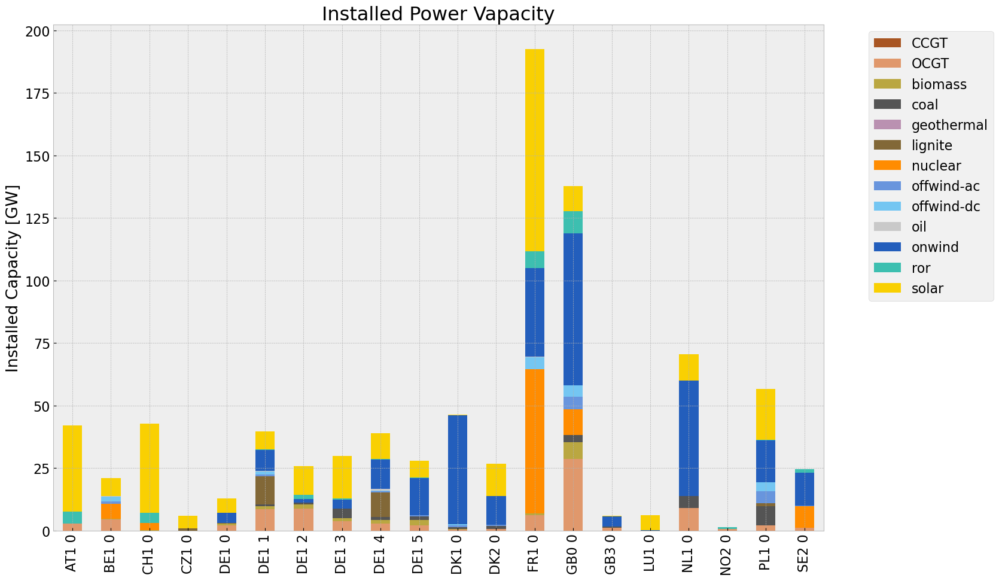

<Figure size 640x480 with 0 Axes>

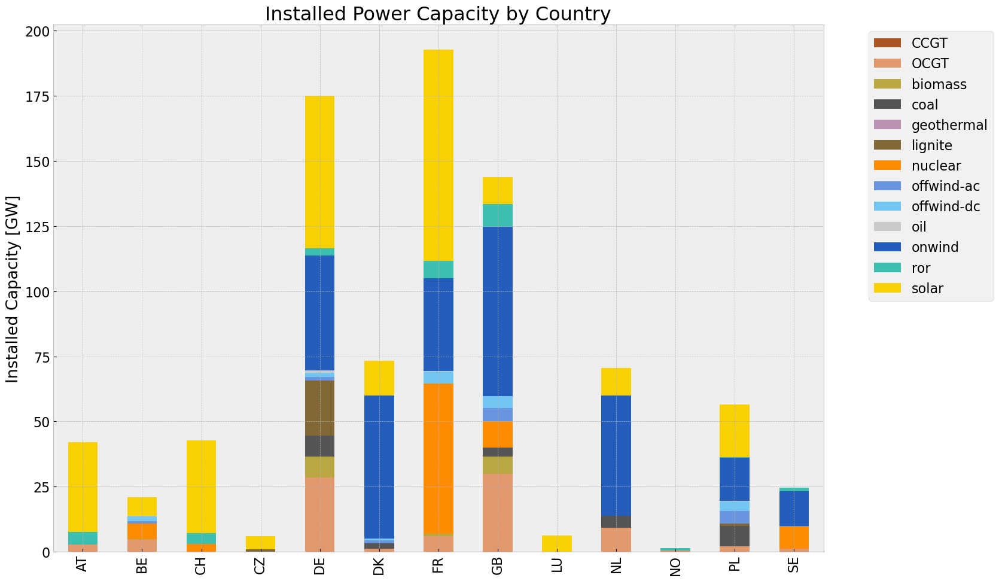

<Figure size 640x480 with 0 Axes>

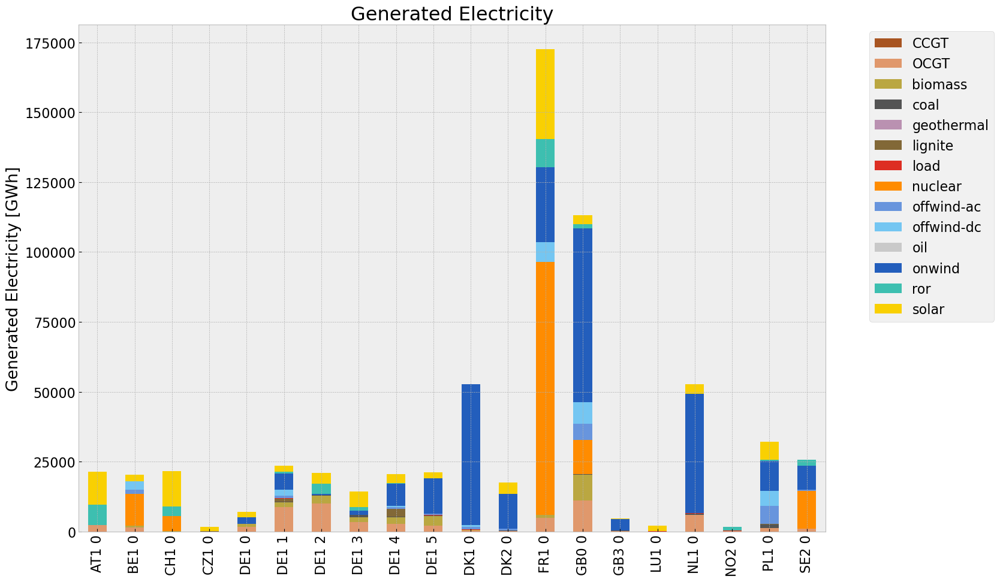

<Figure size 640x480 with 0 Axes>

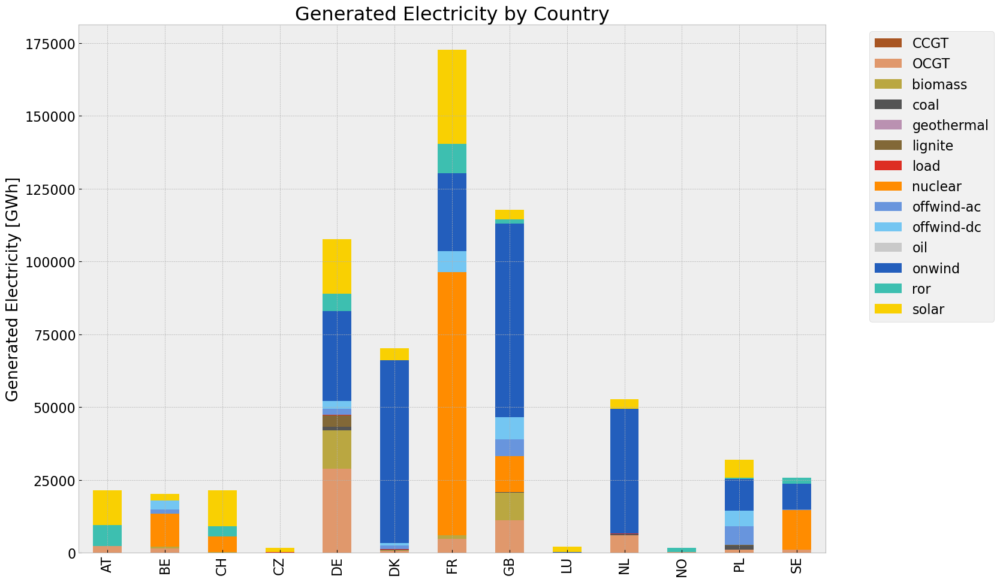

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jere

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,5.761332e+07,0.451621,0.1980,2.525888e+07
biomass,2.436073e+07,0.468000,0.0000,0.000000e+00
coal,3.720152e+06,0.329908,0.3361,3.789974e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,4.069951e+06,0.337285,0.4069,4.909985e+06
load,1.119253e+06,1.000000,0.0000,0.000000e+00
nuclear,1.327600e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.762239e+07,1.000000,0.0000,0.000000e+00


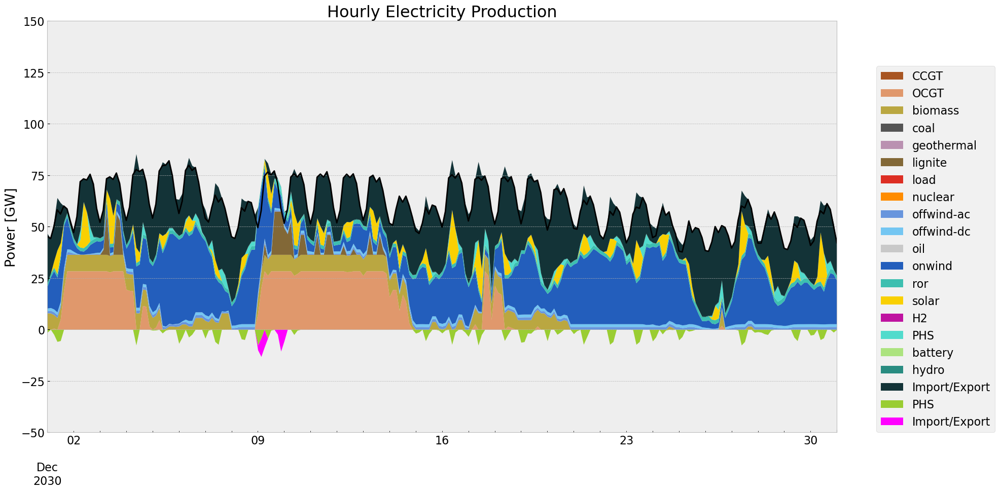

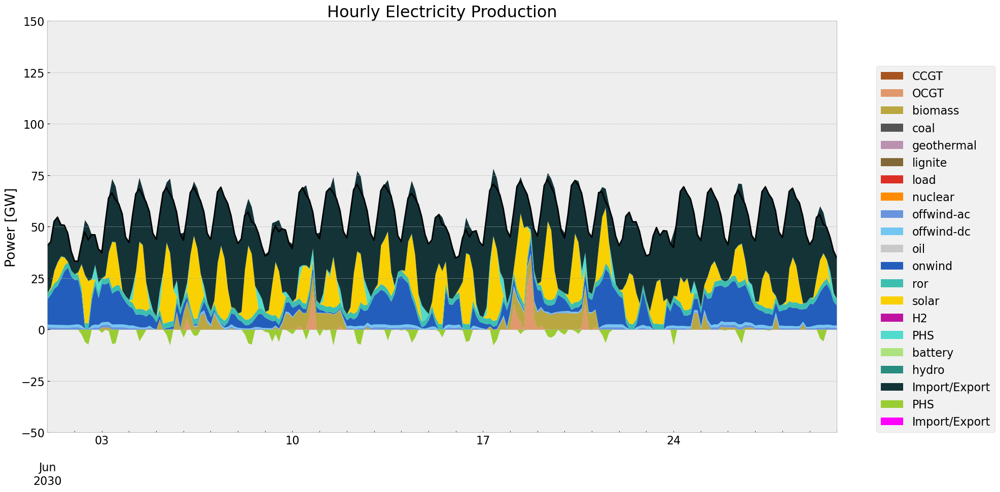

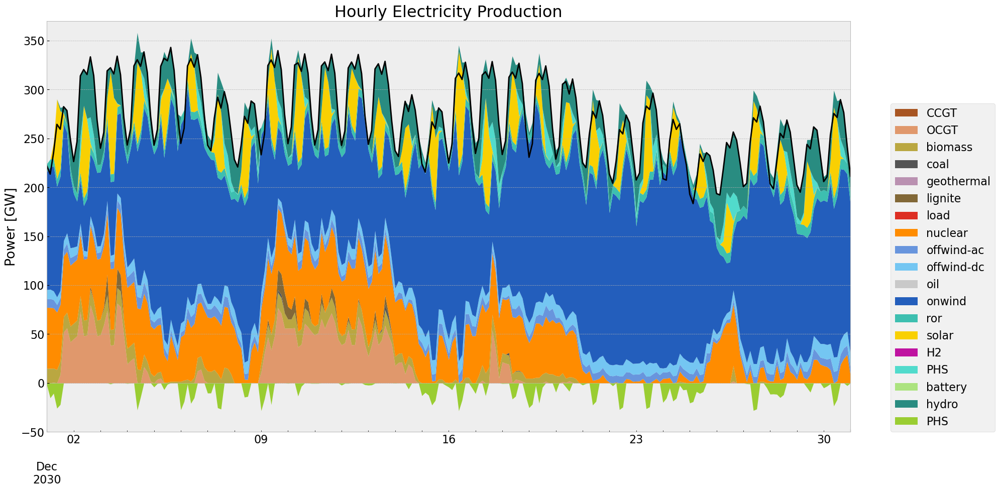

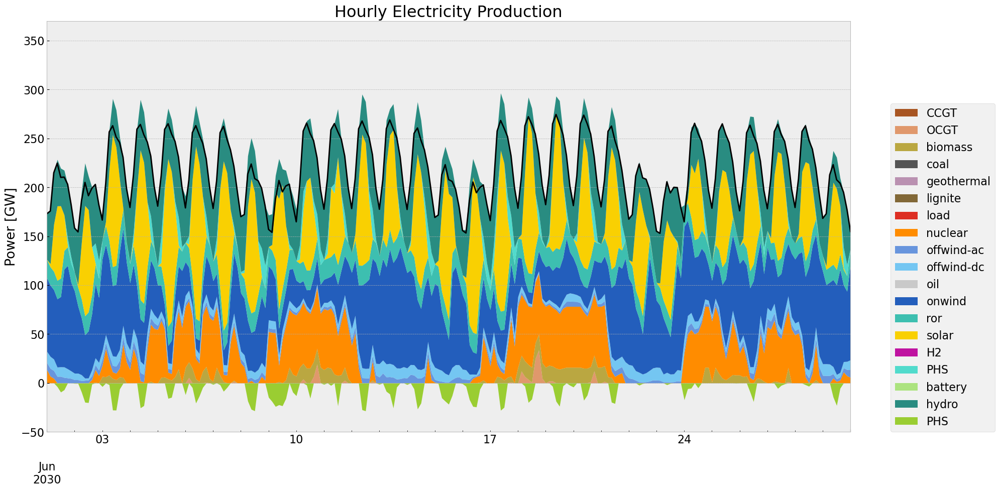

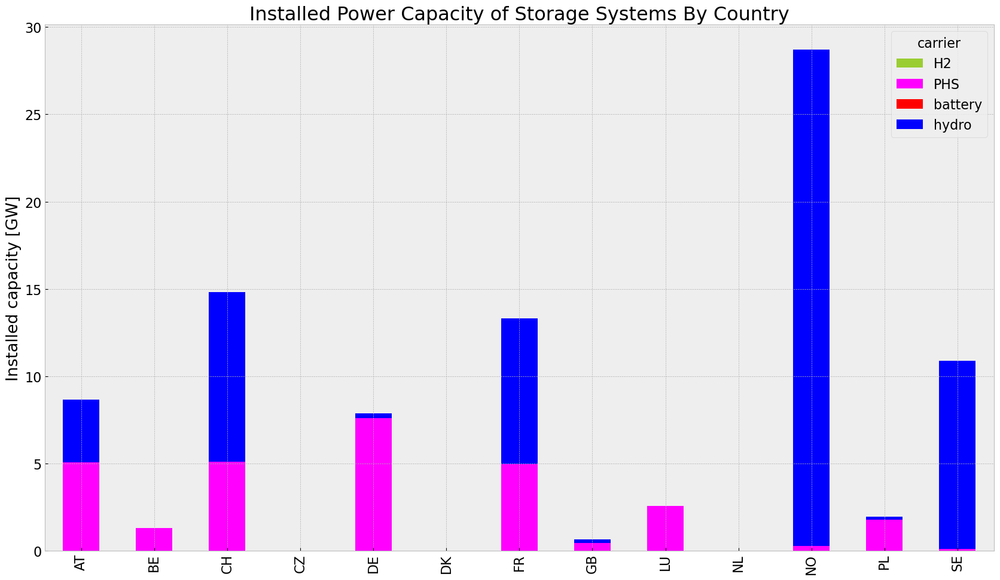

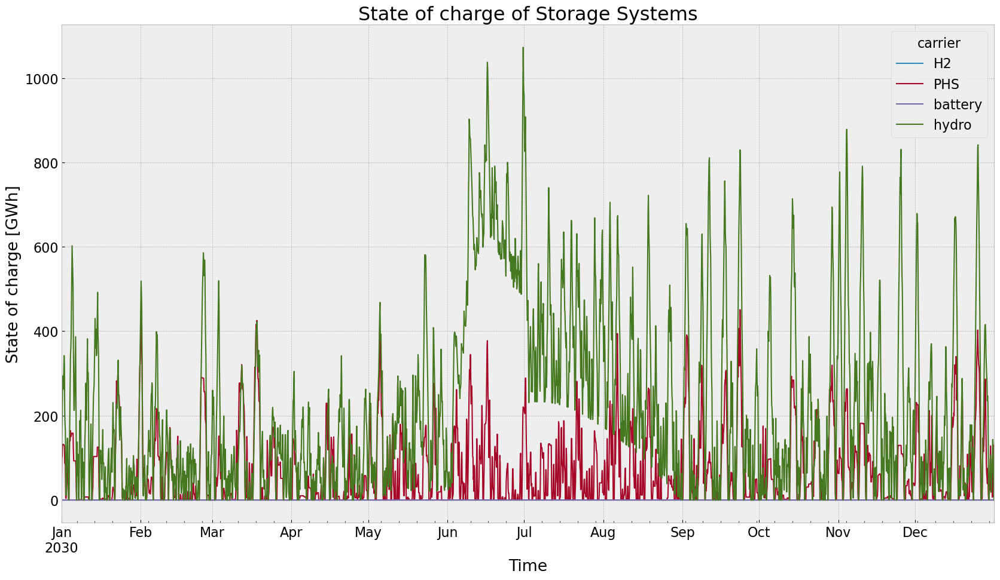

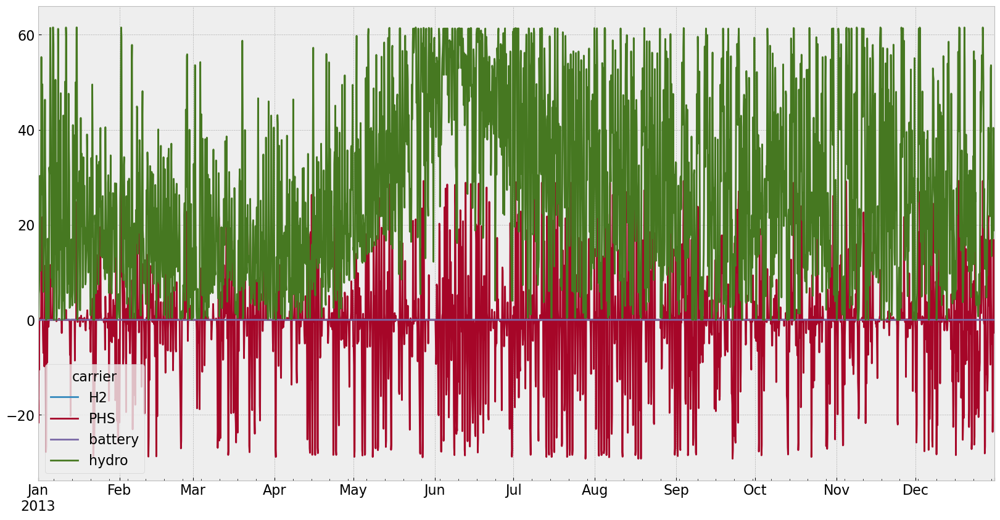

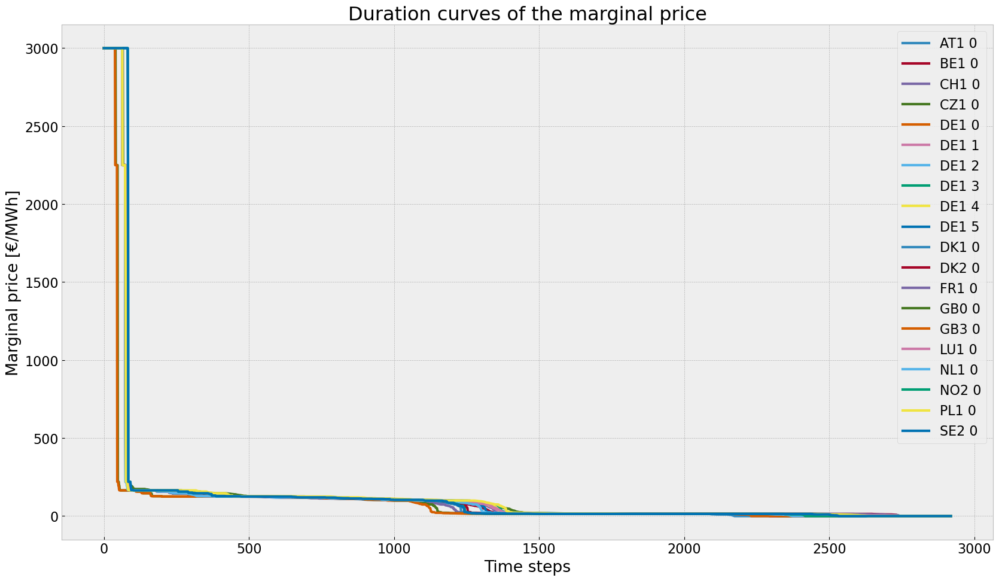

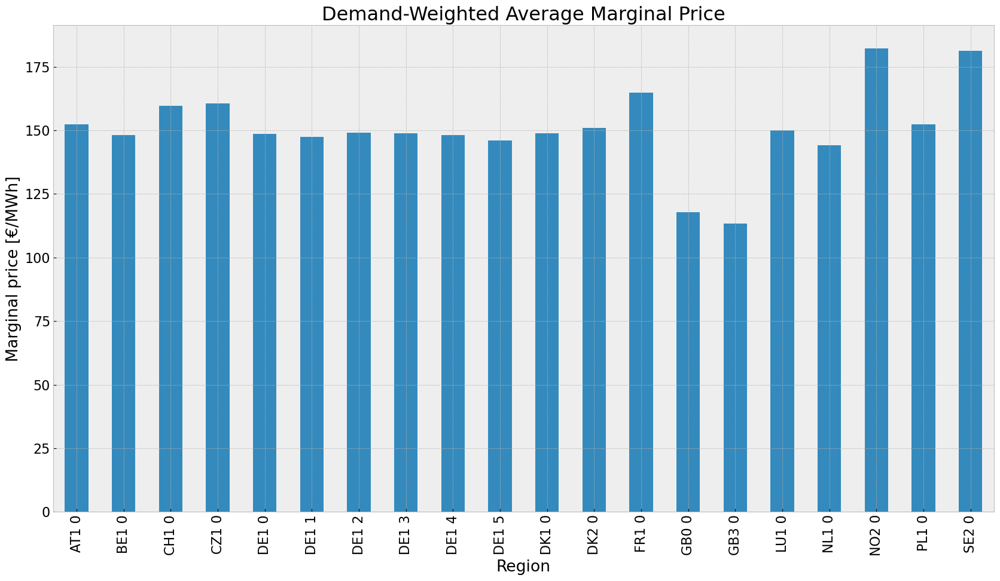

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


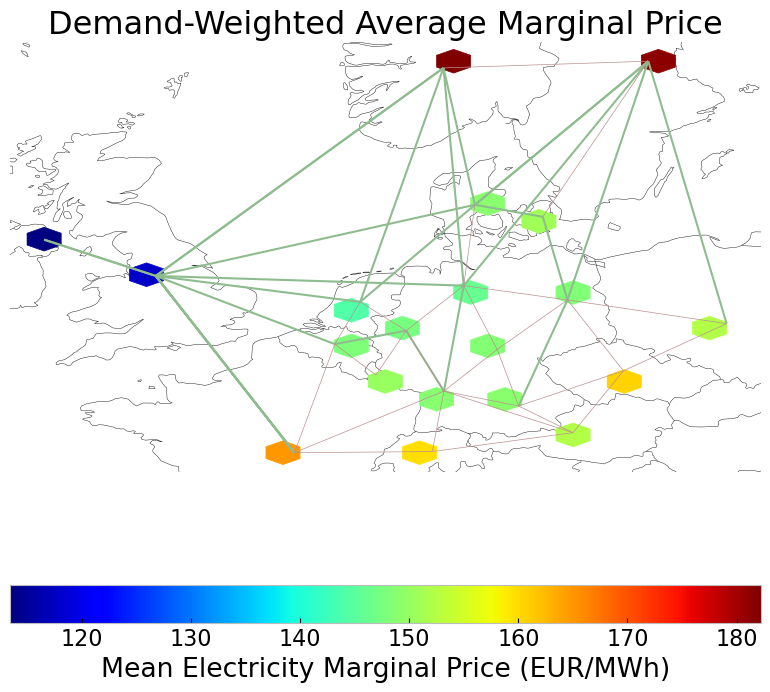

In [ ]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv_roll = inst_cap_table(n4, color_cap)
cap_inv_roll_country = inst_cap_table_country(n4, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_inv_roll  = gen_power_table(n4,colors_gen_table)
gen_inv_roll_country = gen_power_table_country(n4,colors_gen_table)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n4, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n4, '2030-06-01', '2030-06-30', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n4, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n4, '2030-06-01', '2030-06-30', colors_gen)

#installed storage unit & stores
store_inv_roll = inst_store_table(n4)

#State of Charge Storage unit
state_of_charge_plot(n4)
n4.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n4)

#avg electricity price
price_regions_table(n4)
price_regions(n4)

#Emission
em_inv_roll =em_table(n4)
em_inv_roll

In [ ]:
#e_balance = n3.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :]
#e_balance.head()
#e_balance.to_csv('energy_balance_DE_offwind.csv', sep=',', index=True, header=True, encoding='utf-8')

# Scenario Analysis

## Installed Capacity

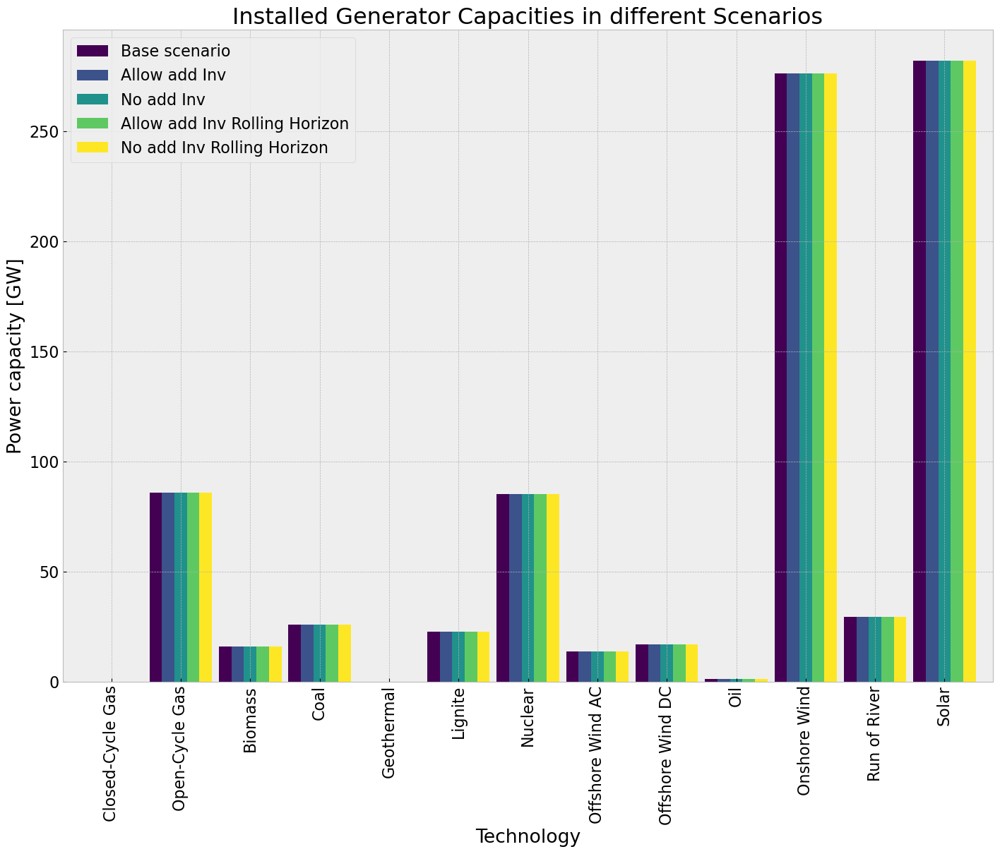

In [ ]:
comp_inst_cap = pd.DataFrame(index=capacities_base.unstack().drop(columns=['load'],inplace=False).columns)

comp_inst_cap["Base scenario"] = capacities_base.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv"] = capacities_inv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv"] = capacities_noinv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv Rolling Horizon"] = capacities_inv_roll.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv Rolling Horizon"] = capacities_noinv_roll.groupby("carrier").sum().div(1e3).drop(index="load")

comp_inst_cap.rename(index = {"coal": "Coal"}, inplace=True)
comp_inst_cap.rename(index = {"OCGT": "Open-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"CCGT": "Closed-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"ror": "Run of River"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-ac": "Offshore Wind AC"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-dc": "Offshore Wind DC"}, inplace=True)
comp_inst_cap.rename(index = {"onwind": "Onshore Wind"}, inplace=True)
comp_inst_cap.rename(index = {"solar": "Solar"}, inplace=True)
comp_inst_cap.rename(index = {"oil": "Oil"}, inplace=True)
comp_inst_cap.rename(index = {"geothermal": "Geothermal"}, inplace=True)
comp_inst_cap.rename(index = {"nuclear": "Nuclear"}, inplace=True)
comp_inst_cap.rename(index = {"biomass": "Biomass"}, inplace=True)
comp_inst_cap.rename(index = {"lignite": "Lignite"}, inplace=True)

comp_inst_cap.fillna(0, inplace=True)

comp_inst_cap.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_cap.columns))),
                        grid=True,
                        xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Generator Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.show()

### Analysis of extendable Generators

Extendable Generators: OCGT, Offshore Wind AC and DC, Onshore Wind, Solar

{'AC': '#70af1d', 'DC': '#8a1caf', 'biomass': '#baa741', 'coal': '#545454', 'lignite': '#826837', 'oil': '#c9c9c9', 'onwind': '#235ebc', 'nuclear': '#ff8c00', 'offwind-dc': '#74c6f2', 'offwind-ac': '#6895dd', 'OCGT': '#e0986c', 'CCGT': '#a85522', 'geothermal': '#ba91b1', 'solar': '#f9d002', 'hydro': '#298c81', 'PHS': '#51dbcc', 'ror': '#3dbfb0', '': '', 'battery': '#ace37f', 'H2': '#bf13a0', 'load': '#dd2e23'}


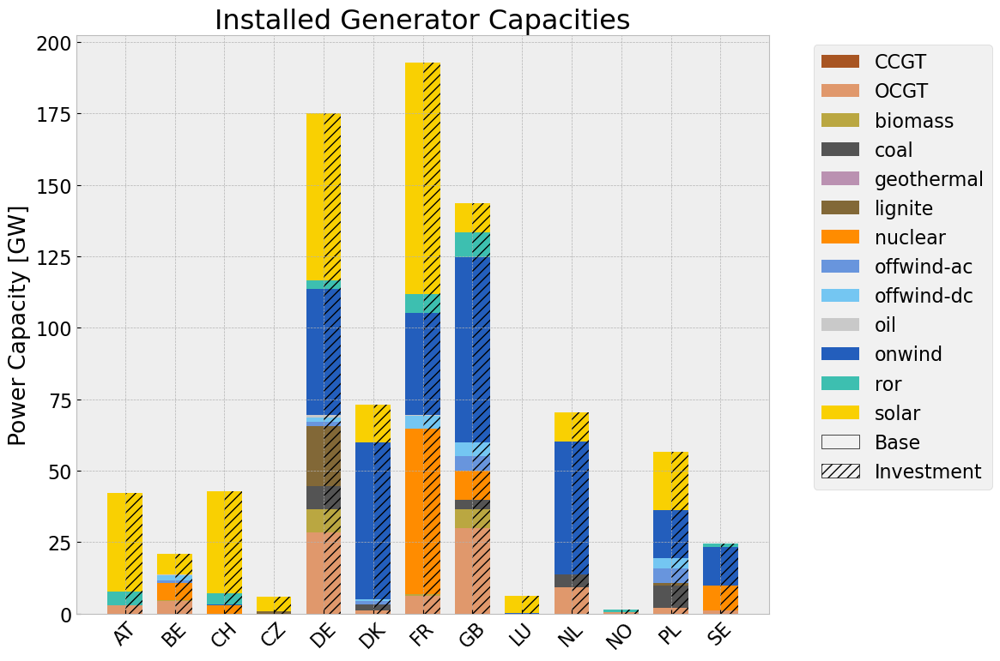

In [ ]:
from matplotlib.patches import Patch

color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}
print(color_map)

base = cap_base_country
base.fillna(0, inplace=True)
inv = cap_inv_country
inv.fillna(0, inplace=True)

# Color mapping for generator types
color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(base.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, base, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, inv, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Generator Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_cap_base_vs_inv_dispatchcut.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)


plt.show()

## Power Generation

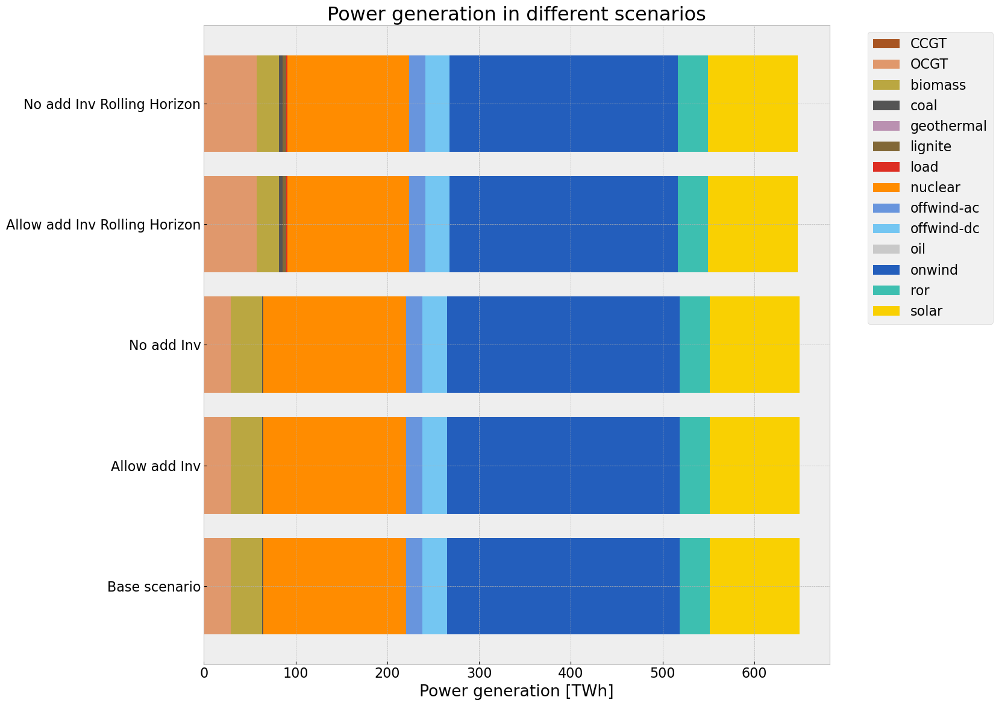

In [ ]:
comp_gen_electr = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = tech_list_gen_table)

comp_gen_electr.loc["Base scenario"] = gen_base.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv"] = gen_inv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv"] = gen_noinv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv Rolling Horizon"] = gen_inv_roll.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv Rolling Horizon"] = gen_noinv_roll.sum().div(1e3) # TWh/a



#comp_gen_electr.rename(columns = {"coal": "Coal"}, inplace=True)
#comp_gen_electr.rename(columns = {"gas": "Gas"}, inplace=True)
#comp_gen_electr.rename(columns = {"hydro": "Hydro"}, inplace=True)
#comp_gen_electr.rename(columns = {"offwind": "Offshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"onwind": "Onshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"solar": "Solar"}, inplace=True)
#comp_gen_electr.rename(columns = {"oil": "Oil"}, inplace=True)
#comp_gen_electr.rename(columns = {"geothermal": "Geothermal"}, inplace=True)
#comp_gen_electr.rename(columns = {"nuclear": "Nuclear"}, inplace=True)

comp_gen_electr.fillna(0, inplace=True)
comp_gen_electr.plot.barh(figsize=(17,12),
                        color=colors_gen_table,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Power generation [TWh]",
                        title=f"Power generation in different scenarios",
                        #xlim=[0,200],
                        width=0.8
)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_generation_dispatchcut.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Installed Storage Capacities

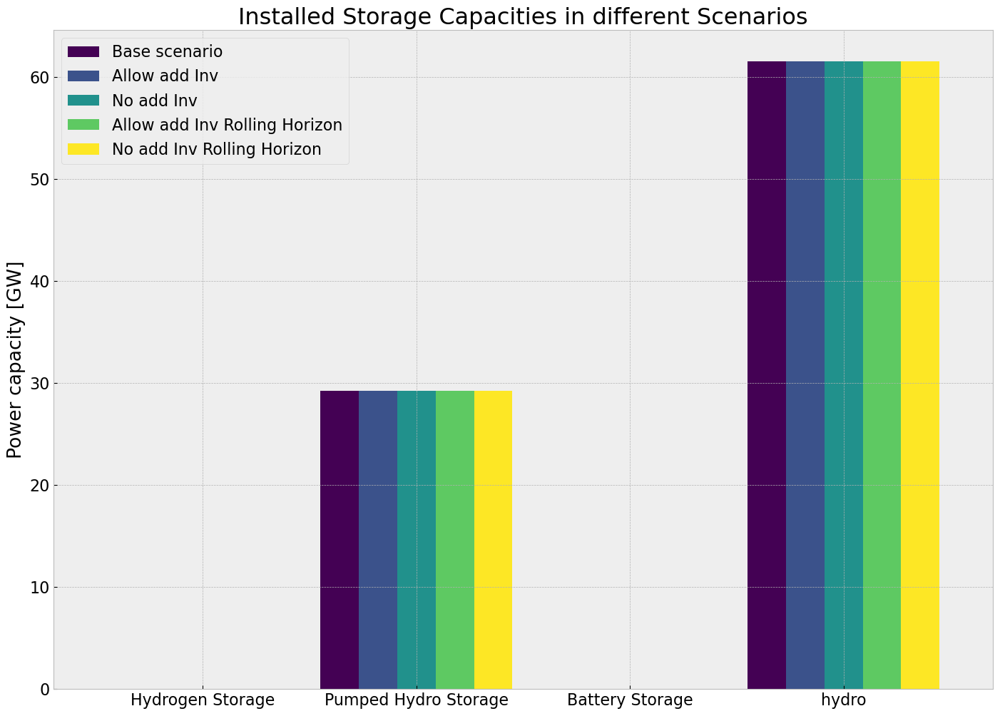

In [ ]:
comp_inst_store = pd.DataFrame(index=store_base.unstack().columns)
comp_inst_store.index.name = ''

comp_inst_store["Base scenario"] = store_base.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv.groupby("carrier").sum()
comp_inst_store["No add Inv"] = store_noinv.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["Allow add Inv Rolling Horizon"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["No add Inv Rolling Horizon"] = store_noinv_roll.groupby("carrier").sum()

comp_inst_store.rename(index = {"battery": "Battery Storage"}, inplace=True)
comp_inst_store.rename(index = {"H2": "Hydrogen Storage"}, inplace=True)
comp_inst_store.rename(index = {"Hydro": "Reservoir & Dam"}, inplace=True)
comp_inst_store.rename(index = {"PHS": "Pumped Hydro Storage"}, inplace=True)


comp_inst_store.fillna(0, inplace=True)

comp_inst_store.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_store.columns))),
                        grid=True,
                        #xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Storage Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.xticks(rotation=360, ha='center')
fig.tight_layout()
# Save plot to the current working directory
filename = "analysis_installed_cap_dispatchcut.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

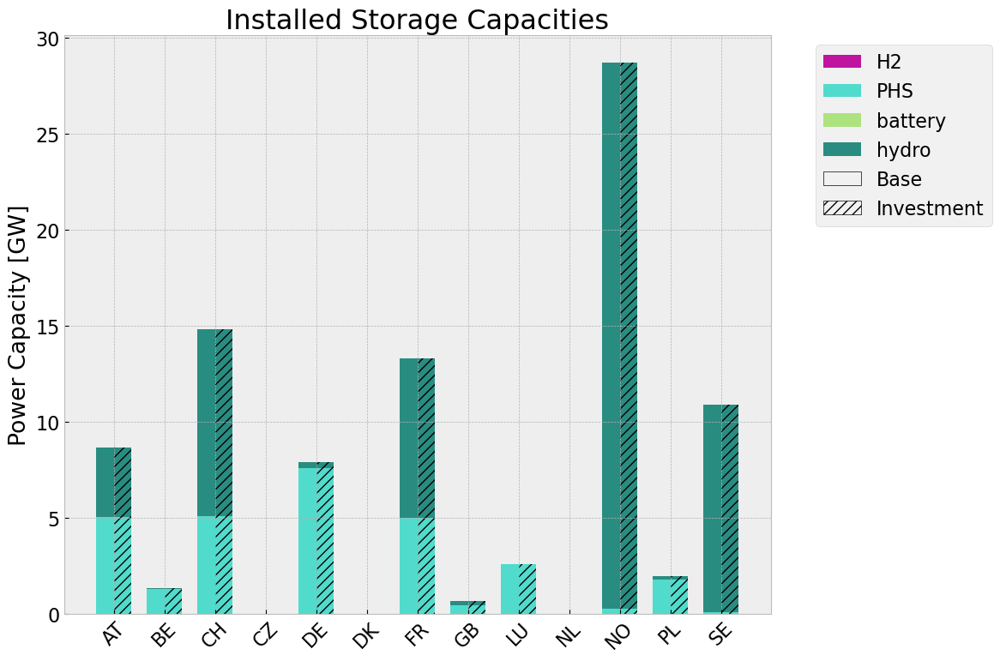

In [ ]:
store_base_df = store_base.unstack()
store_inv_df = store_inv.unstack()

store_base_df.fillna(0, inplace=True)
store_inv_df.fillna(0, inplace=True)

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(store_base_df.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, store_base_df, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, store_inv_df, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Storage Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_storagecap_base_vs_inv_dispatchcut.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()


## System Cost

In [ ]:
tech_comp = system_cost_base.index.tolist()
comp_system_cost = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_cost.loc["Base scenario"] = system_cost_base # Million €/a
comp_system_cost.loc["Allow add Inv"] = system_cost_inv # Million €/a
#if tot_cost_0_PV > 0: 
#    comp_system_cost.loc["0% PV potential"] = system_cost_0_PV # Million €/a
#else: comp_system_cost.loc["0% PV potential"] = 0.0
#if tot_cost_20_PV > 0: 
#    comp_system_cost.loc["20% PV potential"] = system_cost_20_PV # Million €/a
#else: comp_system_cost.loc["20% PV potential"] = 0.0
comp_system_cost.loc["No add Inv"] = system_cost_noinv # Million €/a
comp_system_cost.loc["Allow add Inv Rolling Horizon"] = system_cost_inv_roll
comp_system_cost.loc["No add Inv Rolling Horizon"] = system_cost_noinv_roll # Million €/a

#if 'AC' in system_cost_base:
#   comp_system_cost.AC = comp_system_cost.AC-system_cost_base.AC # expenditure for already existing transmission lines

#comp_system_cost[comp_system_cost<0] = 0 # since we subtact the AC cost (for the 0% or 20%) 
comp_system_cost.drop('-', axis=1, inplace=True)
#comp_system_cost.iloc[0,0] = system_cost_base.AC


#comp_system_cost = comp_system_cost   #Million eur0/

#comp_system_cost.rename(columns = {"battery storage": "Battery storage"}, inplace=True)
#comp_system_cost.rename(columns = {"hydrogen storage underground": "Hydrogen storage underground"}, inplace=True)

comp_system_cost.fillna(0, inplace=True)
comp_system_cost = comp_system_cost.div(1e3) # Billion €

#move load shedding to the last col
# Specify the column name to move
column_to_move = 'Load shedding'

# Create a new list of column names without the column to move
new_columns = [col for col in comp_system_cost.columns if col != column_to_move]

# Append the column to move to the end
new_columns.append(column_to_move)

# Reorder the columns
comp_system_cost = comp_system_cost[new_columns]


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3874677897.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3874677897.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


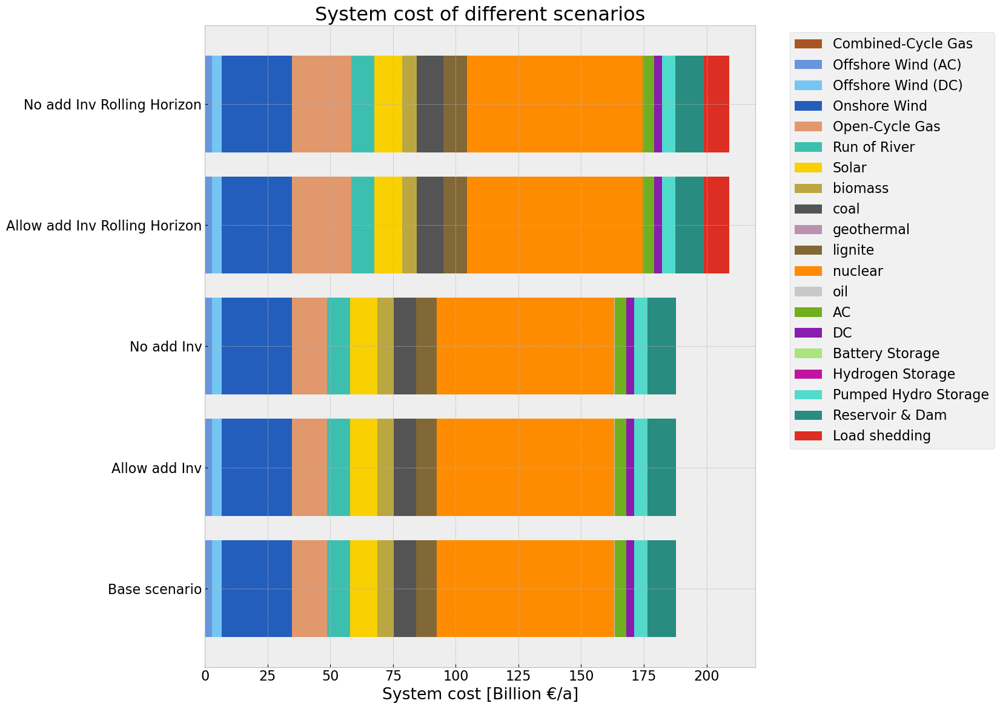

In [ ]:
colors_comp = []

for i in range(len(comp_system_cost.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_cost.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="System cost [Billion €/a]",
                        title=f"System cost of different scenarios",
                        #xlim=[0,100],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_system_cost_dispatchcut.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Curtailment

In [ ]:
comp_curtailment = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = stat_base.loc["Generator"].index)

comp_curtailment.loc["Base scenario"] = stat_base.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv"] = stat_inv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv"] = stat_noinv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv Rolling Horizon"] = stat_inv_roll.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv Rolling Horizon"] = stat_noinv_roll.loc["Generator"].Curtailment.div(1e6) # TWh

comp_curtailment.fillna(0, inplace=True)

In [ ]:
color_curtailment=[]

for i in range(len(comp_curtailment.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
            color_curtailment.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found 

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3109801822.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\3109801822.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_curtailment.append(n.carriers.color[j])


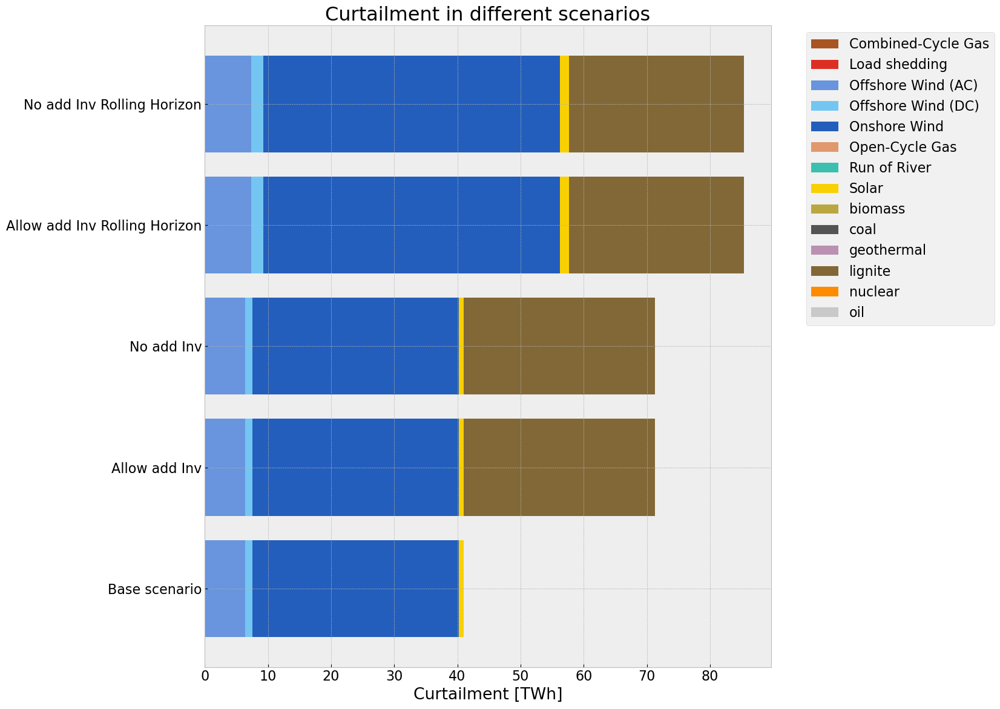

In [ ]:
comp_curtailment.plot.barh(figsize=(17,12),
                        color=color_curtailment,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Curtailment [TWh]",
                        title=f"Curtailment in different scenarios",
                        #xlim=[0,120],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_curtailment_dispatchcut.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Emission

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\712928399.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


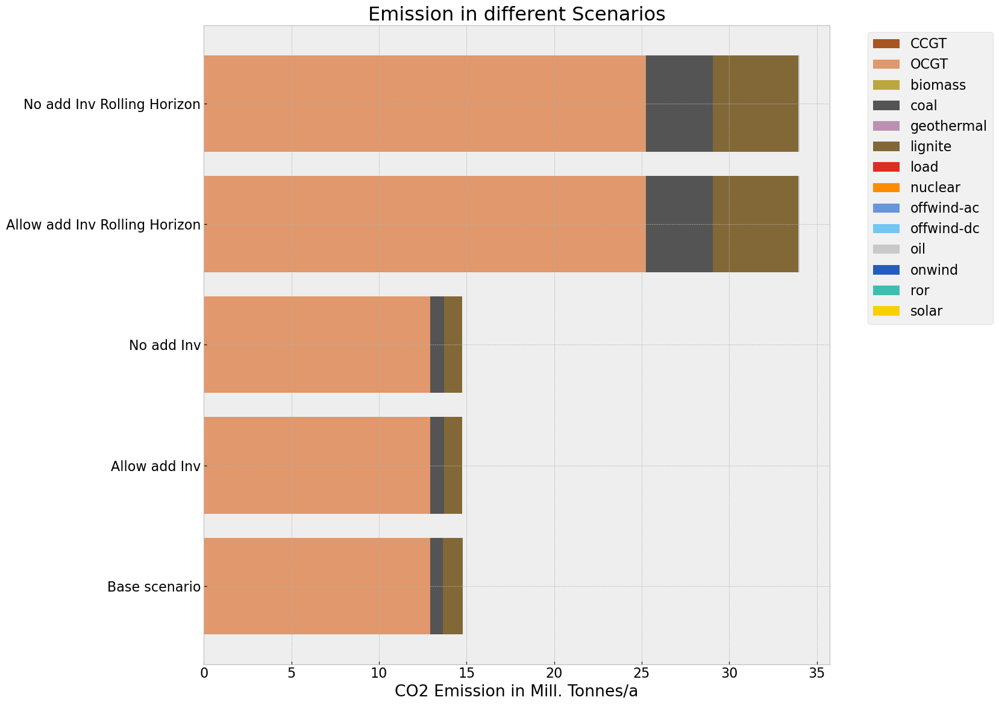

In [ ]:
tech_comp = em_base.index.tolist()
comp_system_em = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_em.loc["Base scenario"] = em_base['emissions in Tonnes CO2']/1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv"] = em_inv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv"] = em_noinv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv Rolling Horizon"] = em_inv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv Rolling Horizon"] = em_noinv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a

comp_system_em.fillna(0, inplace=True)

colors_comp = []

for i in range(len(comp_system_em.columns)):
    for j in range(len(n.carriers.index)):
        if comp_system_em.columns[i] == n.carriers.index[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_em.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="CO2 Emission in Mill. Tonnes/a",
                        title=f"Emission in different Scenarios",
                        #xlim=[0,100],
                        width=0.8
)
#global_constraint
#plt.axvline(x=n.global_constraints.loc['CO2Limit','constant']/1e6, color='r', linestyle='-', linewidth=2, label='CO2 cap')
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_emission_dispatchcut.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3468\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='

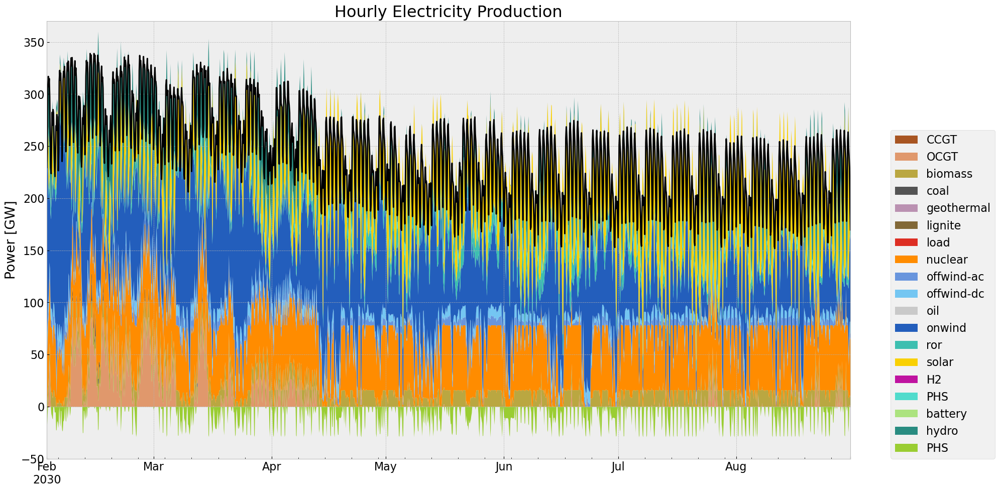

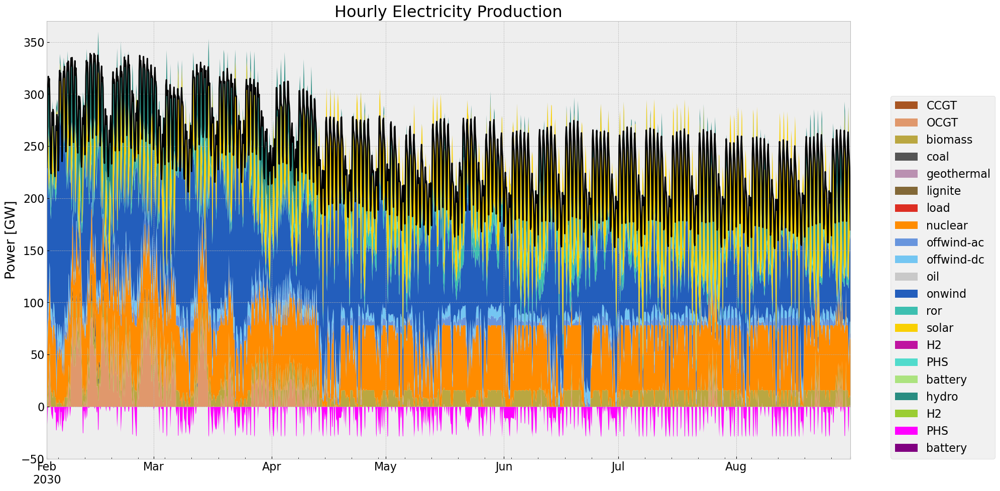

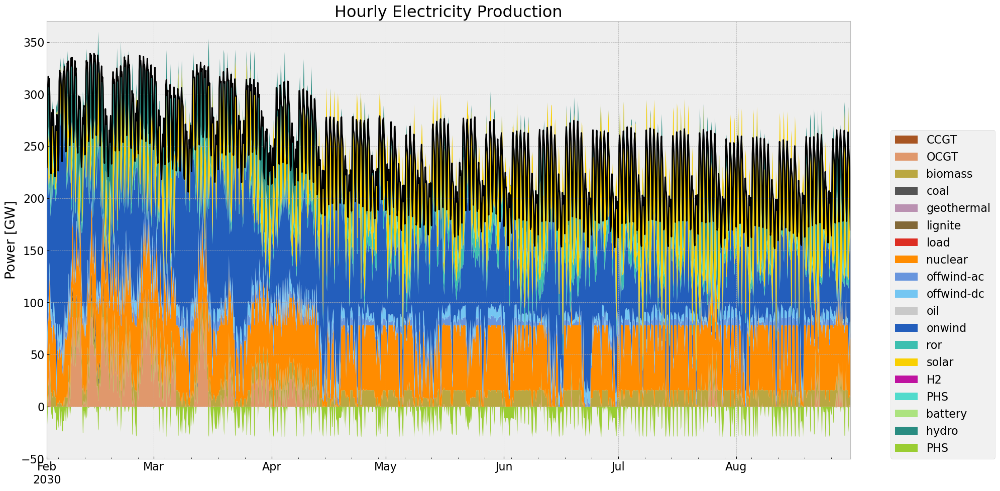

In [ ]:
gen_curve_tot(n2, '2030-02-01', '2030-08-31', colors_gen)
gen_curve_tot(n1, '2030-02-01', '2030-08-31', colors_gen)
gen_curve_tot(n, '2030-02-01', '2030-08-31', colors_gen)